# SVM for classification, without and with kernels

In this notebook we are going to explore the use of Support Vector Machines (SVMs) for image classification. We are going to use the famous MNIST dataset, that is a dataset of handwritten digits. We get the data from mldata.org, that is a public repository for machine learning data.

The dataset consists of 70,000 images of handwritten digits (i.e., 0, 1, ... 9). Each image is 28 pixels by 28 pixels and we can think of it as a vector of 28x28 = 784 numbers. Each number is an integer between 0 and 255. For each image we have the corresponding label (i.e., 0, 1, ..., 9).

In [ ]:
#load the required packages

%matplotlib inline  

import numpy as np
import matplotlib.pyplot as plt

import sklearn
from sklearn.datasets import fetch_openml

In [ ]:
#fix your ID ("numero di matricola") and the seed for random generator
ID = 45546 # COMPLETE
np.random.seed(ID)

Now let's load the dataset. 'data' contains the input, 'target' contains the label. We normalize the data by dividing each value by 255 so that each value is in [0,1]

In [ ]:
#load the MNIST dataset and let's normalize the features so that each value is in [0,1]
mnist = fetch_openml('mnist_784', version=1)
# rescale the data
X, y = mnist.data / 255., mnist.target

Now split into training and test. We keep 500 samples in the training set. Make sure that each label is present at least 10 times
in training. If it is not, then keep adding permutations to the initial data until this 
happens.

**IMPORTANT**: if you cannot run the SVM with 500 samples or 1000 samples (see below), try with a smaller number of samples (e.g. 200 here and 400 below).

In [ ]:
#random permute the data and split into training and test taking the first 500
#data samples as training and the rests as test
permutation = np.random.permutation(X.shape[0])

X = X[permutation]
y = y[permutation]

m_training = 500

X_train, X_test = X[:m_training], X[m_training:]
y_train, y_test = y[:m_training], y[m_training:]

print("Labels and frequencies in training dataset: ")
np.unique(y_train, return_counts = True)

Labels and frequencies in training dataset: 


(array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype=object),
 array([54, 50, 46, 57, 51, 35, 50, 49, 53, 55]))

We now provide a function to print an image in a dataset, the corresponding true label, and the index of the image in the dataset.

In [ ]:
#function for plotting a digit and printing the corresponding labe
def plot_digit(X_matrix, labels, index):
    print("INPUT:")
    plt.imshow(
        X_matrix[index].reshape(28,28),
        cmap          = plt.cm.gray_r,
        interpolation = "nearest"
    )
    plt.show()
    print("LABEL: %s" % labels[index])
    return

As an example, let's print the 100-th image in X_train and the 40,000-th image in X_test and their true labels.

INPUT:


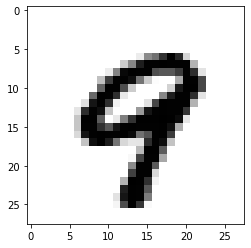

LABEL: 9
INPUT:


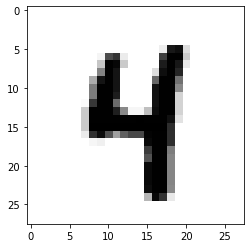

LABEL: 4


In [ ]:
#let's try the plotting function
plot_digit(X_train,y_train,100)
plot_digit(X_test,y_test,40000)

## TO DO 1
Run SVM with cross validation to pick a kernel and values of parameters. Use a 5-fold cross-validation to pick the best kernel and choice of parameters. We provide some potential choice for parameters, but change the grid if needed (e.g., it takes too long). For the SVM for classification use SVC from sklearn.svm; for the grid search we suggest you use GridSearchCV from sklearn.model_selection, but you can implement your own cross-validation for model selection if you prefer.

Print the best parameters used as well as the score obtained by the best model

In [ ]:
#import SVC
from sklearn.svm import SVC
#import for Cross-Validation
from sklearn.model_selection import GridSearchCV

# parameters for linear SVM
parameters = {'C': [1, 10, 100]}

#run linear SVM
linear_SVM = SVC(kernel='linear')

#find best model uusing 5-fold CV 
#and train it using all the training data

clf = GridSearchCV(linear_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR LINEAR KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")
scores = ['params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score']

for i in scores:
    print(results[i])

# parameters for poly with degree 2 kernel
parameters = {'C': [1, 10, 100],'gamma':[0.01,0.1,1.]}

#run SVM with poly of degree 2 kernel
poly2_SVM = SVC(kernel='poly',degree=2)

# ADD CODE: DO THE SAME AS ABOVE FOR POLYNOMIAL KERNEL WITH DEGREE=2

clf = GridSearchCV(poly2_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR LINEAR KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")

for i in scores:
    print(results[i])


# parameters for rbf SVM
parameters = {'C': [1, 10, 100],'gamma':[0.01,0.1,1.]}

#run SVM with rbf kernel
rbf_SVM = SVC(kernel='rbf')

clf = GridSearchCV(rbf_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('\nRESULTS FOR rbf KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")

for i in scores:
    print(results[i])


RESULTS FOR LINEAR KERNEL

{'mean_fit_time': array([0.15269012, 0.15130234, 0.15162005]), 'std_fit_time': array([0.00261015, 0.00120264, 0.00151509]), 'mean_score_time': array([0.03801355, 0.03745861, 0.03757086]), 'std_score_time': array([0.00081801, 0.00047898, 0.00054038]), 'param_C': masked_array(data=[1, 10, 100],
             mask=[False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'C': 1}, {'C': 10}, {'C': 100}], 'split0_test_score': array([0.87, 0.87, 0.87]), 'split1_test_score': array([0.87, 0.87, 0.87]), 'split2_test_score': array([0.82, 0.82, 0.82]), 'split3_test_score': array([0.86, 0.86, 0.86]), 'split4_test_score': array([0.88, 0.88, 0.88]), 'mean_test_score': array([0.86, 0.86, 0.86]), 'std_test_score': array([0.02097618, 0.02097618, 0.02097618]), 'rank_test_score': array([1, 1, 1], dtype=int32)}
Best parameters set found:
{'C': 1}
Score with best parameters:
[{'C': 1}, 0.86]

All scores on the grid:
[{'C': 1}, {'C': 10}, {'C': 100}]
[0.8

## TO DO 2
For the "best" SVM kernel and choice of parameters from above, train the model on the entire training set and measure the training error. Also make predictions on the test set and measure the test error. Print the training and the test error.

In [ ]:
#get training and test error for the best SVM model from CV
best_SVM = SVC(kernel='linear', C=1)

# fit the model on the entire training set

best_SVM.fit(X_train, y_train)

#get the training and test error
training_error = 1. - best_SVM.score(X_train,y_train)
test_error = 1. - best_SVM.score(X_test,y_test)

print ("Best SVM training error: %f" % training_error)
print ("Best SVM test error: %f" % test_error)

Best SVM training error: 0.000000
Best SVM test error: 0.130374


## Use logistic regression for comparison

## TO DO 3

Just for comparison let's also use logistic regression, first with the default values of the parameter for regularization and then with cross-validation to fix the value of the parameter. For cross validation, use 5-fold cross validation and the default values of the regularization parameters for the function linear_model.LogisticRegressionCV(...)

In [ ]:
from sklearn import linear_model

lr = linear_model.LogisticRegression()
# fit the model on the training data
clf = lr.fit(X_train,y_train)

#compute training and test error for model above
training_error = 1. - clf.score(X_train,y_train)
test_error = 1. - clf.score(X_train,y_train)

print ("Best logistic regression training error: %f" % training_error)
print ("Best logistic regression test error: %f" % test_error)

#logistic regression with 5-fold CV: you can use use linear_model.LogisticRegressionCV
# use 5-fold CV to find the best choice of the parameter, than train
# the model on the entire training set
lr_cv = linear_model.LogisticRegressionCV(cv=5).fit(X_train,y_train)
training_error_cv = 1. - lr_cv.score(X_train,y_train)
test_error_cv = 1. - lr_cv.score(X_train,y_train)

print ("Best logistic regression training error: %f" % training_error_cv)
print ("Best logistic regression test error: %f" % test_error_cv)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Best logistic regression training error: 0.000000
Best logistic regression test error: 0.000000


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Best logistic regression training error: 0.000000
Best logistic regression test error: 0.000000


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


## TO DO 4 
Compare and comment the results from SVM and logistic regression.
 


Best Svm model's training error = 0, test error = 0.130374 and logistic regression's training error = 0, test error = 0. So, if we consider this results logistic regression is better than Svm for this data.

## TO DO 5
Write the code that finds and plots a digit that is missclassified by logistic regression (optimized for the regularization parameter) and correctly classified by the "best" SVM.

INPUT:


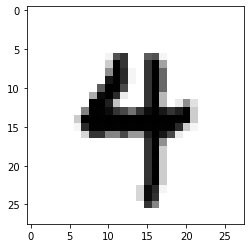

LABEL: 4
INPUT:


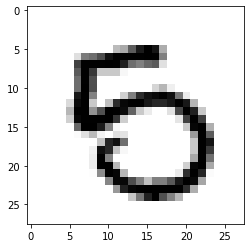

LABEL: 5
INPUT:


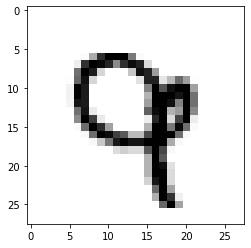

LABEL: 9
INPUT:


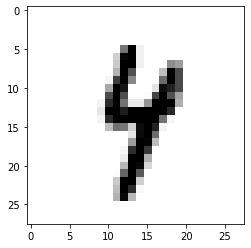

LABEL: 4
INPUT:


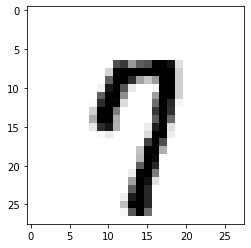

LABEL: 7
INPUT:


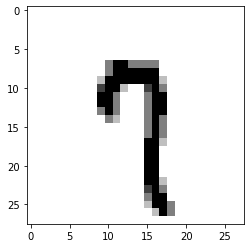

LABEL: 7
INPUT:


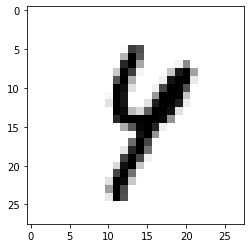

LABEL: 4
INPUT:


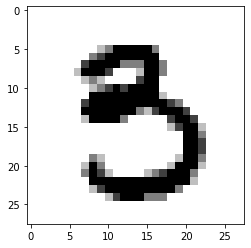

LABEL: 3
INPUT:


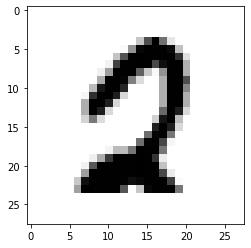

LABEL: 2
INPUT:


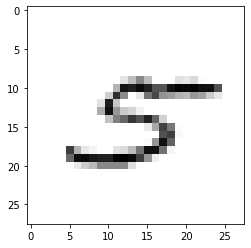

LABEL: 5
INPUT:


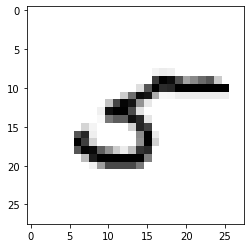

LABEL: 5
INPUT:


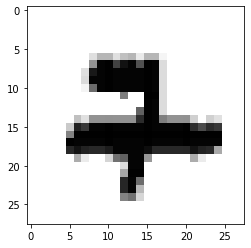

LABEL: 7
INPUT:


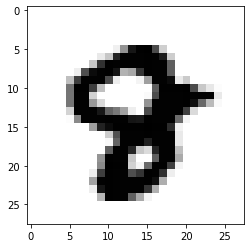

LABEL: 8
INPUT:


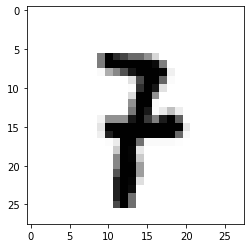

LABEL: 7
INPUT:


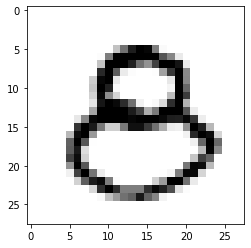

LABEL: 8
INPUT:


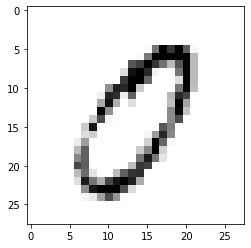

LABEL: 0
INPUT:


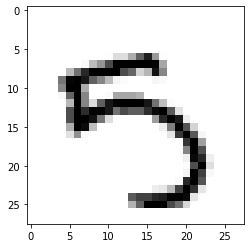

LABEL: 5
INPUT:


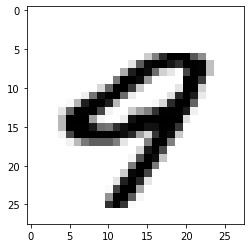

LABEL: 9
INPUT:


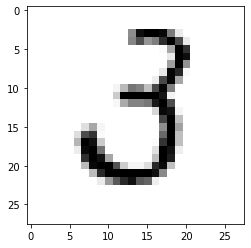

LABEL: 3
INPUT:


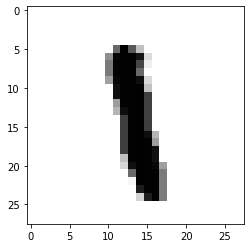

LABEL: 1
INPUT:


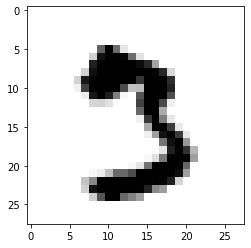

LABEL: 3
INPUT:


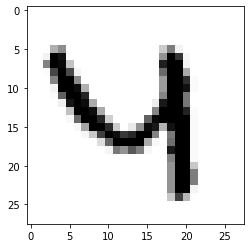

LABEL: 4
INPUT:


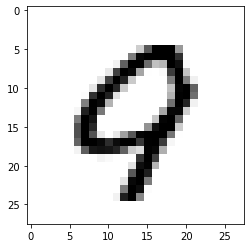

LABEL: 9
INPUT:


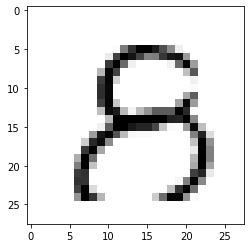

LABEL: 8
INPUT:


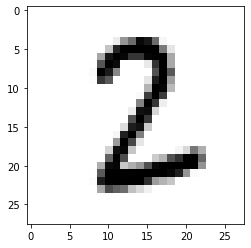

LABEL: 2
INPUT:


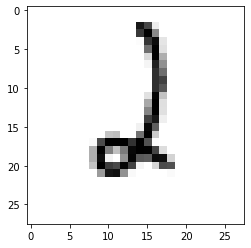

LABEL: 2
INPUT:


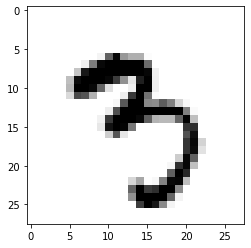

LABEL: 3
INPUT:


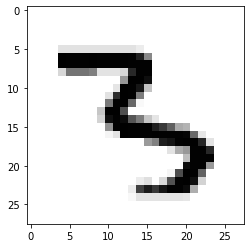

LABEL: 3
INPUT:


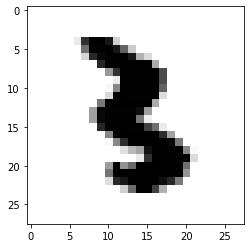

LABEL: 3
INPUT:


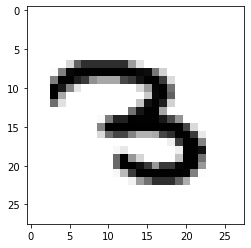

LABEL: 3
INPUT:


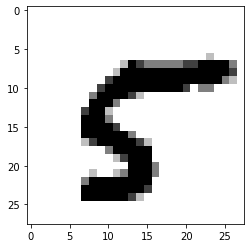

LABEL: 5
INPUT:


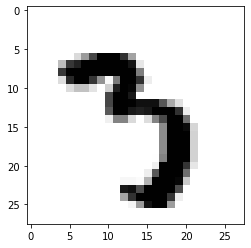

LABEL: 3
INPUT:


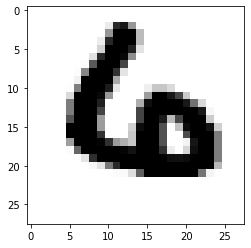

LABEL: 6
INPUT:


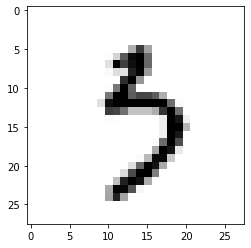

LABEL: 3
INPUT:


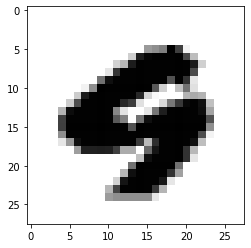

LABEL: 9
INPUT:


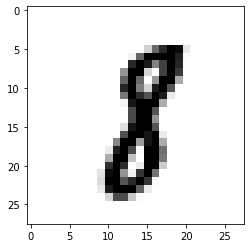

LABEL: 8
INPUT:


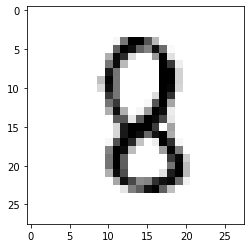

LABEL: 8
INPUT:


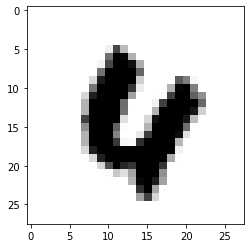

LABEL: 4
INPUT:


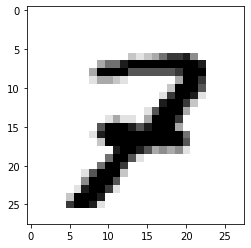

LABEL: 7
INPUT:


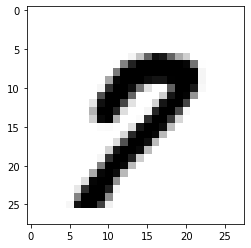

LABEL: 7
INPUT:


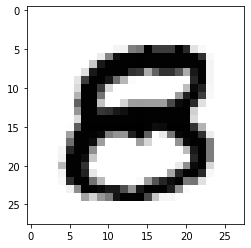

LABEL: 8
INPUT:


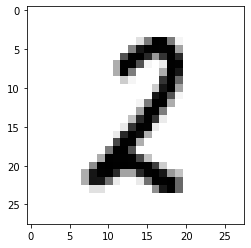

LABEL: 2
INPUT:


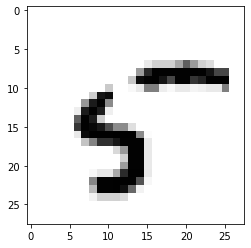

LABEL: 5
INPUT:


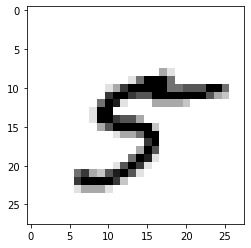

LABEL: 5
INPUT:


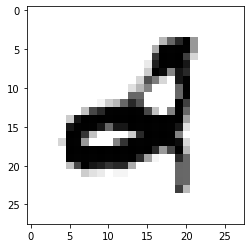

LABEL: 2
INPUT:


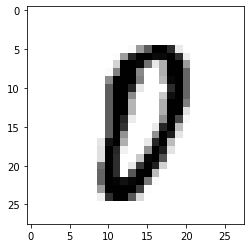

LABEL: 0
INPUT:


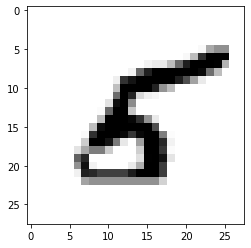

LABEL: 5
INPUT:


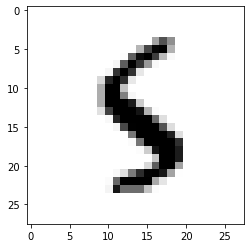

LABEL: 5
INPUT:


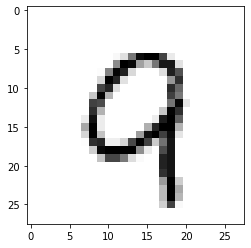

LABEL: 9
INPUT:


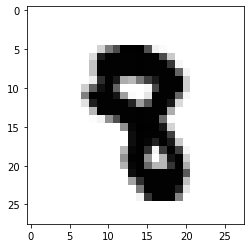

LABEL: 8
INPUT:


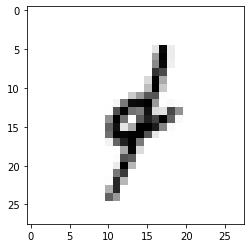

LABEL: 4
INPUT:


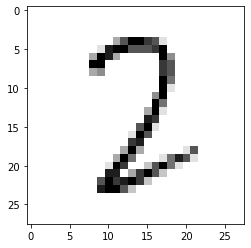

LABEL: 2
INPUT:


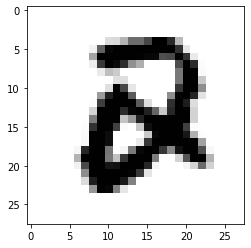

LABEL: 2
INPUT:


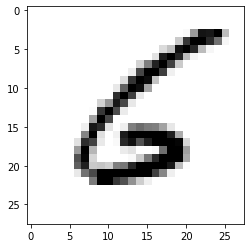

LABEL: 6
INPUT:


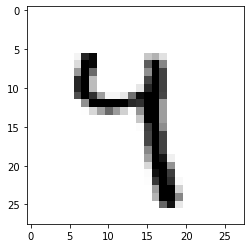

LABEL: 4
INPUT:


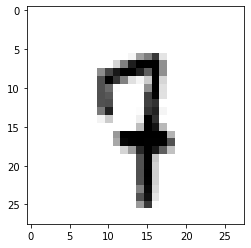

LABEL: 7
INPUT:


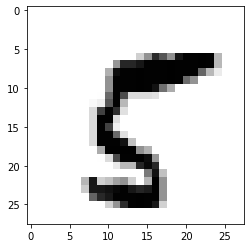

LABEL: 5
INPUT:


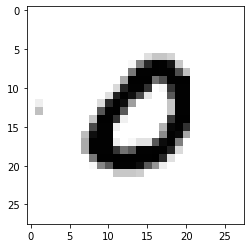

LABEL: 0
INPUT:


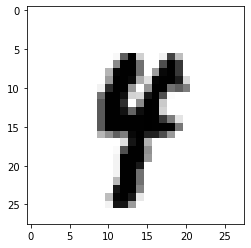

LABEL: 4
INPUT:


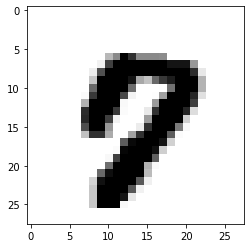

LABEL: 7
INPUT:


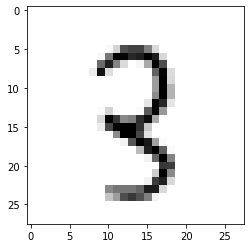

LABEL: 3
INPUT:


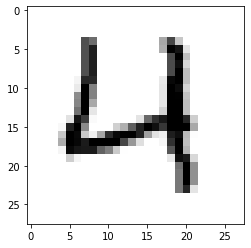

LABEL: 4
INPUT:


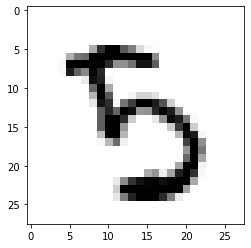

LABEL: 5
INPUT:


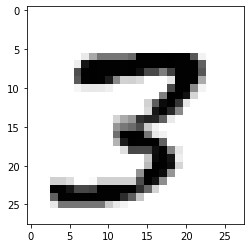

LABEL: 3
INPUT:


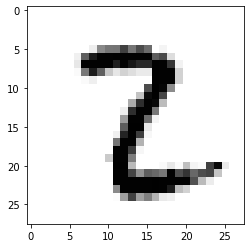

LABEL: 2
INPUT:


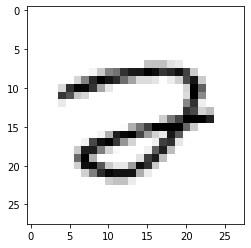

LABEL: 2
INPUT:


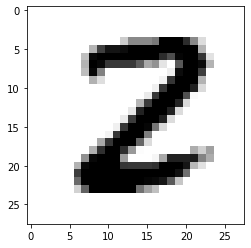

LABEL: 2
INPUT:


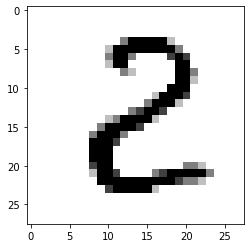

LABEL: 2
INPUT:


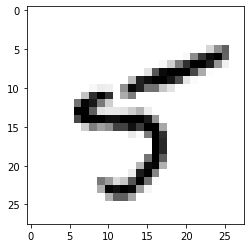

LABEL: 5
INPUT:


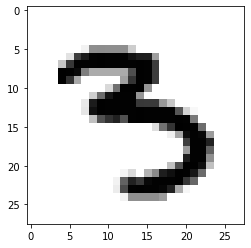

LABEL: 3
INPUT:


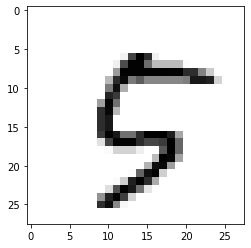

LABEL: 5
INPUT:


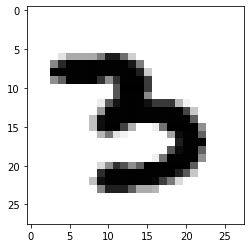

LABEL: 3
INPUT:


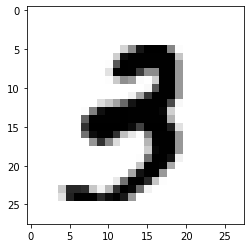

LABEL: 3
INPUT:


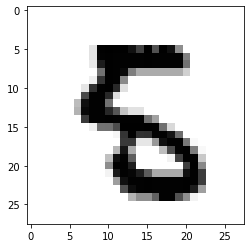

LABEL: 5
INPUT:


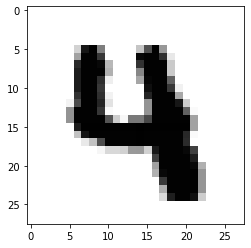

LABEL: 4
INPUT:


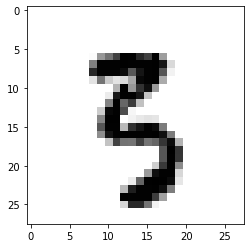

LABEL: 3
INPUT:


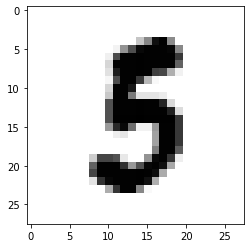

LABEL: 5
INPUT:


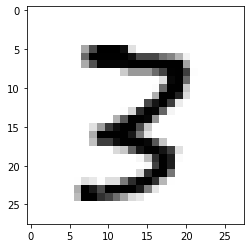

LABEL: 3
INPUT:


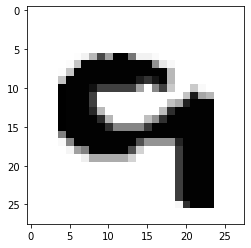

LABEL: 9
INPUT:


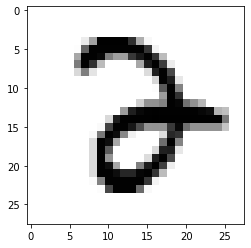

LABEL: 2
INPUT:


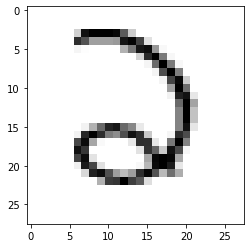

LABEL: 2
INPUT:


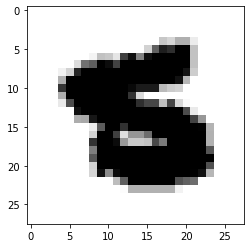

LABEL: 5
INPUT:


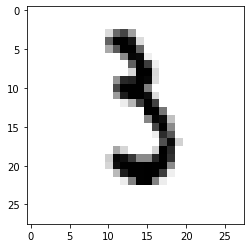

LABEL: 3
INPUT:


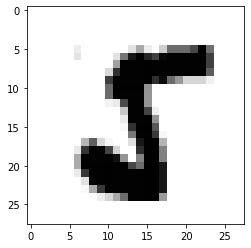

LABEL: 5
INPUT:


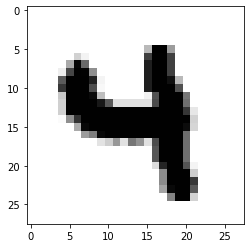

LABEL: 4
INPUT:


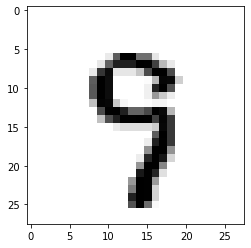

LABEL: 9
INPUT:


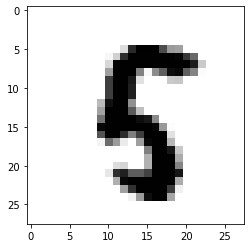

LABEL: 5
INPUT:


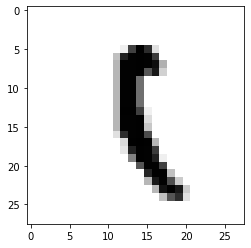

LABEL: 1
INPUT:


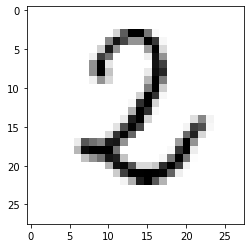

LABEL: 2
INPUT:


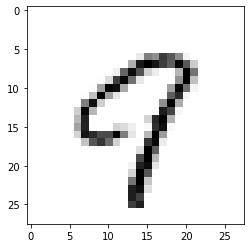

LABEL: 9
INPUT:


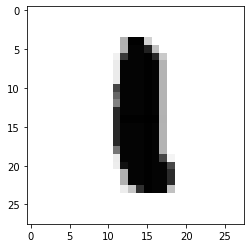

LABEL: 1
INPUT:


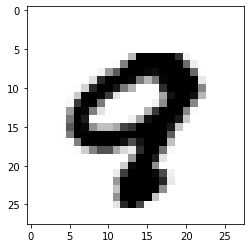

LABEL: 9
INPUT:


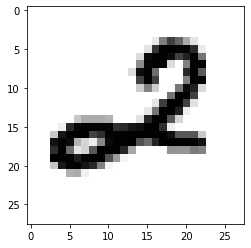

LABEL: 2
INPUT:


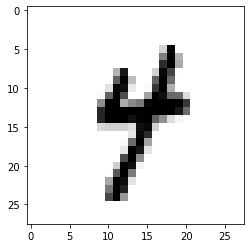

LABEL: 4
INPUT:


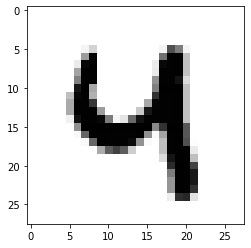

LABEL: 4
INPUT:


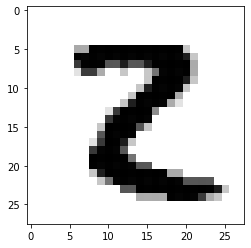

LABEL: 2
INPUT:


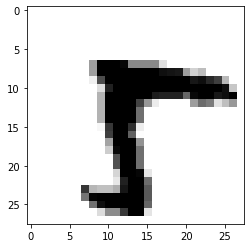

LABEL: 5
INPUT:


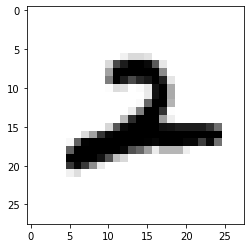

LABEL: 2
INPUT:


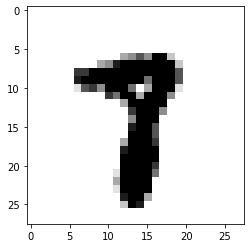

LABEL: 8
INPUT:


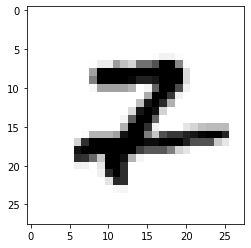

LABEL: 7
INPUT:


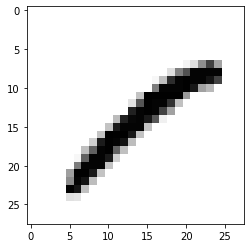

LABEL: 1
INPUT:


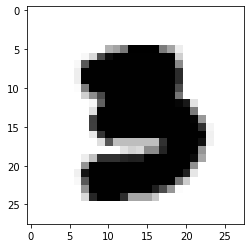

LABEL: 3
INPUT:


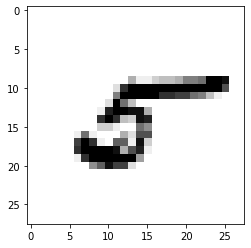

LABEL: 5
INPUT:


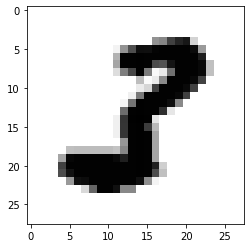

LABEL: 3
INPUT:


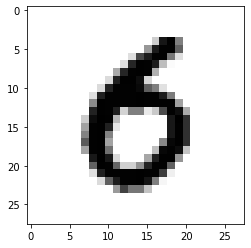

LABEL: 6
INPUT:


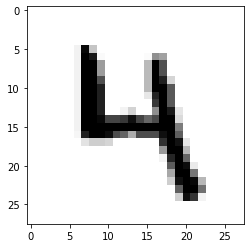

LABEL: 4
INPUT:


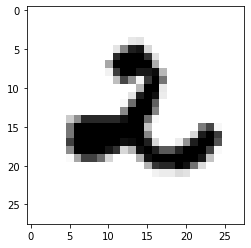

LABEL: 2
INPUT:


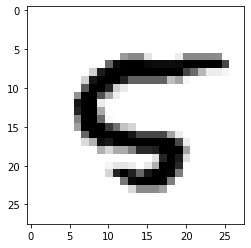

LABEL: 5
INPUT:


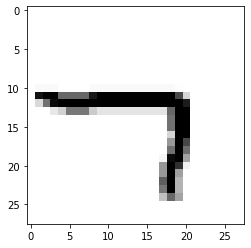

LABEL: 7
INPUT:


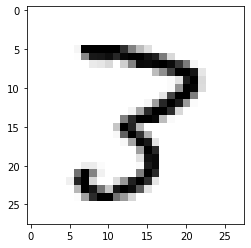

LABEL: 3
INPUT:


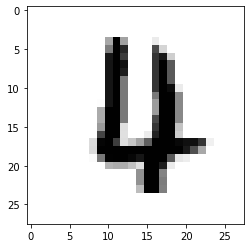

LABEL: 4
INPUT:


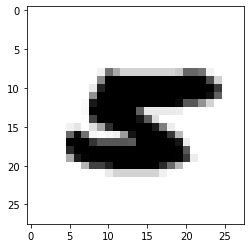

LABEL: 5
INPUT:


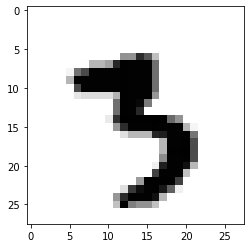

LABEL: 3
INPUT:


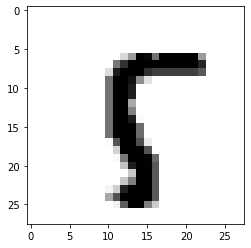

LABEL: 5
INPUT:


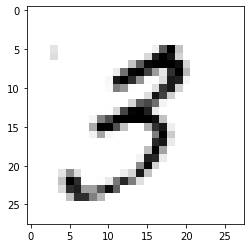

LABEL: 3
INPUT:


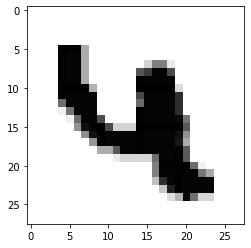

LABEL: 4
INPUT:


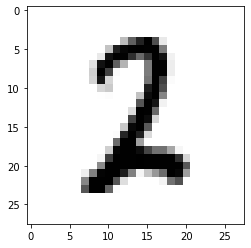

LABEL: 2
INPUT:


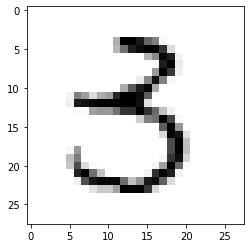

LABEL: 3
INPUT:


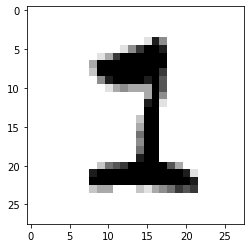

LABEL: 1
INPUT:


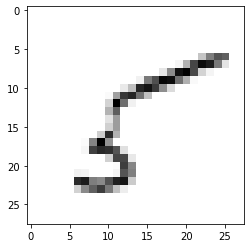

LABEL: 5
INPUT:


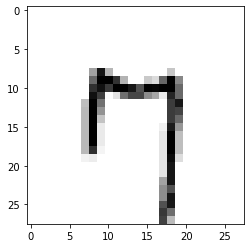

LABEL: 7
INPUT:


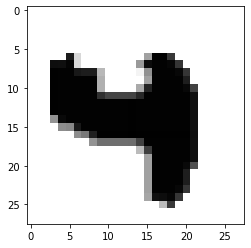

LABEL: 4
INPUT:


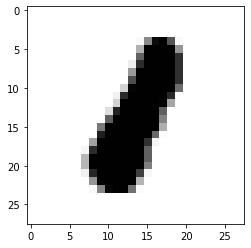

LABEL: 1
INPUT:


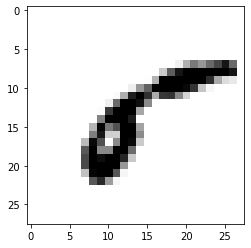

LABEL: 5
INPUT:


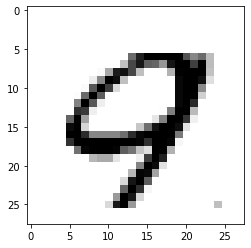

LABEL: 9
INPUT:


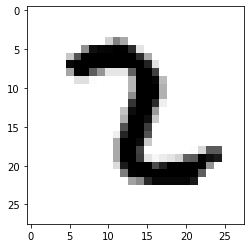

LABEL: 2
INPUT:


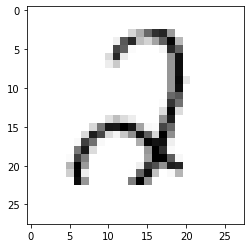

LABEL: 2
INPUT:


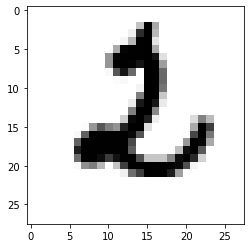

LABEL: 2
INPUT:


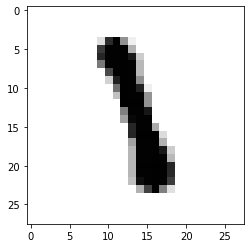

LABEL: 1
INPUT:


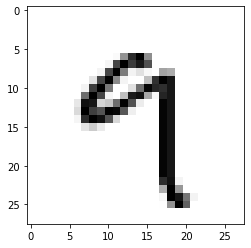

LABEL: 9
INPUT:


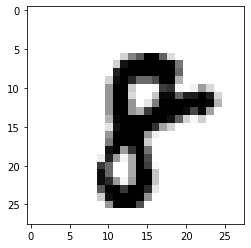

LABEL: 8
INPUT:


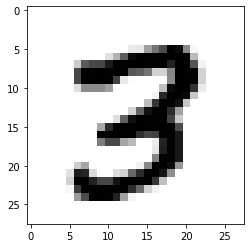

LABEL: 3
INPUT:


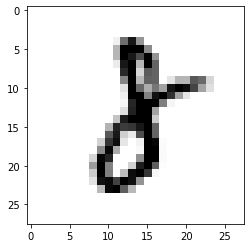

LABEL: 8
INPUT:


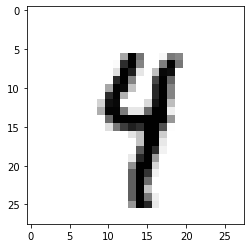

LABEL: 4
INPUT:


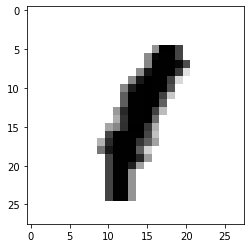

LABEL: 1
INPUT:


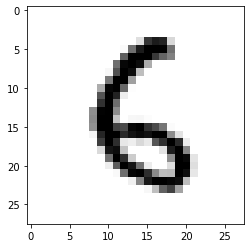

LABEL: 6
INPUT:


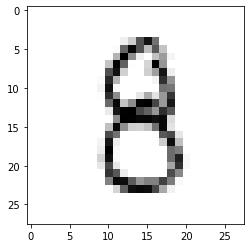

LABEL: 8
INPUT:


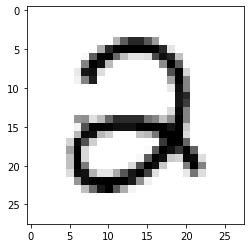

LABEL: 2
INPUT:


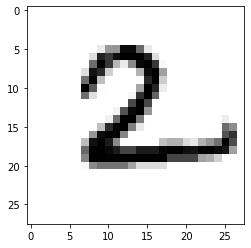

LABEL: 2
INPUT:


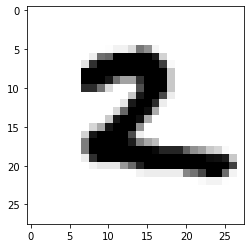

LABEL: 2
INPUT:


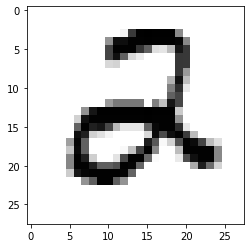

LABEL: 2
INPUT:


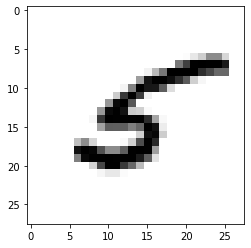

LABEL: 5
INPUT:


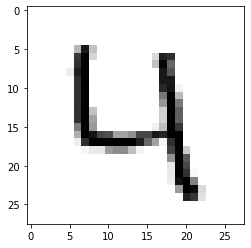

LABEL: 4
INPUT:


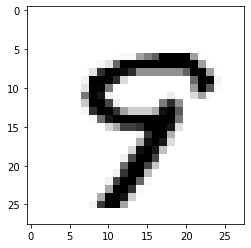

LABEL: 9
INPUT:


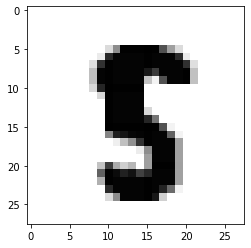

LABEL: 5
INPUT:


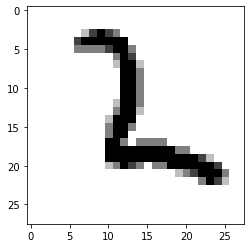

LABEL: 2
INPUT:


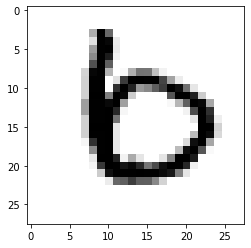

LABEL: 6
INPUT:


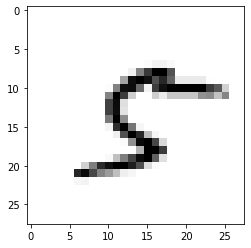

LABEL: 5
INPUT:


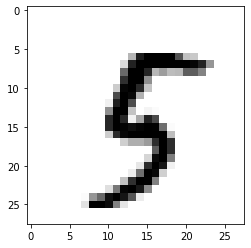

LABEL: 5
INPUT:


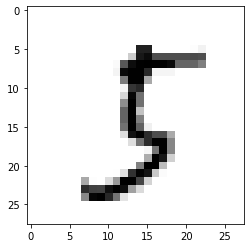

LABEL: 5
INPUT:


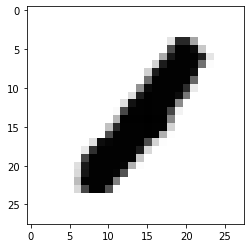

LABEL: 1
INPUT:


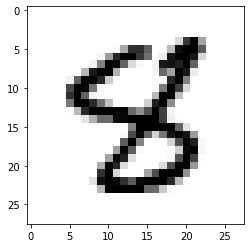

LABEL: 8
INPUT:


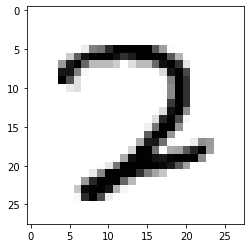

LABEL: 2
INPUT:


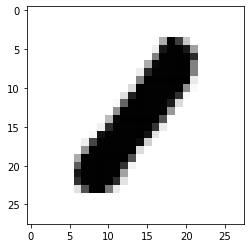

LABEL: 1
INPUT:


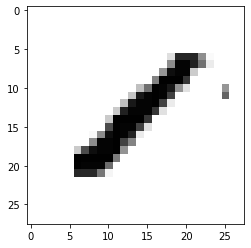

LABEL: 1
INPUT:


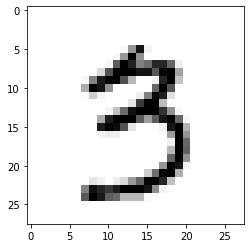

LABEL: 3
INPUT:


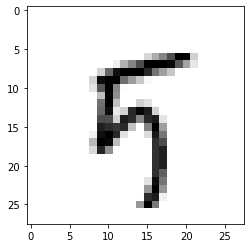

LABEL: 5
INPUT:


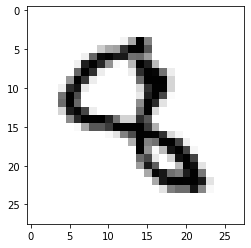

LABEL: 8
INPUT:


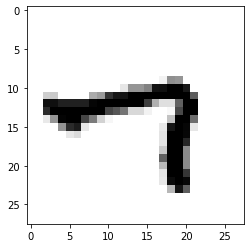

LABEL: 7
INPUT:


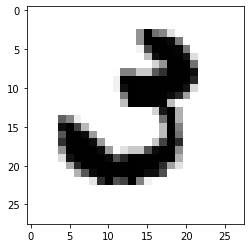

LABEL: 3
INPUT:


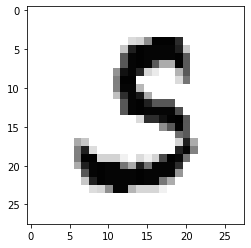

LABEL: 5
INPUT:


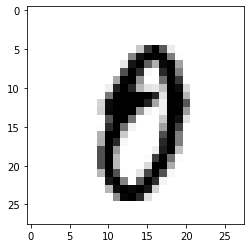

LABEL: 0
INPUT:


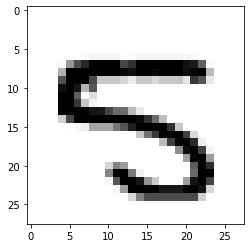

LABEL: 5
INPUT:


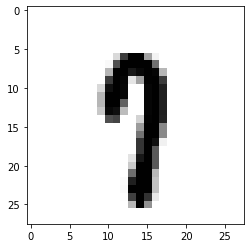

LABEL: 7
INPUT:


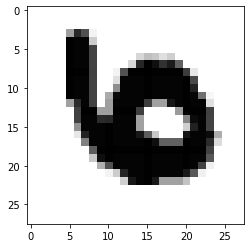

LABEL: 6
INPUT:


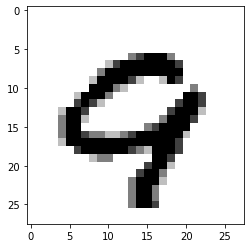

LABEL: 9
INPUT:


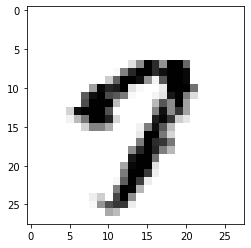

LABEL: 7
INPUT:


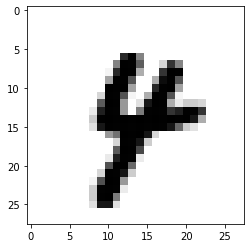

LABEL: 4
INPUT:


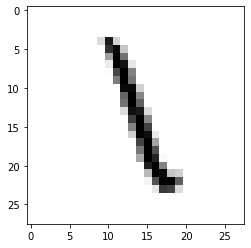

LABEL: 1
INPUT:


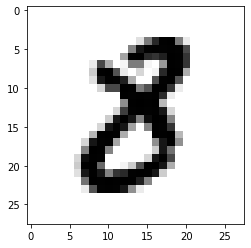

LABEL: 8
INPUT:


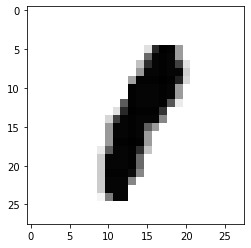

LABEL: 1
INPUT:


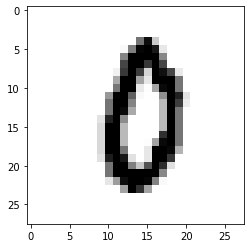

LABEL: 0
INPUT:


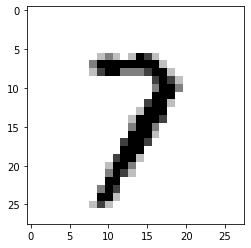

LABEL: 7
INPUT:


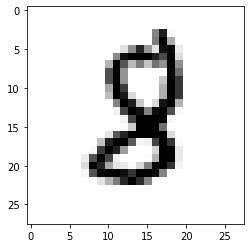

LABEL: 8
INPUT:


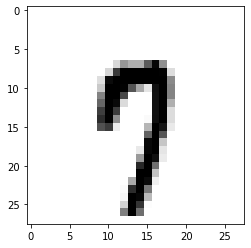

LABEL: 7
INPUT:


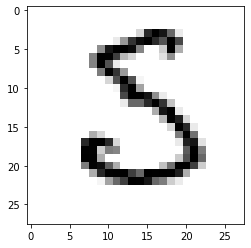

LABEL: 5
INPUT:


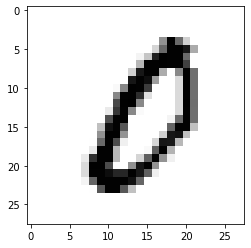

LABEL: 0
INPUT:


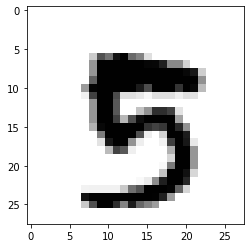

LABEL: 5
INPUT:


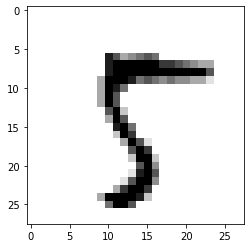

LABEL: 5
INPUT:


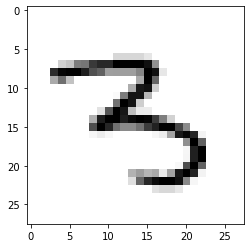

LABEL: 3
INPUT:


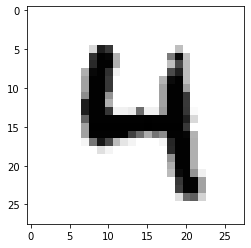

LABEL: 4
INPUT:


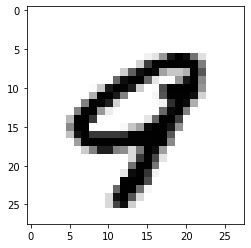

LABEL: 9
INPUT:


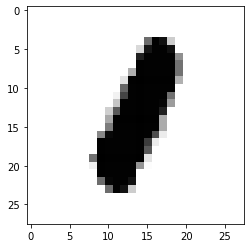

LABEL: 1
INPUT:


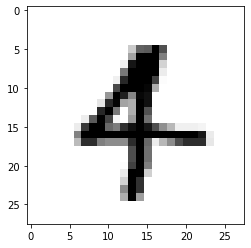

LABEL: 4
INPUT:


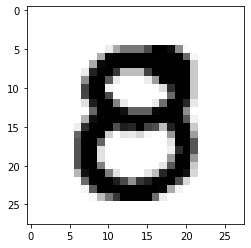

LABEL: 8
INPUT:


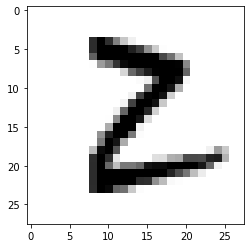

LABEL: 2
INPUT:


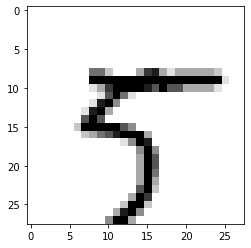

LABEL: 5
INPUT:


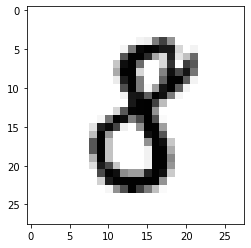

LABEL: 8
INPUT:


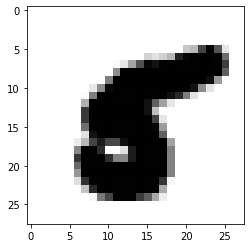

LABEL: 5
INPUT:


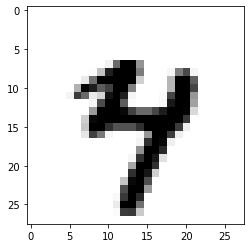

LABEL: 4
INPUT:


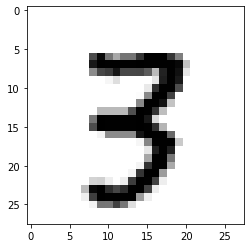

LABEL: 3
INPUT:


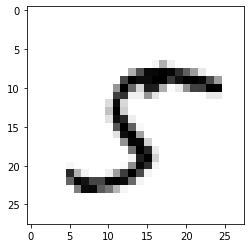

LABEL: 5
INPUT:


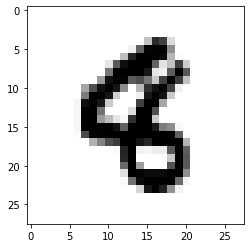

LABEL: 8
INPUT:


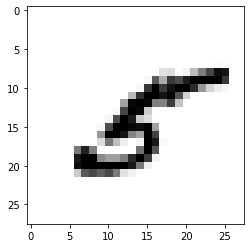

LABEL: 5
INPUT:


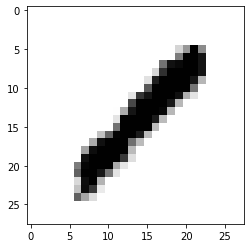

LABEL: 1
INPUT:


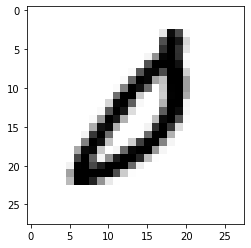

LABEL: 0
INPUT:


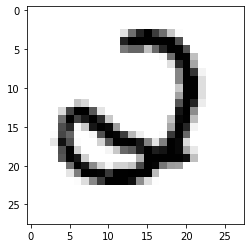

LABEL: 2
INPUT:


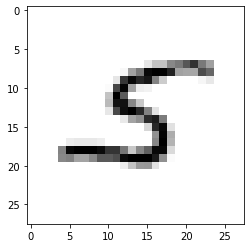

LABEL: 5
INPUT:


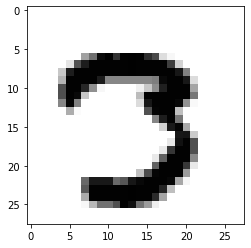

LABEL: 3
INPUT:


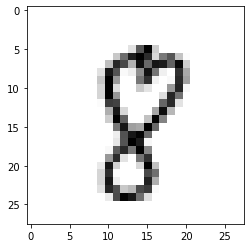

LABEL: 8
INPUT:


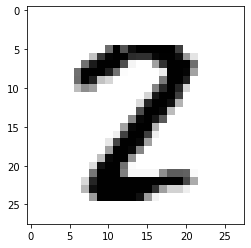

LABEL: 2
INPUT:


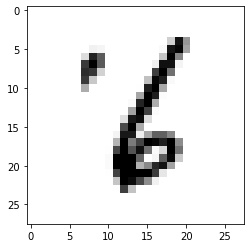

LABEL: 6
INPUT:


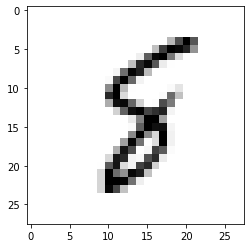

LABEL: 8
INPUT:


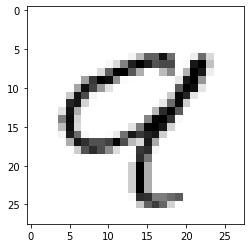

LABEL: 9
INPUT:


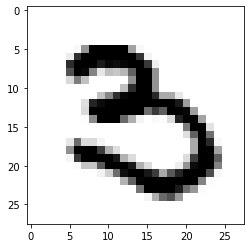

LABEL: 3
INPUT:


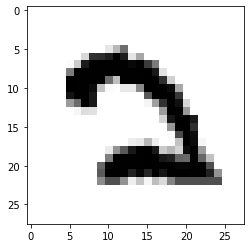

LABEL: 2
INPUT:


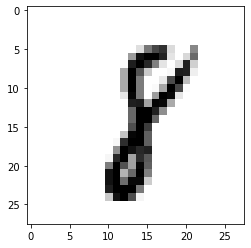

LABEL: 8
INPUT:


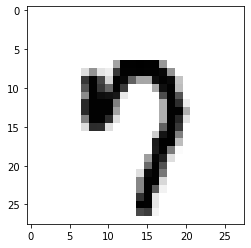

LABEL: 7
INPUT:


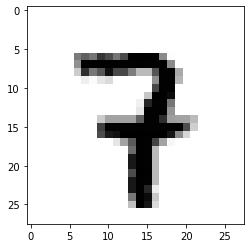

LABEL: 7
INPUT:


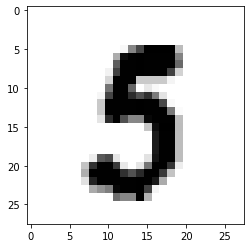

LABEL: 5
INPUT:


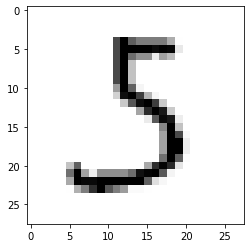

LABEL: 5
INPUT:


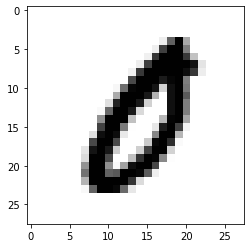

LABEL: 0
INPUT:


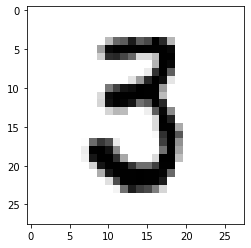

LABEL: 3
INPUT:


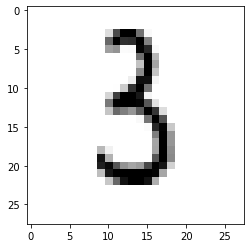

LABEL: 3
INPUT:


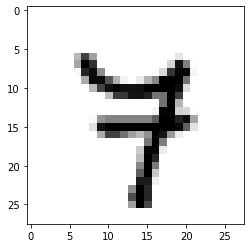

LABEL: 7
INPUT:


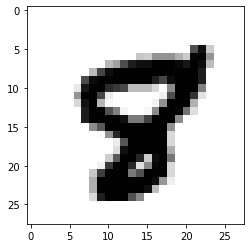

LABEL: 8
INPUT:


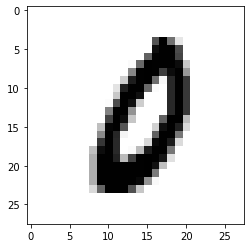

LABEL: 0
INPUT:


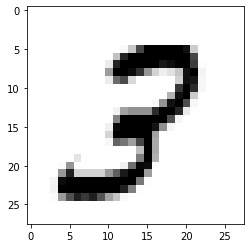

LABEL: 3
INPUT:


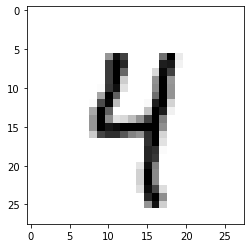

LABEL: 4
INPUT:


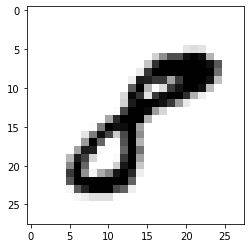

LABEL: 8
INPUT:


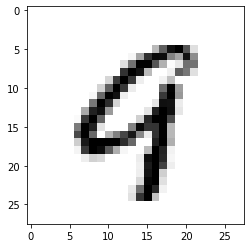

LABEL: 9
INPUT:


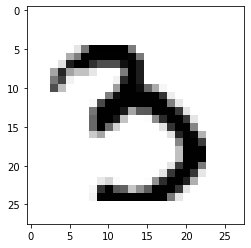

LABEL: 3
INPUT:


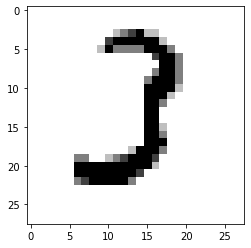

LABEL: 3
INPUT:


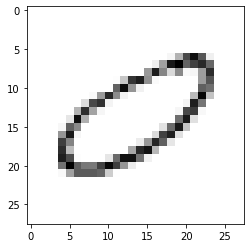

LABEL: 0
INPUT:


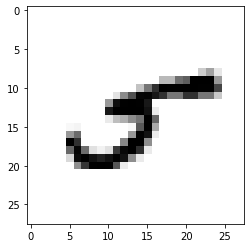

LABEL: 5
INPUT:


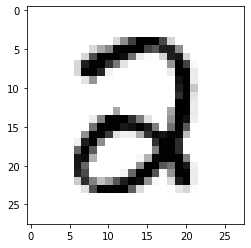

LABEL: 2
INPUT:


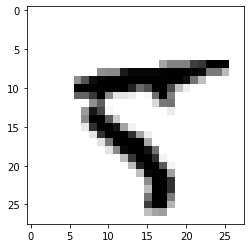

LABEL: 5
INPUT:


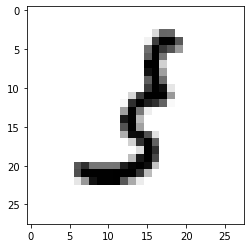

LABEL: 3
INPUT:


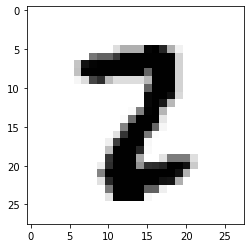

LABEL: 2
INPUT:


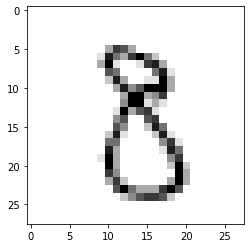

LABEL: 8
INPUT:


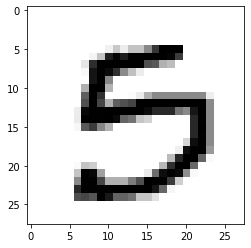

LABEL: 5
INPUT:


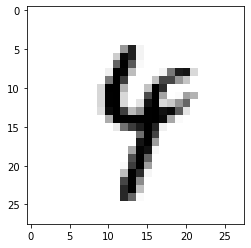

LABEL: 4
INPUT:


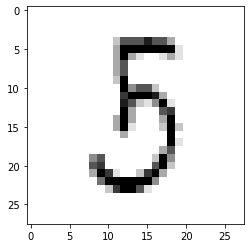

LABEL: 5
INPUT:


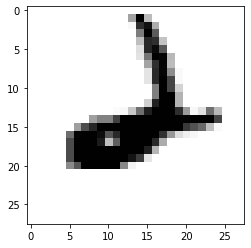

LABEL: 2
INPUT:


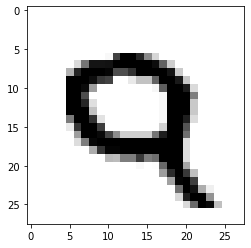

LABEL: 9
INPUT:


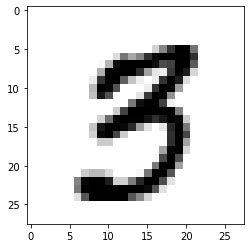

LABEL: 3
INPUT:


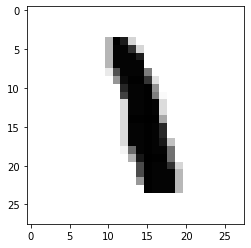

LABEL: 1
INPUT:


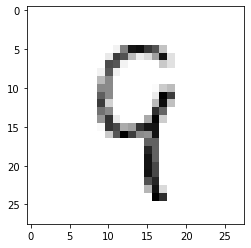

LABEL: 9
INPUT:


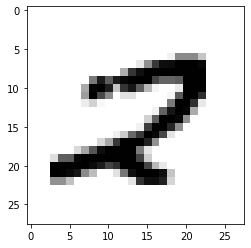

LABEL: 2
INPUT:


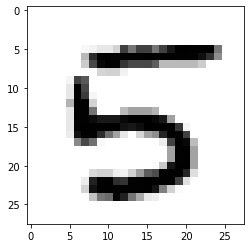

LABEL: 5
INPUT:


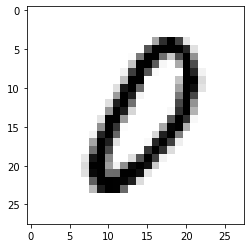

LABEL: 0
INPUT:


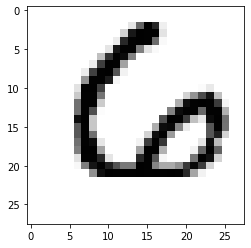

LABEL: 6
INPUT:


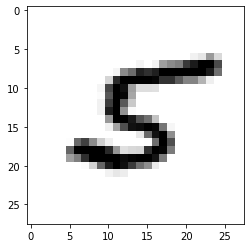

LABEL: 5
INPUT:


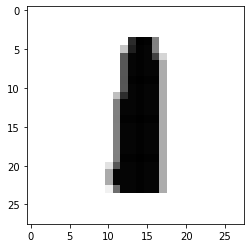

LABEL: 1
INPUT:


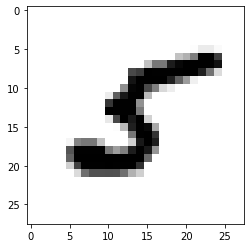

LABEL: 5
INPUT:


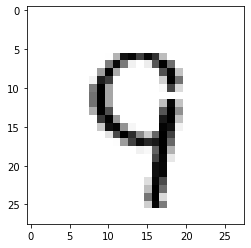

LABEL: 9
INPUT:


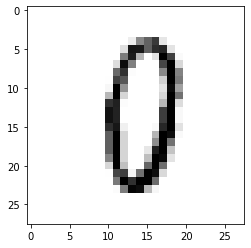

LABEL: 0
INPUT:


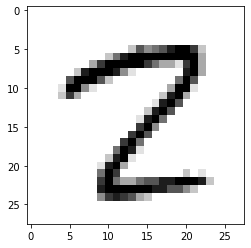

LABEL: 2
INPUT:


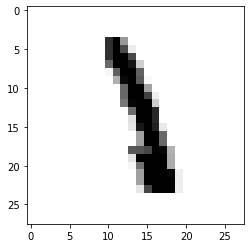

LABEL: 1
INPUT:


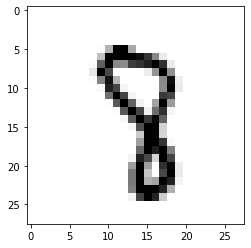

LABEL: 8
INPUT:


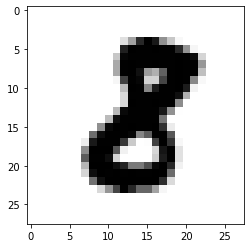

LABEL: 8
INPUT:


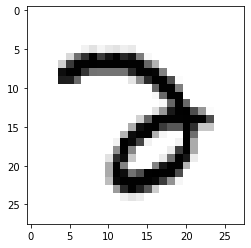

LABEL: 2
INPUT:


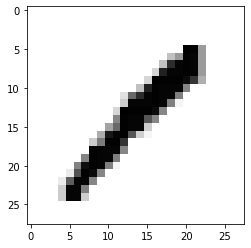

LABEL: 1
INPUT:


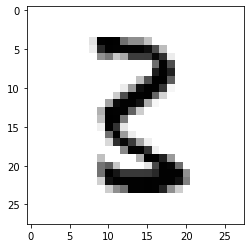

LABEL: 3
INPUT:


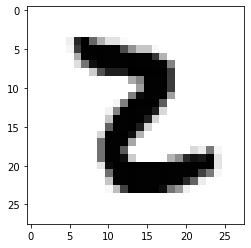

LABEL: 2
INPUT:


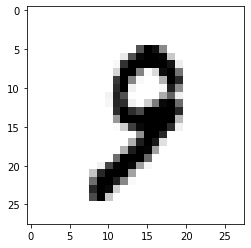

LABEL: 9
INPUT:


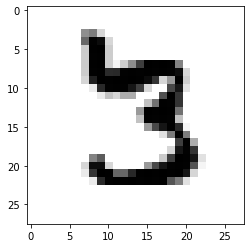

LABEL: 3
INPUT:


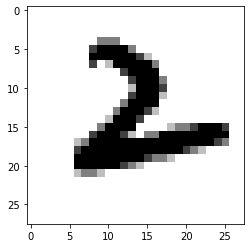

LABEL: 2
INPUT:


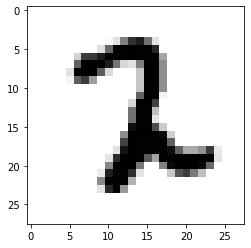

LABEL: 2
INPUT:


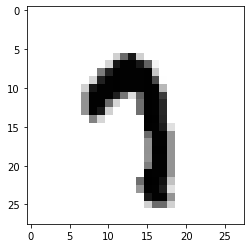

LABEL: 7
INPUT:


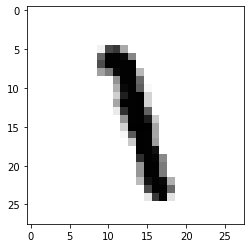

LABEL: 1
INPUT:


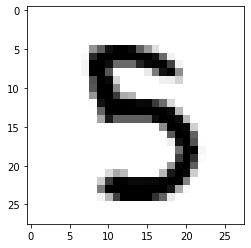

LABEL: 5
INPUT:


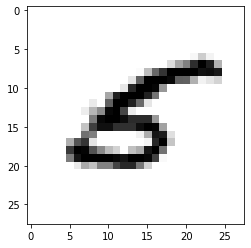

LABEL: 5
INPUT:


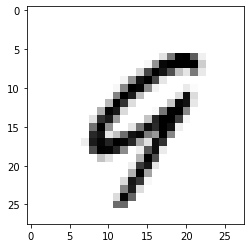

LABEL: 9
INPUT:


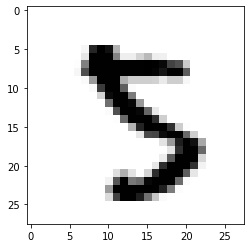

LABEL: 5
INPUT:


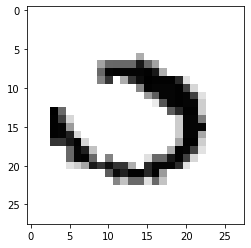

LABEL: 0
INPUT:


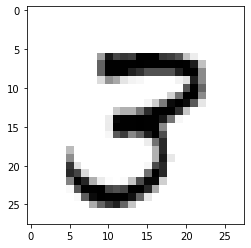

LABEL: 3
INPUT:


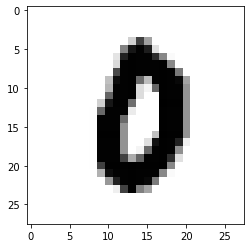

LABEL: 0
INPUT:


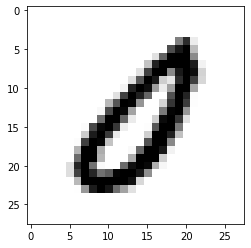

LABEL: 0
INPUT:


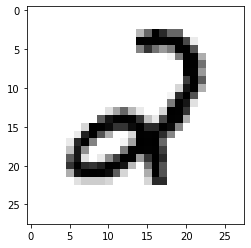

LABEL: 2
INPUT:


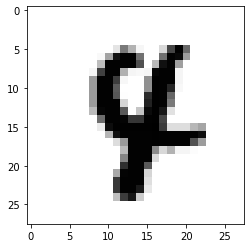

LABEL: 4
INPUT:


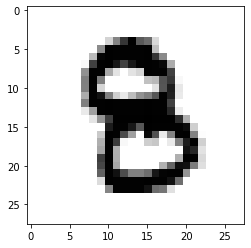

LABEL: 8
INPUT:


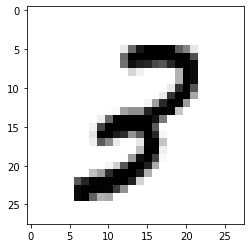

LABEL: 3
INPUT:


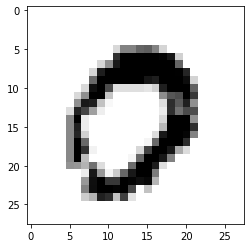

LABEL: 0
INPUT:


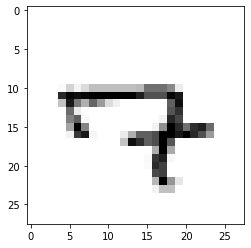

LABEL: 7
INPUT:


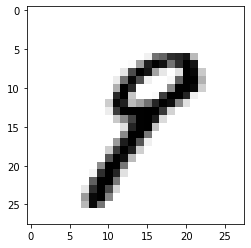

LABEL: 9
INPUT:


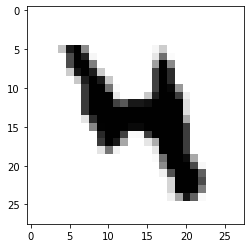

LABEL: 4
INPUT:


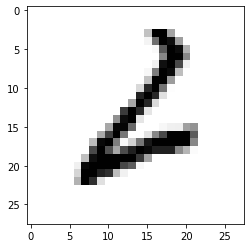

LABEL: 2
INPUT:


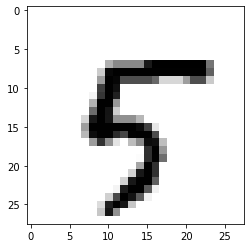

LABEL: 5
INPUT:


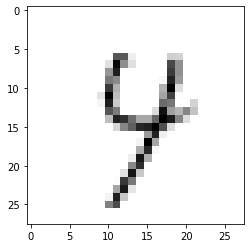

LABEL: 4
INPUT:


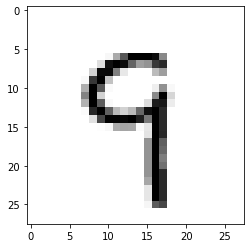

LABEL: 9
INPUT:


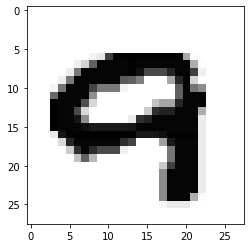

LABEL: 9
INPUT:


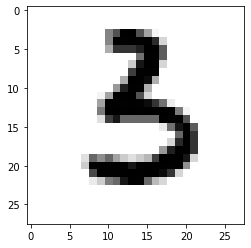

LABEL: 3
INPUT:


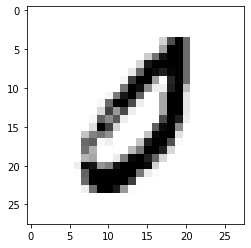

LABEL: 0
INPUT:


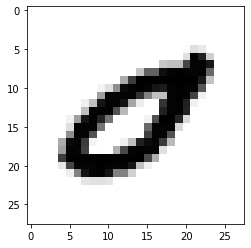

LABEL: 0
INPUT:


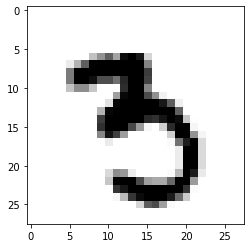

LABEL: 3
INPUT:


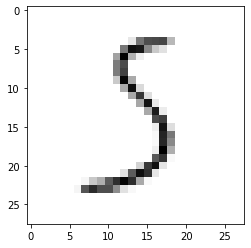

LABEL: 5
INPUT:


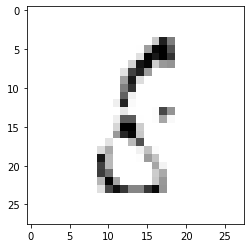

LABEL: 8
INPUT:


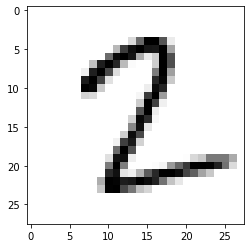

LABEL: 2
INPUT:


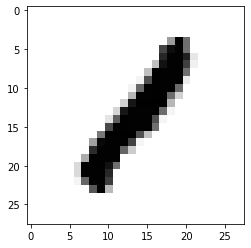

LABEL: 1
INPUT:


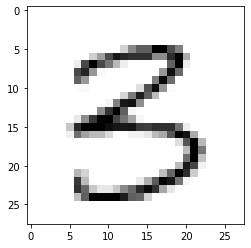

LABEL: 3
INPUT:


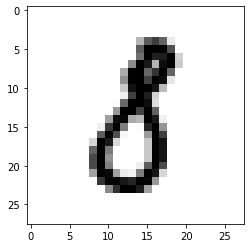

LABEL: 8
INPUT:


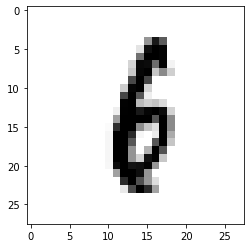

LABEL: 6
INPUT:


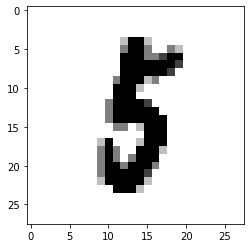

LABEL: 5
INPUT:


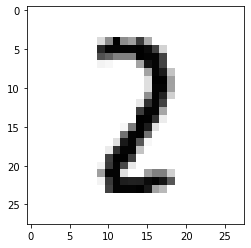

LABEL: 2
INPUT:


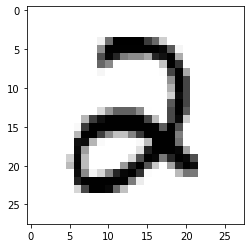

LABEL: 2
INPUT:


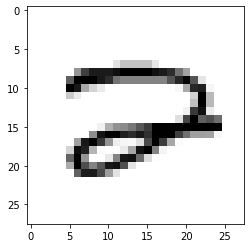

LABEL: 2
INPUT:


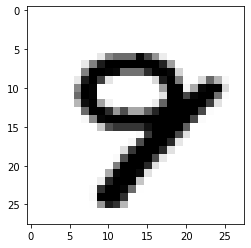

LABEL: 9
INPUT:


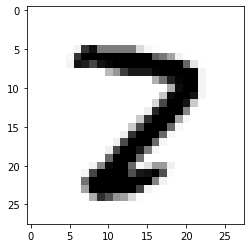

LABEL: 2
INPUT:


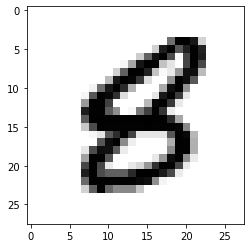

LABEL: 8
INPUT:


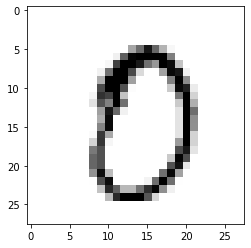

LABEL: 0
INPUT:


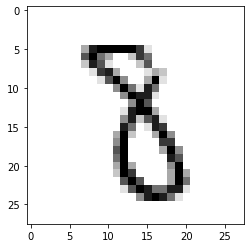

LABEL: 8
INPUT:


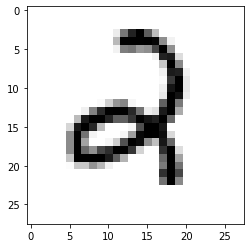

LABEL: 2
INPUT:


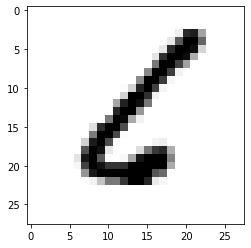

LABEL: 6
INPUT:


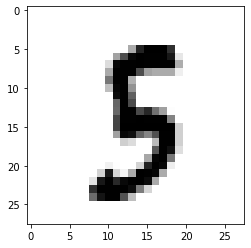

LABEL: 5
INPUT:


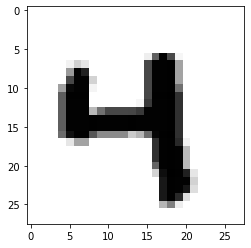

LABEL: 4
INPUT:


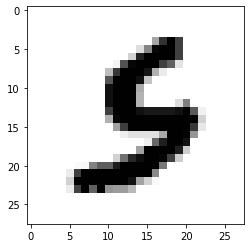

LABEL: 5
INPUT:


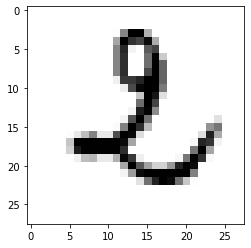

LABEL: 2
INPUT:


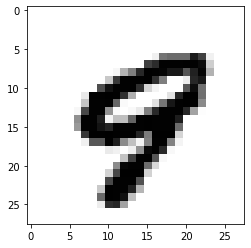

LABEL: 9
INPUT:


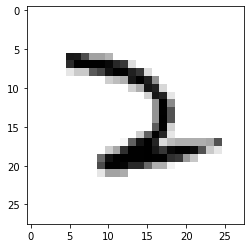

LABEL: 2
INPUT:


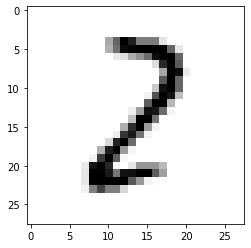

LABEL: 2
INPUT:


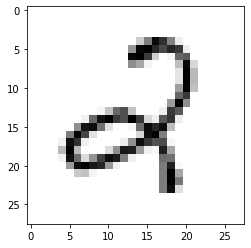

LABEL: 2
INPUT:


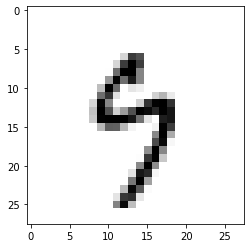

LABEL: 9
INPUT:


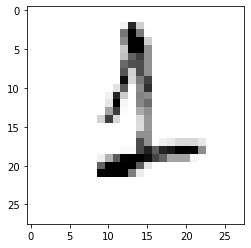

LABEL: 1
INPUT:


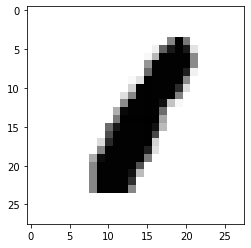

LABEL: 1
INPUT:


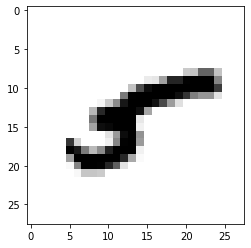

LABEL: 5
INPUT:


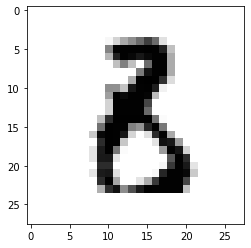

LABEL: 8
INPUT:


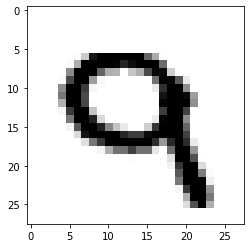

LABEL: 9
INPUT:


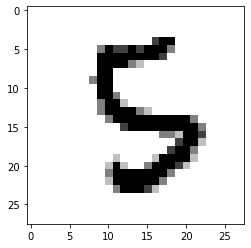

LABEL: 5
INPUT:


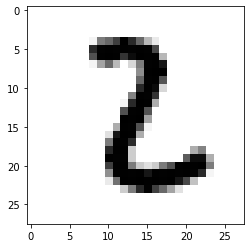

LABEL: 2
INPUT:


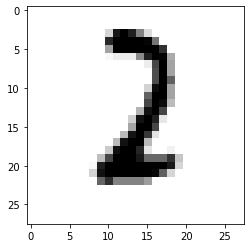

LABEL: 2
INPUT:


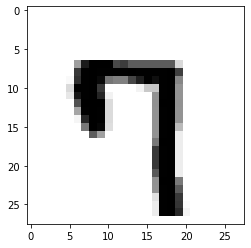

LABEL: 7
INPUT:


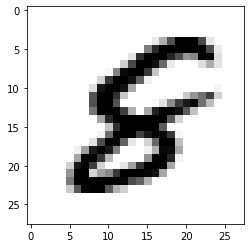

LABEL: 8
INPUT:


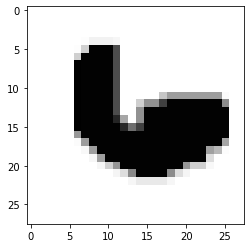

LABEL: 6
INPUT:


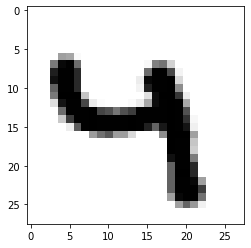

LABEL: 4
INPUT:


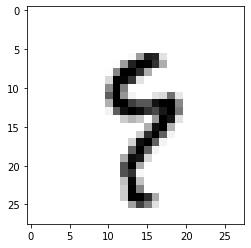

LABEL: 9
INPUT:


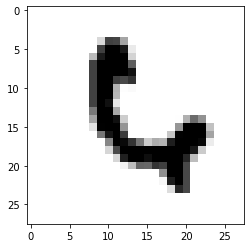

LABEL: 6
INPUT:


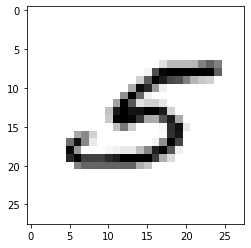

LABEL: 5
INPUT:


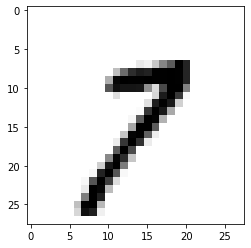

LABEL: 7
INPUT:


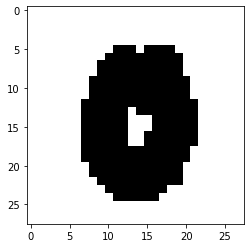

LABEL: 0
INPUT:


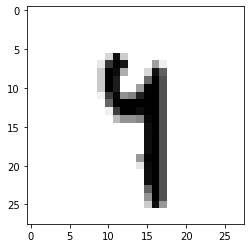

LABEL: 9
INPUT:


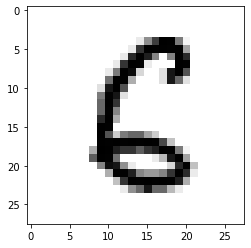

LABEL: 6
INPUT:


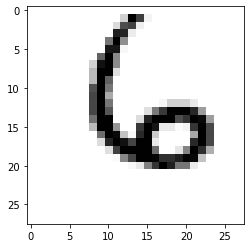

LABEL: 6
INPUT:


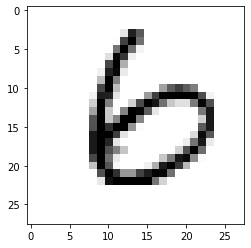

LABEL: 6
INPUT:


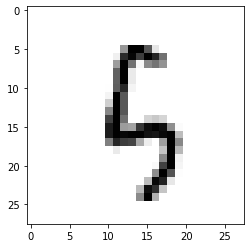

LABEL: 5
INPUT:


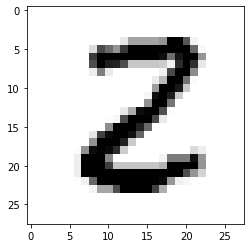

LABEL: 2
INPUT:


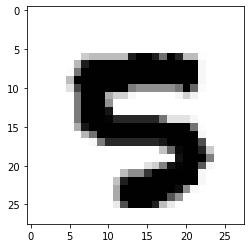

LABEL: 5
INPUT:


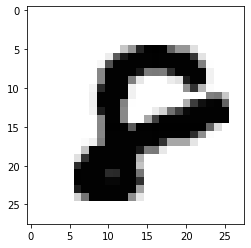

LABEL: 8
INPUT:


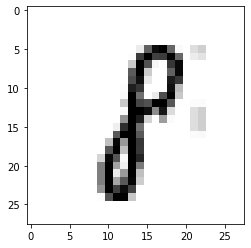

LABEL: 8
INPUT:


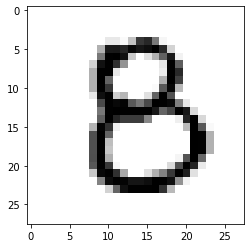

LABEL: 8
INPUT:


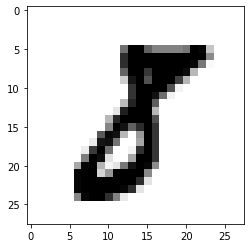

LABEL: 8
INPUT:


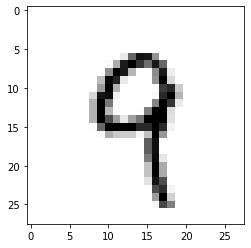

LABEL: 9
INPUT:


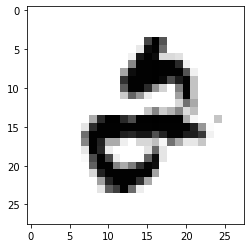

LABEL: 2
INPUT:


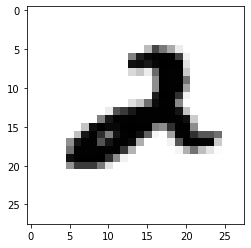

LABEL: 2
INPUT:


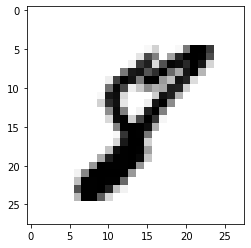

LABEL: 8
INPUT:


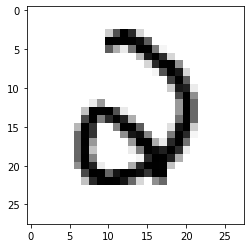

LABEL: 2
INPUT:


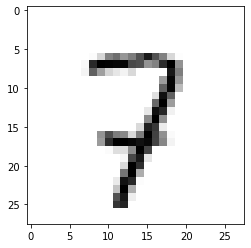

LABEL: 7
INPUT:


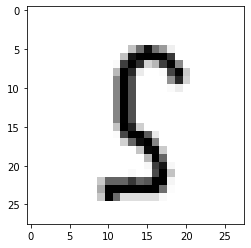

LABEL: 5
INPUT:


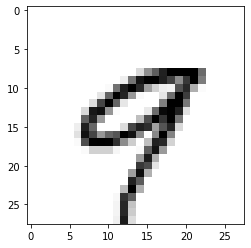

LABEL: 9
INPUT:


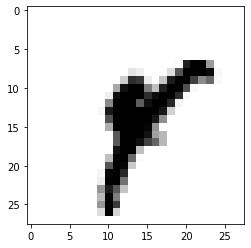

LABEL: 4
INPUT:


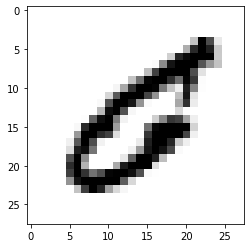

LABEL: 0
INPUT:


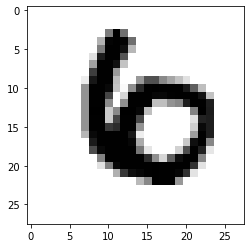

LABEL: 6
INPUT:


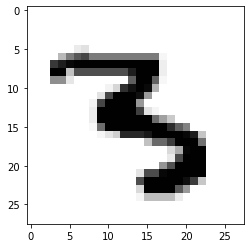

LABEL: 3
INPUT:


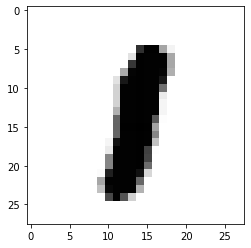

LABEL: 1
INPUT:


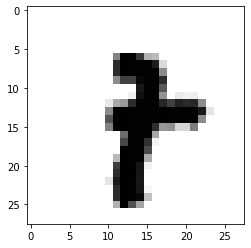

LABEL: 7
INPUT:


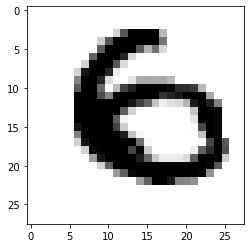

LABEL: 6
INPUT:


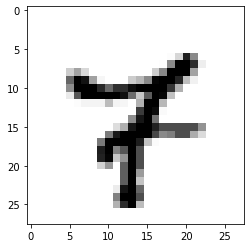

LABEL: 7
INPUT:


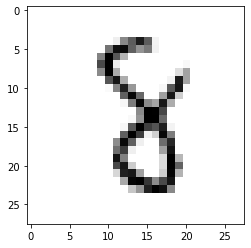

LABEL: 8
INPUT:


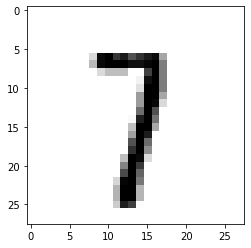

LABEL: 7
INPUT:


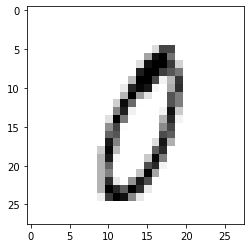

LABEL: 0
INPUT:


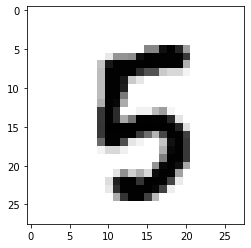

LABEL: 5
INPUT:


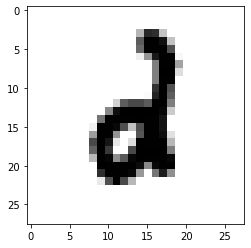

LABEL: 2
INPUT:


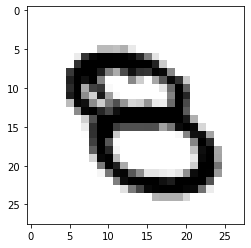

LABEL: 8
INPUT:


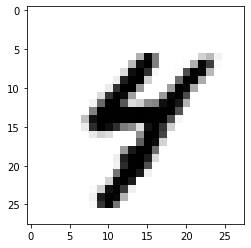

LABEL: 4
INPUT:


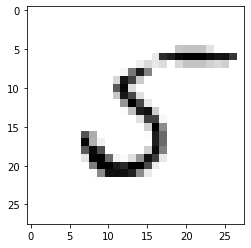

LABEL: 5
INPUT:


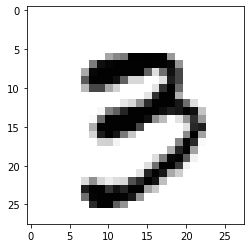

LABEL: 3
INPUT:


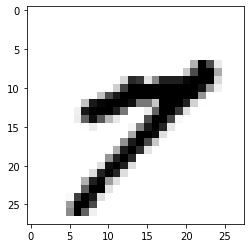

LABEL: 7
INPUT:


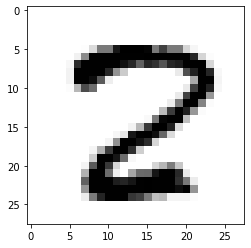

LABEL: 2
INPUT:


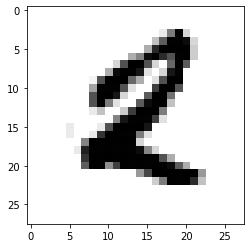

LABEL: 2
INPUT:


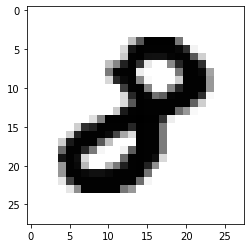

LABEL: 8
INPUT:


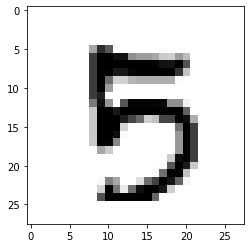

LABEL: 5
INPUT:


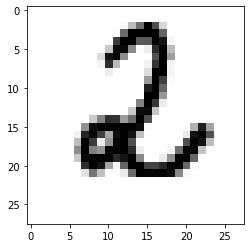

LABEL: 2
INPUT:


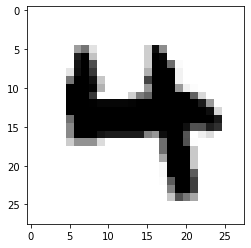

LABEL: 4
INPUT:


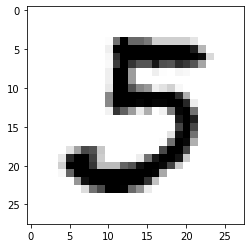

LABEL: 5
INPUT:


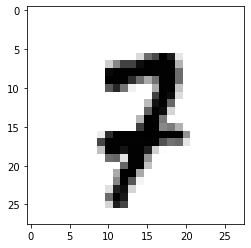

LABEL: 7
INPUT:


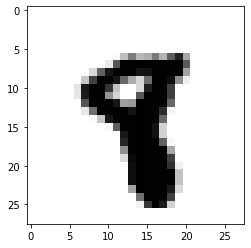

LABEL: 8
INPUT:


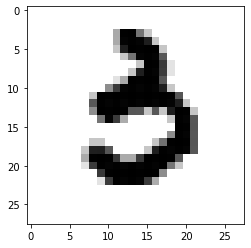

LABEL: 3
INPUT:


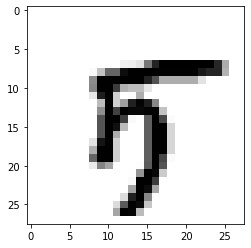

LABEL: 5
INPUT:


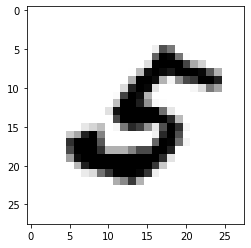

LABEL: 5
INPUT:


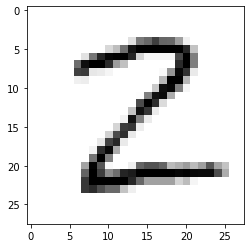

LABEL: 2
INPUT:


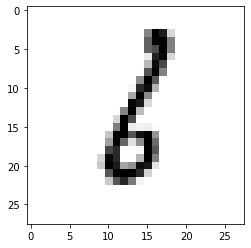

LABEL: 6
INPUT:


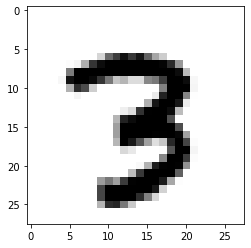

LABEL: 3
INPUT:


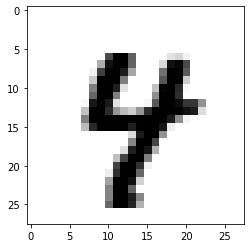

LABEL: 4
INPUT:


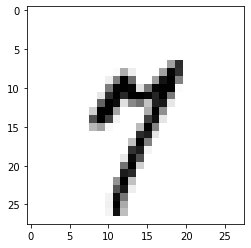

LABEL: 7
INPUT:


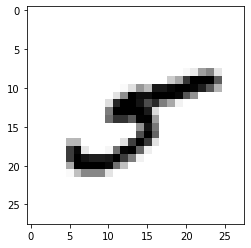

LABEL: 5
INPUT:


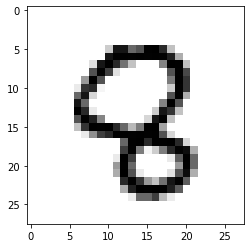

LABEL: 8
INPUT:


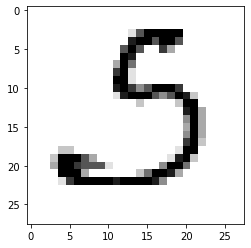

LABEL: 5
INPUT:


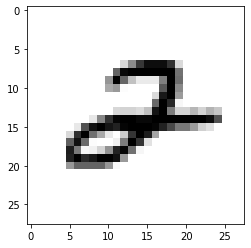

LABEL: 2
INPUT:


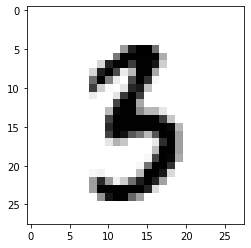

LABEL: 3
INPUT:


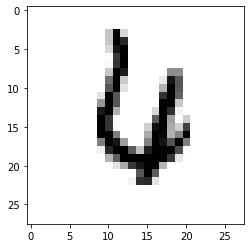

LABEL: 4
INPUT:


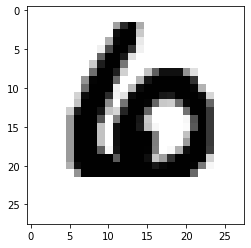

LABEL: 6
INPUT:


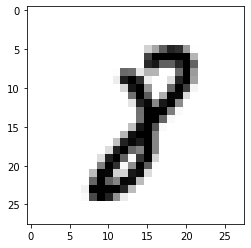

LABEL: 8
INPUT:


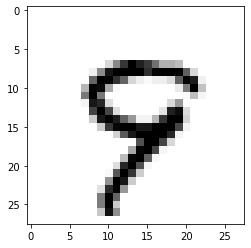

LABEL: 9
INPUT:


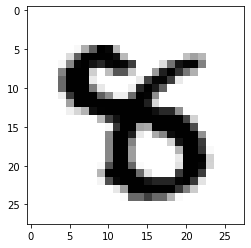

LABEL: 8
INPUT:


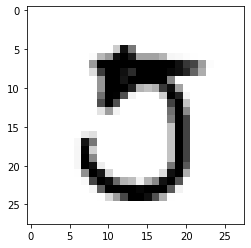

LABEL: 5
INPUT:


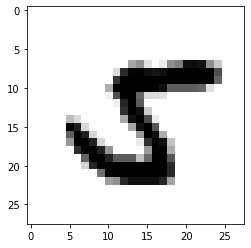

LABEL: 5
INPUT:


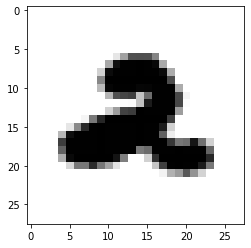

LABEL: 2
INPUT:


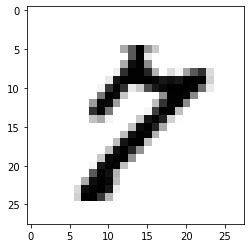

LABEL: 7
INPUT:


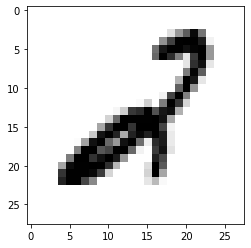

LABEL: 2
INPUT:


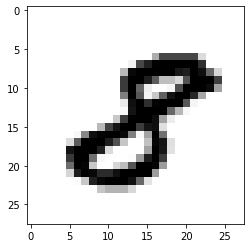

LABEL: 8
INPUT:


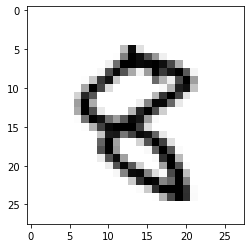

LABEL: 8
INPUT:


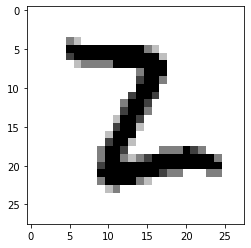

LABEL: 2
INPUT:


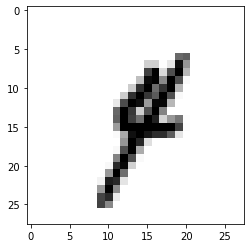

LABEL: 4
INPUT:


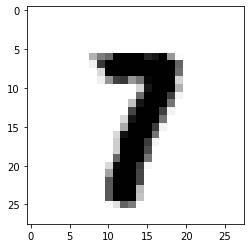

LABEL: 7
INPUT:


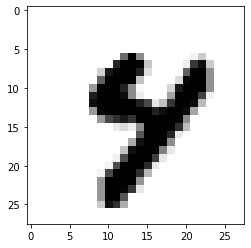

LABEL: 4
INPUT:


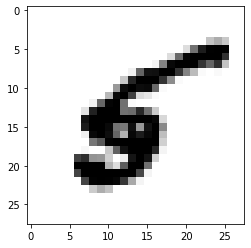

LABEL: 5
INPUT:


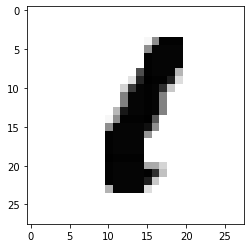

LABEL: 1
INPUT:


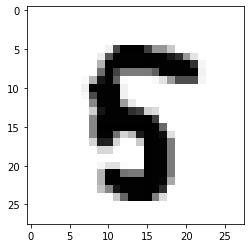

LABEL: 5
INPUT:


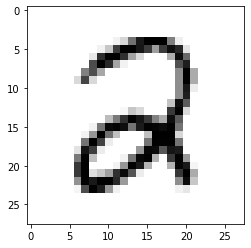

LABEL: 2
INPUT:


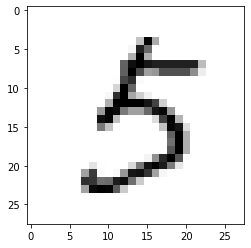

LABEL: 5
INPUT:


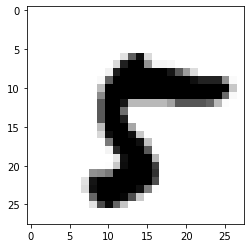

LABEL: 5
INPUT:


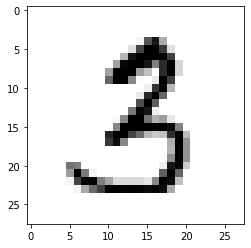

LABEL: 3
INPUT:


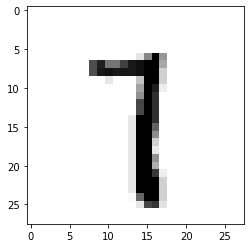

LABEL: 7
INPUT:


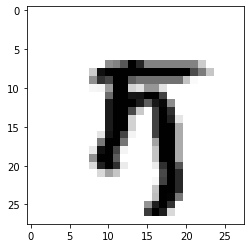

LABEL: 5
INPUT:


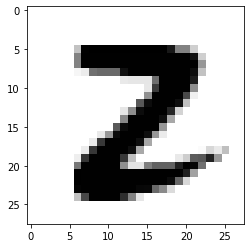

LABEL: 2
INPUT:


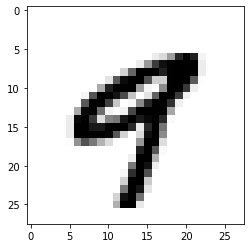

LABEL: 9
INPUT:


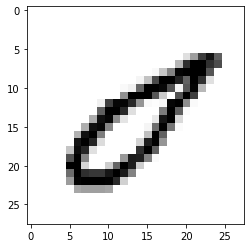

LABEL: 0
INPUT:


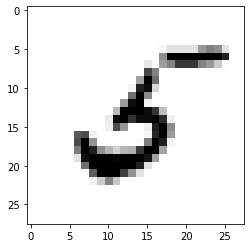

LABEL: 5
INPUT:


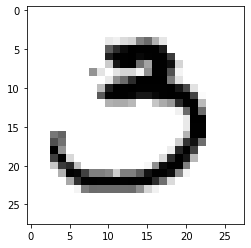

LABEL: 3
INPUT:


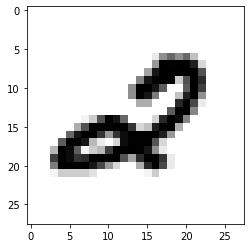

LABEL: 2
INPUT:


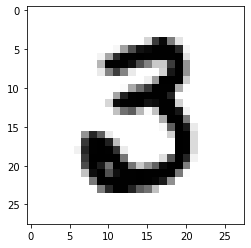

LABEL: 3
INPUT:


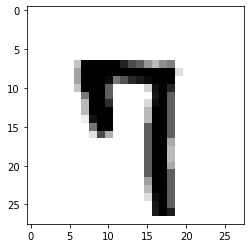

LABEL: 7
INPUT:


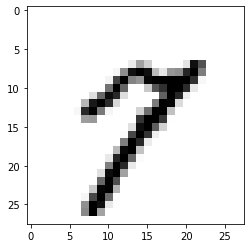

LABEL: 7
INPUT:


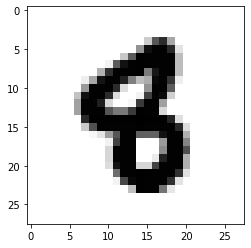

LABEL: 8
INPUT:


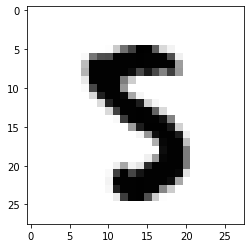

LABEL: 5
INPUT:


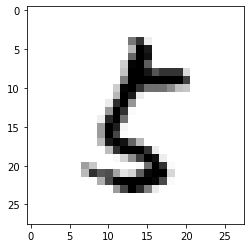

LABEL: 5
INPUT:


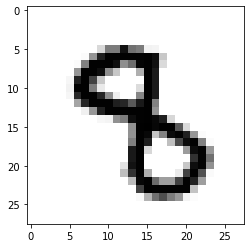

LABEL: 8
INPUT:


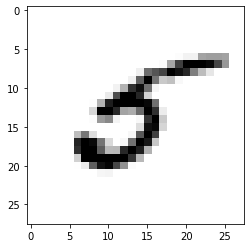

LABEL: 5
INPUT:


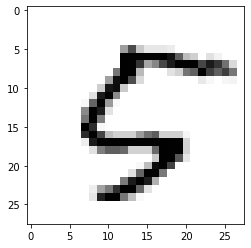

LABEL: 5
INPUT:


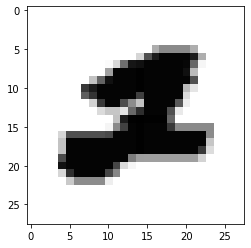

LABEL: 2
INPUT:


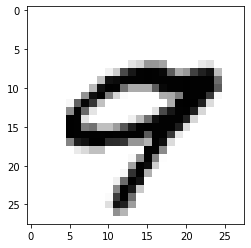

LABEL: 9
INPUT:


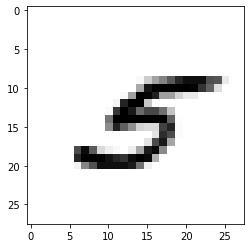

LABEL: 5
INPUT:


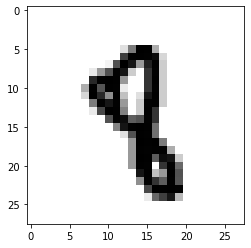

LABEL: 8
INPUT:


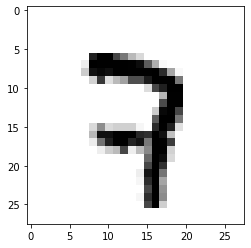

LABEL: 7
INPUT:


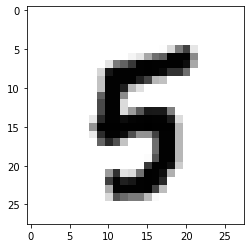

LABEL: 5
INPUT:


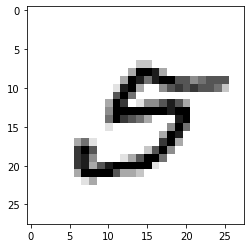

LABEL: 5
INPUT:


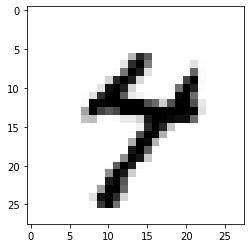

LABEL: 4
INPUT:


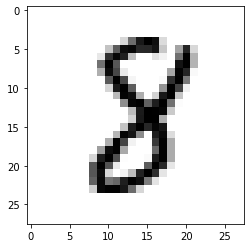

LABEL: 8
INPUT:


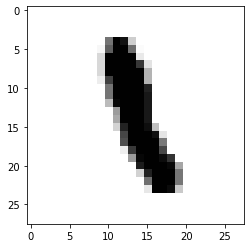

LABEL: 1
INPUT:


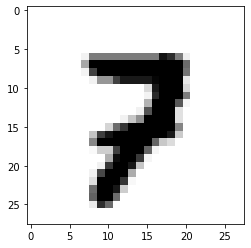

LABEL: 7
INPUT:


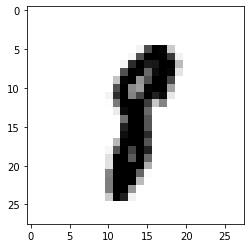

LABEL: 8
INPUT:


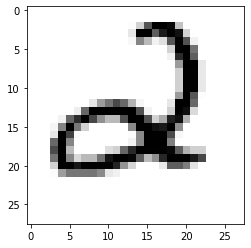

LABEL: 2
INPUT:


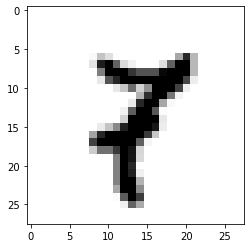

LABEL: 7
INPUT:


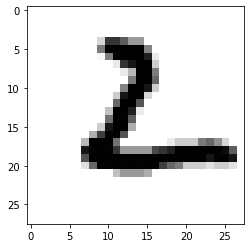

LABEL: 2
INPUT:


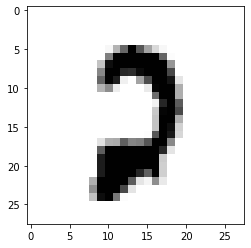

LABEL: 2
INPUT:


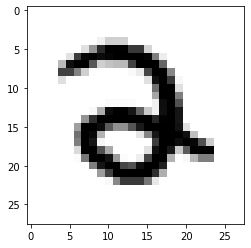

LABEL: 2
INPUT:


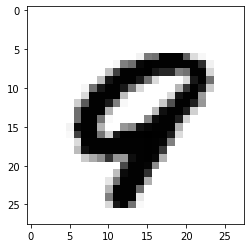

LABEL: 9
INPUT:


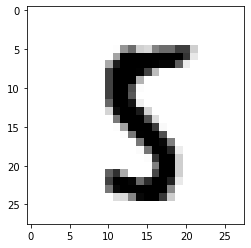

LABEL: 5
INPUT:


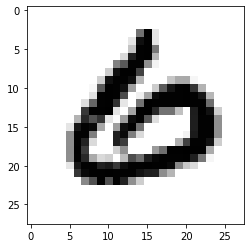

LABEL: 6
INPUT:


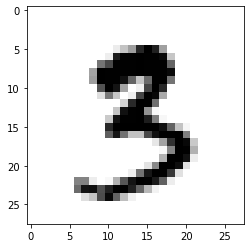

LABEL: 3
INPUT:


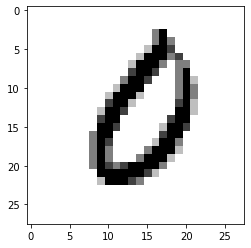

LABEL: 0
INPUT:


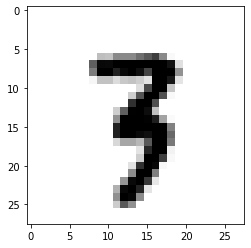

LABEL: 3
INPUT:


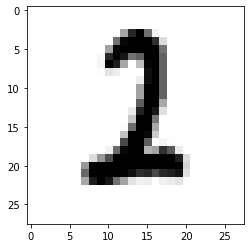

LABEL: 2
INPUT:


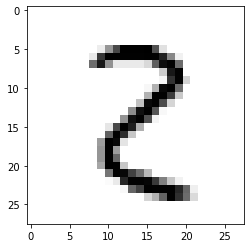

LABEL: 2
INPUT:


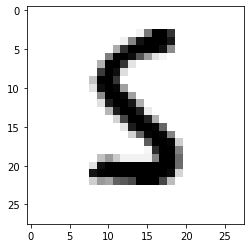

LABEL: 5
INPUT:


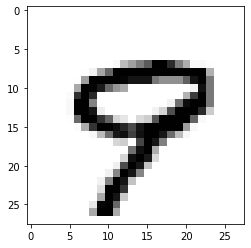

LABEL: 9
INPUT:


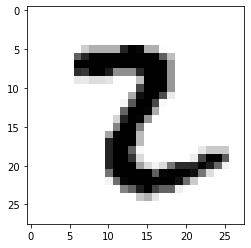

LABEL: 2
INPUT:


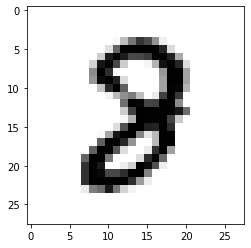

LABEL: 8
INPUT:


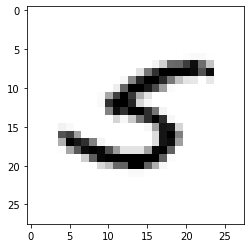

LABEL: 5
INPUT:


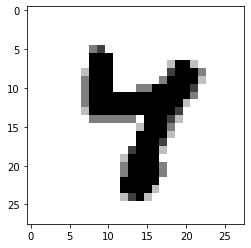

LABEL: 4
INPUT:


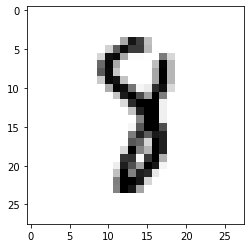

LABEL: 8
INPUT:


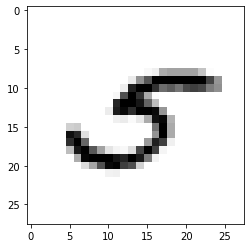

LABEL: 5
INPUT:


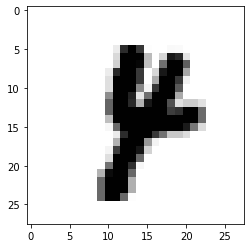

LABEL: 4
INPUT:


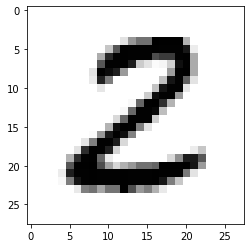

LABEL: 2
INPUT:


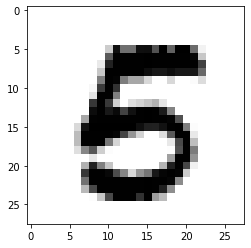

LABEL: 5
INPUT:


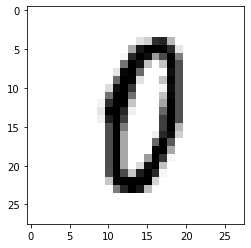

LABEL: 0
INPUT:


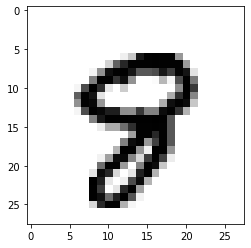

LABEL: 8
INPUT:


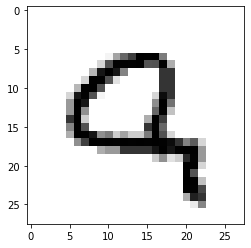

LABEL: 9
INPUT:


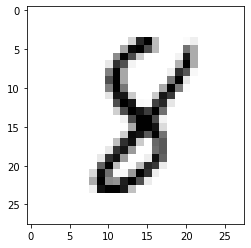

LABEL: 8
INPUT:


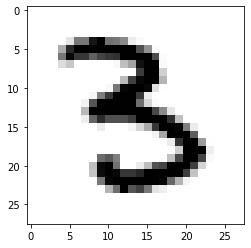

LABEL: 3
INPUT:


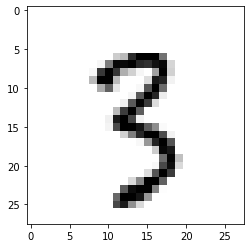

LABEL: 3
INPUT:


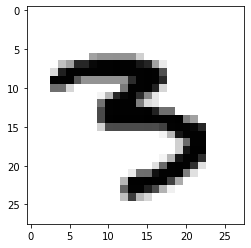

LABEL: 3
INPUT:


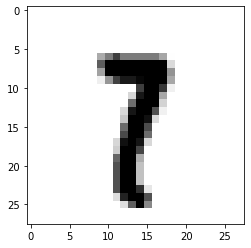

LABEL: 7
INPUT:


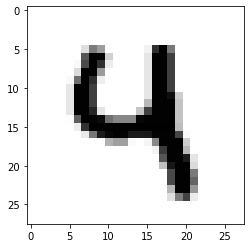

LABEL: 4
INPUT:


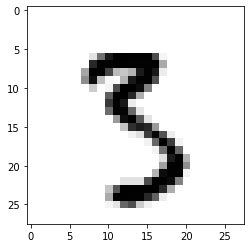

LABEL: 3
INPUT:


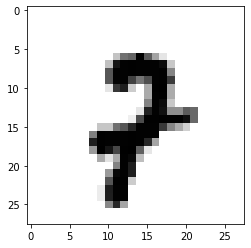

LABEL: 7
INPUT:


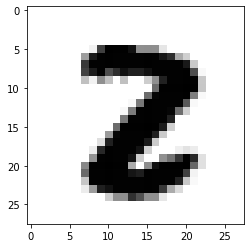

LABEL: 2
INPUT:


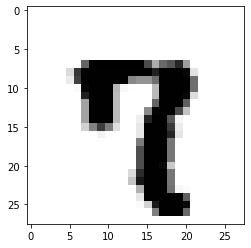

LABEL: 7
INPUT:


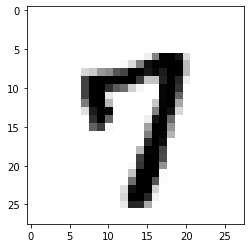

LABEL: 7
INPUT:


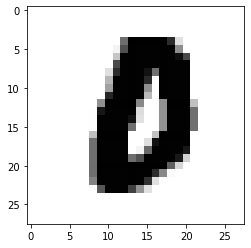

LABEL: 0
INPUT:


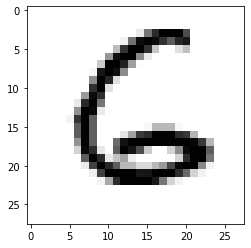

LABEL: 6
INPUT:


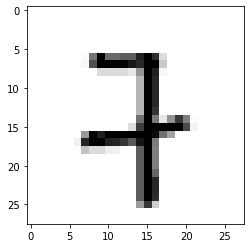

LABEL: 7
INPUT:


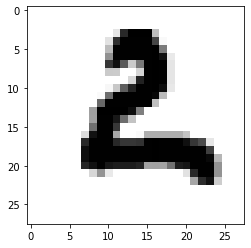

LABEL: 2
INPUT:


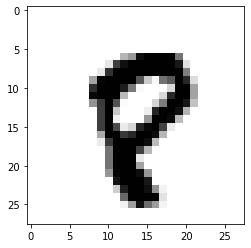

LABEL: 8
INPUT:


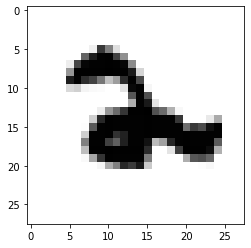

LABEL: 2
INPUT:


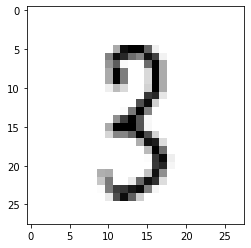

LABEL: 3
INPUT:


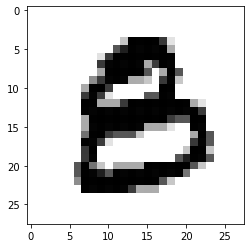

LABEL: 8
INPUT:


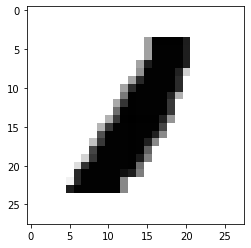

LABEL: 1
INPUT:


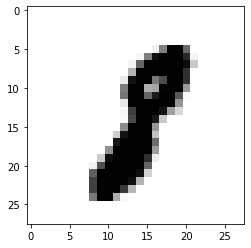

LABEL: 8
INPUT:


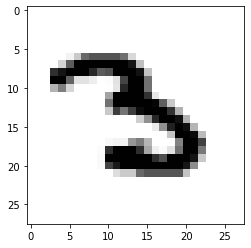

LABEL: 3
INPUT:


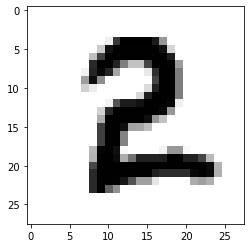

LABEL: 2
INPUT:


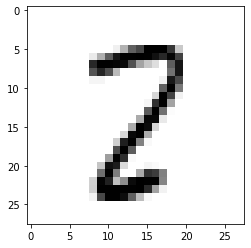

LABEL: 2
INPUT:


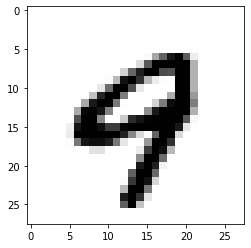

LABEL: 9
INPUT:


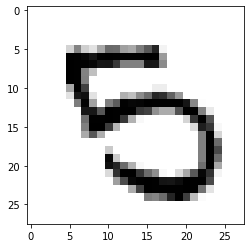

LABEL: 5
INPUT:


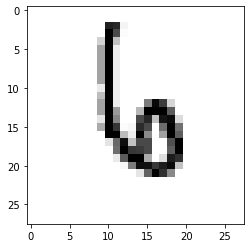

LABEL: 6
INPUT:


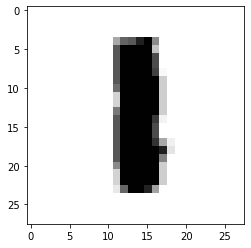

LABEL: 1
INPUT:


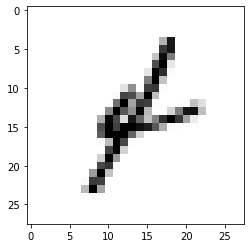

LABEL: 4
INPUT:


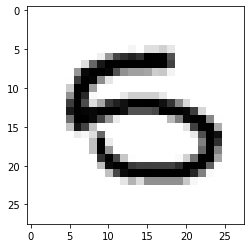

LABEL: 5
INPUT:


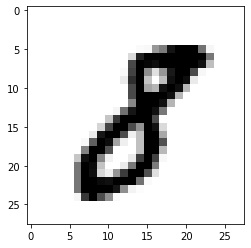

LABEL: 8
INPUT:


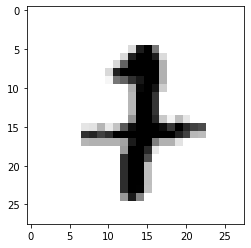

LABEL: 7
INPUT:


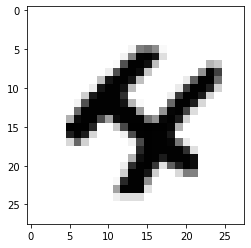

LABEL: 4
INPUT:


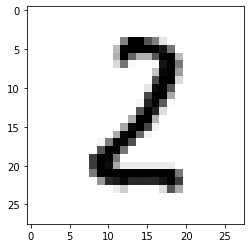

LABEL: 2
INPUT:


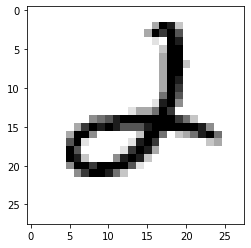

LABEL: 2
INPUT:


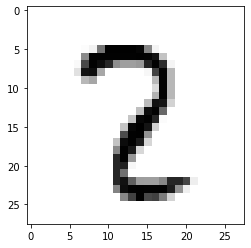

LABEL: 2
INPUT:


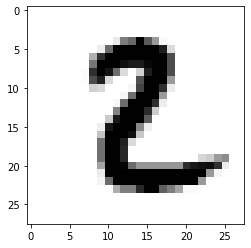

LABEL: 2
INPUT:


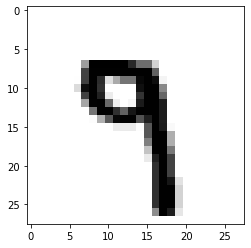

LABEL: 9
INPUT:


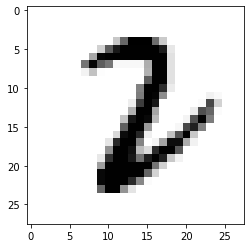

LABEL: 2
INPUT:


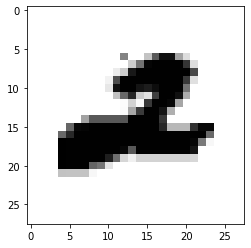

LABEL: 2
INPUT:


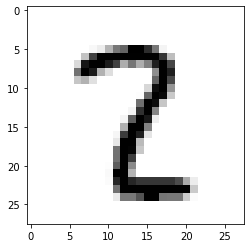

LABEL: 2
INPUT:


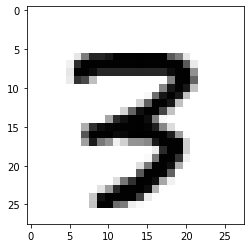

LABEL: 3
INPUT:


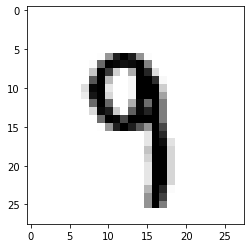

LABEL: 9
INPUT:


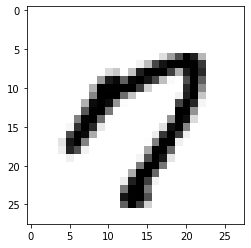

LABEL: 7
INPUT:


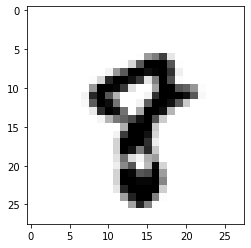

LABEL: 8
INPUT:


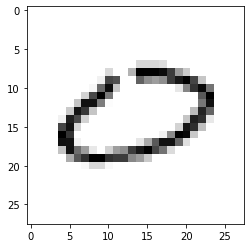

LABEL: 0
INPUT:


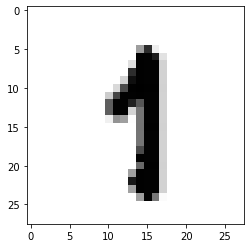

LABEL: 1
INPUT:


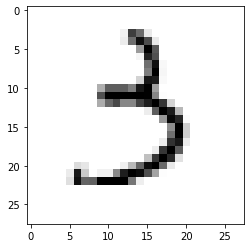

LABEL: 3
INPUT:


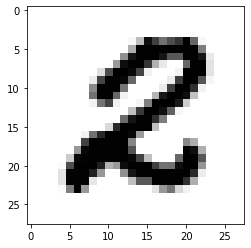

LABEL: 2
INPUT:


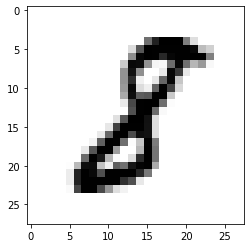

LABEL: 8
INPUT:


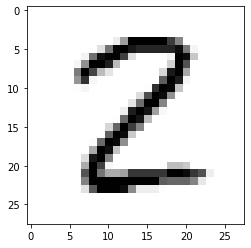

LABEL: 2
INPUT:


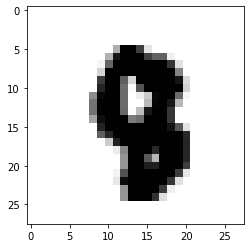

LABEL: 8
INPUT:


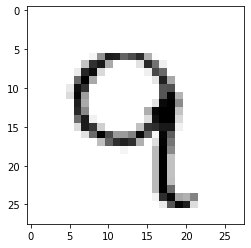

LABEL: 9
INPUT:


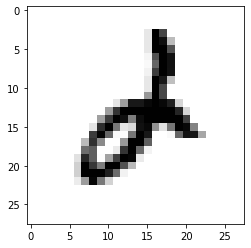

LABEL: 2
INPUT:


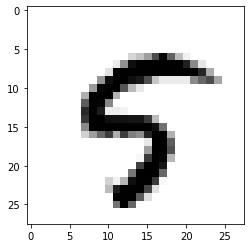

LABEL: 5
INPUT:


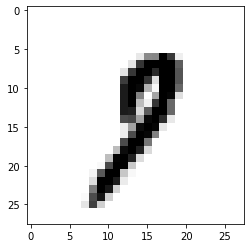

LABEL: 9
INPUT:


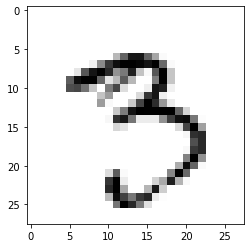

LABEL: 3
INPUT:


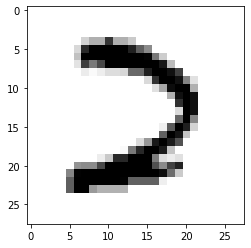

LABEL: 2
INPUT:


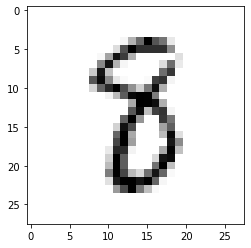

LABEL: 8
INPUT:


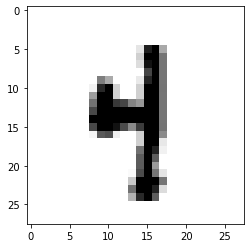

LABEL: 4
INPUT:


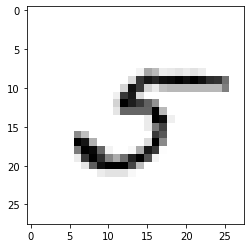

LABEL: 5
INPUT:


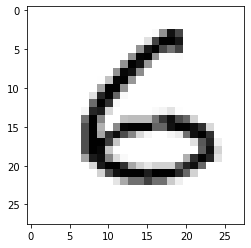

LABEL: 6
INPUT:


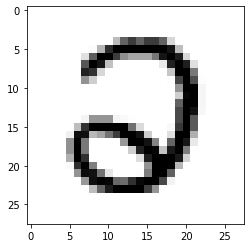

LABEL: 2
INPUT:


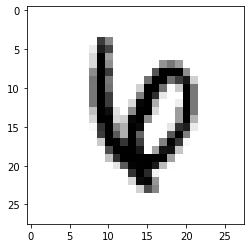

LABEL: 6
INPUT:


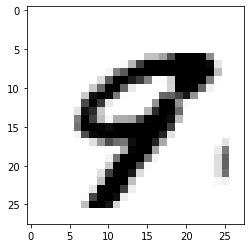

LABEL: 9
INPUT:


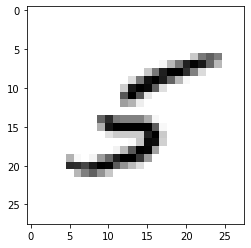

LABEL: 5
INPUT:


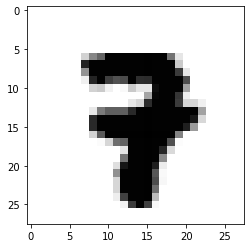

LABEL: 7
INPUT:


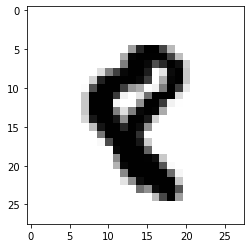

LABEL: 8
INPUT:


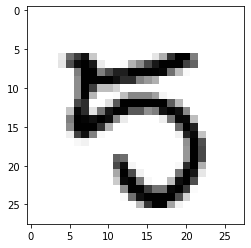

LABEL: 5
INPUT:


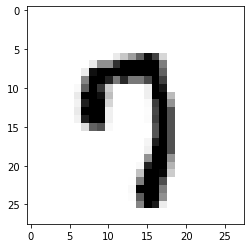

LABEL: 7
INPUT:


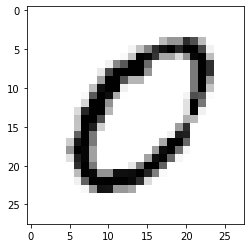

LABEL: 0
INPUT:


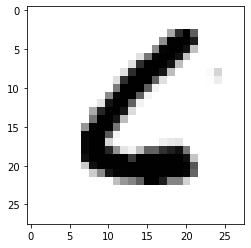

LABEL: 6
INPUT:


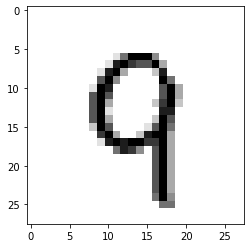

LABEL: 9
INPUT:


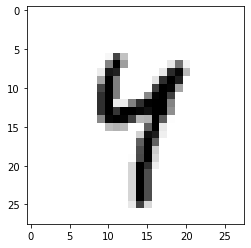

LABEL: 4
INPUT:


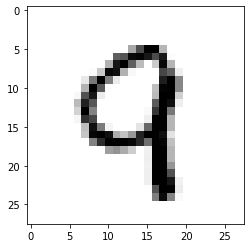

LABEL: 9
INPUT:


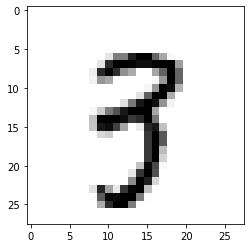

LABEL: 3
INPUT:


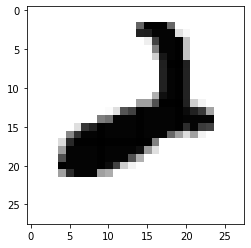

LABEL: 2
INPUT:


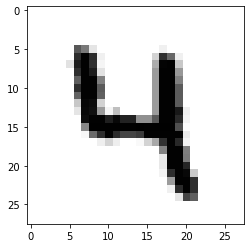

LABEL: 4
INPUT:


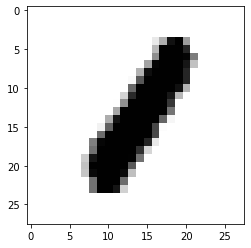

LABEL: 1
INPUT:


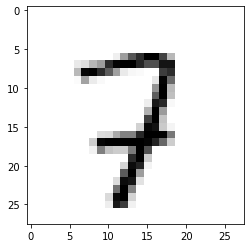

LABEL: 7
INPUT:


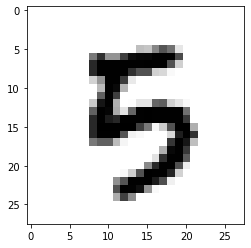

LABEL: 5
INPUT:


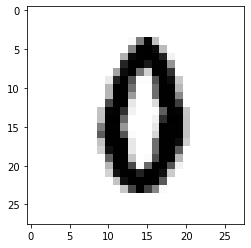

LABEL: 0
INPUT:


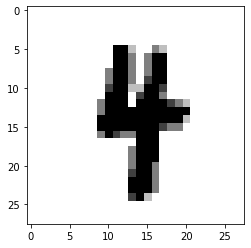

LABEL: 4
INPUT:


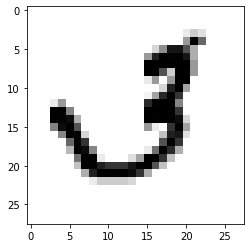

LABEL: 3
INPUT:


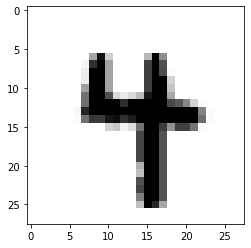

LABEL: 4
INPUT:


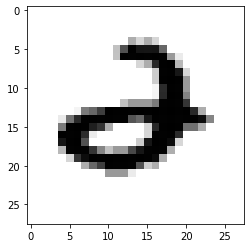

LABEL: 2
INPUT:


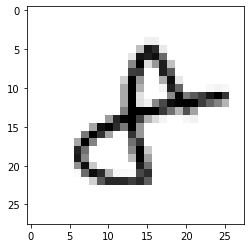

LABEL: 8
INPUT:


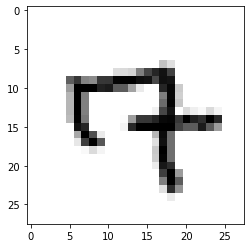

LABEL: 7
INPUT:


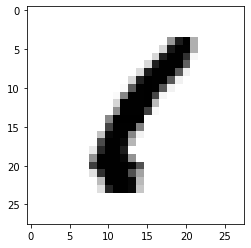

LABEL: 1
INPUT:


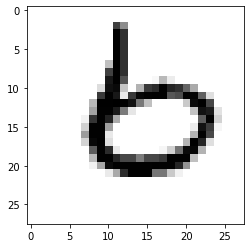

LABEL: 6
INPUT:


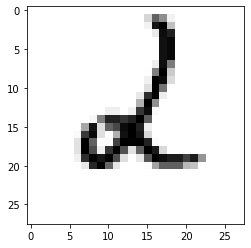

LABEL: 2
INPUT:


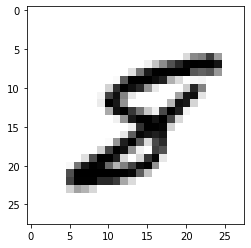

LABEL: 8
INPUT:


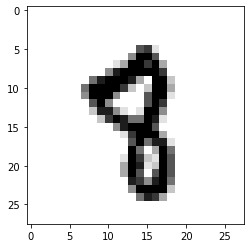

LABEL: 8
INPUT:


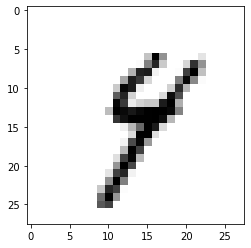

LABEL: 4
INPUT:


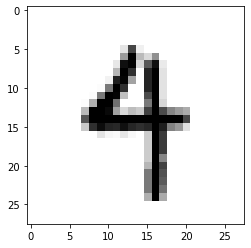

LABEL: 4
INPUT:


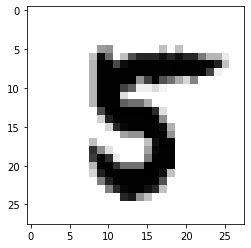

LABEL: 5
INPUT:


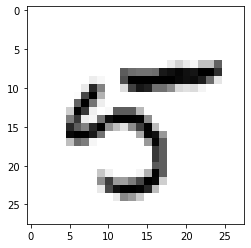

LABEL: 5
INPUT:


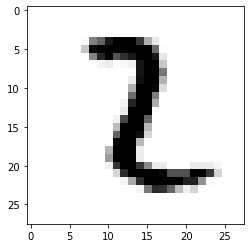

LABEL: 2
INPUT:


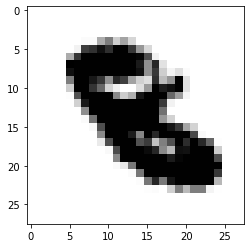

LABEL: 8
INPUT:


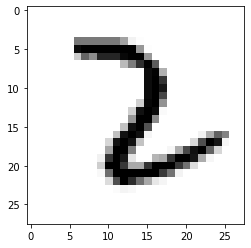

LABEL: 2
INPUT:


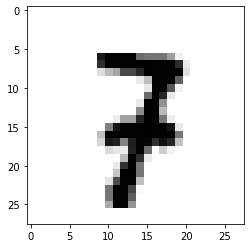

LABEL: 7
INPUT:


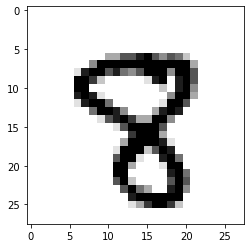

LABEL: 8
INPUT:


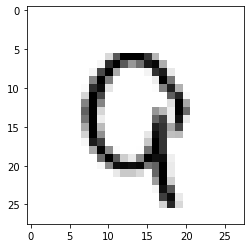

LABEL: 9
INPUT:


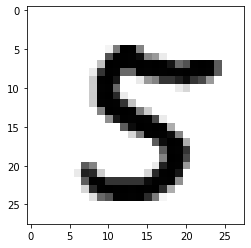

LABEL: 5
INPUT:


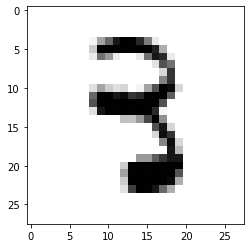

LABEL: 3
INPUT:


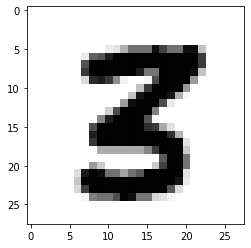

LABEL: 3
INPUT:


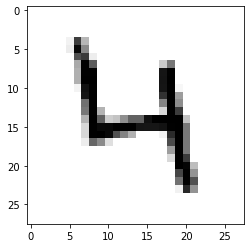

LABEL: 4
INPUT:


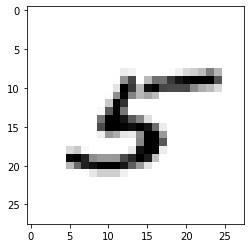

LABEL: 5
INPUT:


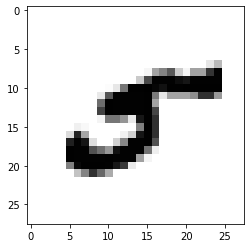

LABEL: 5
INPUT:


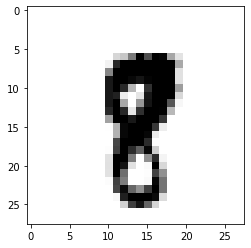

LABEL: 8
INPUT:


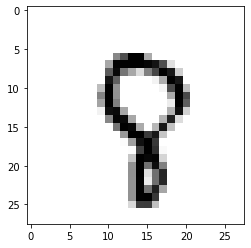

LABEL: 8
INPUT:


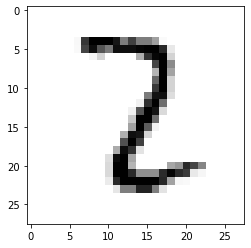

LABEL: 2
INPUT:


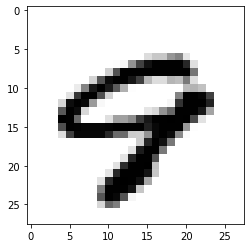

LABEL: 9
INPUT:


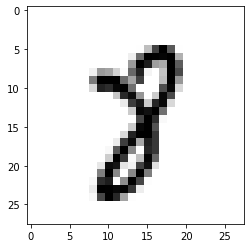

LABEL: 8
INPUT:


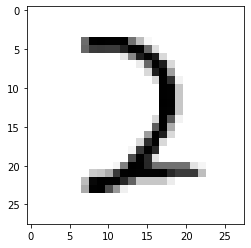

LABEL: 2
INPUT:


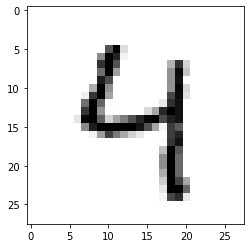

LABEL: 4
INPUT:


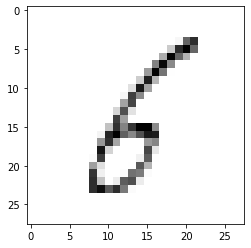

LABEL: 6
INPUT:


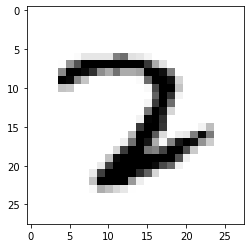

LABEL: 2
INPUT:


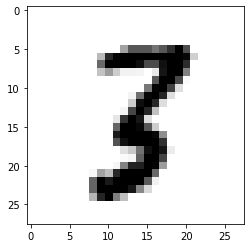

LABEL: 3
INPUT:


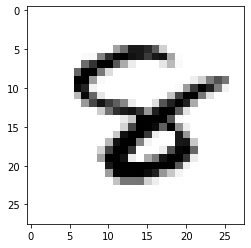

LABEL: 8
INPUT:


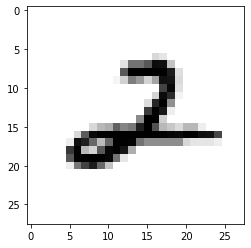

LABEL: 2
INPUT:


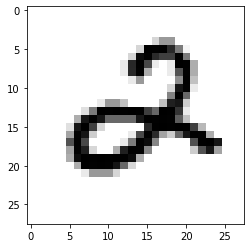

LABEL: 2
INPUT:


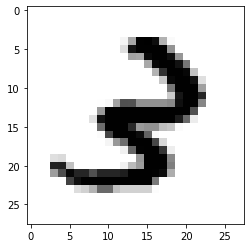

LABEL: 3
INPUT:


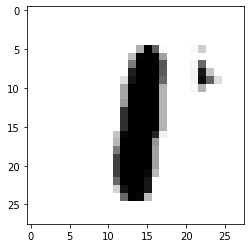

LABEL: 1
INPUT:


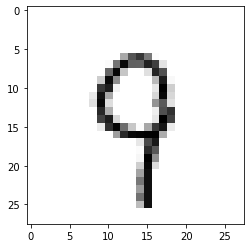

LABEL: 9
INPUT:


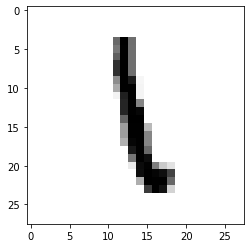

LABEL: 1
INPUT:


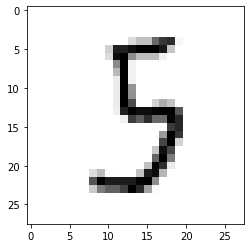

LABEL: 5
INPUT:


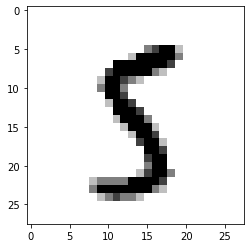

LABEL: 5
INPUT:


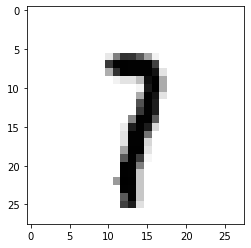

LABEL: 7
INPUT:


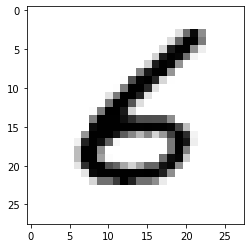

LABEL: 6
INPUT:


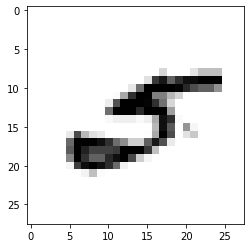

LABEL: 5
INPUT:


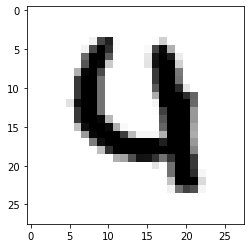

LABEL: 4
INPUT:


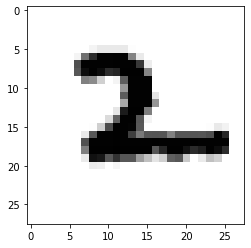

LABEL: 2
INPUT:


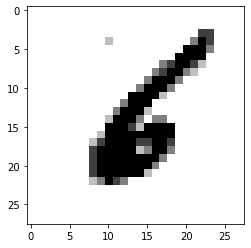

LABEL: 6
INPUT:


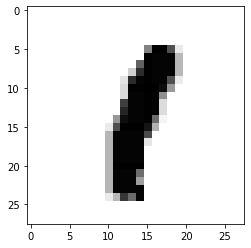

LABEL: 1
INPUT:


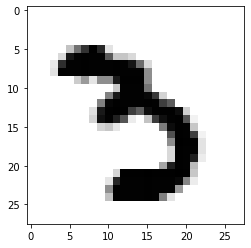

LABEL: 3
INPUT:


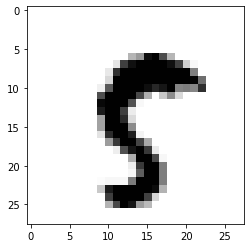

LABEL: 5
INPUT:


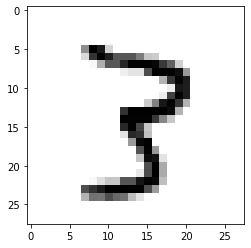

LABEL: 3
INPUT:


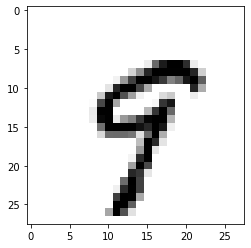

LABEL: 9
INPUT:


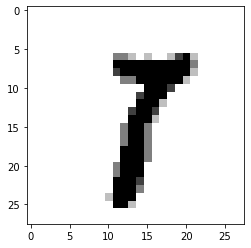

LABEL: 7
INPUT:


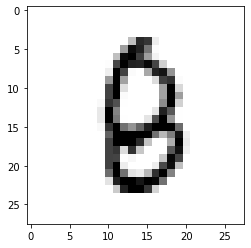

LABEL: 8
INPUT:


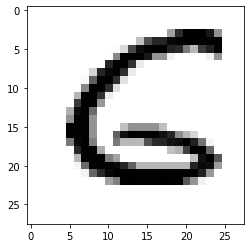

LABEL: 6
INPUT:


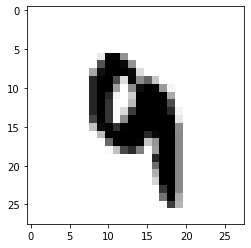

LABEL: 9
INPUT:


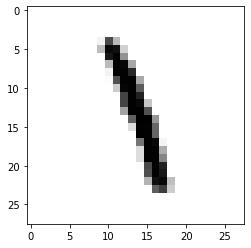

LABEL: 1
INPUT:


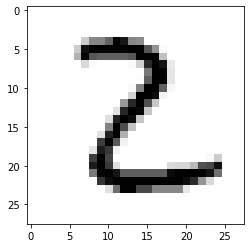

LABEL: 2
INPUT:


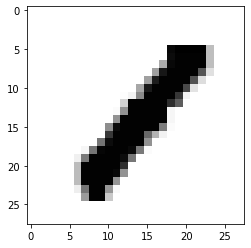

LABEL: 1
INPUT:


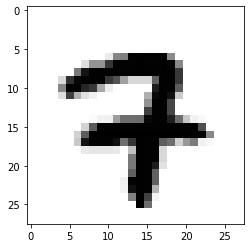

LABEL: 7
INPUT:


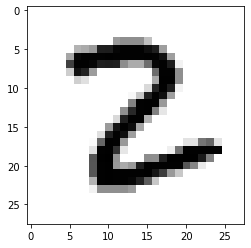

LABEL: 2
INPUT:


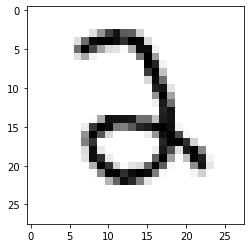

LABEL: 2
INPUT:


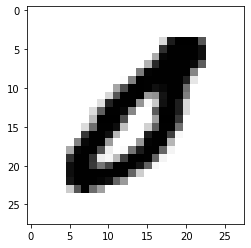

LABEL: 0
INPUT:


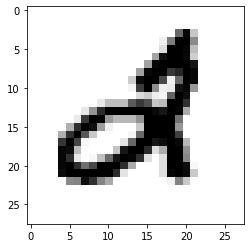

LABEL: 2
INPUT:


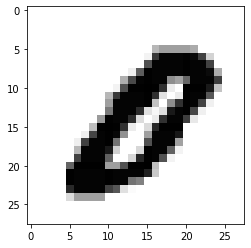

LABEL: 0
INPUT:


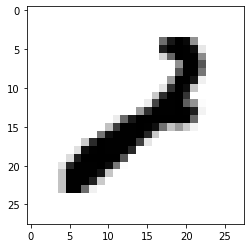

LABEL: 2
INPUT:


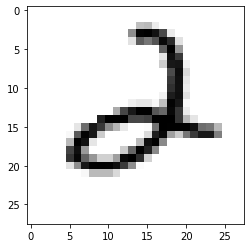

LABEL: 2
INPUT:


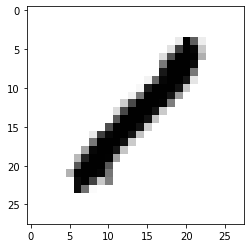

LABEL: 1
INPUT:


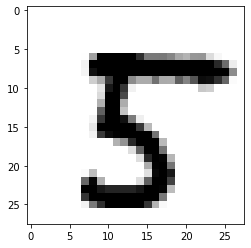

LABEL: 5
INPUT:


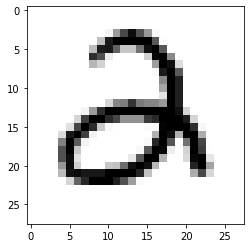

LABEL: 2
INPUT:


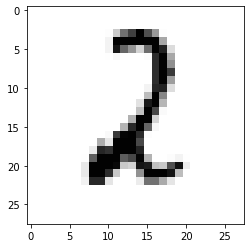

LABEL: 2
INPUT:


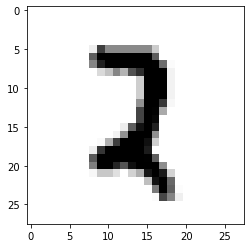

LABEL: 2
INPUT:


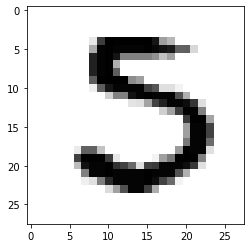

LABEL: 5
INPUT:


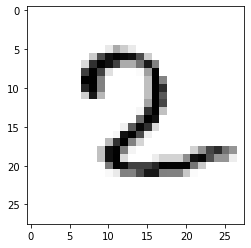

LABEL: 2
INPUT:


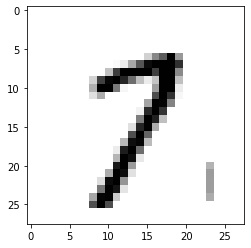

LABEL: 7
INPUT:


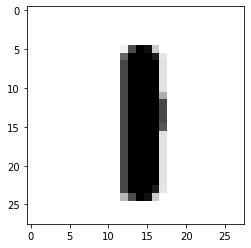

LABEL: 1
INPUT:


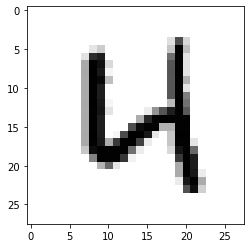

LABEL: 4
INPUT:


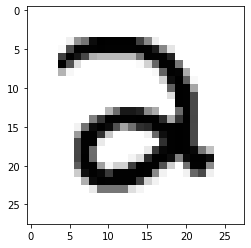

LABEL: 2
INPUT:


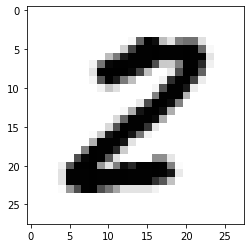

LABEL: 2
INPUT:


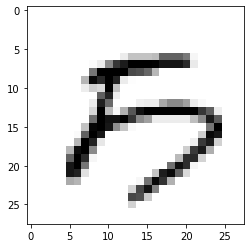

LABEL: 5
INPUT:


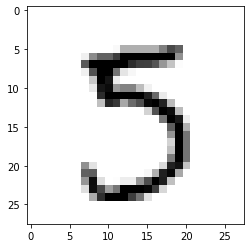

LABEL: 5
INPUT:


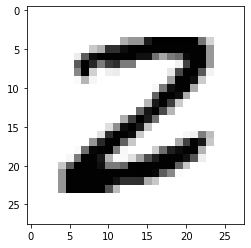

LABEL: 2
INPUT:


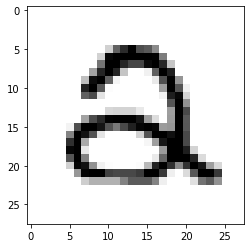

LABEL: 2
INPUT:


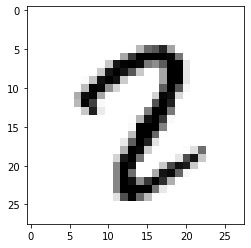

LABEL: 2
INPUT:


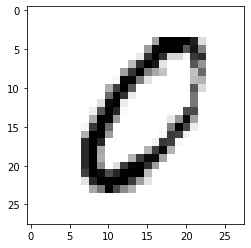

LABEL: 0
INPUT:


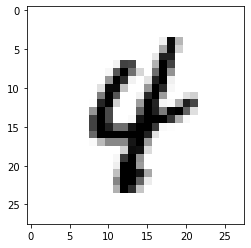

LABEL: 4
INPUT:


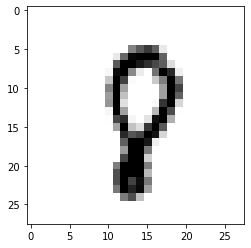

LABEL: 8
INPUT:


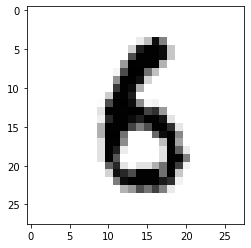

LABEL: 6
INPUT:


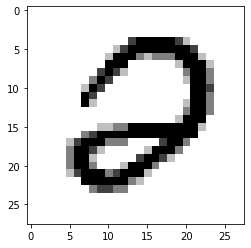

LABEL: 2
INPUT:


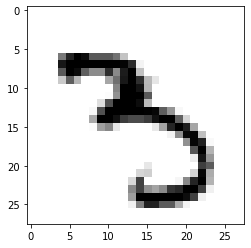

LABEL: 3
INPUT:


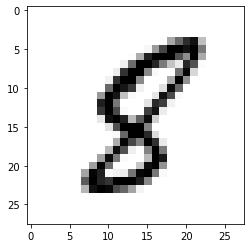

LABEL: 8
INPUT:


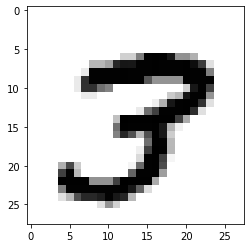

LABEL: 3
INPUT:


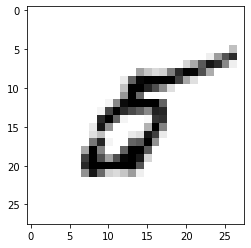

LABEL: 5
INPUT:


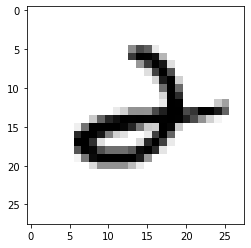

LABEL: 2
INPUT:


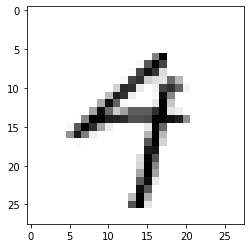

LABEL: 4
INPUT:


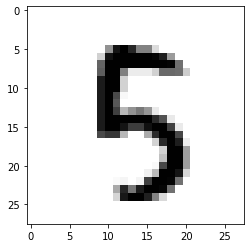

LABEL: 5
INPUT:


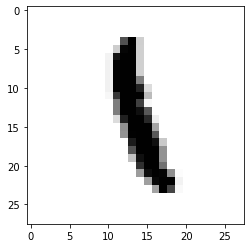

LABEL: 1
INPUT:


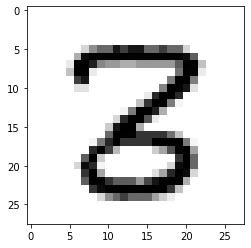

LABEL: 3
INPUT:


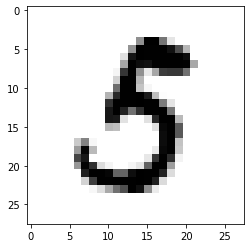

LABEL: 5
INPUT:


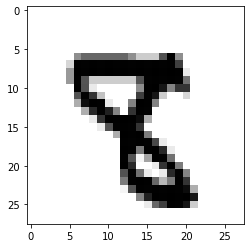

LABEL: 8
INPUT:


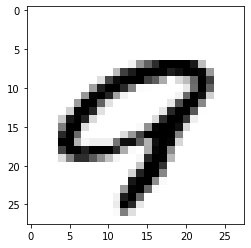

LABEL: 9
INPUT:


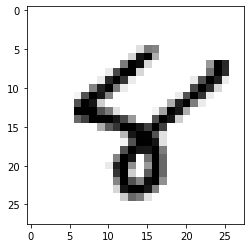

LABEL: 8
INPUT:


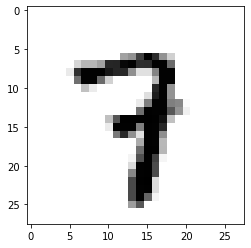

LABEL: 7
INPUT:


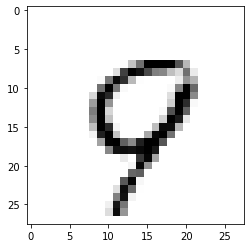

LABEL: 9
INPUT:


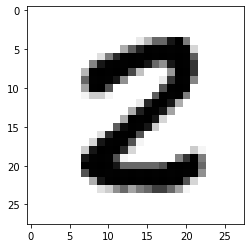

LABEL: 2
INPUT:


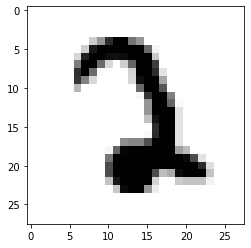

LABEL: 2
INPUT:


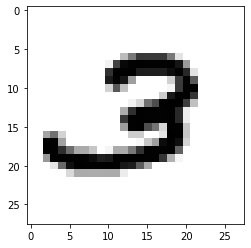

LABEL: 3
INPUT:


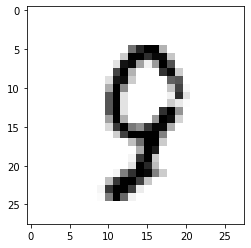

LABEL: 9
INPUT:


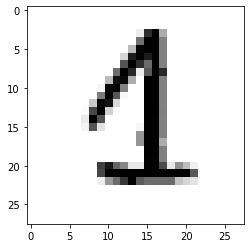

LABEL: 1
INPUT:


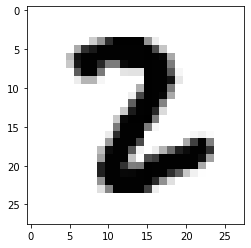

LABEL: 2
INPUT:


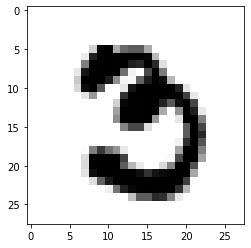

LABEL: 3
INPUT:


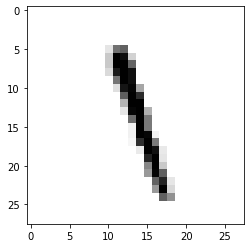

LABEL: 1
INPUT:


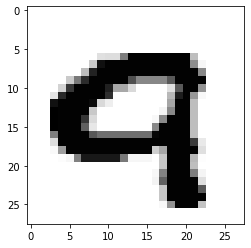

LABEL: 9
INPUT:


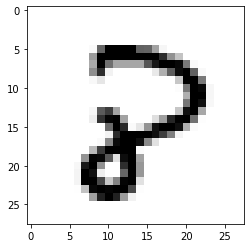

LABEL: 8
INPUT:


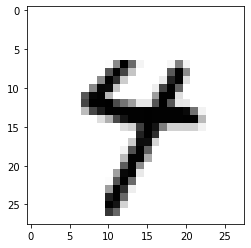

LABEL: 4
INPUT:


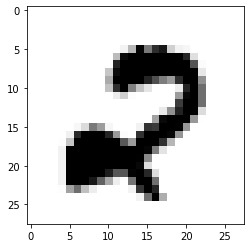

LABEL: 2
INPUT:


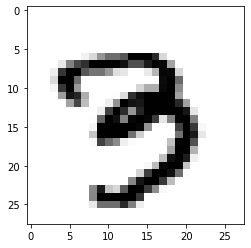

LABEL: 3
INPUT:


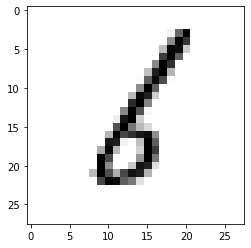

LABEL: 6
INPUT:


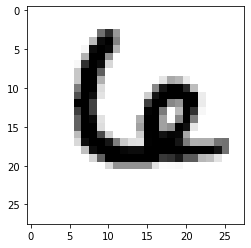

LABEL: 6
INPUT:


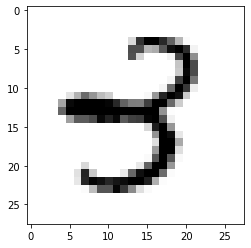

LABEL: 3
INPUT:


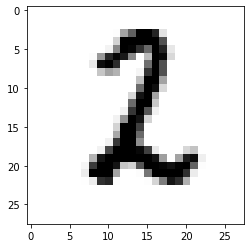

LABEL: 2
INPUT:


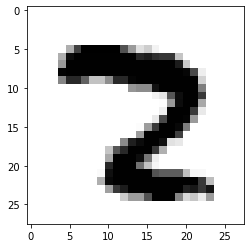

LABEL: 2
INPUT:


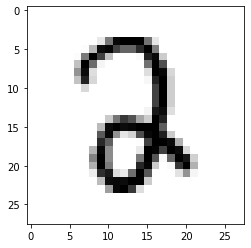

LABEL: 2
INPUT:


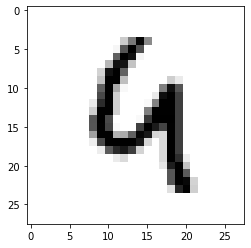

LABEL: 4
INPUT:


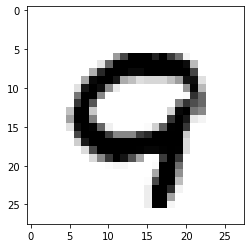

LABEL: 9
INPUT:


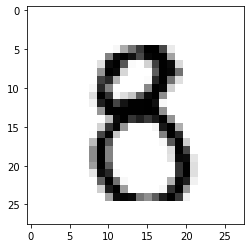

LABEL: 8
INPUT:


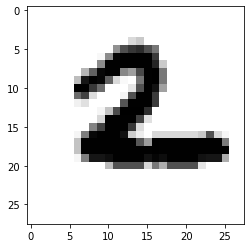

LABEL: 2
INPUT:


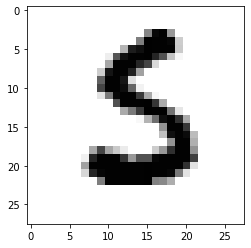

LABEL: 5
INPUT:


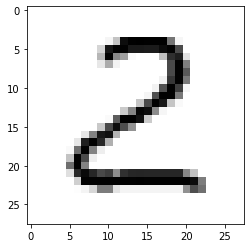

LABEL: 2
INPUT:


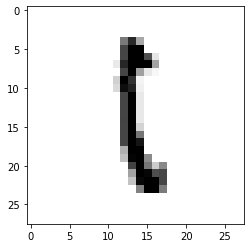

LABEL: 1
INPUT:


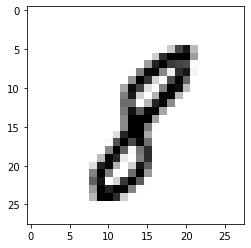

LABEL: 8
INPUT:


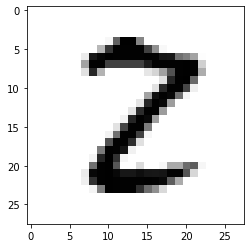

LABEL: 2
INPUT:


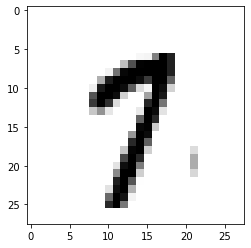

LABEL: 7
INPUT:


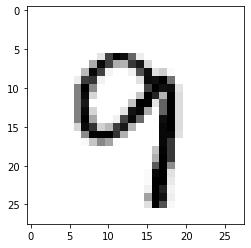

LABEL: 9
INPUT:


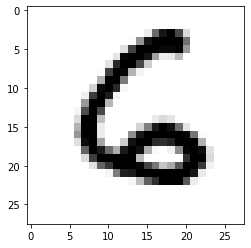

LABEL: 6
INPUT:


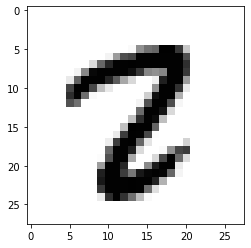

LABEL: 2
INPUT:


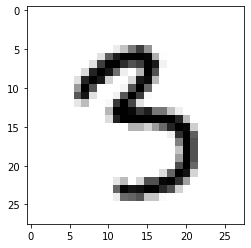

LABEL: 3
INPUT:


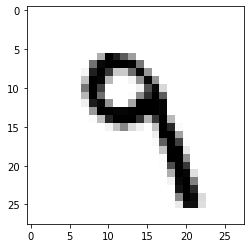

LABEL: 9
INPUT:


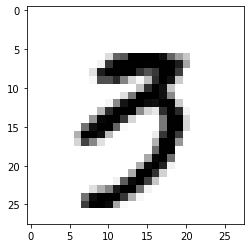

LABEL: 3
INPUT:


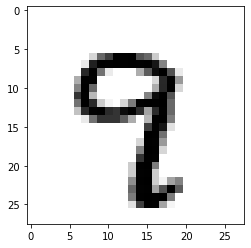

LABEL: 9
INPUT:


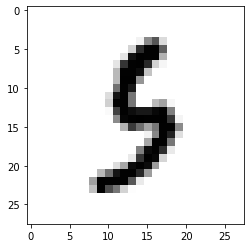

LABEL: 5
INPUT:


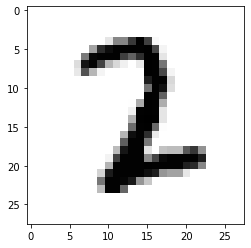

LABEL: 2
INPUT:


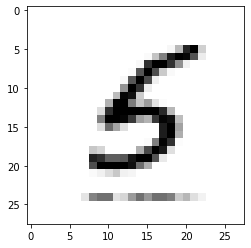

LABEL: 5
INPUT:


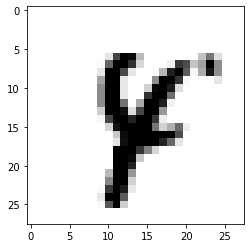

LABEL: 4
INPUT:


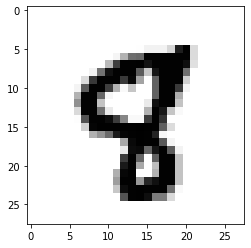

LABEL: 8
INPUT:


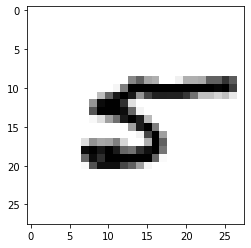

LABEL: 5
INPUT:


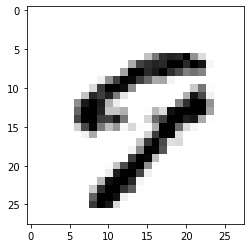

LABEL: 9
INPUT:


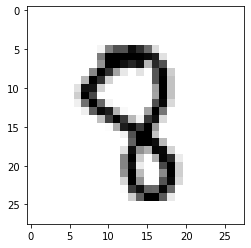

LABEL: 8
INPUT:


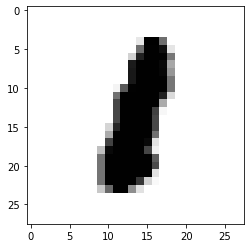

LABEL: 1
INPUT:


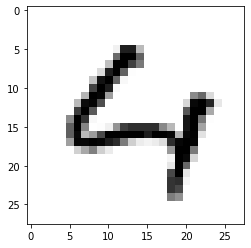

LABEL: 4
INPUT:


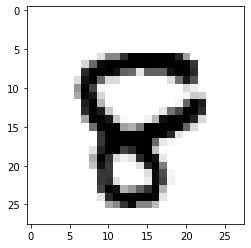

LABEL: 8
INPUT:


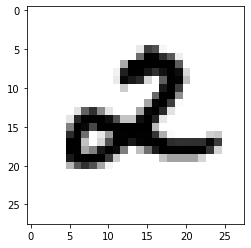

LABEL: 2
INPUT:


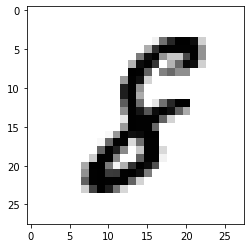

LABEL: 8
INPUT:


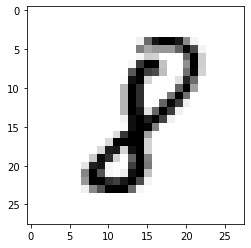

LABEL: 8
INPUT:


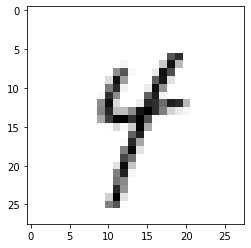

LABEL: 4
INPUT:


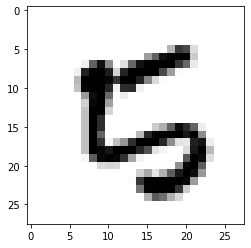

LABEL: 5
INPUT:


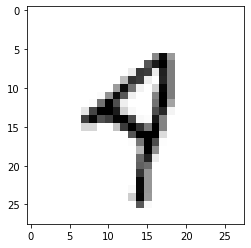

LABEL: 4
INPUT:


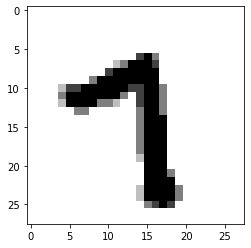

LABEL: 7
INPUT:


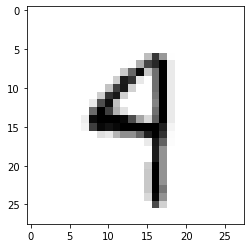

LABEL: 4
INPUT:


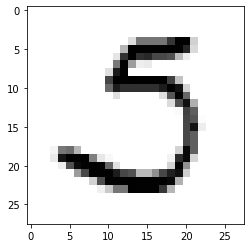

LABEL: 5
INPUT:


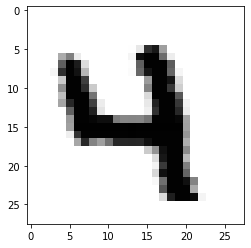

LABEL: 4
INPUT:


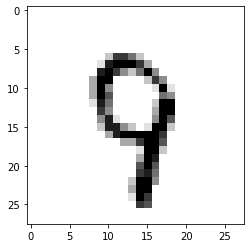

LABEL: 9
INPUT:


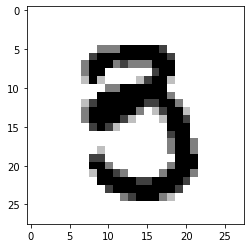

LABEL: 3
INPUT:


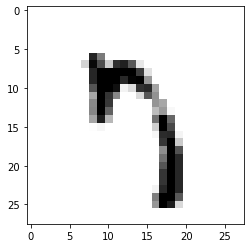

LABEL: 7
INPUT:


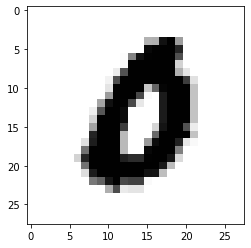

LABEL: 0
INPUT:


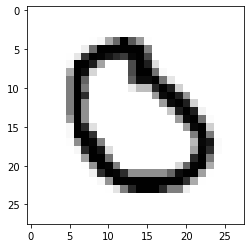

LABEL: 0
INPUT:


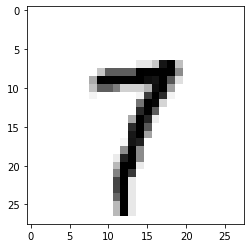

LABEL: 7
INPUT:


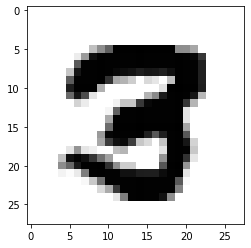

LABEL: 3
INPUT:


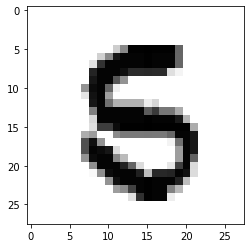

LABEL: 5
INPUT:


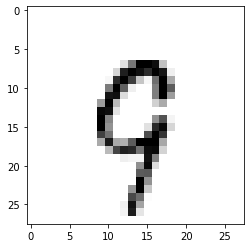

LABEL: 9
INPUT:


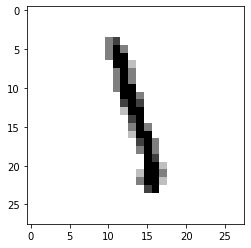

LABEL: 1
INPUT:


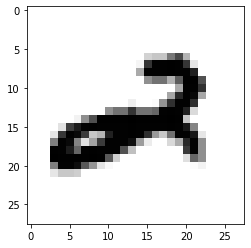

LABEL: 2
INPUT:


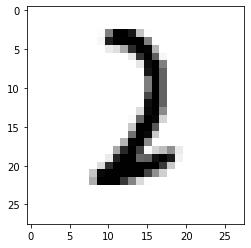

LABEL: 2
INPUT:


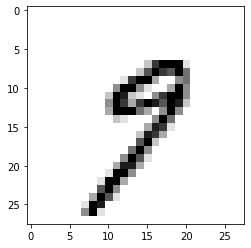

LABEL: 9
INPUT:


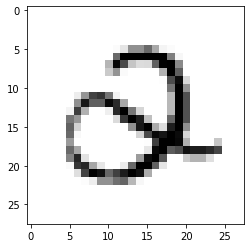

LABEL: 2
INPUT:


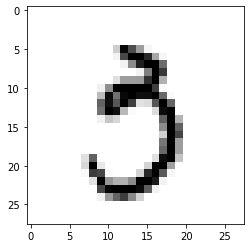

LABEL: 3
INPUT:


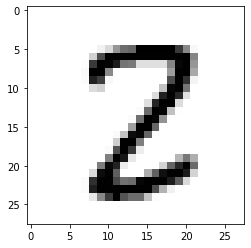

LABEL: 2
INPUT:


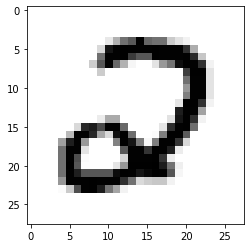

LABEL: 2
INPUT:


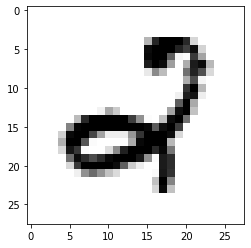

LABEL: 2
INPUT:


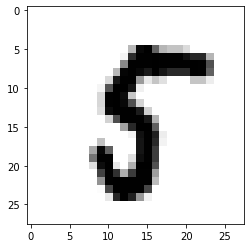

LABEL: 5
INPUT:


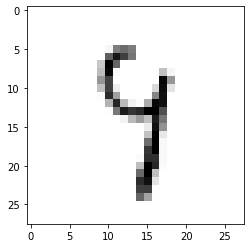

LABEL: 9
INPUT:


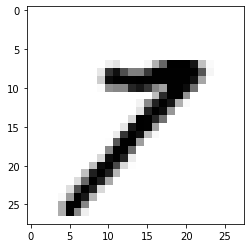

LABEL: 7
INPUT:


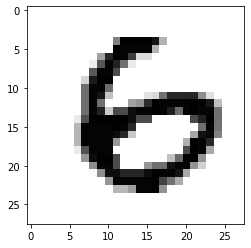

LABEL: 6
INPUT:


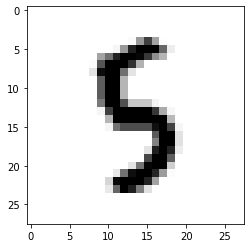

LABEL: 5
INPUT:


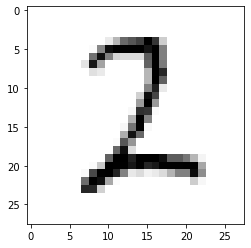

LABEL: 2
INPUT:


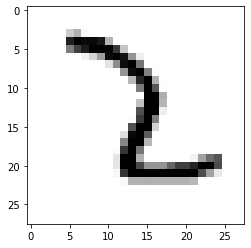

LABEL: 2
INPUT:


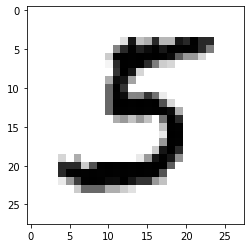

LABEL: 5
INPUT:


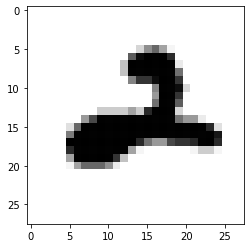

LABEL: 2
INPUT:


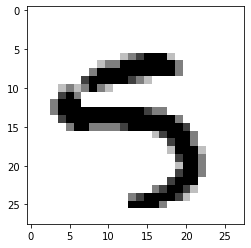

LABEL: 5
INPUT:


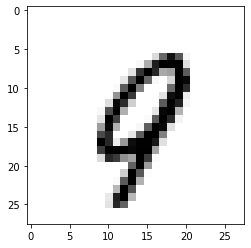

LABEL: 9
INPUT:


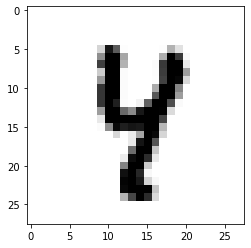

LABEL: 4
INPUT:


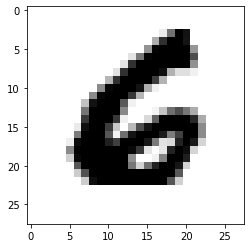

LABEL: 6
INPUT:


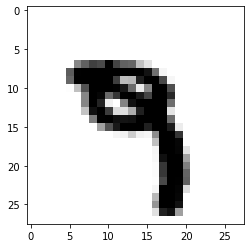

LABEL: 9
INPUT:


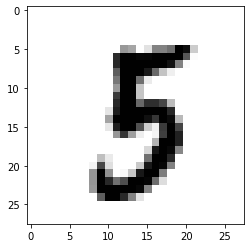

LABEL: 5
INPUT:


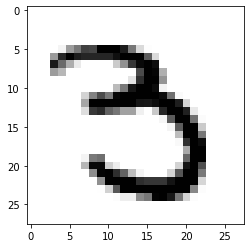

LABEL: 3
INPUT:


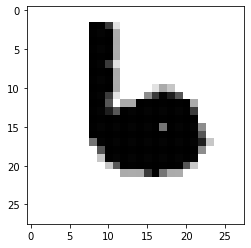

LABEL: 6
INPUT:


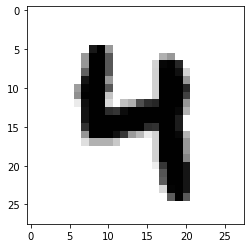

LABEL: 4
INPUT:


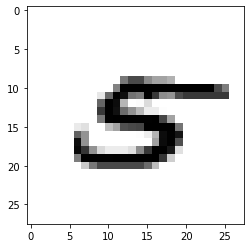

LABEL: 5
INPUT:


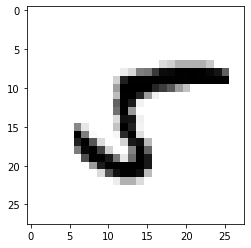

LABEL: 5
INPUT:


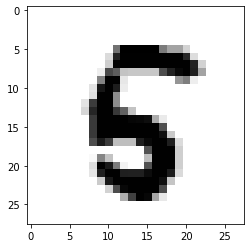

LABEL: 5
INPUT:


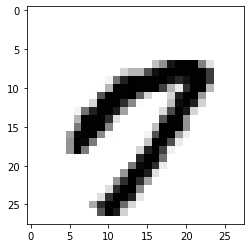

LABEL: 7
INPUT:


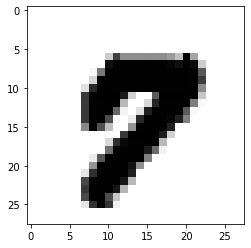

LABEL: 7
INPUT:


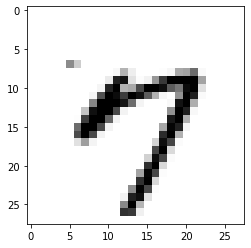

LABEL: 7
INPUT:


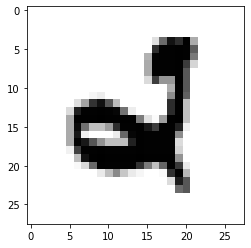

LABEL: 2
INPUT:


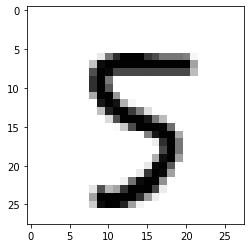

LABEL: 5
INPUT:


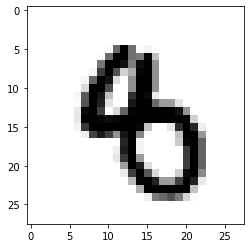

LABEL: 8
INPUT:


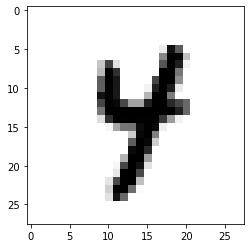

LABEL: 4
INPUT:


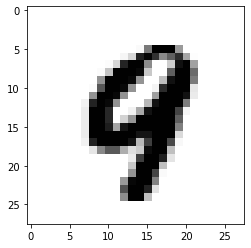

LABEL: 9
INPUT:


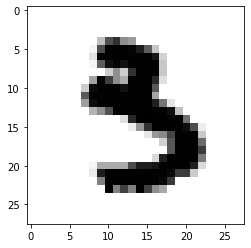

LABEL: 3
INPUT:


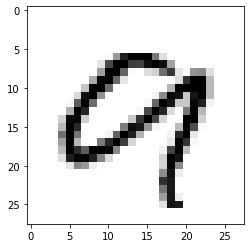

LABEL: 9
INPUT:


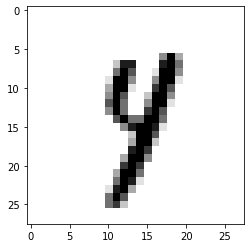

LABEL: 4
INPUT:


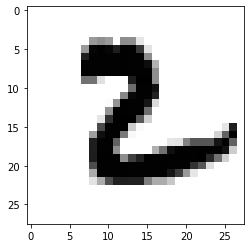

LABEL: 2
INPUT:


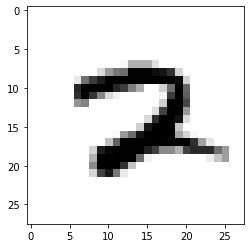

LABEL: 2
INPUT:


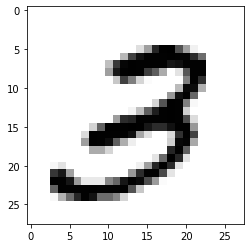

LABEL: 3
INPUT:


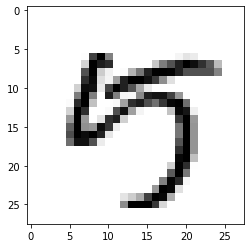

LABEL: 5
INPUT:


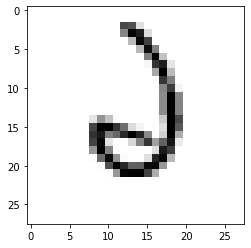

LABEL: 2
INPUT:


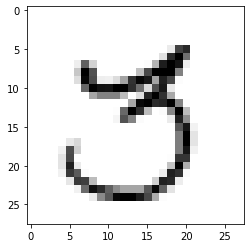

LABEL: 3
INPUT:


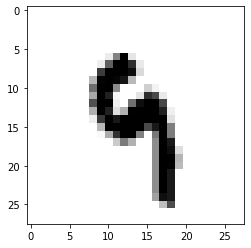

LABEL: 9
INPUT:


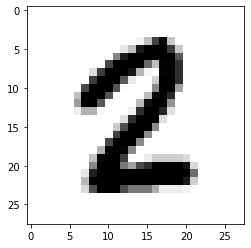

LABEL: 2
INPUT:


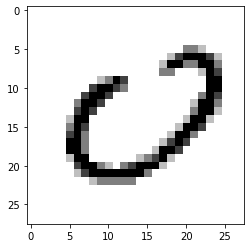

LABEL: 0
INPUT:


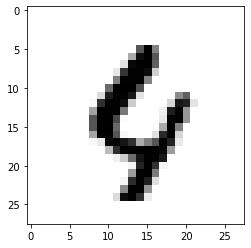

LABEL: 4
INPUT:


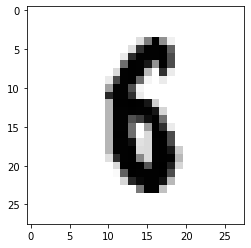

LABEL: 6
INPUT:


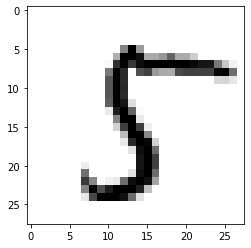

LABEL: 5
INPUT:


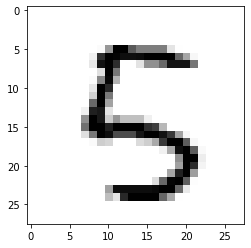

LABEL: 5
INPUT:


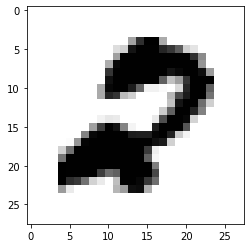

LABEL: 2
INPUT:


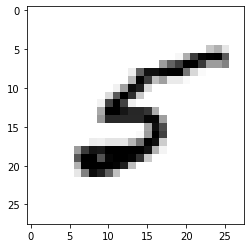

LABEL: 5
INPUT:


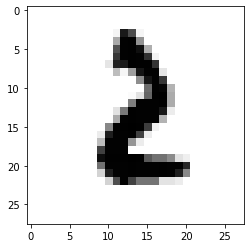

LABEL: 2
INPUT:


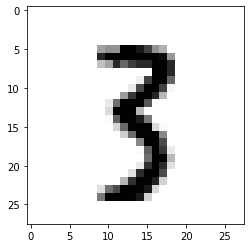

LABEL: 3
INPUT:


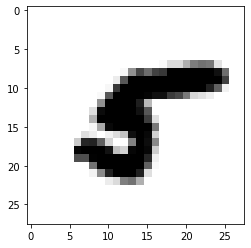

LABEL: 5
INPUT:


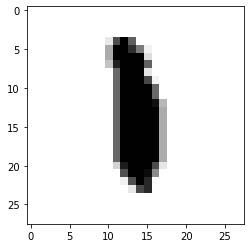

LABEL: 1
INPUT:


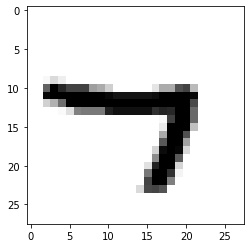

LABEL: 7
INPUT:


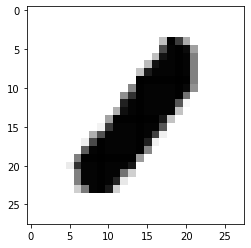

LABEL: 1
INPUT:


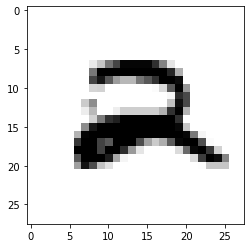

LABEL: 2
INPUT:


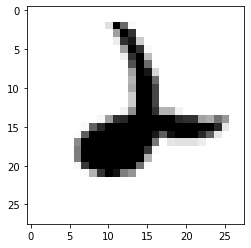

LABEL: 2
INPUT:


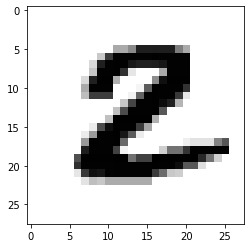

LABEL: 2
INPUT:


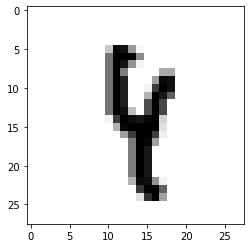

LABEL: 4
INPUT:


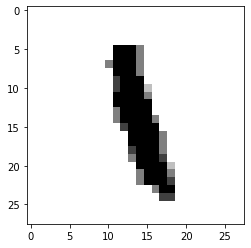

LABEL: 1
INPUT:


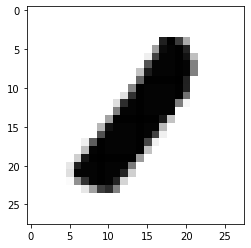

LABEL: 1
INPUT:


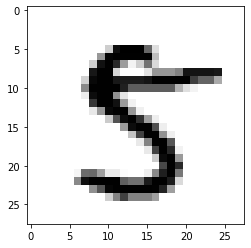

LABEL: 5
INPUT:


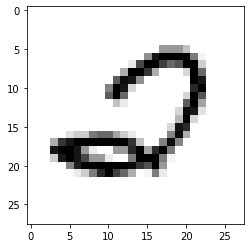

LABEL: 2
INPUT:


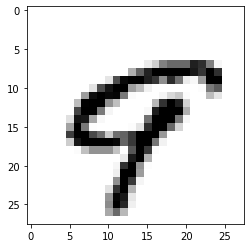

LABEL: 9
INPUT:


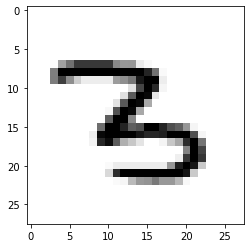

LABEL: 3
INPUT:


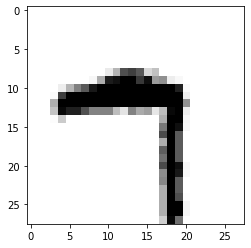

LABEL: 7
INPUT:


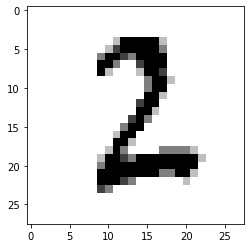

LABEL: 2
INPUT:


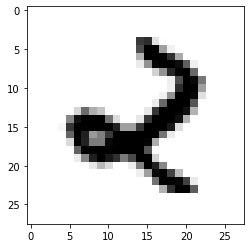

LABEL: 2
INPUT:


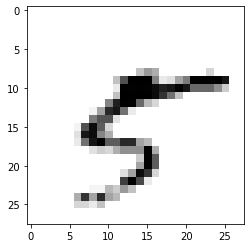

LABEL: 5
INPUT:


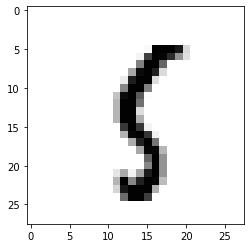

LABEL: 5
INPUT:


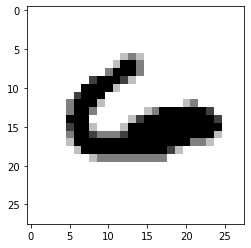

LABEL: 6
INPUT:


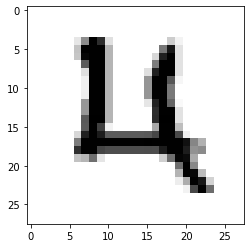

LABEL: 4
INPUT:


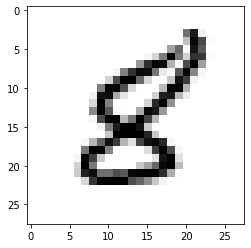

LABEL: 8
INPUT:


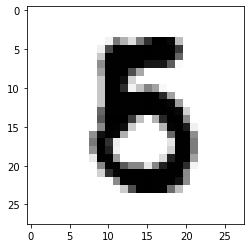

LABEL: 5
INPUT:


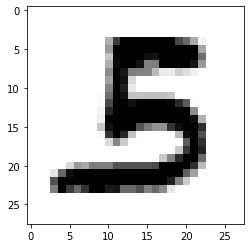

LABEL: 5
INPUT:


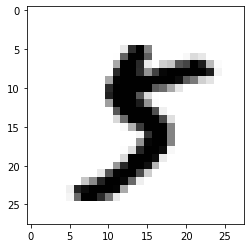

LABEL: 5
INPUT:


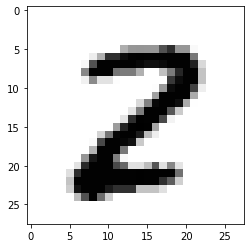

LABEL: 2
INPUT:


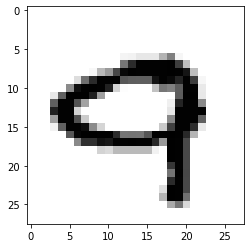

LABEL: 9
INPUT:


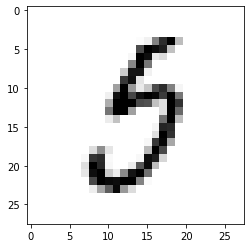

LABEL: 5
INPUT:


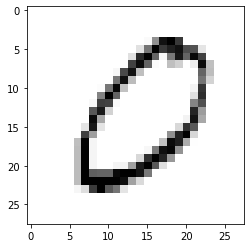

LABEL: 0
INPUT:


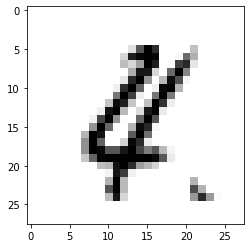

LABEL: 4
INPUT:


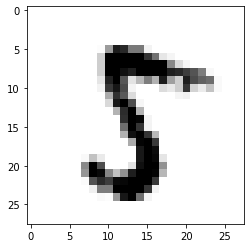

LABEL: 5
INPUT:


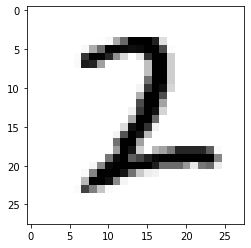

LABEL: 2
INPUT:


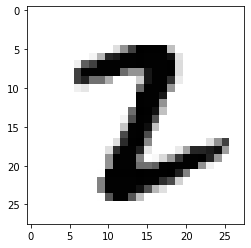

LABEL: 2
INPUT:


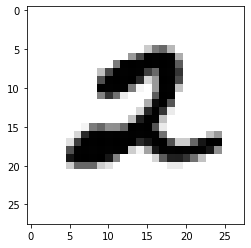

LABEL: 2
INPUT:


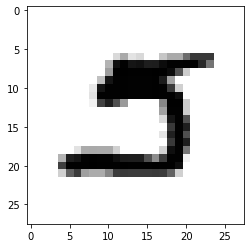

LABEL: 5
INPUT:


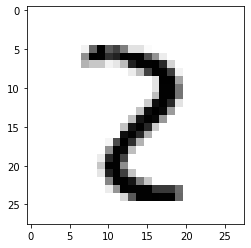

LABEL: 2
INPUT:


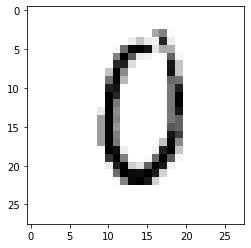

LABEL: 0
INPUT:


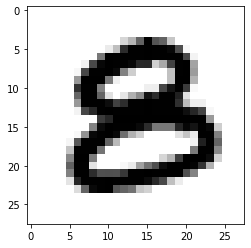

LABEL: 8
INPUT:


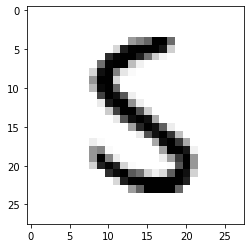

LABEL: 5
INPUT:


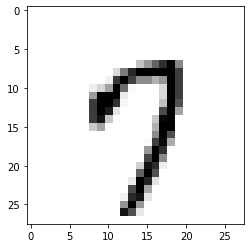

LABEL: 7
INPUT:


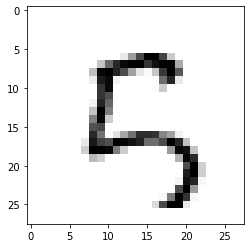

LABEL: 5
INPUT:


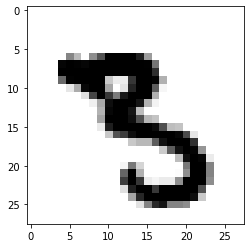

LABEL: 3
INPUT:


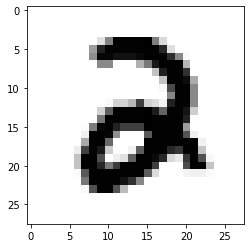

LABEL: 2
INPUT:


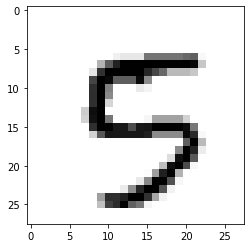

LABEL: 5
INPUT:


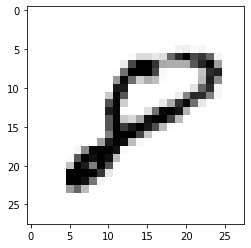

LABEL: 8
INPUT:


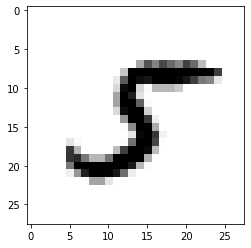

LABEL: 5
INPUT:


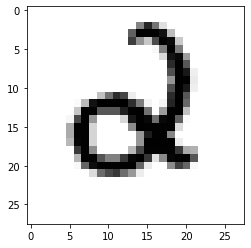

LABEL: 2
INPUT:


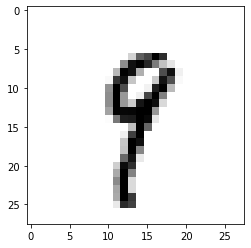

LABEL: 9
INPUT:


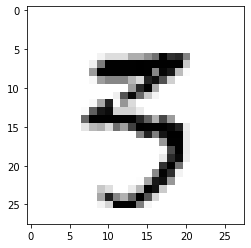

LABEL: 3
INPUT:


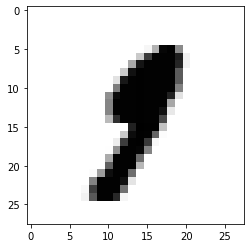

LABEL: 9
INPUT:


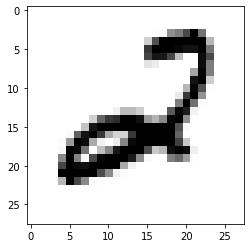

LABEL: 2
INPUT:


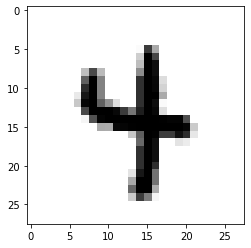

LABEL: 4
INPUT:


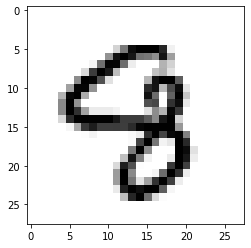

LABEL: 8
INPUT:


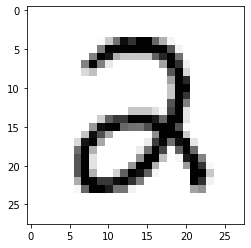

LABEL: 2
INPUT:


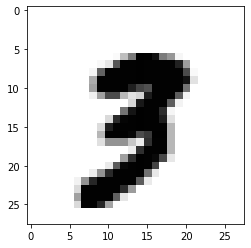

LABEL: 3
INPUT:


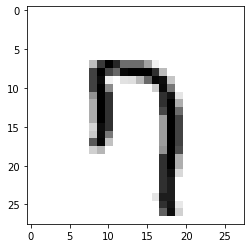

LABEL: 7
INPUT:


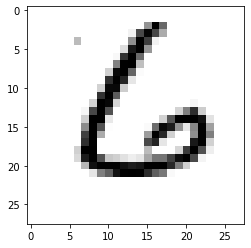

LABEL: 6
INPUT:


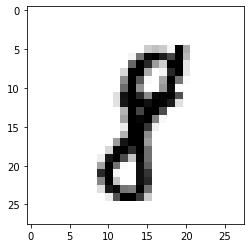

LABEL: 8
INPUT:


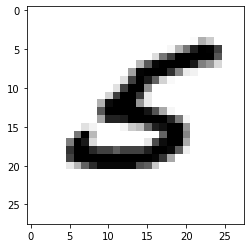

LABEL: 5
INPUT:


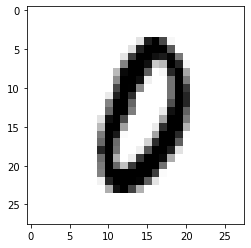

LABEL: 0
INPUT:


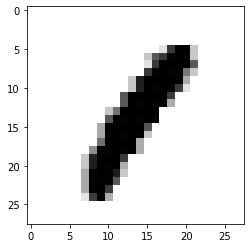

LABEL: 1
INPUT:


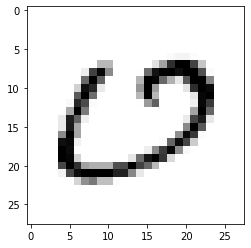

LABEL: 0
INPUT:


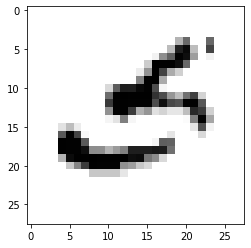

LABEL: 5
INPUT:


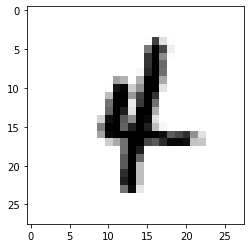

LABEL: 4
INPUT:


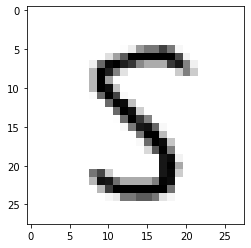

LABEL: 5
INPUT:


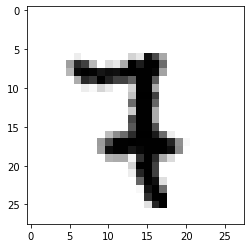

LABEL: 7
INPUT:


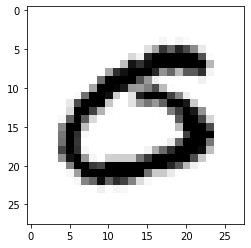

LABEL: 0
INPUT:


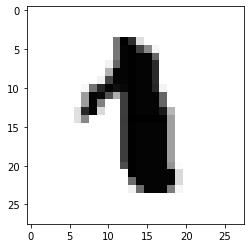

LABEL: 1
INPUT:


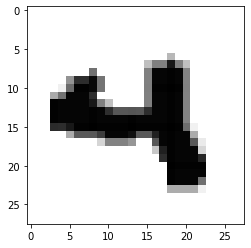

LABEL: 4
INPUT:


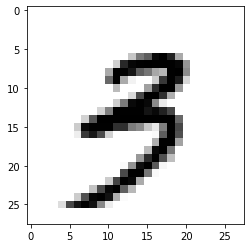

LABEL: 3
INPUT:


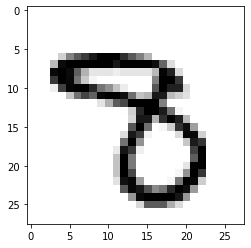

LABEL: 8
INPUT:


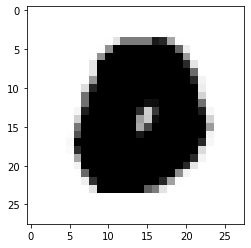

LABEL: 0
INPUT:


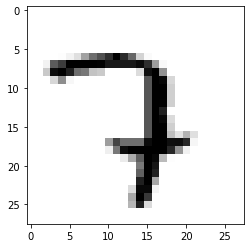

LABEL: 7
INPUT:


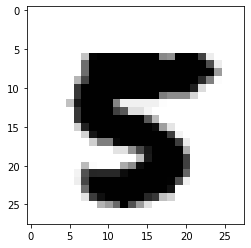

LABEL: 5
INPUT:


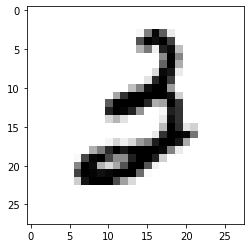

LABEL: 3
INPUT:


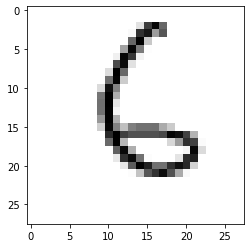

LABEL: 6
INPUT:


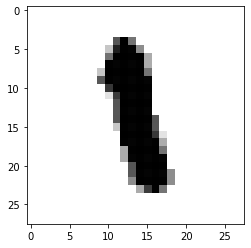

LABEL: 1
INPUT:


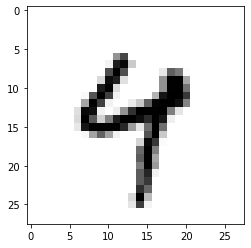

LABEL: 4
INPUT:


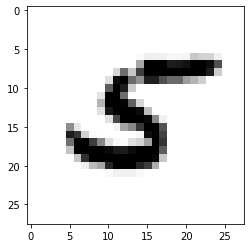

LABEL: 5
INPUT:


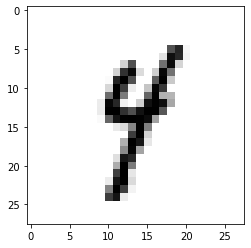

LABEL: 4
INPUT:


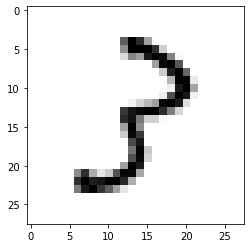

LABEL: 3
INPUT:


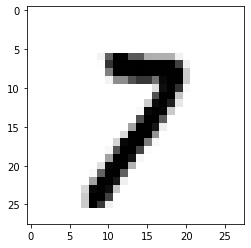

LABEL: 7
INPUT:


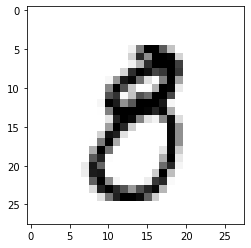

LABEL: 8
INPUT:


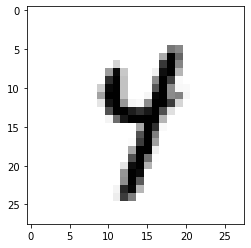

LABEL: 4
INPUT:


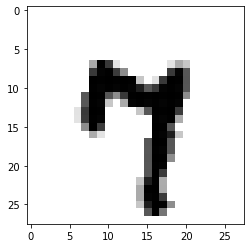

LABEL: 7
INPUT:


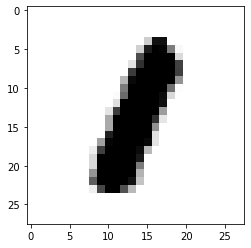

LABEL: 1
INPUT:


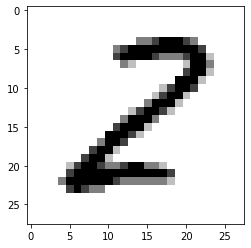

LABEL: 2
INPUT:


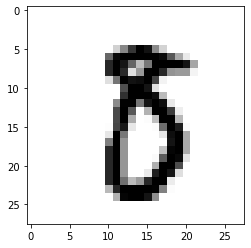

LABEL: 8
INPUT:


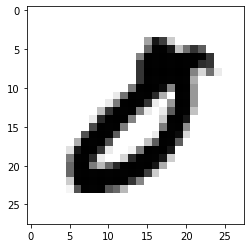

LABEL: 0
INPUT:


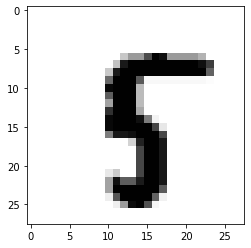

LABEL: 5
INPUT:


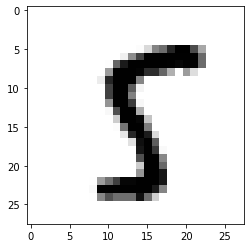

LABEL: 5
INPUT:


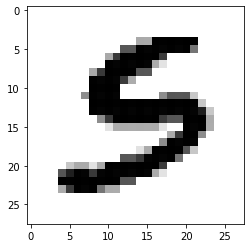

LABEL: 5
INPUT:


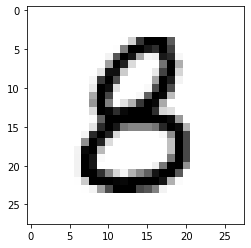

LABEL: 8
INPUT:


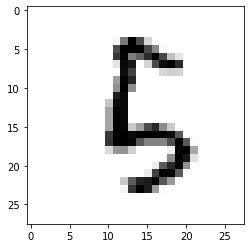

LABEL: 5
INPUT:


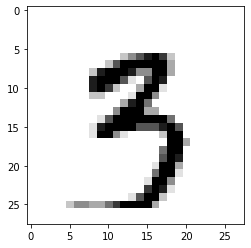

LABEL: 3
INPUT:


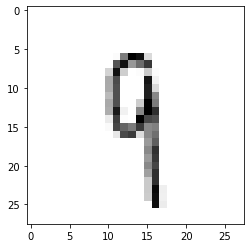

LABEL: 9
INPUT:


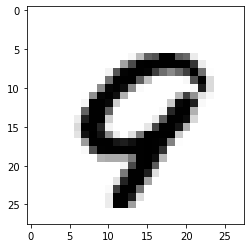

LABEL: 9
INPUT:


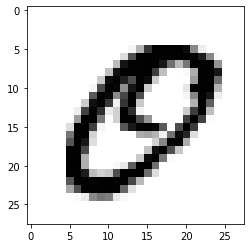

LABEL: 0
INPUT:


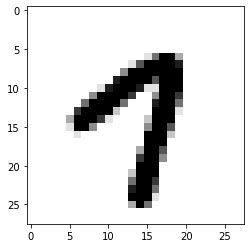

LABEL: 7
INPUT:


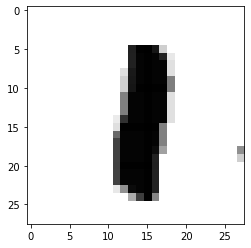

LABEL: 1
INPUT:


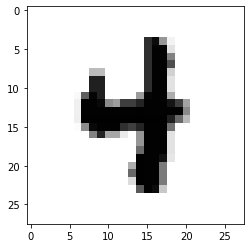

LABEL: 4
INPUT:


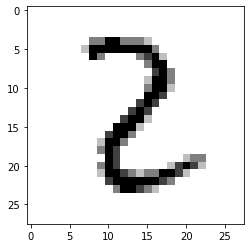

LABEL: 2
INPUT:


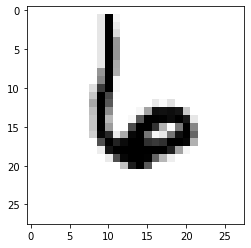

LABEL: 6
INPUT:


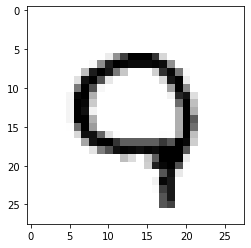

LABEL: 9
INPUT:


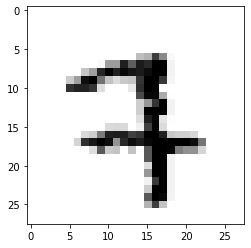

LABEL: 7
INPUT:


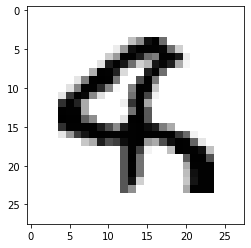

LABEL: 8
INPUT:


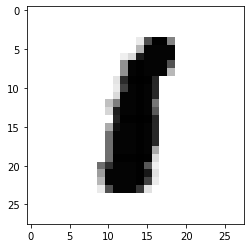

LABEL: 1
INPUT:


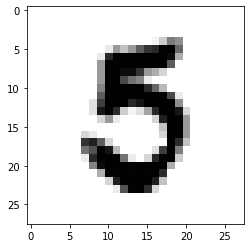

LABEL: 5
INPUT:


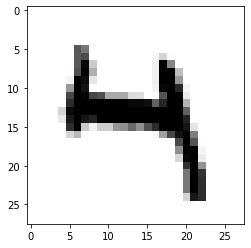

LABEL: 4
INPUT:


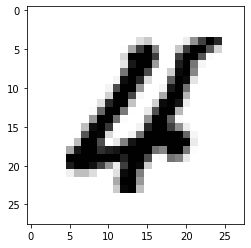

LABEL: 4
INPUT:


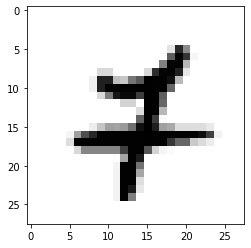

LABEL: 7
INPUT:


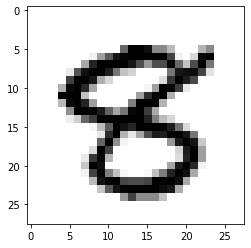

LABEL: 8
INPUT:


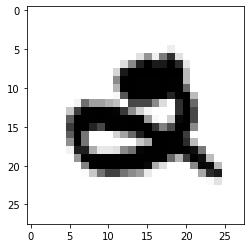

LABEL: 2
INPUT:


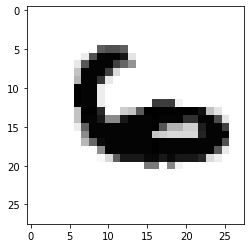

LABEL: 6
INPUT:


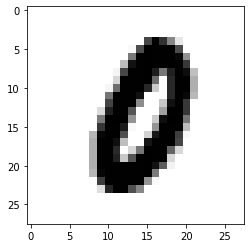

LABEL: 0
INPUT:


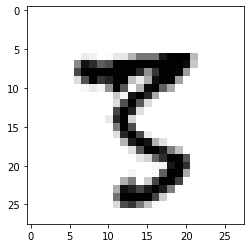

LABEL: 3
INPUT:


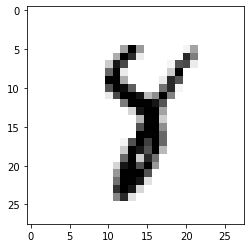

LABEL: 8
INPUT:


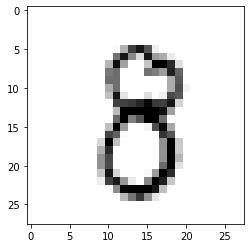

LABEL: 8
INPUT:


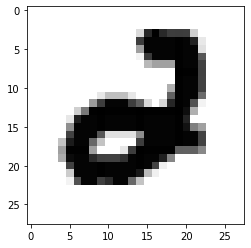

LABEL: 2
INPUT:


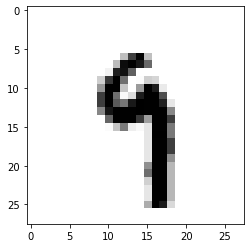

LABEL: 9
INPUT:


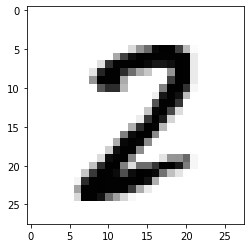

LABEL: 2
INPUT:


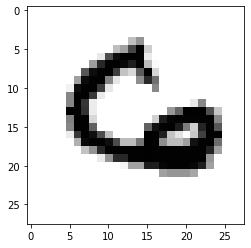

LABEL: 6
INPUT:


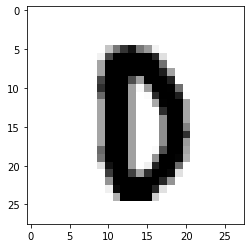

LABEL: 0
INPUT:


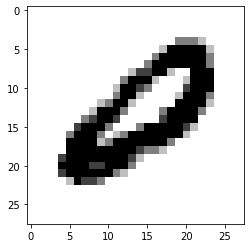

LABEL: 0
INPUT:


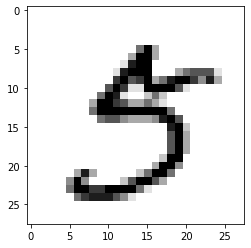

LABEL: 5
INPUT:


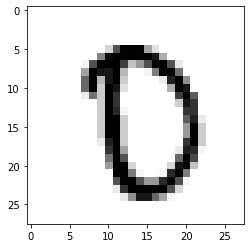

LABEL: 0
INPUT:


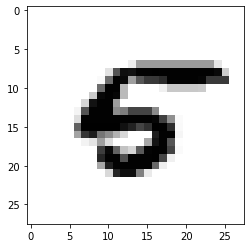

LABEL: 5
INPUT:


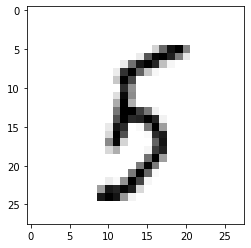

LABEL: 5
INPUT:


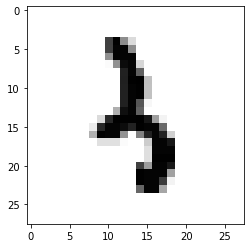

LABEL: 3
INPUT:


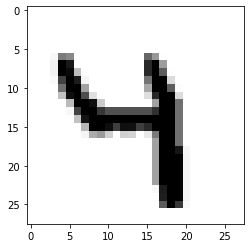

LABEL: 4
INPUT:


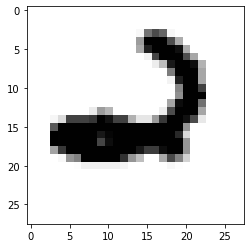

LABEL: 2
INPUT:


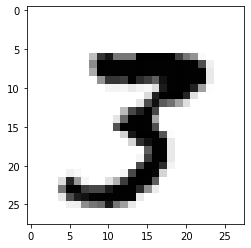

LABEL: 3
INPUT:


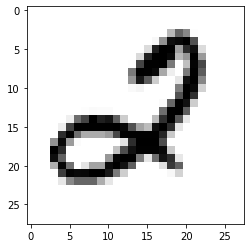

LABEL: 2
INPUT:


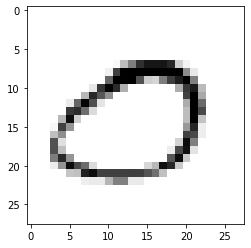

LABEL: 0
INPUT:


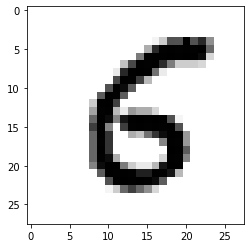

LABEL: 6
INPUT:


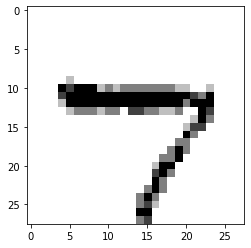

LABEL: 7
INPUT:


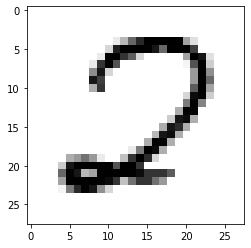

LABEL: 2
INPUT:


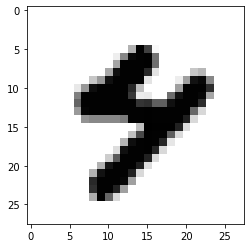

LABEL: 4
INPUT:


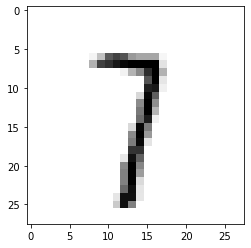

LABEL: 7
INPUT:


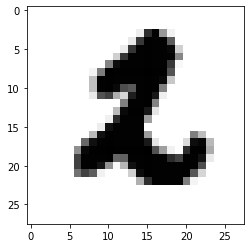

LABEL: 2
INPUT:


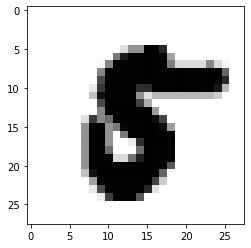

LABEL: 5
INPUT:


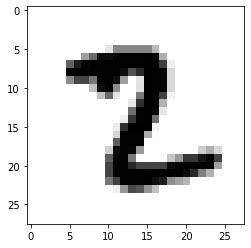

LABEL: 2
INPUT:


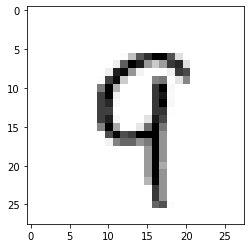

LABEL: 9
INPUT:


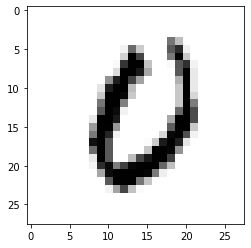

LABEL: 0
INPUT:


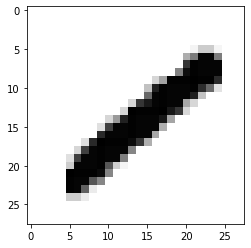

LABEL: 1
INPUT:


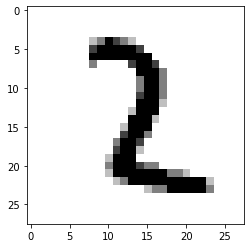

LABEL: 2
INPUT:


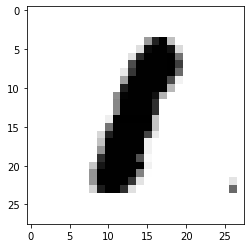

LABEL: 1
INPUT:


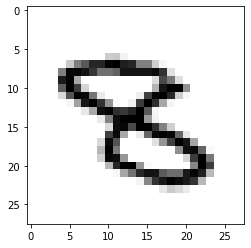

LABEL: 8
INPUT:


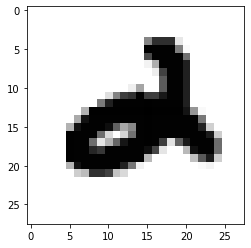

LABEL: 2
INPUT:


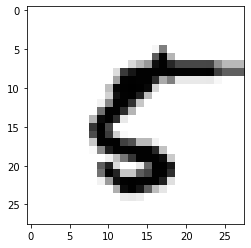

LABEL: 5
INPUT:


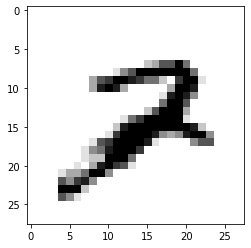

LABEL: 2
INPUT:


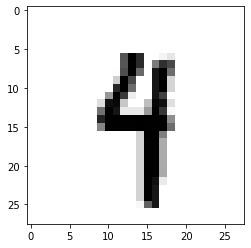

LABEL: 4
INPUT:


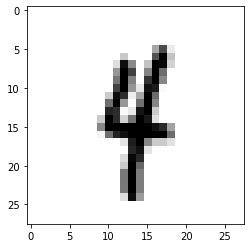

LABEL: 4
INPUT:


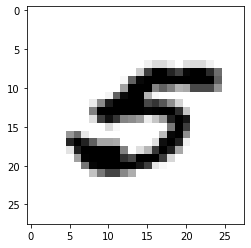

LABEL: 5
INPUT:


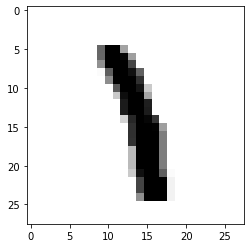

LABEL: 1
INPUT:


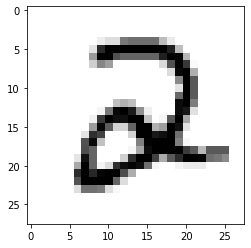

LABEL: 2
INPUT:


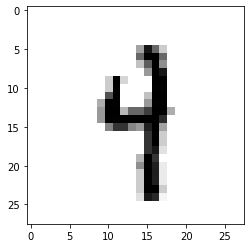

LABEL: 4
INPUT:


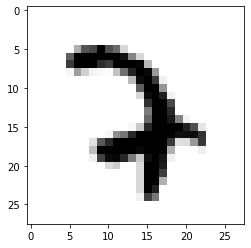

LABEL: 7
INPUT:


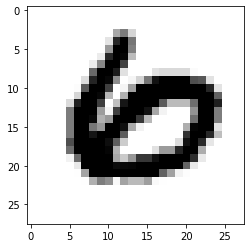

LABEL: 6
INPUT:


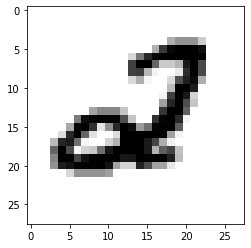

LABEL: 2
INPUT:


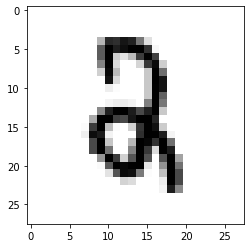

LABEL: 2
INPUT:


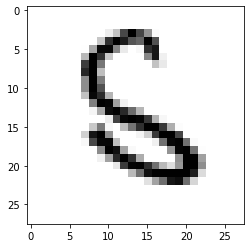

LABEL: 5
INPUT:


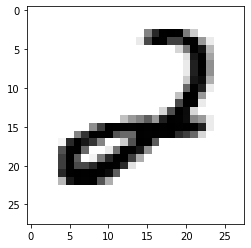

LABEL: 2
INPUT:


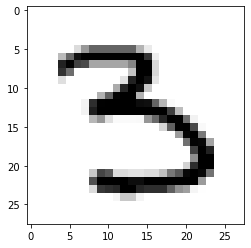

LABEL: 3
INPUT:


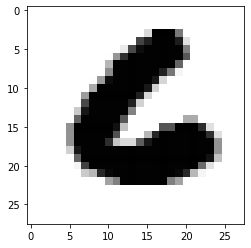

LABEL: 6
INPUT:


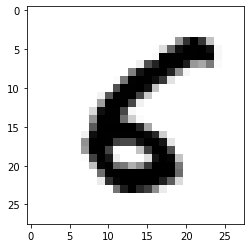

LABEL: 6
INPUT:


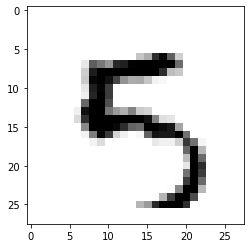

LABEL: 5
INPUT:


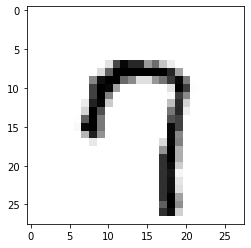

LABEL: 7
INPUT:


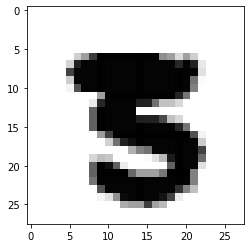

LABEL: 3
INPUT:


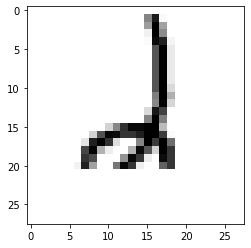

LABEL: 2
INPUT:


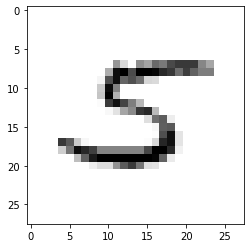

LABEL: 5
INPUT:


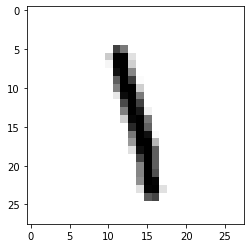

LABEL: 1
INPUT:


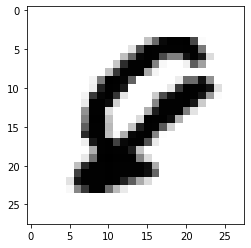

LABEL: 8
INPUT:


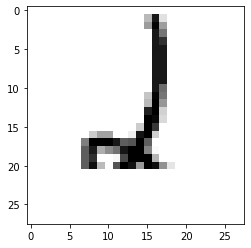

LABEL: 2
INPUT:


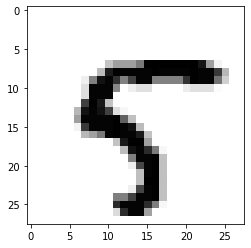

LABEL: 5
INPUT:


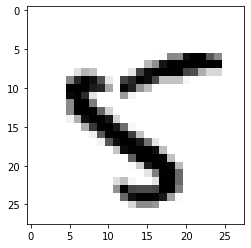

LABEL: 5
INPUT:


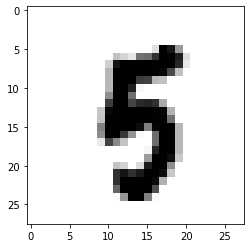

LABEL: 5
INPUT:


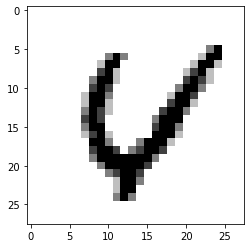

LABEL: 4
INPUT:


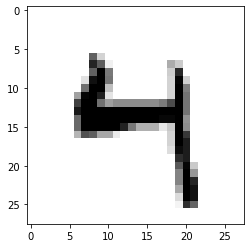

LABEL: 4
INPUT:


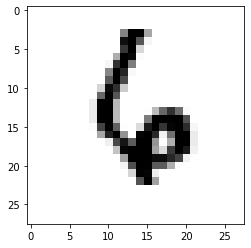

LABEL: 6
INPUT:


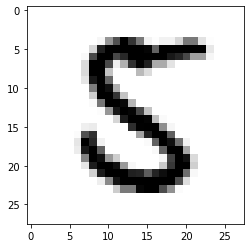

LABEL: 5
INPUT:


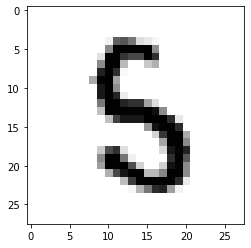

LABEL: 5
INPUT:


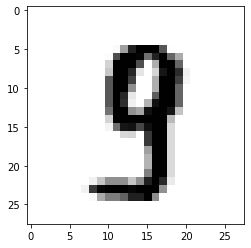

LABEL: 9
INPUT:


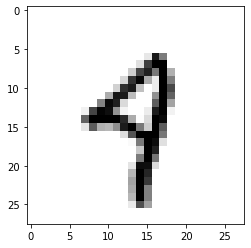

LABEL: 4
INPUT:


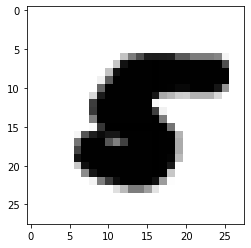

LABEL: 5
INPUT:


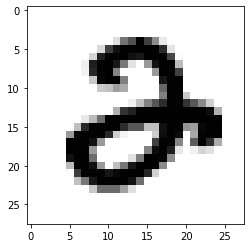

LABEL: 2
INPUT:


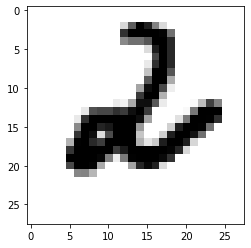

LABEL: 2
INPUT:


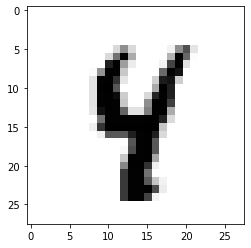

LABEL: 4
INPUT:


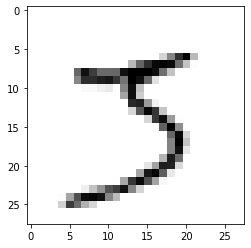

LABEL: 3
INPUT:


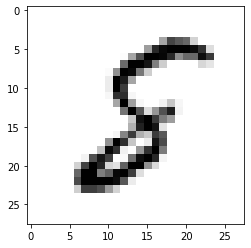

LABEL: 8
INPUT:


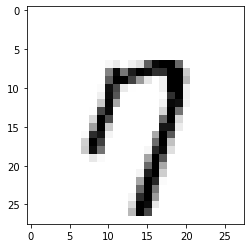

LABEL: 7
INPUT:


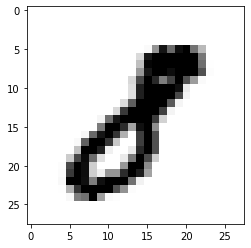

LABEL: 8
INPUT:


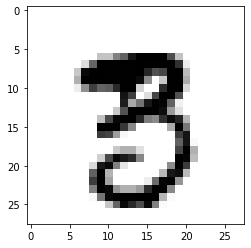

LABEL: 3
INPUT:


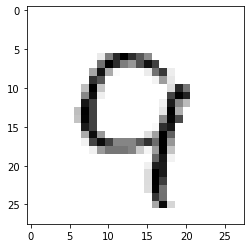

LABEL: 9
INPUT:


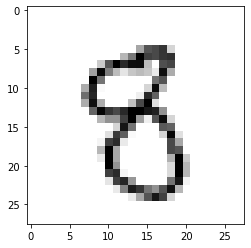

LABEL: 8
INPUT:


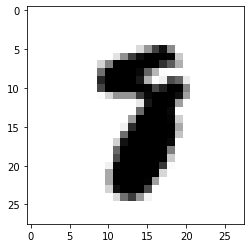

LABEL: 8
INPUT:


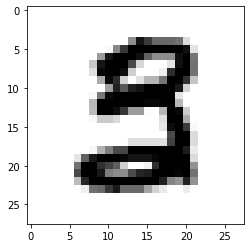

LABEL: 3
INPUT:


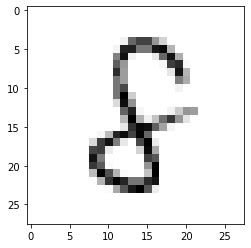

LABEL: 8
INPUT:


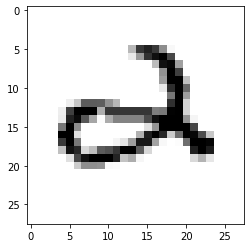

LABEL: 2
INPUT:


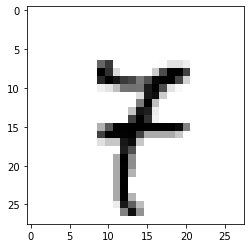

LABEL: 7
INPUT:


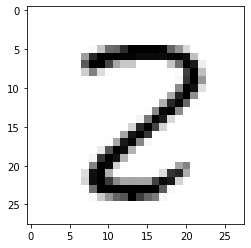

LABEL: 2
INPUT:


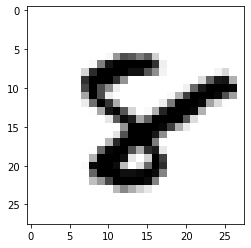

LABEL: 8
INPUT:


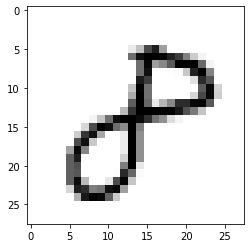

LABEL: 8
INPUT:


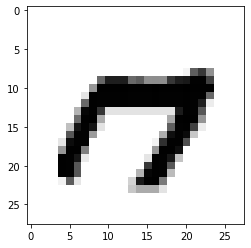

LABEL: 7
INPUT:


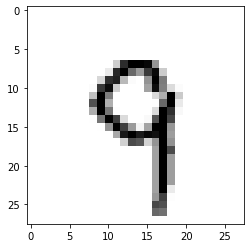

LABEL: 9
INPUT:


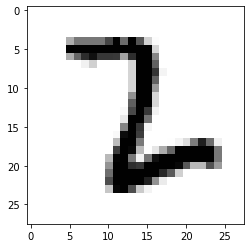

LABEL: 2
INPUT:


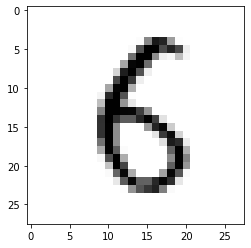

LABEL: 6
INPUT:


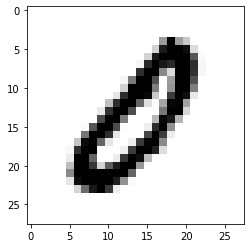

LABEL: 0
INPUT:


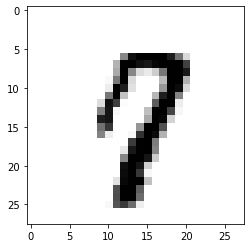

LABEL: 7
INPUT:


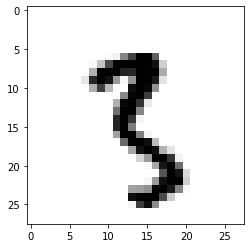

LABEL: 3
INPUT:


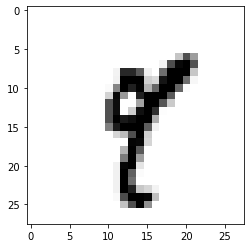

LABEL: 9
INPUT:


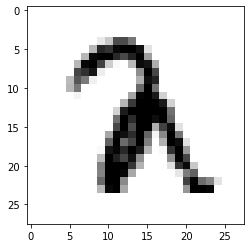

LABEL: 2
INPUT:


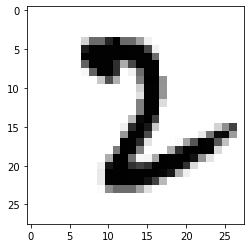

LABEL: 2
INPUT:


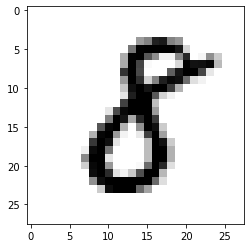

LABEL: 8
INPUT:


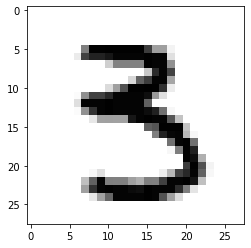

LABEL: 3
INPUT:


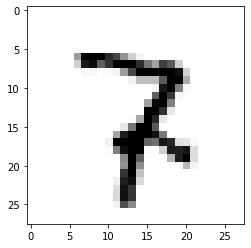

LABEL: 7
INPUT:


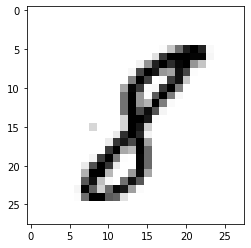

LABEL: 8
INPUT:


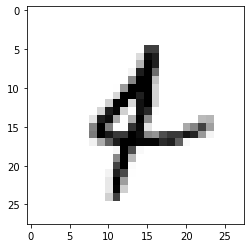

LABEL: 4
INPUT:


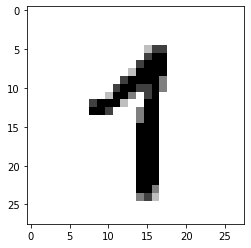

LABEL: 1
INPUT:


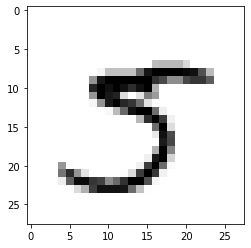

LABEL: 5
INPUT:


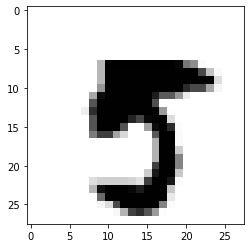

LABEL: 5
INPUT:


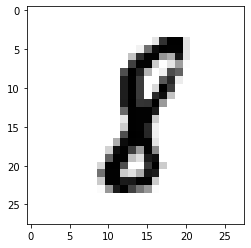

LABEL: 8
INPUT:


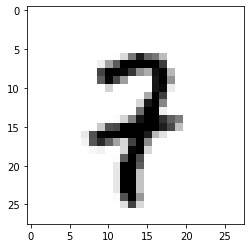

LABEL: 7
INPUT:


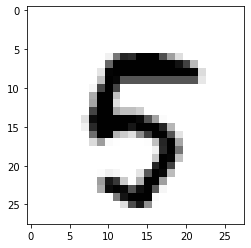

LABEL: 5
INPUT:


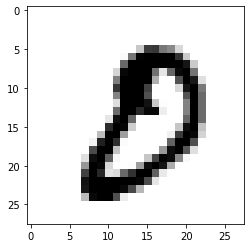

LABEL: 0
INPUT:


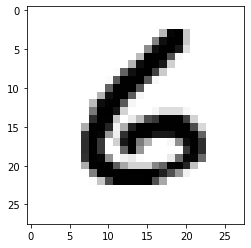

LABEL: 6
INPUT:


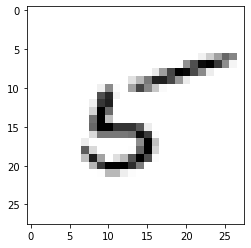

LABEL: 5
INPUT:


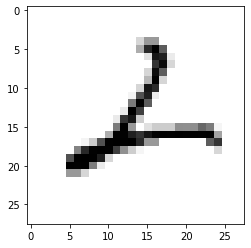

LABEL: 2
INPUT:


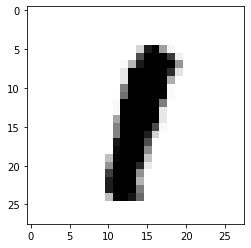

LABEL: 1
INPUT:


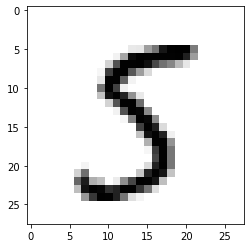

LABEL: 5
INPUT:


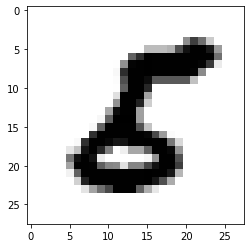

LABEL: 5
INPUT:


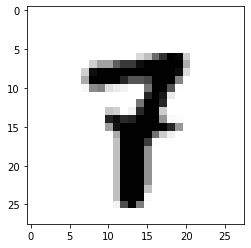

LABEL: 7
INPUT:


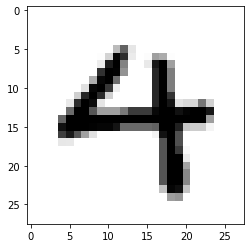

LABEL: 4
INPUT:


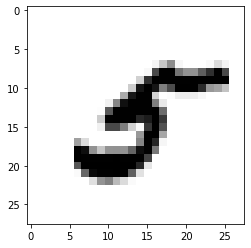

LABEL: 5
INPUT:


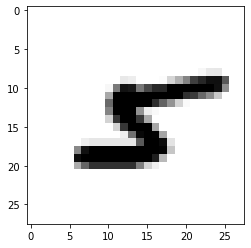

LABEL: 5
INPUT:


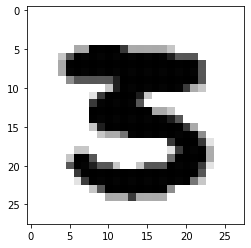

LABEL: 3
INPUT:


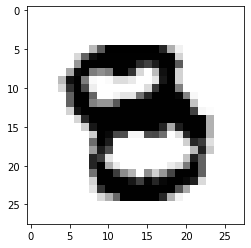

LABEL: 8
INPUT:


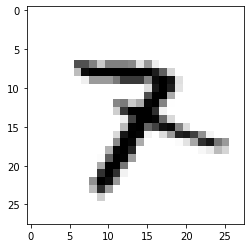

LABEL: 7
INPUT:


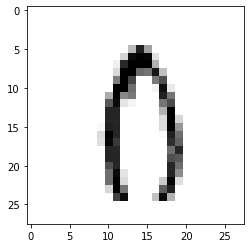

LABEL: 0
INPUT:


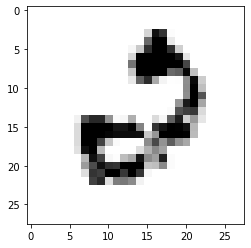

LABEL: 2
INPUT:


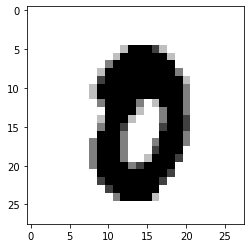

LABEL: 0
INPUT:


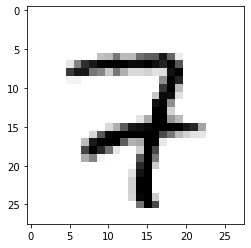

LABEL: 7
INPUT:


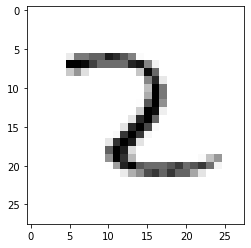

LABEL: 2
INPUT:


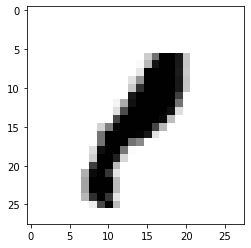

LABEL: 1
INPUT:


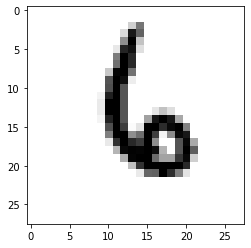

LABEL: 6
INPUT:


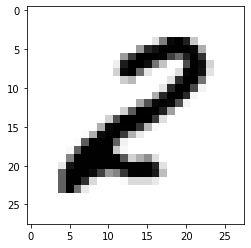

LABEL: 2
INPUT:


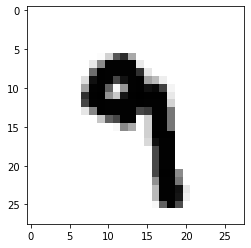

LABEL: 9
INPUT:


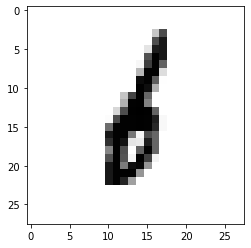

LABEL: 6
INPUT:


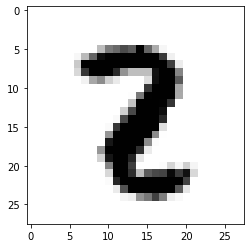

LABEL: 2
INPUT:


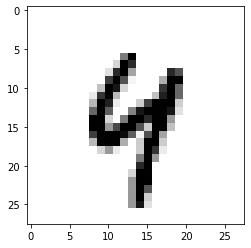

LABEL: 4
INPUT:


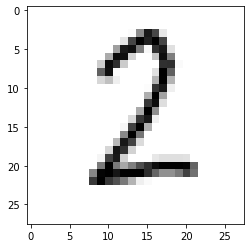

LABEL: 2
INPUT:


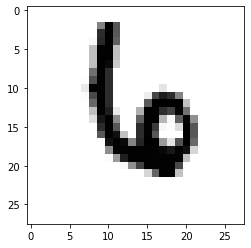

LABEL: 6
INPUT:


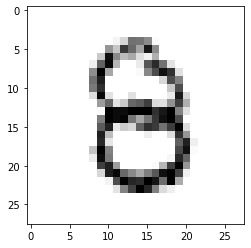

LABEL: 8
INPUT:


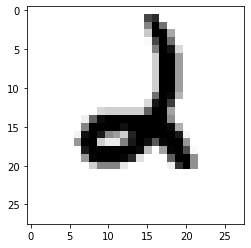

LABEL: 2
INPUT:


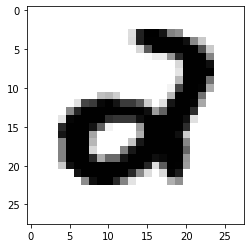

LABEL: 2
INPUT:


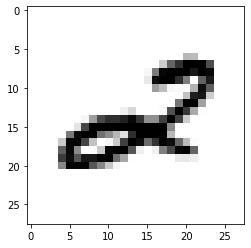

LABEL: 2
INPUT:


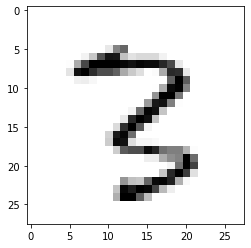

LABEL: 3
INPUT:


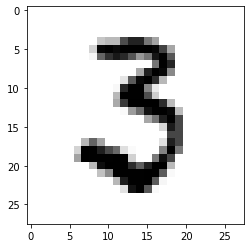

LABEL: 3
INPUT:


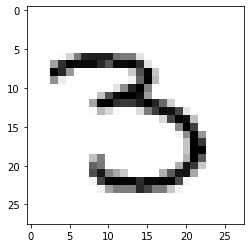

LABEL: 3
INPUT:


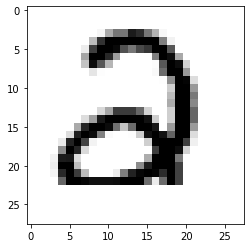

LABEL: 2
INPUT:


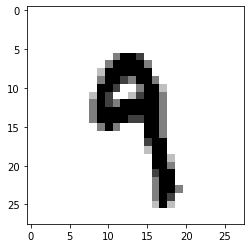

LABEL: 9
INPUT:


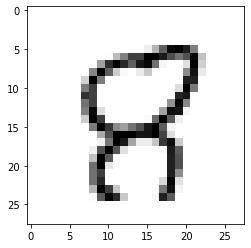

LABEL: 8
INPUT:


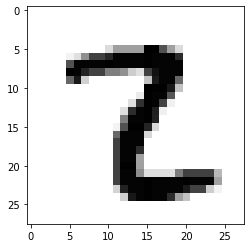

LABEL: 2
INPUT:


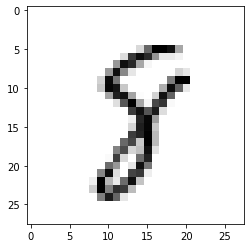

LABEL: 8
INPUT:


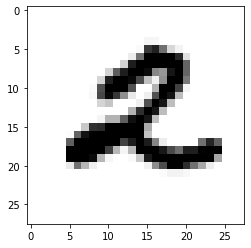

LABEL: 2
INPUT:


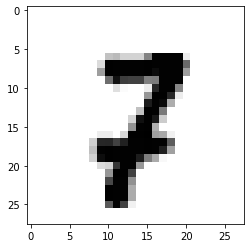

LABEL: 7
INPUT:


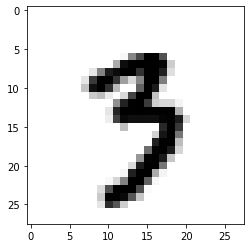

LABEL: 3
INPUT:


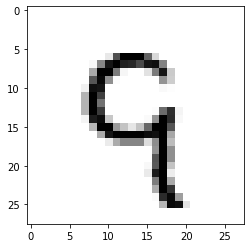

LABEL: 9
INPUT:


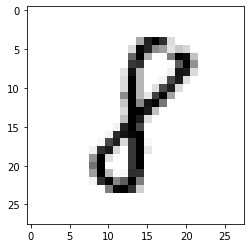

LABEL: 8
INPUT:


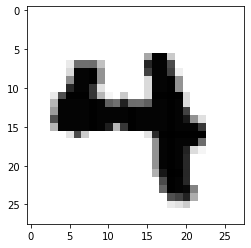

LABEL: 4
INPUT:


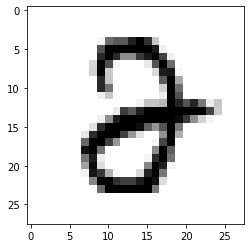

LABEL: 2
INPUT:


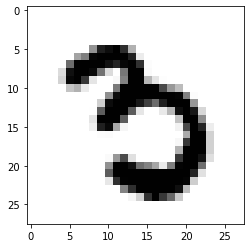

LABEL: 3
INPUT:


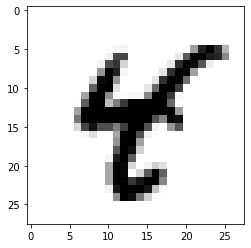

LABEL: 4
INPUT:


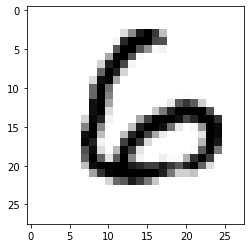

LABEL: 6
INPUT:


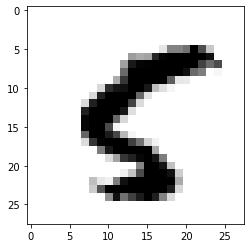

LABEL: 5
INPUT:


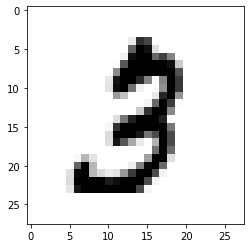

LABEL: 3
INPUT:


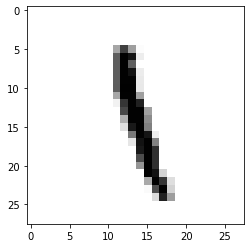

LABEL: 1
INPUT:


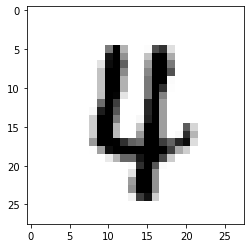

LABEL: 4
INPUT:


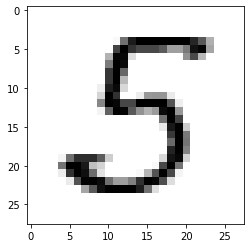

LABEL: 5
INPUT:


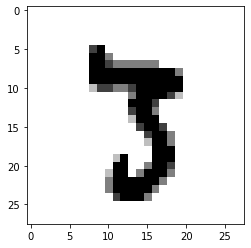

LABEL: 3
INPUT:


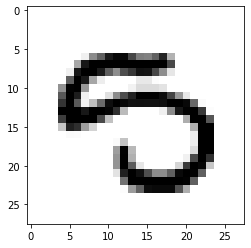

LABEL: 5
INPUT:


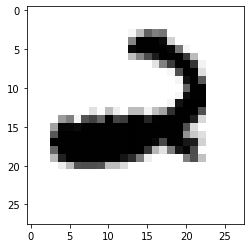

LABEL: 2
INPUT:


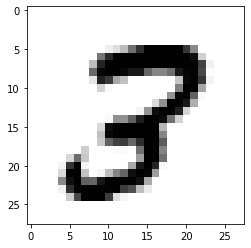

LABEL: 3
INPUT:


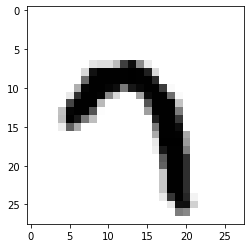

LABEL: 7
INPUT:


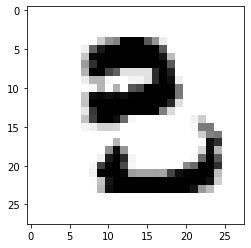

LABEL: 3
INPUT:


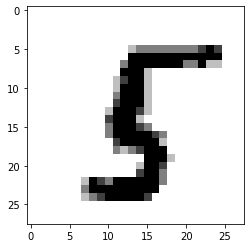

LABEL: 5
INPUT:


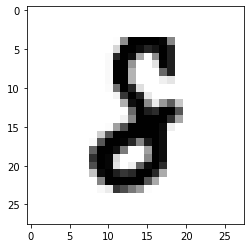

LABEL: 8
INPUT:


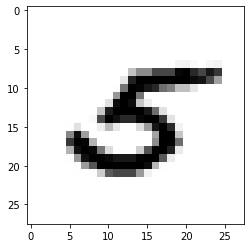

LABEL: 5
INPUT:


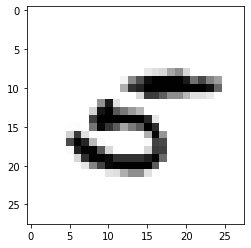

LABEL: 5
INPUT:


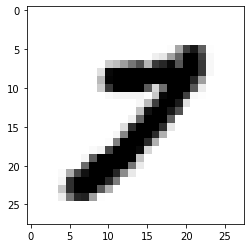

LABEL: 7
INPUT:


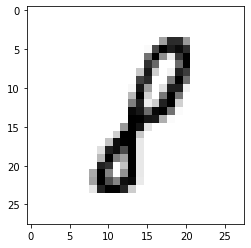

LABEL: 8
INPUT:


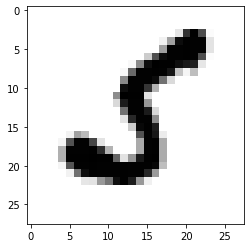

LABEL: 5
INPUT:


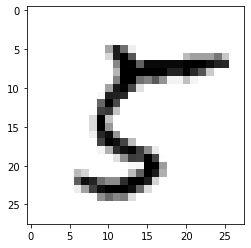

LABEL: 5
INPUT:


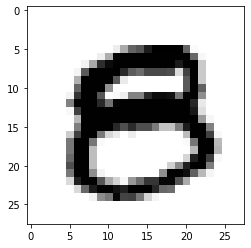

LABEL: 8
INPUT:


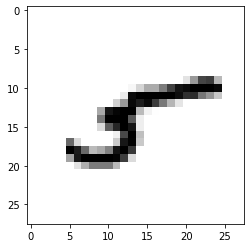

LABEL: 5
INPUT:


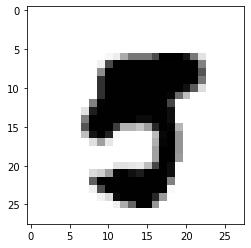

LABEL: 5
INPUT:


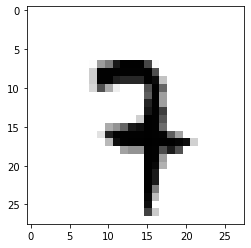

LABEL: 7
INPUT:


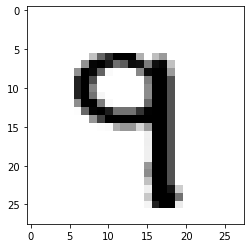

LABEL: 9
INPUT:


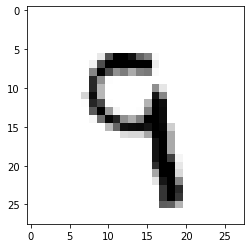

LABEL: 9
INPUT:


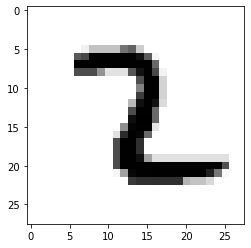

LABEL: 2
INPUT:


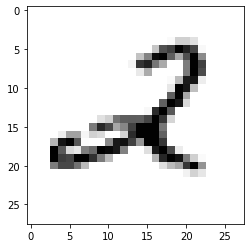

LABEL: 2
INPUT:


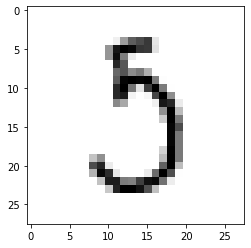

LABEL: 5
INPUT:


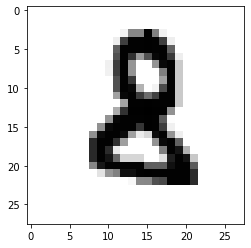

LABEL: 8
INPUT:


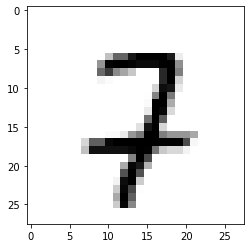

LABEL: 7
INPUT:


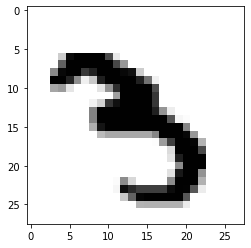

LABEL: 3
INPUT:


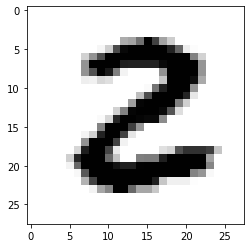

LABEL: 2
INPUT:


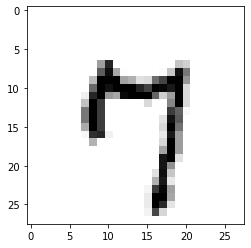

LABEL: 7
INPUT:


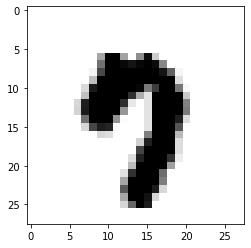

LABEL: 7
INPUT:


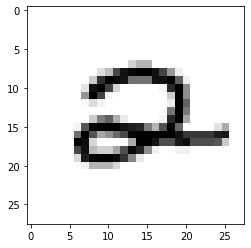

LABEL: 2
INPUT:


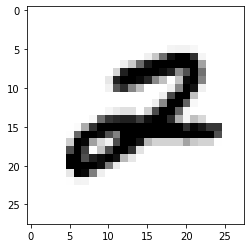

LABEL: 2
INPUT:


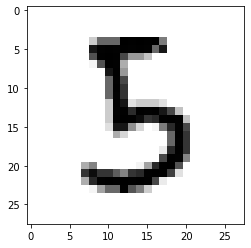

LABEL: 5
INPUT:


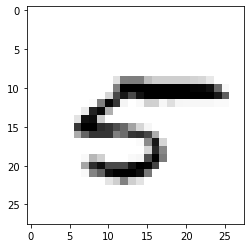

LABEL: 5
INPUT:


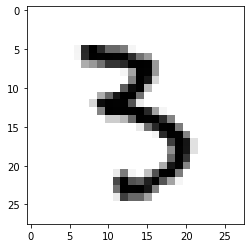

LABEL: 3
INPUT:


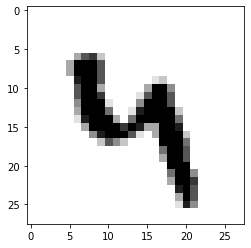

LABEL: 4
INPUT:


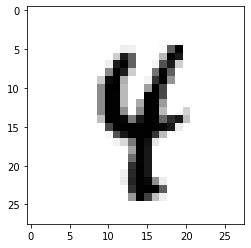

LABEL: 4
INPUT:


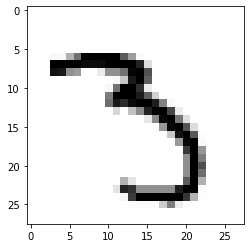

LABEL: 3
INPUT:


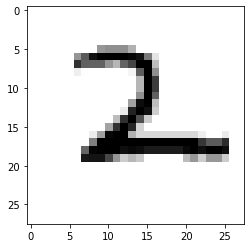

LABEL: 2
INPUT:


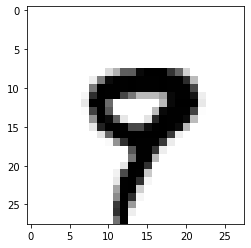

LABEL: 9
INPUT:


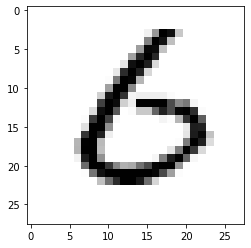

LABEL: 6
INPUT:


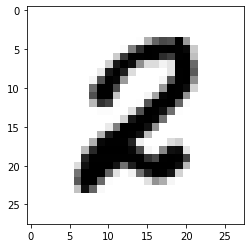

LABEL: 2
INPUT:


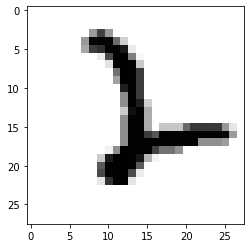

LABEL: 2
INPUT:


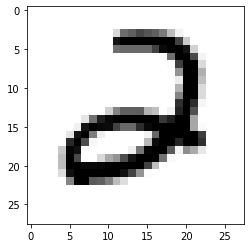

LABEL: 2
INPUT:


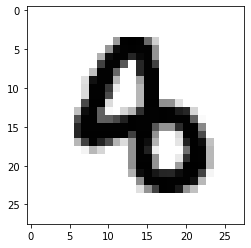

LABEL: 8
INPUT:


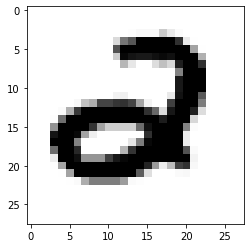

LABEL: 2
INPUT:


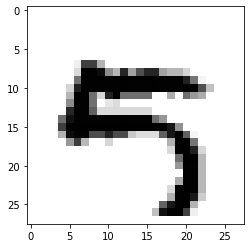

LABEL: 5
INPUT:


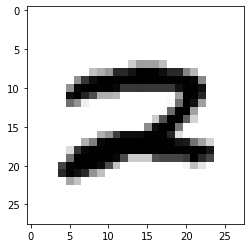

LABEL: 2
INPUT:


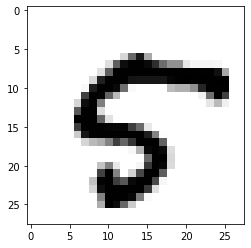

LABEL: 5
INPUT:


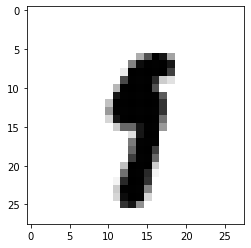

LABEL: 9
INPUT:


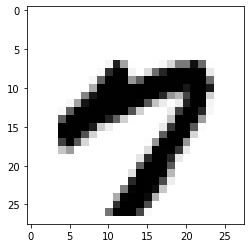

LABEL: 7
INPUT:


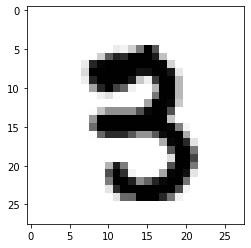

LABEL: 3
INPUT:


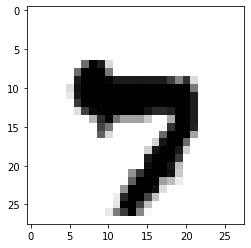

LABEL: 7
INPUT:


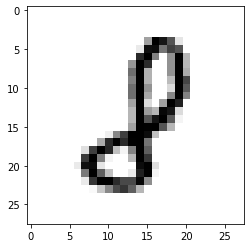

LABEL: 8
INPUT:


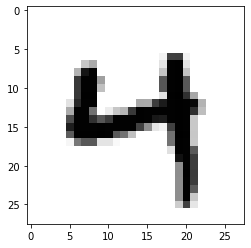

LABEL: 4
INPUT:


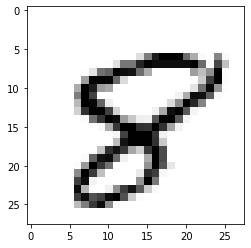

LABEL: 8
INPUT:


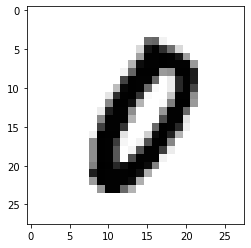

LABEL: 0
INPUT:


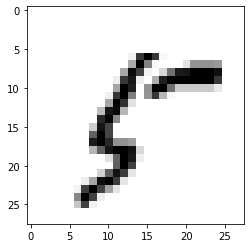

LABEL: 5
INPUT:


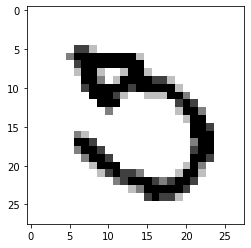

LABEL: 5
INPUT:


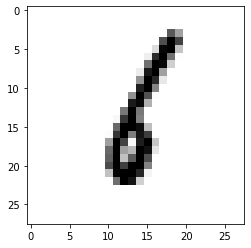

LABEL: 6
INPUT:


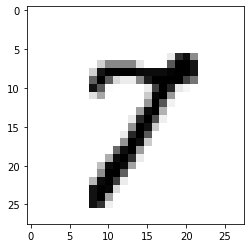

LABEL: 7
INPUT:


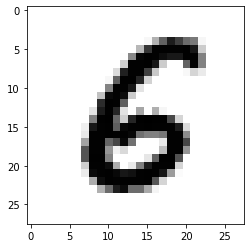

LABEL: 6
INPUT:


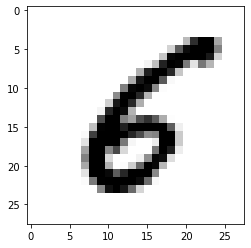

LABEL: 6
INPUT:


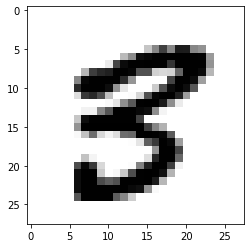

LABEL: 3
INPUT:


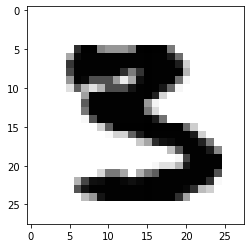

LABEL: 3
INPUT:


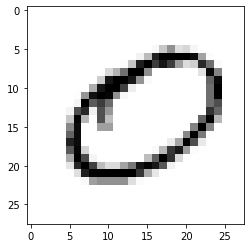

LABEL: 0
INPUT:


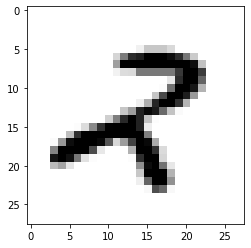

LABEL: 2
INPUT:


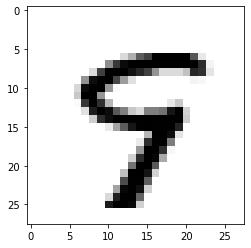

LABEL: 9
INPUT:


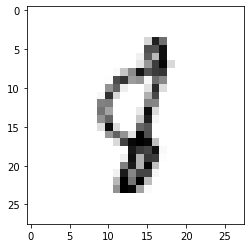

LABEL: 8
INPUT:


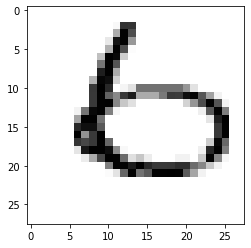

LABEL: 6
INPUT:


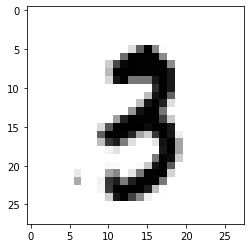

LABEL: 3
INPUT:


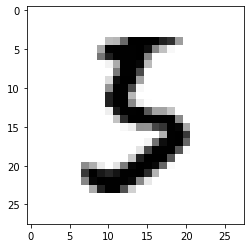

LABEL: 5
INPUT:


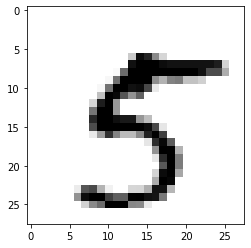

LABEL: 5
INPUT:


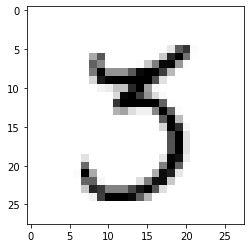

LABEL: 3
INPUT:


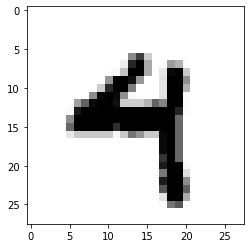

LABEL: 4
INPUT:


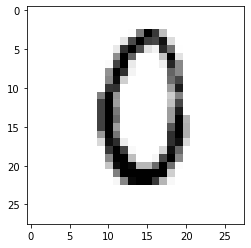

LABEL: 0
INPUT:


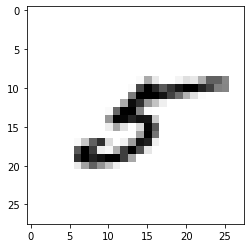

LABEL: 5
INPUT:


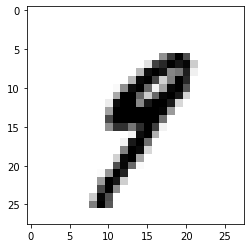

LABEL: 9
INPUT:


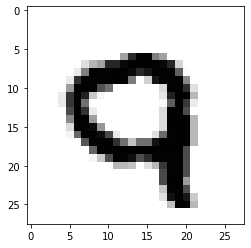

LABEL: 9
INPUT:


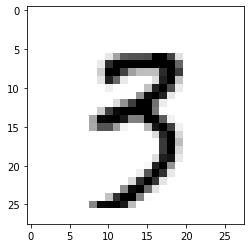

LABEL: 3
INPUT:


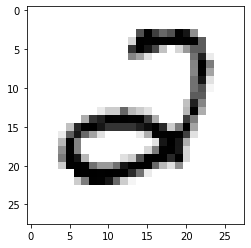

LABEL: 2
INPUT:


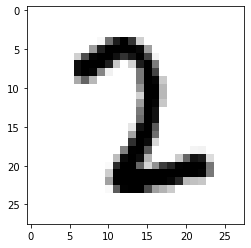

LABEL: 2
INPUT:


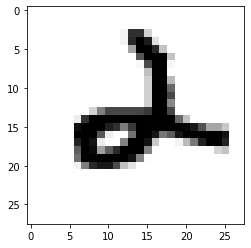

LABEL: 2
INPUT:


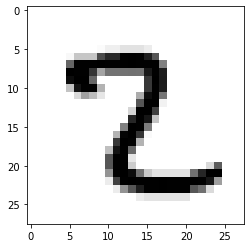

LABEL: 2
INPUT:


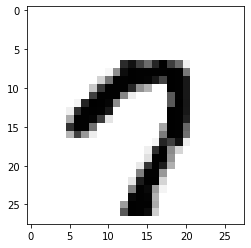

LABEL: 7
INPUT:


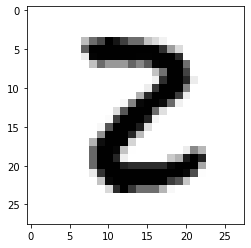

LABEL: 2
INPUT:


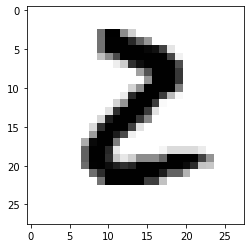

LABEL: 2
INPUT:


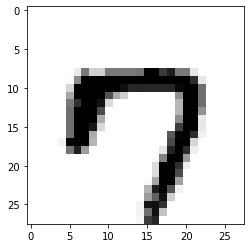

LABEL: 7
INPUT:


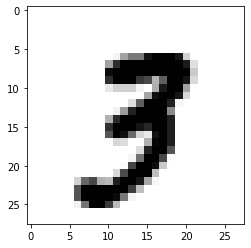

LABEL: 3
INPUT:


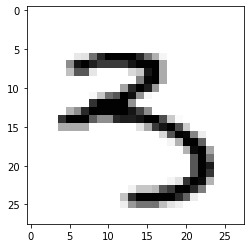

LABEL: 3
INPUT:


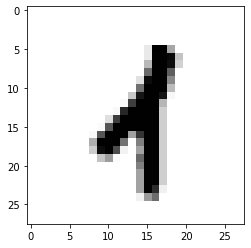

LABEL: 1
INPUT:


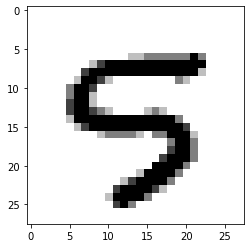

LABEL: 5
INPUT:


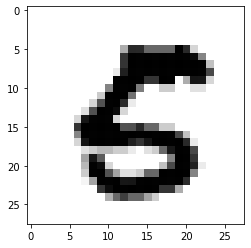

LABEL: 5
INPUT:


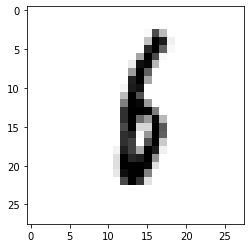

LABEL: 6
INPUT:


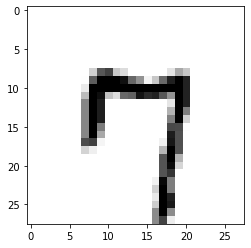

LABEL: 7
INPUT:


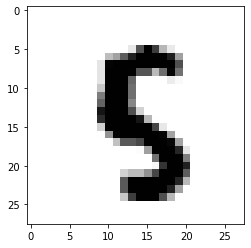

LABEL: 5
INPUT:


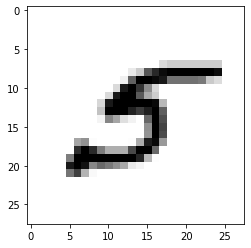

LABEL: 5
INPUT:


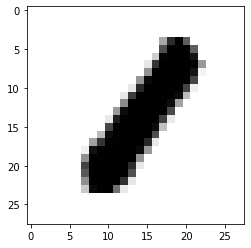

LABEL: 1
INPUT:


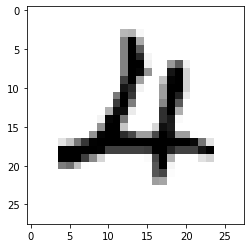

LABEL: 4
INPUT:


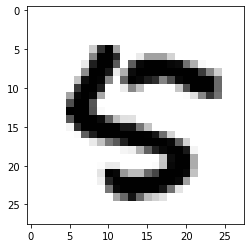

LABEL: 5
INPUT:


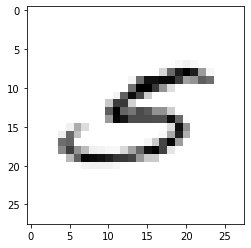

LABEL: 5
INPUT:


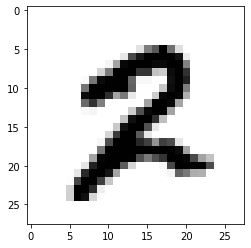

LABEL: 2
INPUT:


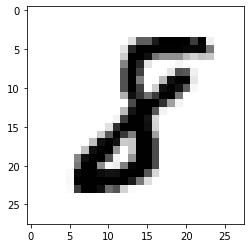

LABEL: 8
INPUT:


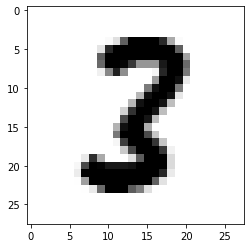

LABEL: 3
INPUT:


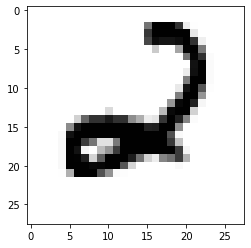

LABEL: 2
INPUT:


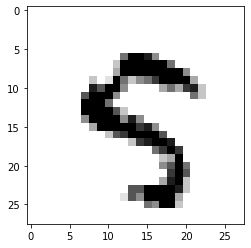

LABEL: 5
INPUT:


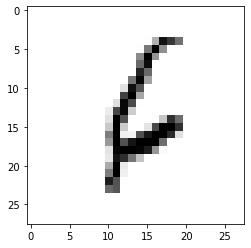

LABEL: 6
INPUT:


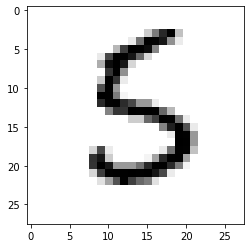

LABEL: 5
INPUT:


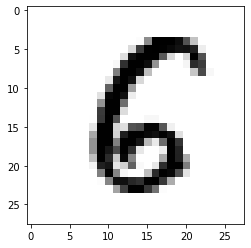

LABEL: 6
INPUT:


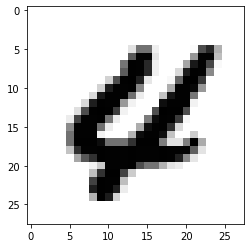

LABEL: 4
INPUT:


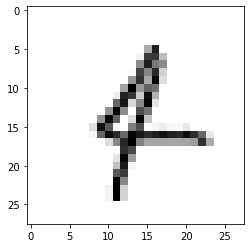

LABEL: 4
INPUT:


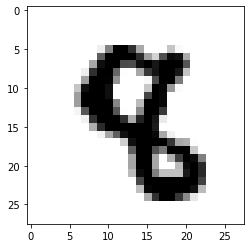

LABEL: 8
INPUT:


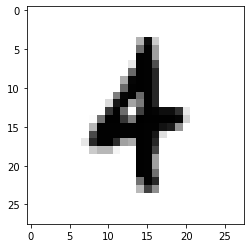

LABEL: 4
INPUT:


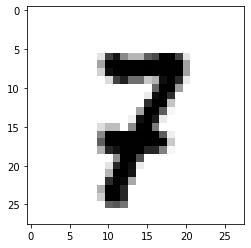

LABEL: 7
INPUT:


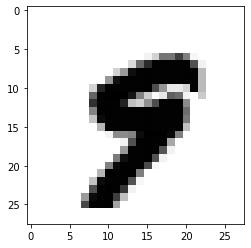

LABEL: 9
INPUT:


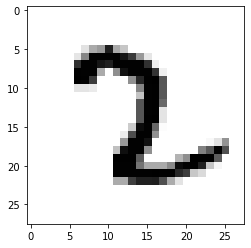

LABEL: 2
INPUT:


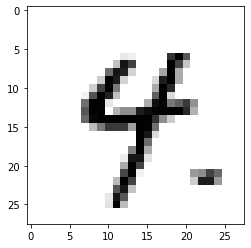

LABEL: 4
INPUT:


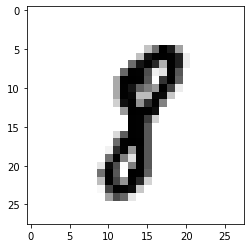

LABEL: 8
INPUT:


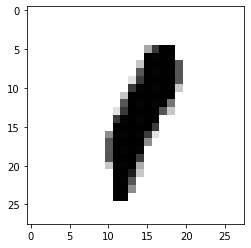

LABEL: 1
INPUT:


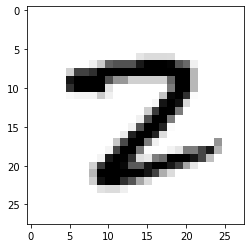

LABEL: 2
INPUT:


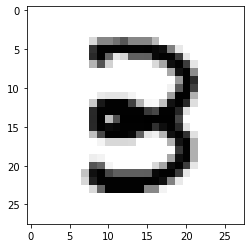

LABEL: 3
INPUT:


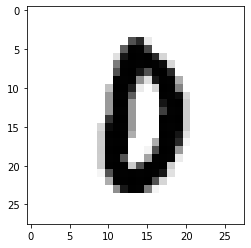

LABEL: 0
INPUT:


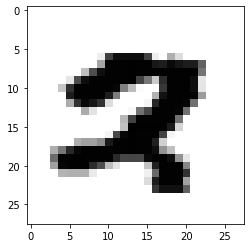

LABEL: 2
INPUT:


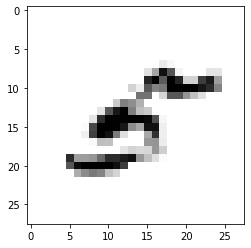

LABEL: 5
INPUT:


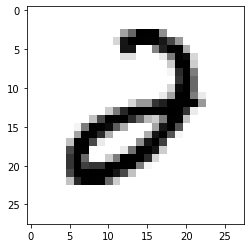

LABEL: 2
INPUT:


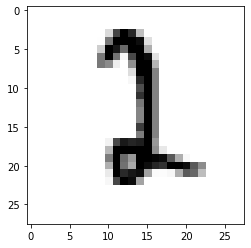

LABEL: 2
INPUT:


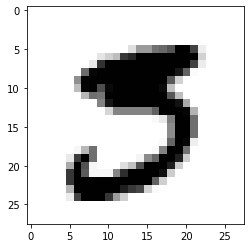

LABEL: 3
INPUT:


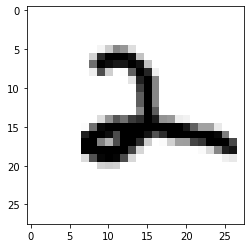

LABEL: 2
INPUT:


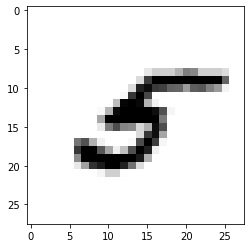

LABEL: 5
INPUT:


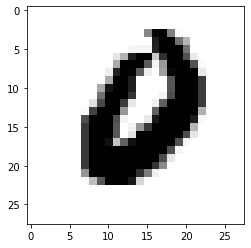

LABEL: 0
INPUT:


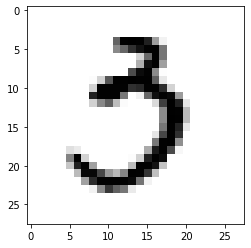

LABEL: 3
INPUT:


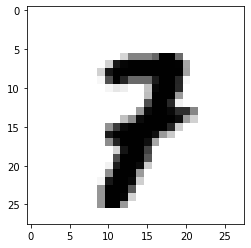

LABEL: 7
INPUT:


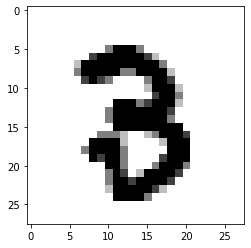

LABEL: 3
INPUT:


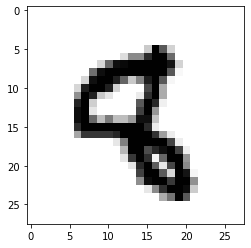

LABEL: 8
INPUT:


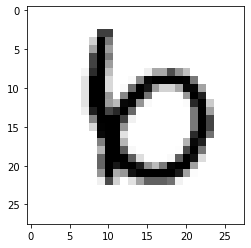

LABEL: 6
INPUT:


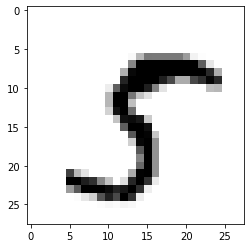

LABEL: 5
INPUT:


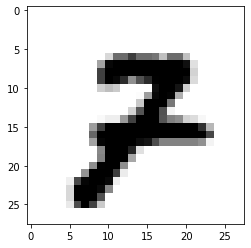

LABEL: 7
INPUT:


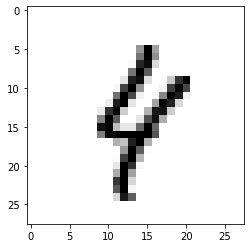

LABEL: 4
INPUT:


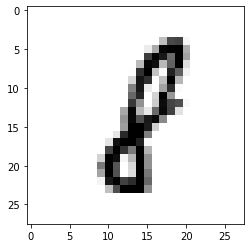

LABEL: 8
INPUT:


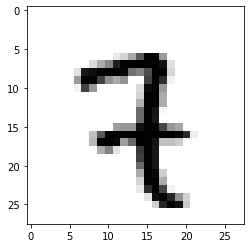

LABEL: 7
INPUT:


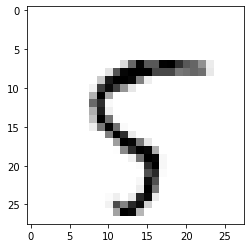

LABEL: 5
INPUT:


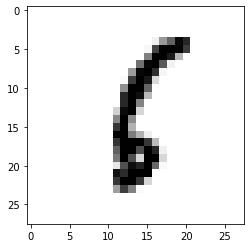

LABEL: 6
INPUT:


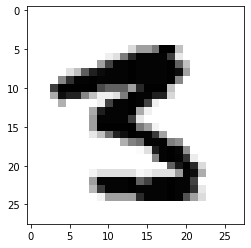

LABEL: 3
INPUT:


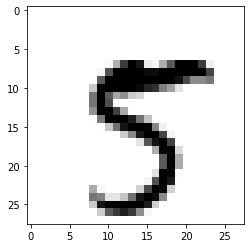

LABEL: 5
INPUT:


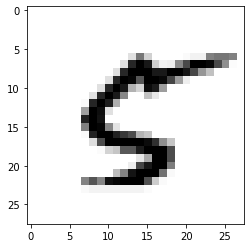

LABEL: 5
INPUT:


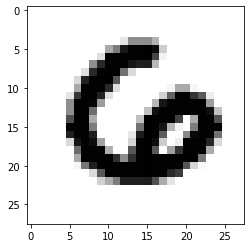

LABEL: 6
INPUT:


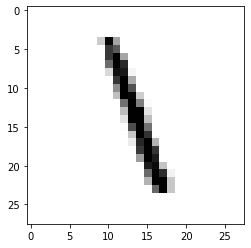

LABEL: 1
INPUT:


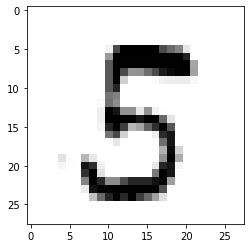

LABEL: 5
INPUT:


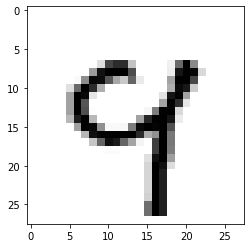

LABEL: 9
INPUT:


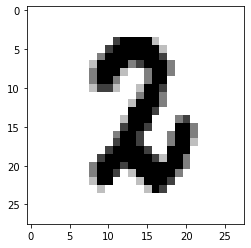

LABEL: 2
INPUT:


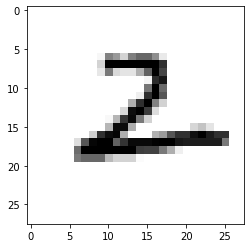

LABEL: 2
INPUT:


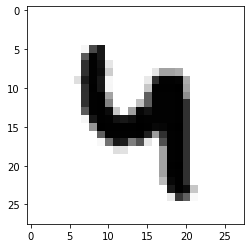

LABEL: 4
INPUT:


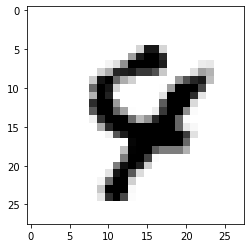

LABEL: 4
INPUT:


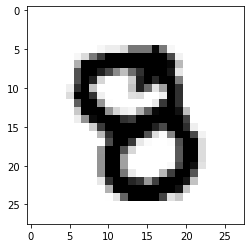

LABEL: 8
INPUT:


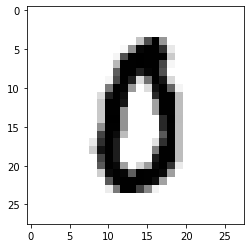

LABEL: 0
INPUT:


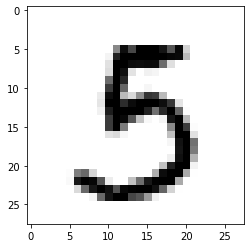

LABEL: 5
INPUT:


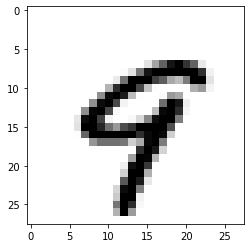

LABEL: 9
INPUT:


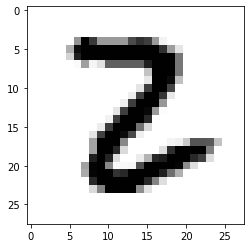

LABEL: 2
INPUT:


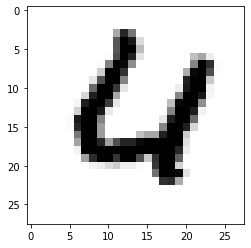

LABEL: 4
INPUT:


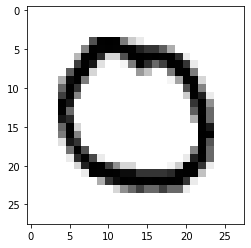

LABEL: 0
INPUT:


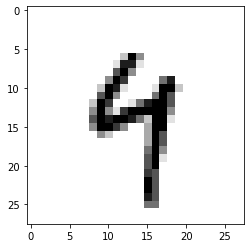

LABEL: 4
INPUT:


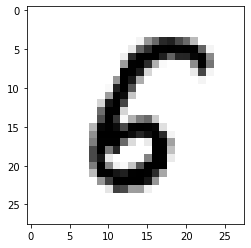

LABEL: 6
INPUT:


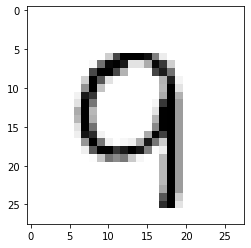

LABEL: 9
INPUT:


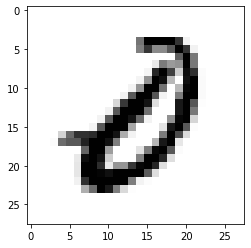

LABEL: 0
INPUT:


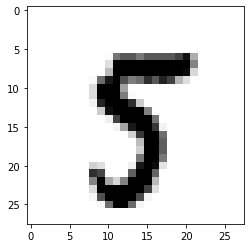

LABEL: 5
INPUT:


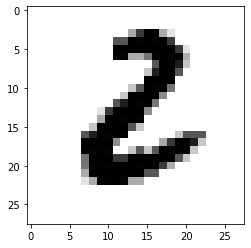

LABEL: 2
INPUT:


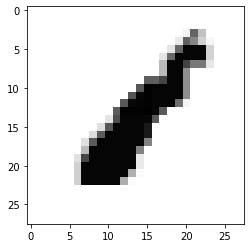

LABEL: 1
INPUT:


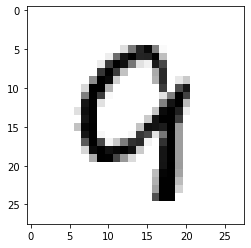

LABEL: 9
INPUT:


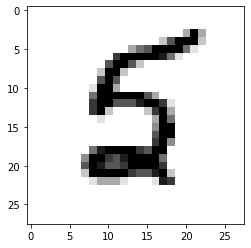

LABEL: 5
INPUT:


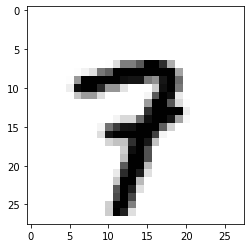

LABEL: 7
INPUT:


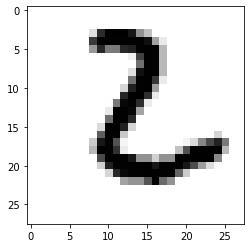

LABEL: 2
INPUT:


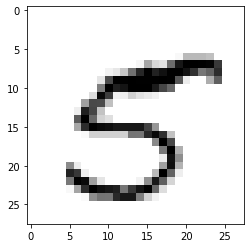

LABEL: 5
INPUT:


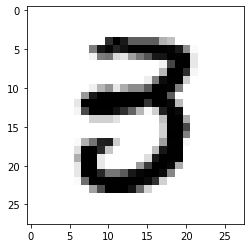

LABEL: 3
INPUT:


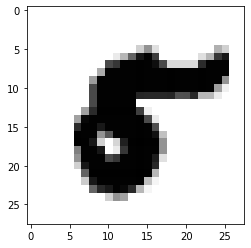

LABEL: 5
INPUT:


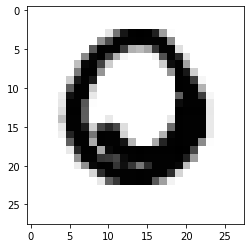

LABEL: 0
INPUT:


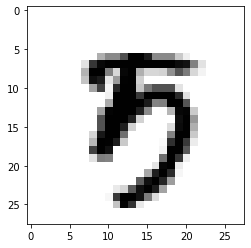

LABEL: 5
INPUT:


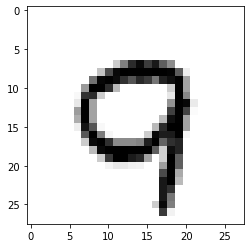

LABEL: 9
INPUT:


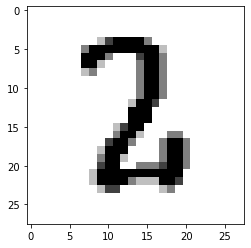

LABEL: 2
INPUT:


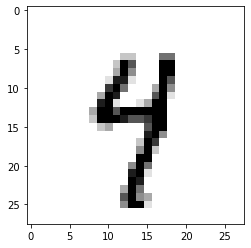

LABEL: 4
INPUT:


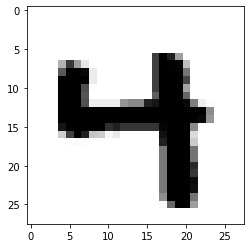

LABEL: 4
INPUT:


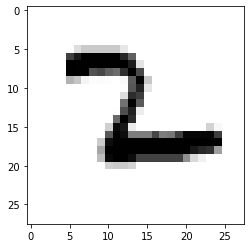

LABEL: 2
INPUT:


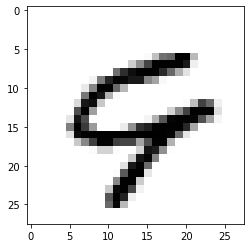

LABEL: 9
INPUT:


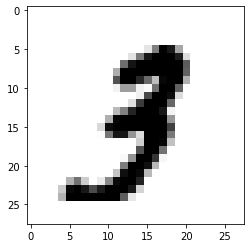

LABEL: 3
INPUT:


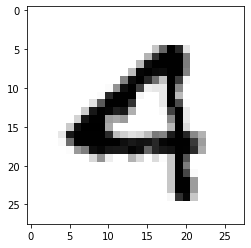

LABEL: 4
INPUT:


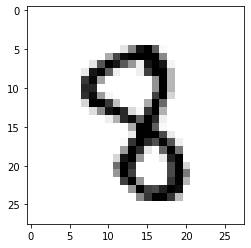

LABEL: 8
INPUT:


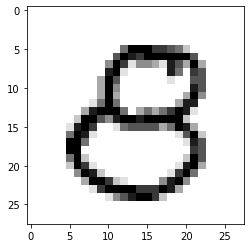

LABEL: 8
INPUT:


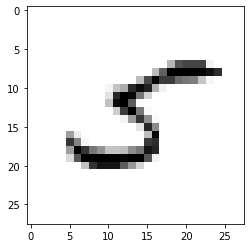

LABEL: 5
INPUT:


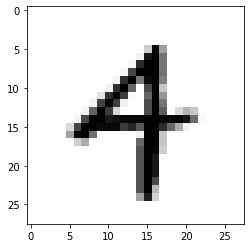

LABEL: 4
INPUT:


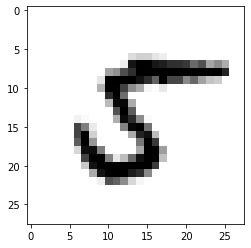

LABEL: 5
INPUT:


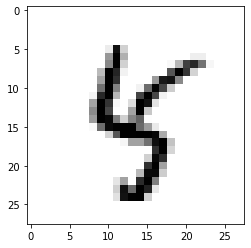

LABEL: 5
INPUT:


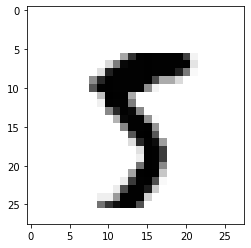

LABEL: 5
INPUT:


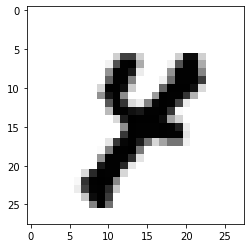

LABEL: 4
INPUT:


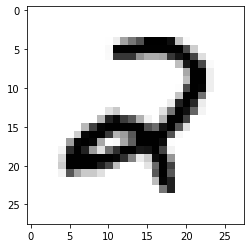

LABEL: 2
INPUT:


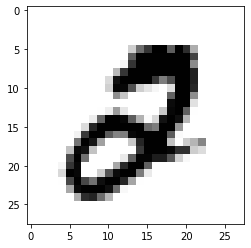

LABEL: 2
INPUT:


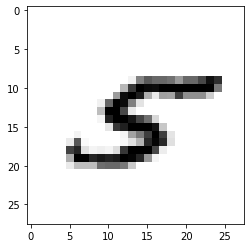

LABEL: 5
INPUT:


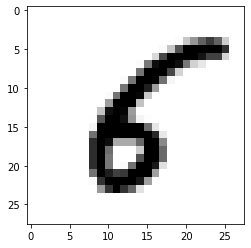

LABEL: 6
INPUT:


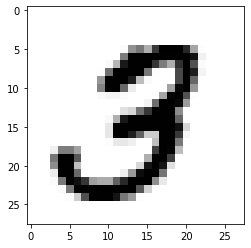

LABEL: 3
INPUT:


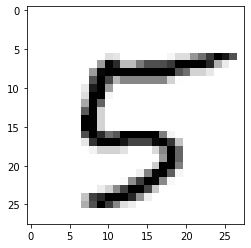

LABEL: 5
INPUT:


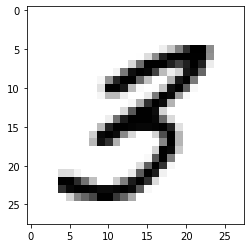

LABEL: 3
INPUT:


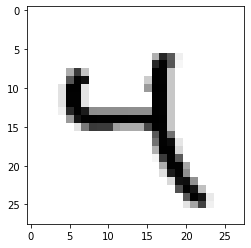

LABEL: 4
INPUT:


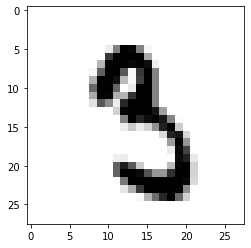

LABEL: 3
INPUT:


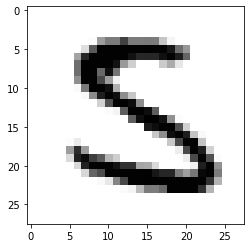

LABEL: 5
INPUT:


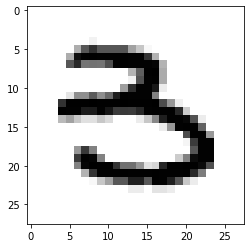

LABEL: 3
INPUT:


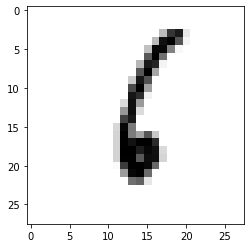

LABEL: 6
INPUT:


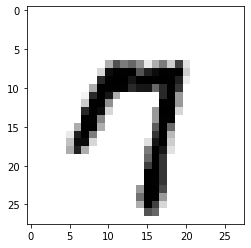

LABEL: 7
INPUT:


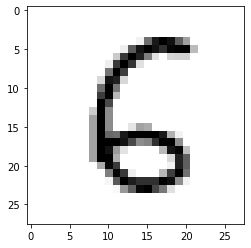

LABEL: 6
INPUT:


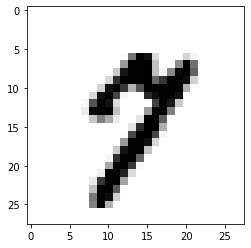

LABEL: 7
INPUT:


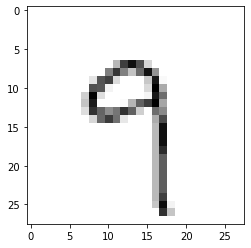

LABEL: 9
INPUT:


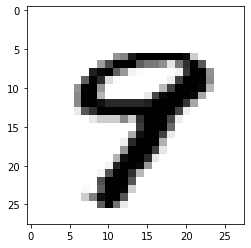

LABEL: 9
INPUT:


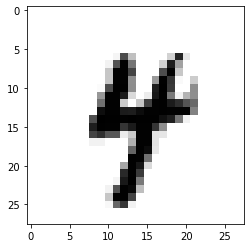

LABEL: 4
INPUT:


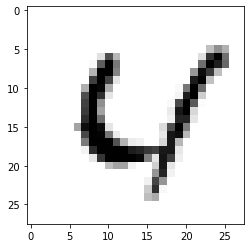

LABEL: 4
INPUT:


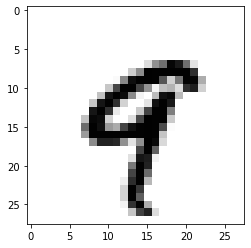

LABEL: 9
INPUT:


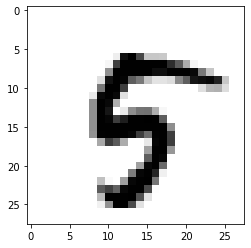

LABEL: 5
INPUT:


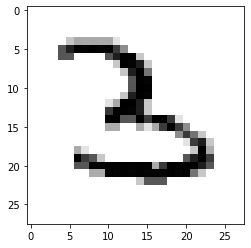

LABEL: 3
INPUT:


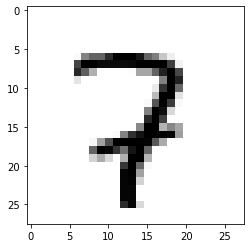

LABEL: 7
INPUT:


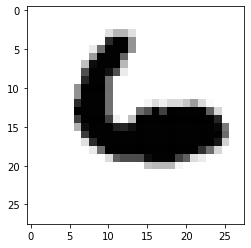

LABEL: 6
INPUT:


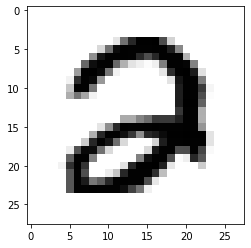

LABEL: 2
INPUT:


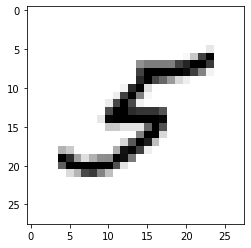

LABEL: 5
INPUT:


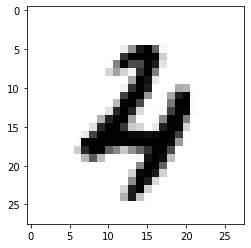

LABEL: 4
INPUT:


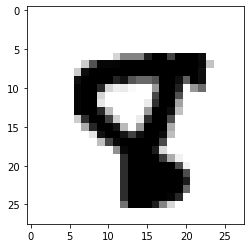

LABEL: 8
INPUT:


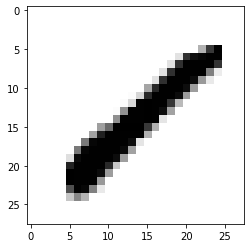

LABEL: 1
INPUT:


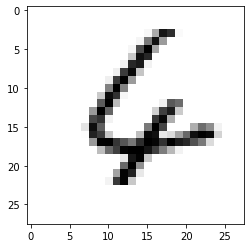

LABEL: 4
INPUT:


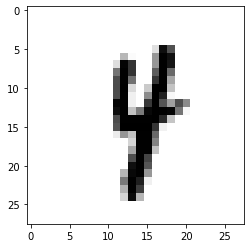

LABEL: 4
INPUT:


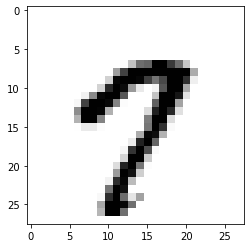

LABEL: 7
INPUT:


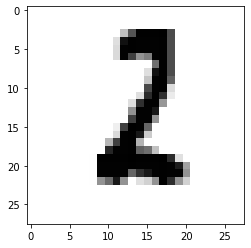

LABEL: 2
INPUT:


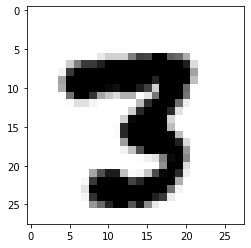

LABEL: 3
INPUT:


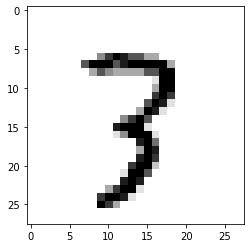

LABEL: 3
INPUT:


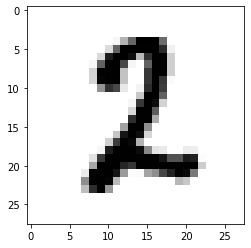

LABEL: 2
INPUT:


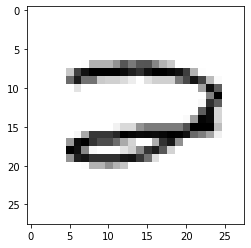

LABEL: 2
INPUT:


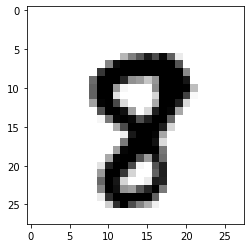

LABEL: 8
INPUT:


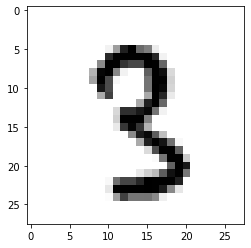

LABEL: 3
INPUT:


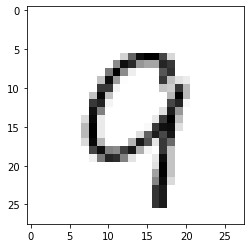

LABEL: 9
INPUT:


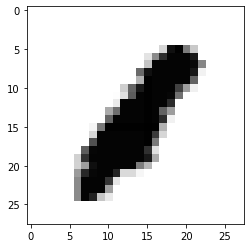

LABEL: 1
INPUT:


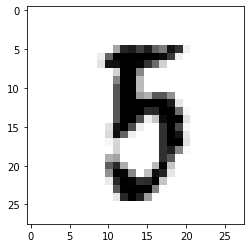

LABEL: 5
INPUT:


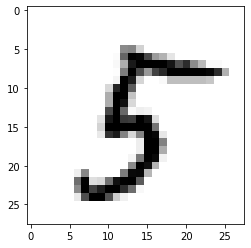

LABEL: 5
INPUT:


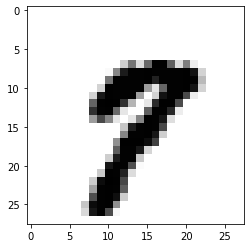

LABEL: 7
INPUT:


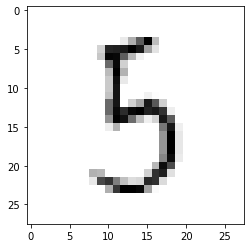

LABEL: 5
INPUT:


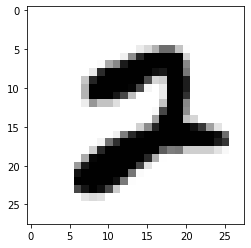

LABEL: 2
INPUT:


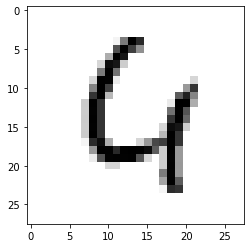

LABEL: 4
INPUT:


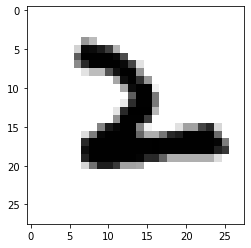

LABEL: 2
INPUT:


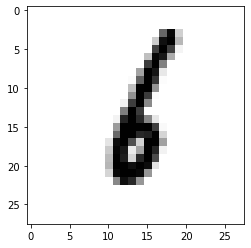

LABEL: 6
INPUT:


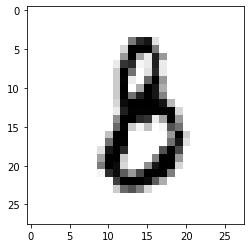

LABEL: 8
INPUT:


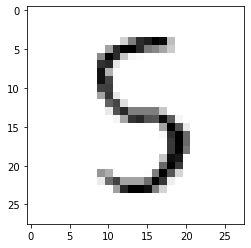

LABEL: 5
INPUT:


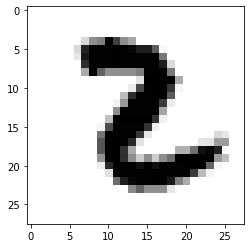

LABEL: 2
INPUT:


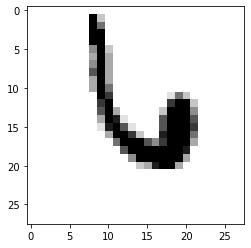

LABEL: 6
INPUT:


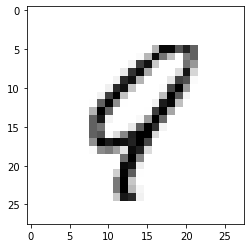

LABEL: 9
INPUT:


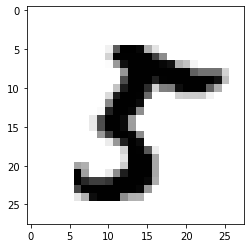

LABEL: 5
INPUT:


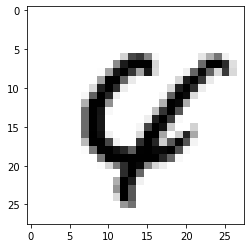

LABEL: 4
INPUT:


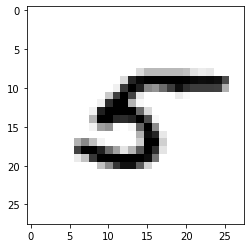

LABEL: 5
INPUT:


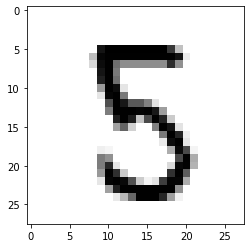

LABEL: 5
INPUT:


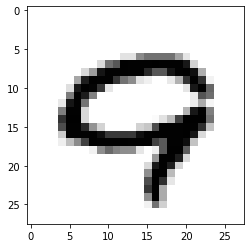

LABEL: 9
INPUT:


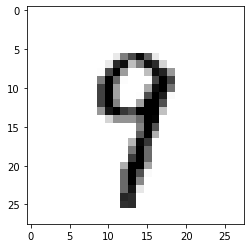

LABEL: 9
INPUT:


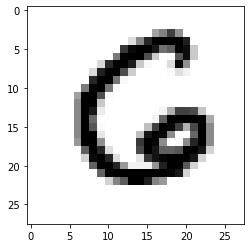

LABEL: 6
INPUT:


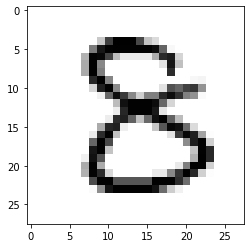

LABEL: 8
INPUT:


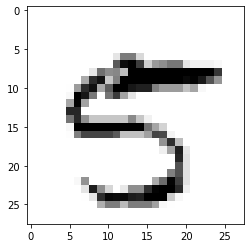

LABEL: 5
INPUT:


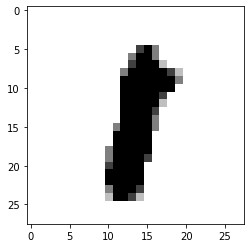

LABEL: 1
INPUT:


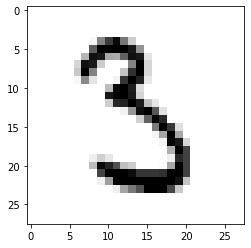

LABEL: 3
INPUT:


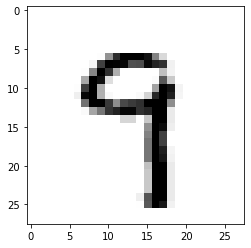

LABEL: 9
INPUT:


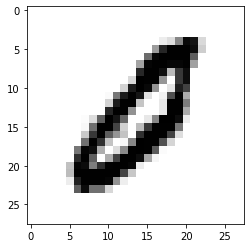

LABEL: 0
INPUT:


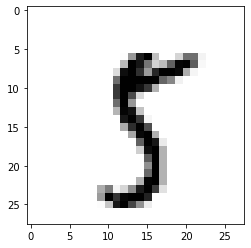

LABEL: 5
INPUT:


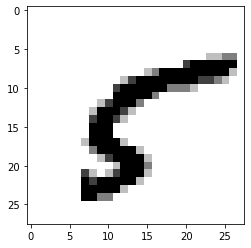

LABEL: 5
INPUT:


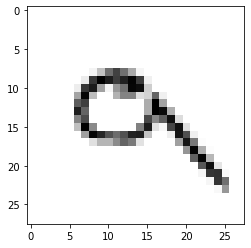

LABEL: 9
INPUT:


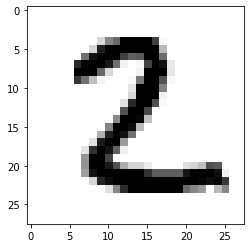

LABEL: 2
INPUT:


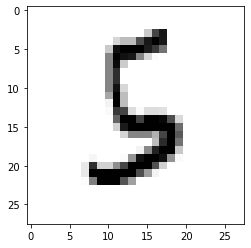

LABEL: 5
INPUT:


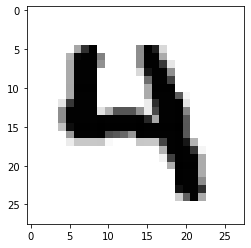

LABEL: 4
INPUT:


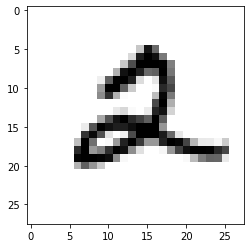

LABEL: 2
INPUT:


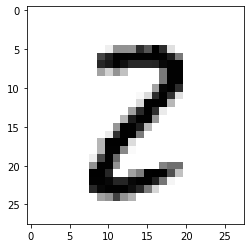

LABEL: 2
INPUT:


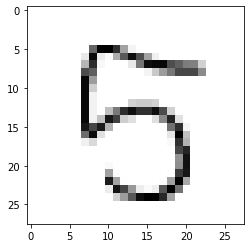

LABEL: 5
INPUT:


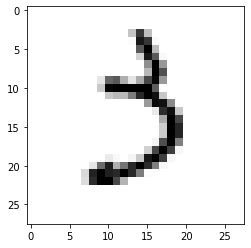

LABEL: 3
INPUT:


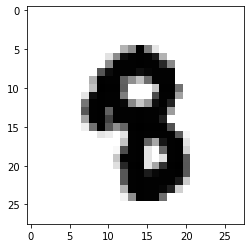

LABEL: 8
INPUT:


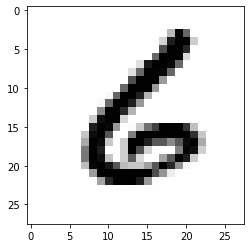

LABEL: 6
INPUT:


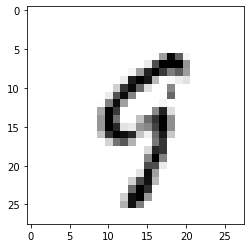

LABEL: 9
INPUT:


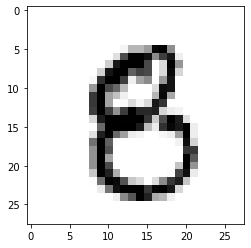

LABEL: 8
INPUT:


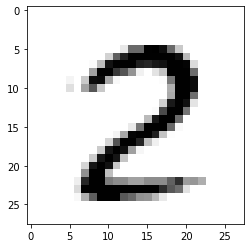

LABEL: 2
INPUT:


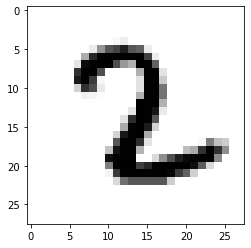

LABEL: 2
INPUT:


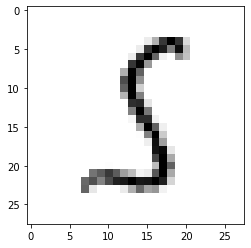

LABEL: 5
INPUT:


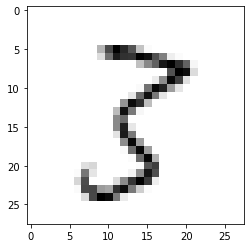

LABEL: 3
INPUT:


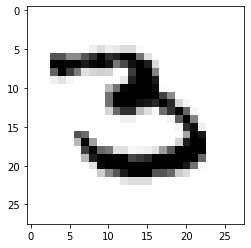

LABEL: 3
INPUT:


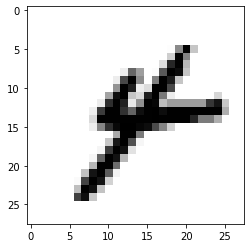

LABEL: 4
INPUT:


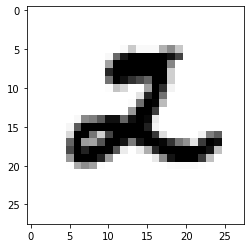

LABEL: 2
INPUT:


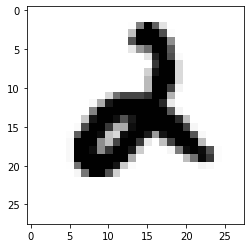

LABEL: 2
INPUT:


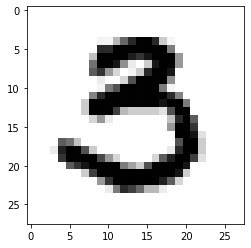

LABEL: 3
INPUT:


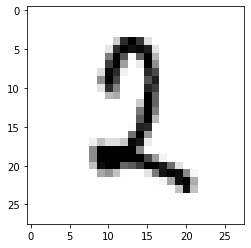

LABEL: 2
INPUT:


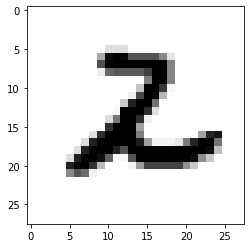

LABEL: 2
INPUT:


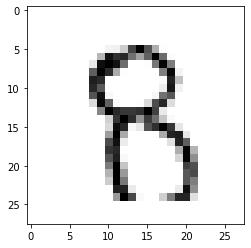

LABEL: 8
INPUT:


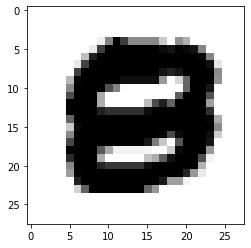

LABEL: 8
INPUT:


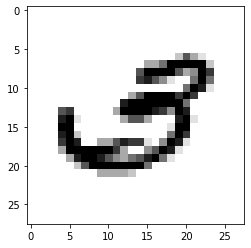

LABEL: 3
INPUT:


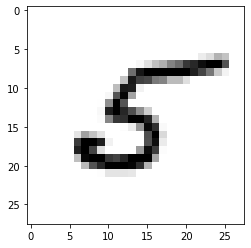

LABEL: 5
INPUT:


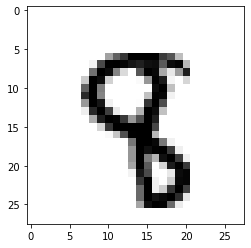

LABEL: 8
INPUT:


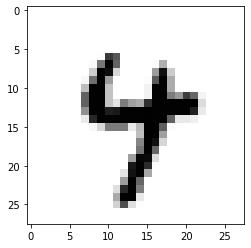

LABEL: 4
INPUT:


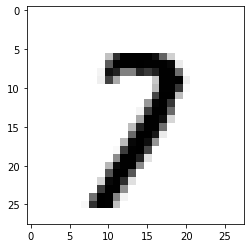

LABEL: 7
INPUT:


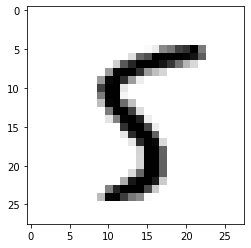

LABEL: 5
INPUT:


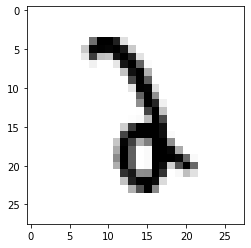

LABEL: 2
INPUT:


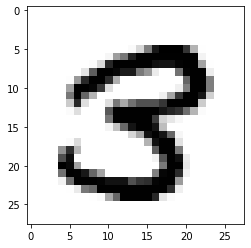

LABEL: 3
INPUT:


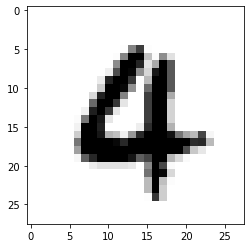

LABEL: 4
INPUT:


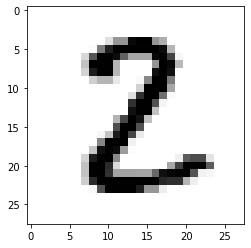

LABEL: 2
INPUT:


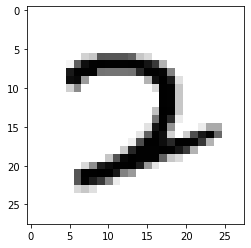

LABEL: 2
INPUT:


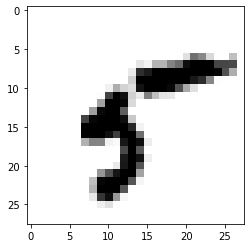

LABEL: 5
INPUT:


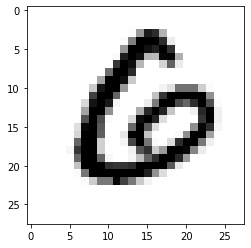

LABEL: 6
INPUT:


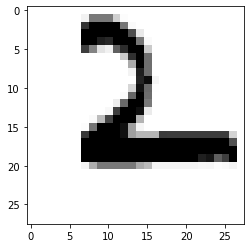

LABEL: 2
INPUT:


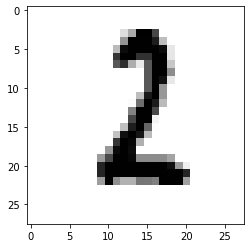

LABEL: 2
INPUT:


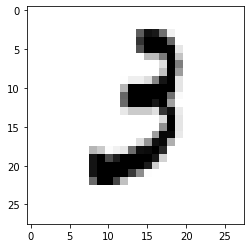

LABEL: 3
INPUT:


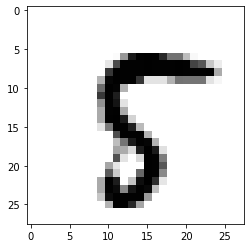

LABEL: 5
INPUT:


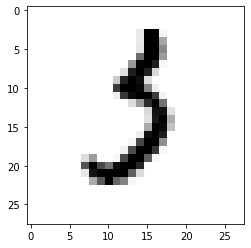

LABEL: 3
INPUT:


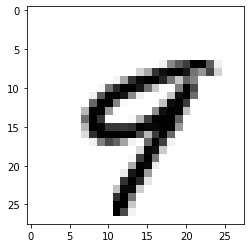

LABEL: 9
INPUT:


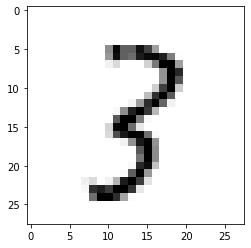

LABEL: 3
INPUT:


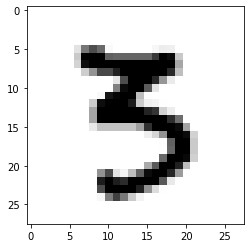

LABEL: 3
INPUT:


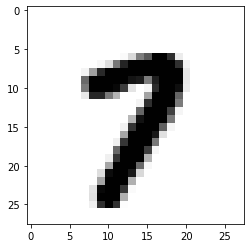

LABEL: 7
INPUT:


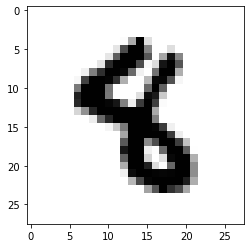

LABEL: 8
INPUT:


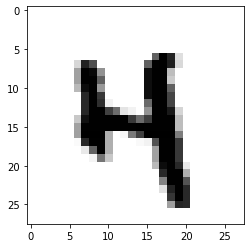

LABEL: 4
INPUT:


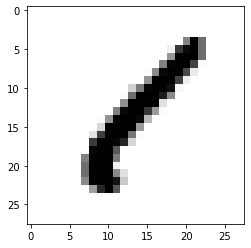

LABEL: 1
INPUT:


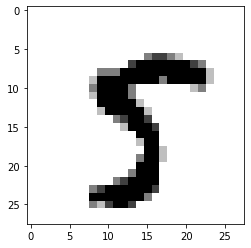

LABEL: 5
INPUT:


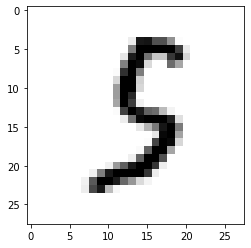

LABEL: 5
INPUT:


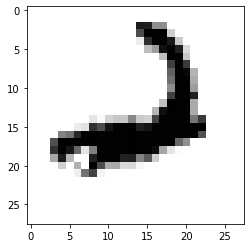

LABEL: 2
INPUT:


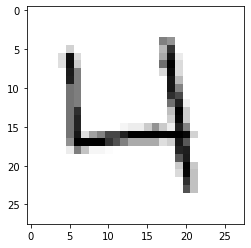

LABEL: 4
INPUT:


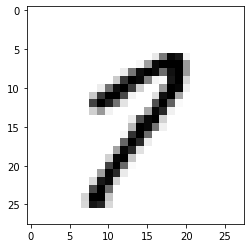

LABEL: 7
INPUT:


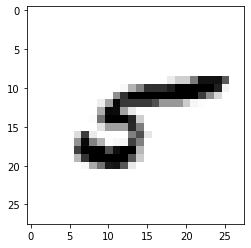

LABEL: 5
INPUT:


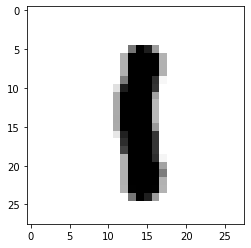

LABEL: 1
INPUT:


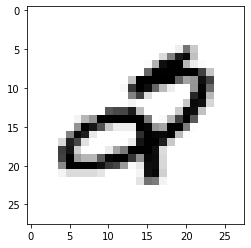

LABEL: 2
INPUT:


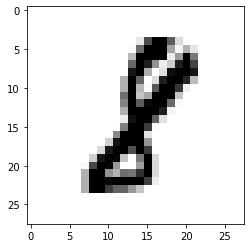

LABEL: 8
INPUT:


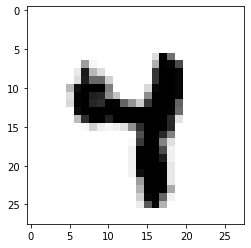

LABEL: 4
INPUT:


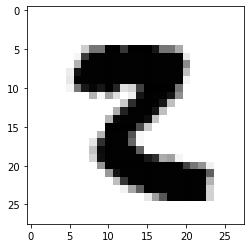

LABEL: 2
INPUT:


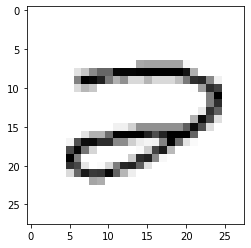

LABEL: 2
INPUT:


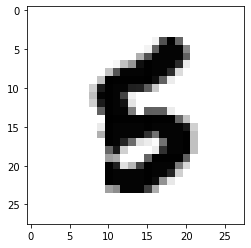

LABEL: 5
INPUT:


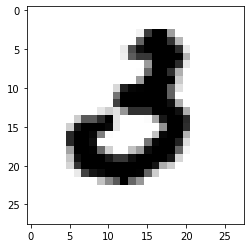

LABEL: 3
INPUT:


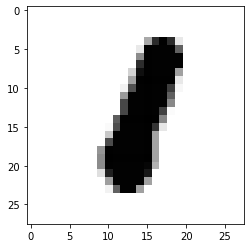

LABEL: 1
INPUT:


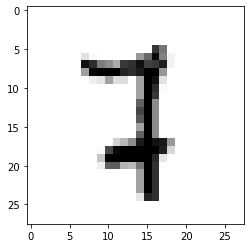

LABEL: 7
INPUT:


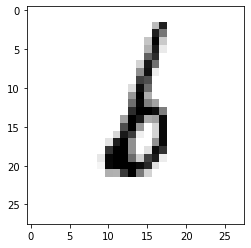

LABEL: 6
INPUT:


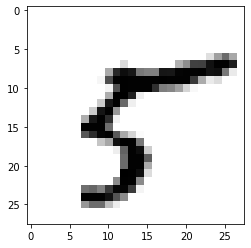

LABEL: 5
INPUT:


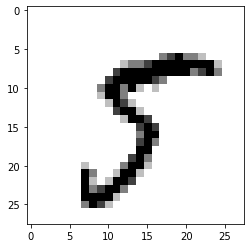

LABEL: 5
INPUT:


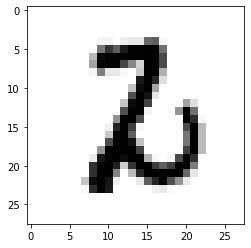

LABEL: 2
INPUT:


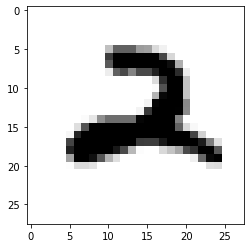

LABEL: 2
INPUT:


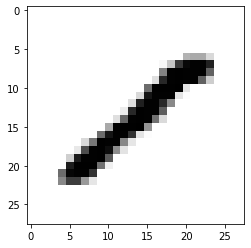

LABEL: 1
INPUT:


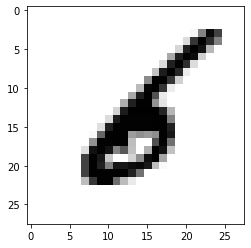

LABEL: 6
INPUT:


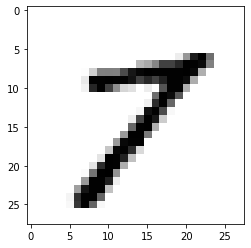

LABEL: 7
INPUT:


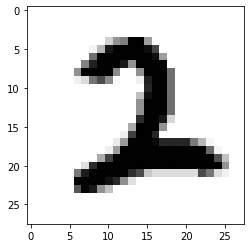

LABEL: 2
INPUT:


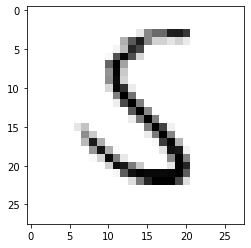

LABEL: 5
INPUT:


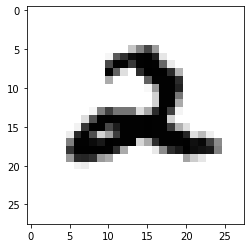

LABEL: 2
INPUT:


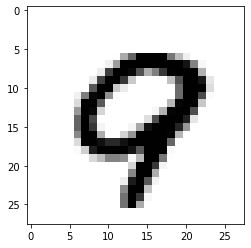

LABEL: 9
INPUT:


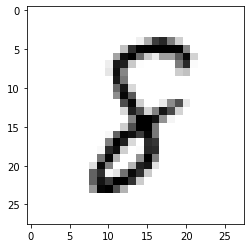

LABEL: 8
INPUT:


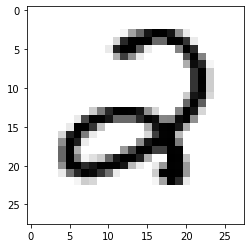

LABEL: 2
INPUT:


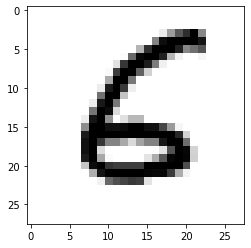

LABEL: 6
INPUT:


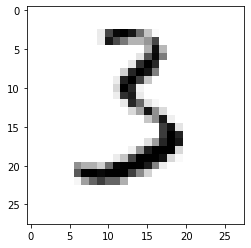

LABEL: 3
INPUT:


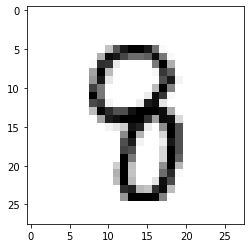

LABEL: 8
INPUT:


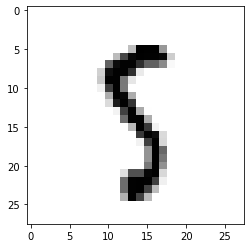

LABEL: 5
INPUT:


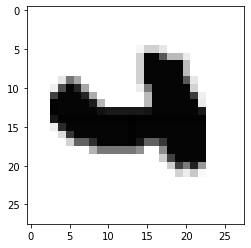

LABEL: 4
INPUT:


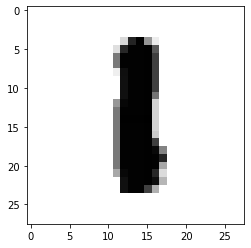

LABEL: 1
INPUT:


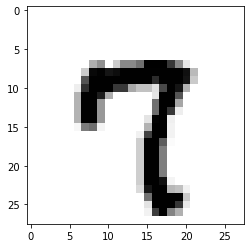

LABEL: 7
INPUT:


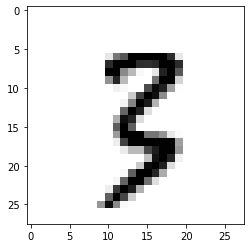

LABEL: 3
INPUT:


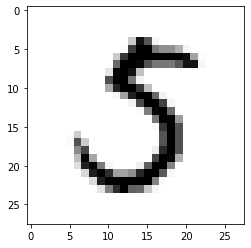

LABEL: 5
INPUT:


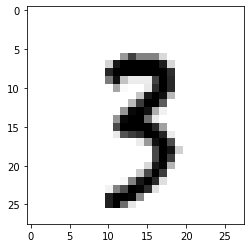

LABEL: 3
INPUT:


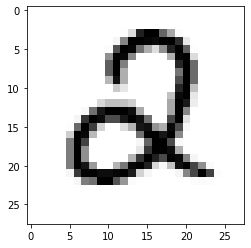

LABEL: 2
INPUT:


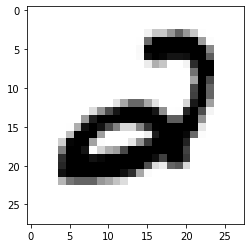

LABEL: 2
INPUT:


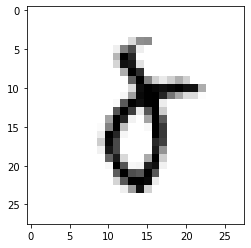

LABEL: 8
INPUT:


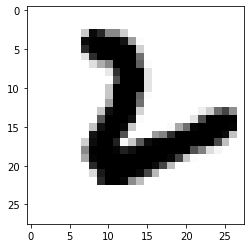

LABEL: 2
INPUT:


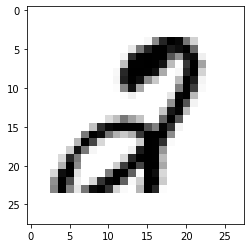

LABEL: 2
INPUT:


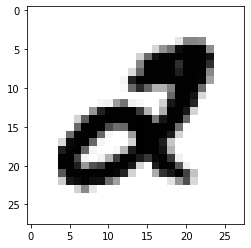

LABEL: 2
INPUT:


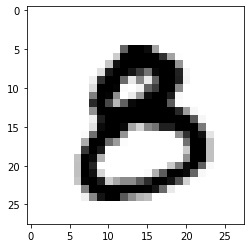

LABEL: 8
INPUT:


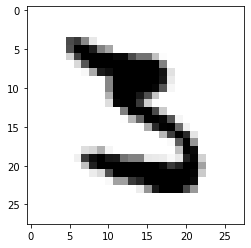

LABEL: 3
INPUT:


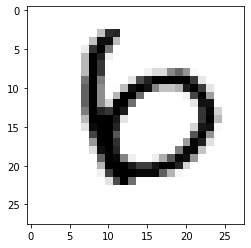

LABEL: 6
INPUT:


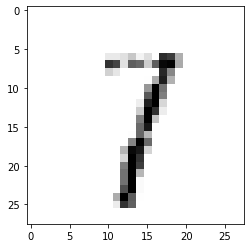

LABEL: 7
INPUT:


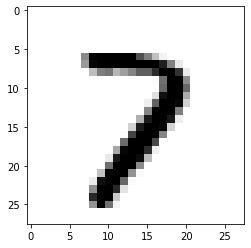

LABEL: 7
INPUT:


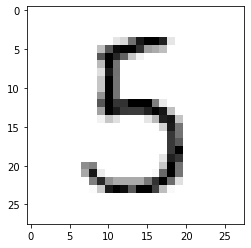

LABEL: 5
INPUT:


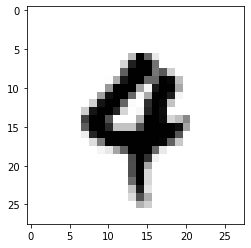

LABEL: 4
INPUT:


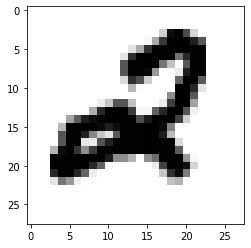

LABEL: 2
INPUT:


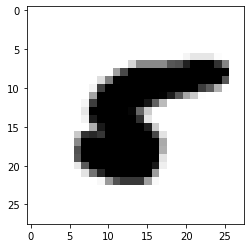

LABEL: 5
INPUT:


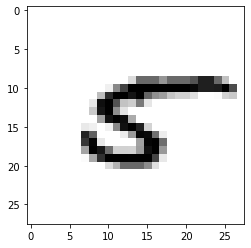

LABEL: 5
INPUT:


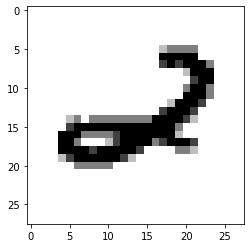

LABEL: 2
INPUT:


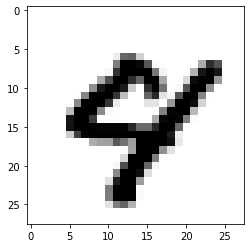

LABEL: 4
INPUT:


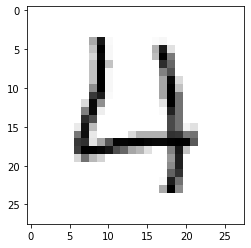

LABEL: 4
INPUT:


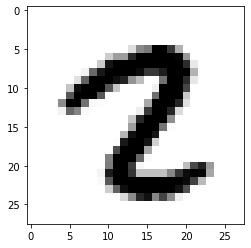

LABEL: 2
INPUT:


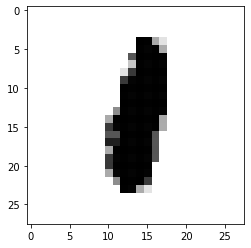

LABEL: 1
INPUT:


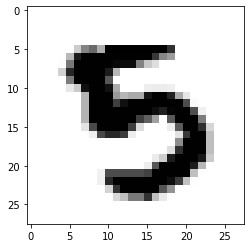

LABEL: 5
INPUT:


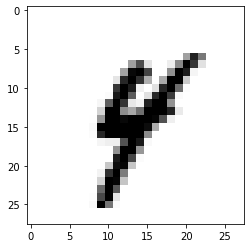

LABEL: 4
INPUT:


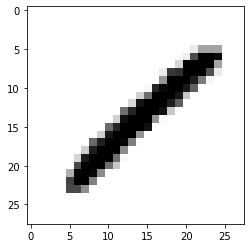

LABEL: 1
INPUT:


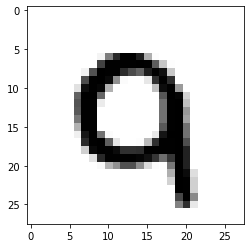

LABEL: 9
INPUT:


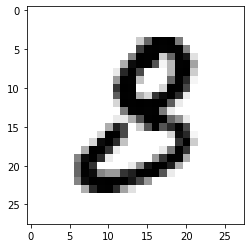

LABEL: 8
INPUT:


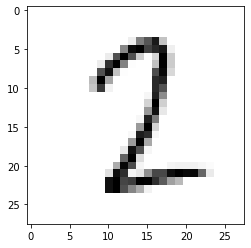

LABEL: 2
INPUT:


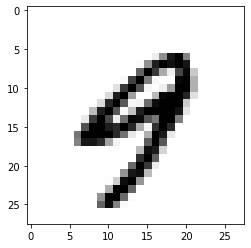

LABEL: 9
INPUT:


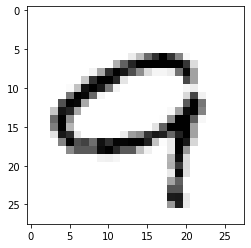

LABEL: 9
INPUT:


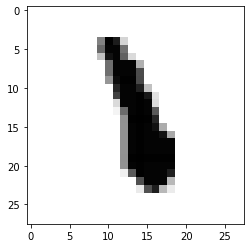

LABEL: 1
INPUT:


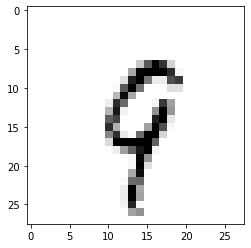

LABEL: 9
INPUT:


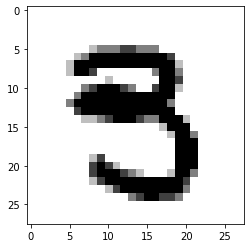

LABEL: 3
INPUT:


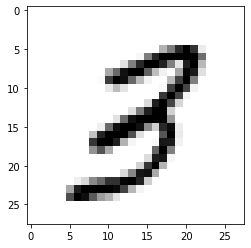

LABEL: 3
INPUT:


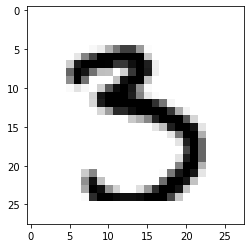

LABEL: 3
INPUT:


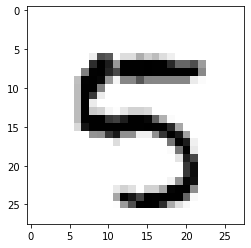

LABEL: 5
INPUT:


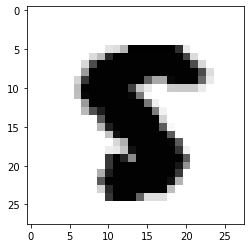

LABEL: 5
INPUT:


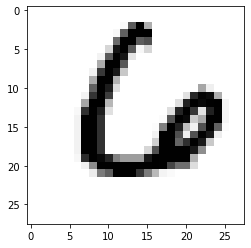

LABEL: 6
INPUT:


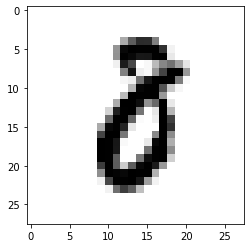

LABEL: 8
INPUT:


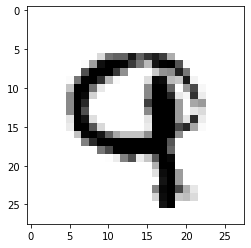

LABEL: 9
INPUT:


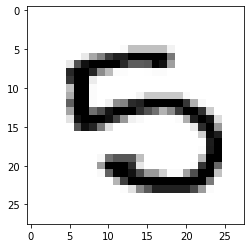

LABEL: 5
INPUT:


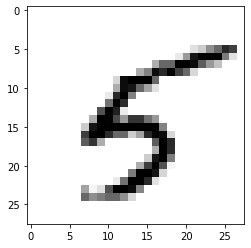

LABEL: 5
INPUT:


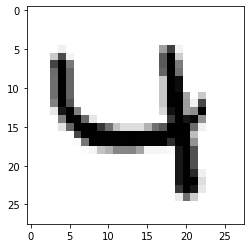

LABEL: 4
INPUT:


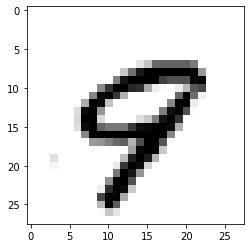

LABEL: 9
INPUT:


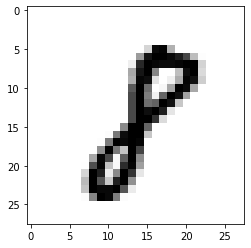

LABEL: 8
INPUT:


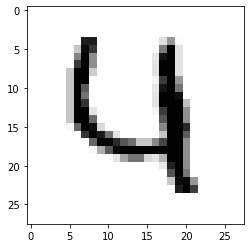

LABEL: 4
INPUT:


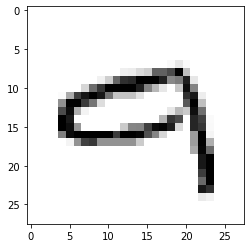

LABEL: 9
INPUT:


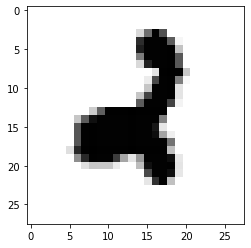

LABEL: 2
INPUT:


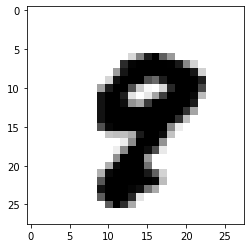

LABEL: 9
INPUT:


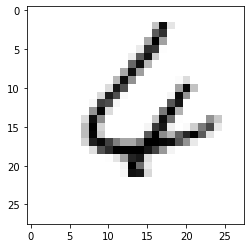

LABEL: 4
INPUT:


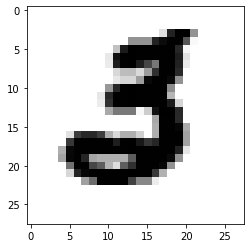

LABEL: 3
INPUT:


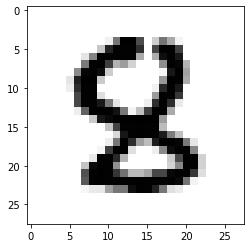

LABEL: 8
INPUT:


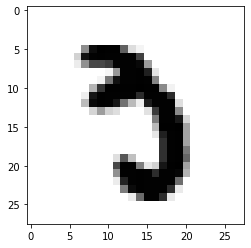

LABEL: 3
INPUT:


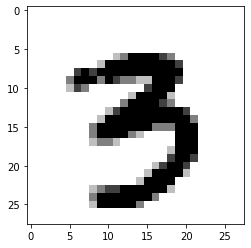

LABEL: 3
INPUT:


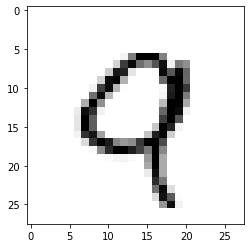

LABEL: 9
INPUT:


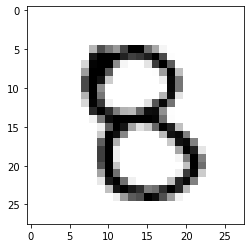

LABEL: 8
INPUT:


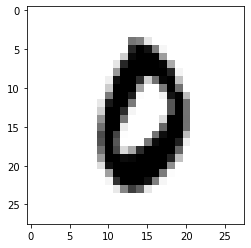

LABEL: 0
INPUT:


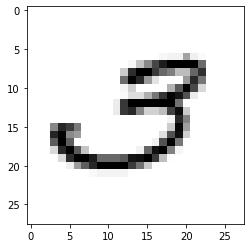

LABEL: 3
INPUT:


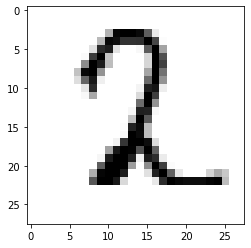

LABEL: 2
INPUT:


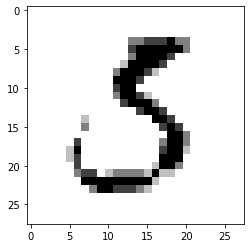

LABEL: 5
INPUT:


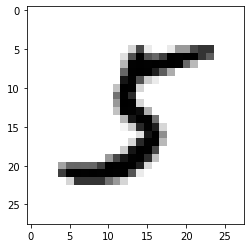

LABEL: 5
INPUT:


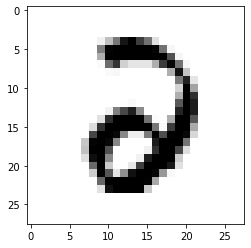

LABEL: 2
INPUT:


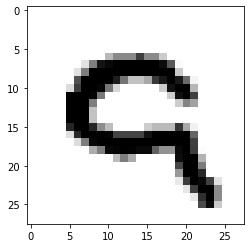

LABEL: 9
INPUT:


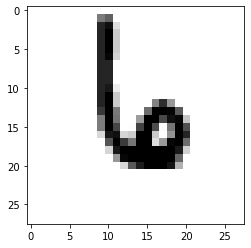

LABEL: 6
INPUT:


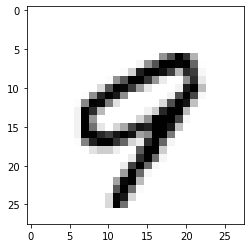

LABEL: 9
INPUT:


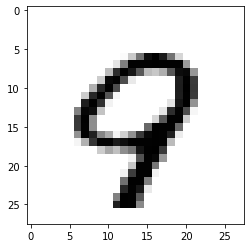

LABEL: 9
INPUT:


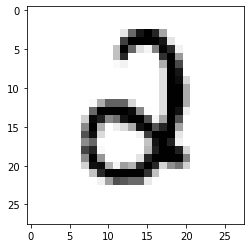

LABEL: 2
INPUT:


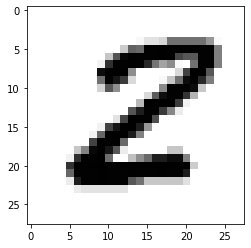

LABEL: 2
INPUT:


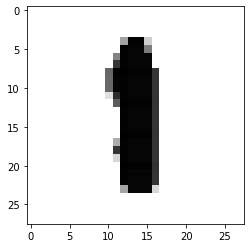

LABEL: 1
INPUT:


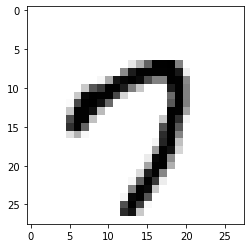

LABEL: 7
INPUT:


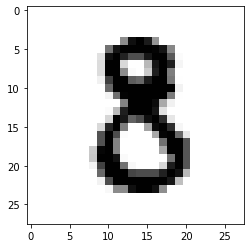

LABEL: 8
INPUT:


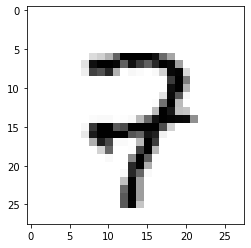

LABEL: 7
INPUT:


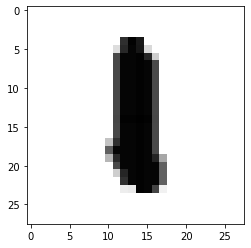

LABEL: 1
INPUT:


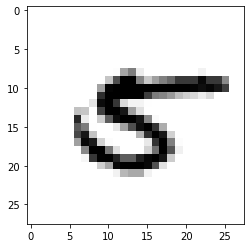

LABEL: 5
INPUT:


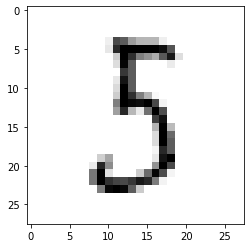

LABEL: 5
INPUT:


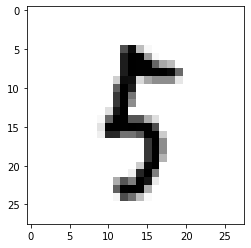

LABEL: 5
INPUT:


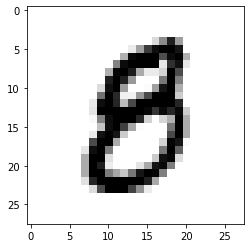

LABEL: 8
INPUT:


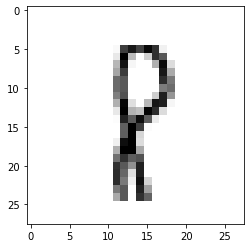

LABEL: 8
INPUT:


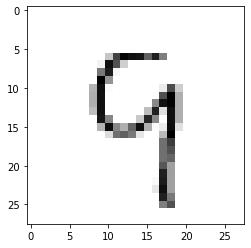

LABEL: 9
INPUT:


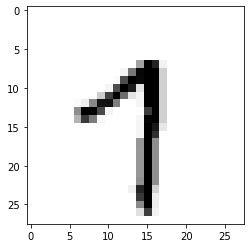

LABEL: 7
INPUT:


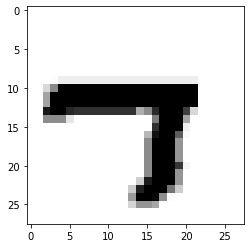

LABEL: 7
INPUT:


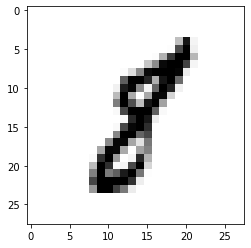

LABEL: 8
INPUT:


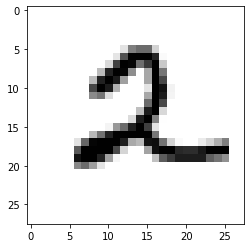

LABEL: 2
INPUT:


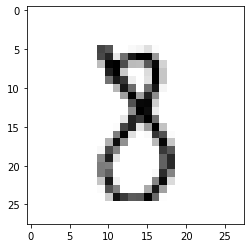

LABEL: 8
INPUT:


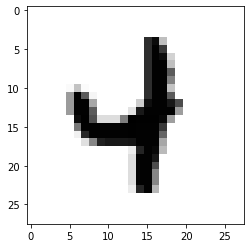

LABEL: 4
INPUT:


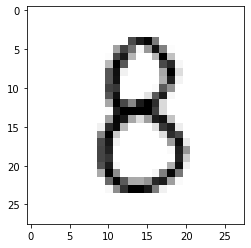

LABEL: 8
INPUT:


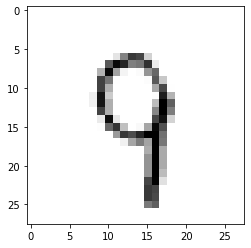

LABEL: 9
INPUT:


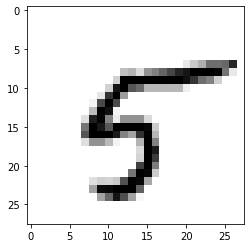

LABEL: 5
INPUT:


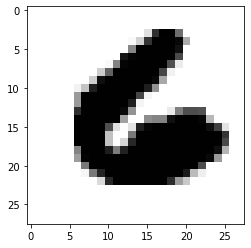

LABEL: 6
INPUT:


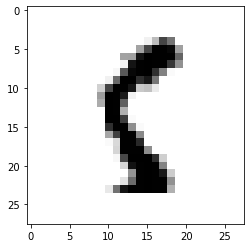

LABEL: 5
INPUT:


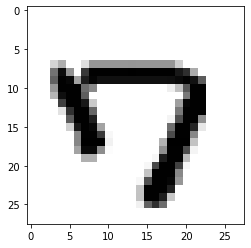

LABEL: 7
INPUT:


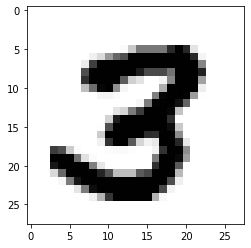

LABEL: 3
INPUT:


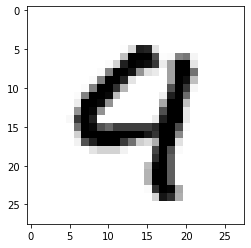

LABEL: 9
INPUT:


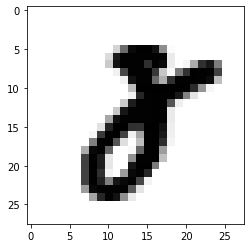

LABEL: 8
INPUT:


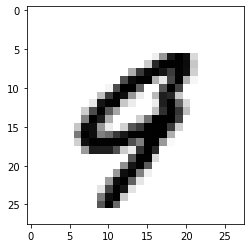

LABEL: 9
INPUT:


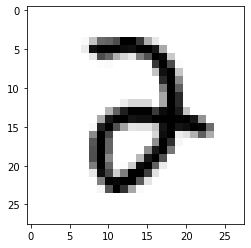

LABEL: 2
INPUT:


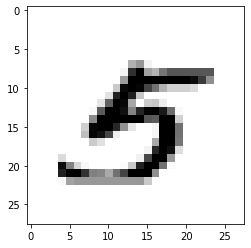

LABEL: 5
INPUT:


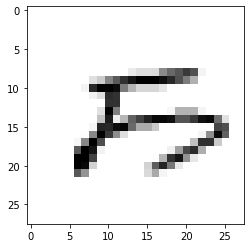

LABEL: 5
INPUT:


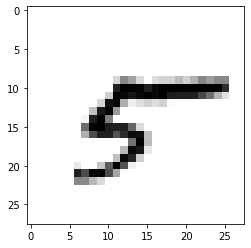

LABEL: 5
INPUT:


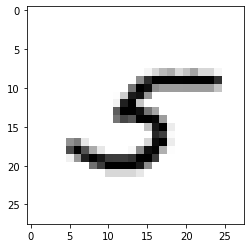

LABEL: 5
INPUT:


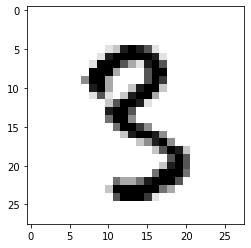

LABEL: 3
INPUT:


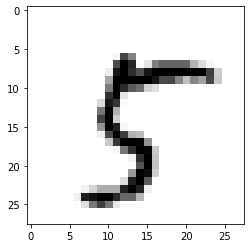

LABEL: 5
INPUT:


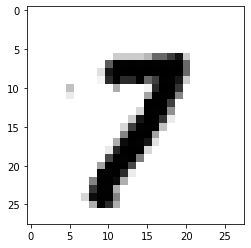

LABEL: 7
INPUT:


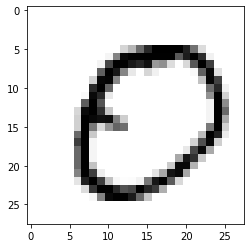

LABEL: 0
INPUT:


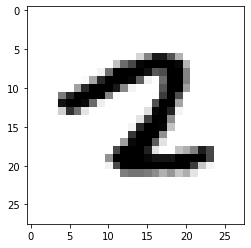

LABEL: 2
INPUT:


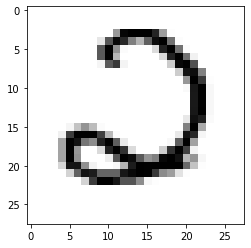

LABEL: 2
INPUT:


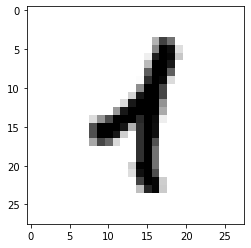

LABEL: 1
INPUT:


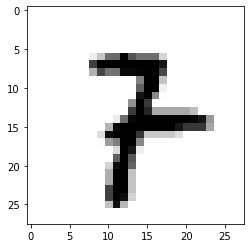

LABEL: 7
INPUT:


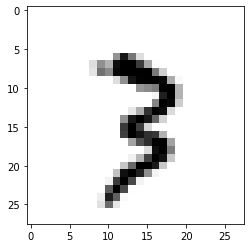

LABEL: 3
INPUT:


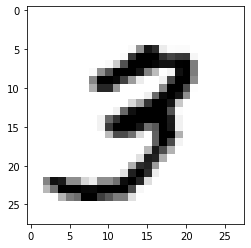

LABEL: 3
INPUT:


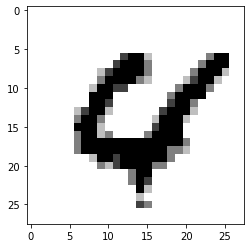

LABEL: 4
INPUT:


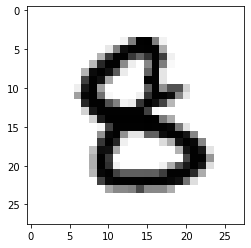

LABEL: 8
INPUT:


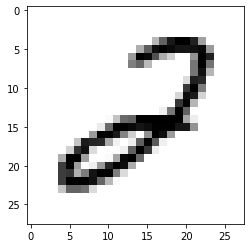

LABEL: 2
INPUT:


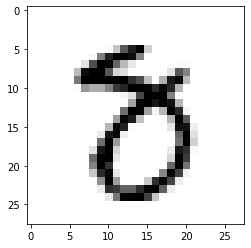

LABEL: 8
INPUT:


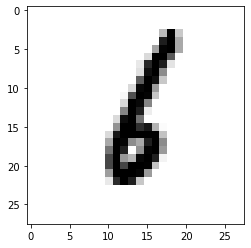

LABEL: 6
INPUT:


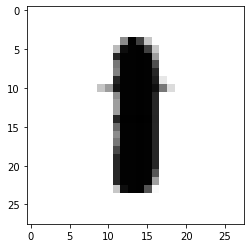

LABEL: 1
INPUT:


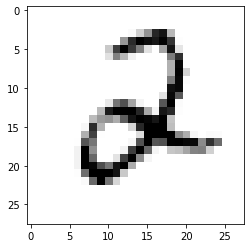

LABEL: 2
INPUT:


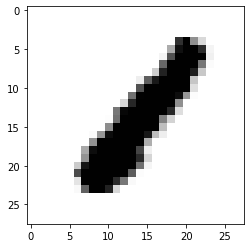

LABEL: 1
INPUT:


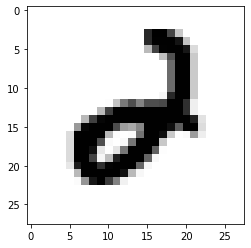

LABEL: 2
INPUT:


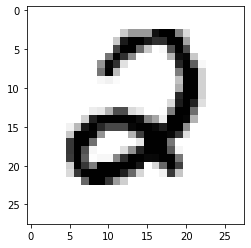

LABEL: 2
INPUT:


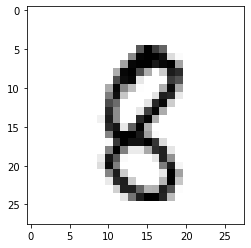

LABEL: 8
INPUT:


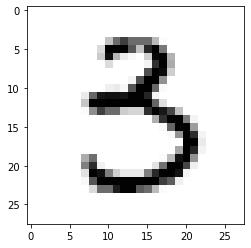

LABEL: 3
INPUT:


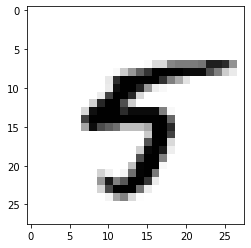

LABEL: 5
INPUT:


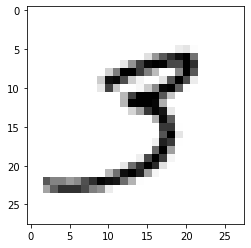

LABEL: 3
INPUT:


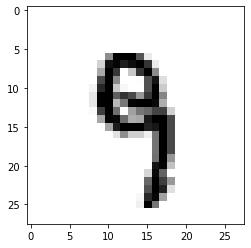

LABEL: 9
INPUT:


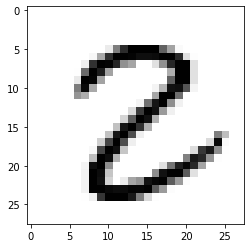

LABEL: 2
INPUT:


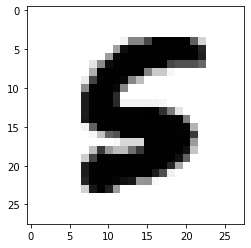

LABEL: 5
INPUT:


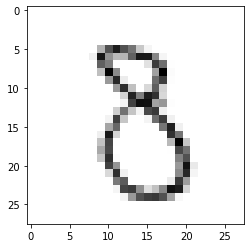

LABEL: 8
INPUT:


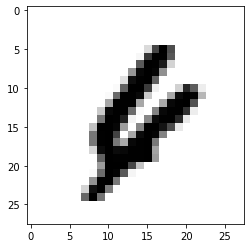

LABEL: 4
INPUT:


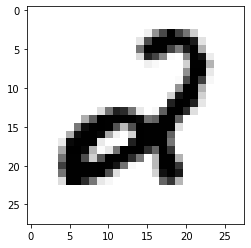

LABEL: 2
INPUT:


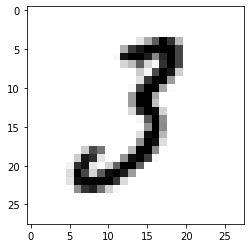

LABEL: 3
INPUT:


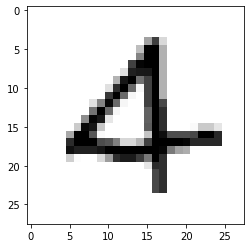

LABEL: 4
INPUT:


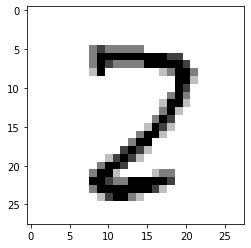

LABEL: 2
INPUT:


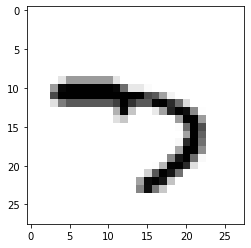

LABEL: 7
INPUT:


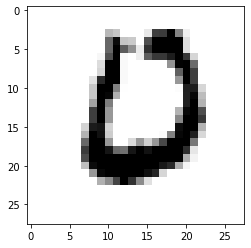

LABEL: 0
INPUT:


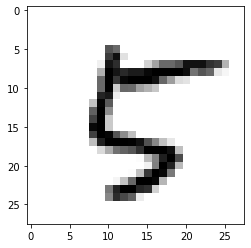

LABEL: 5
INPUT:


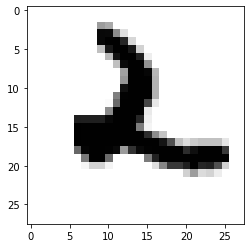

LABEL: 2
INPUT:


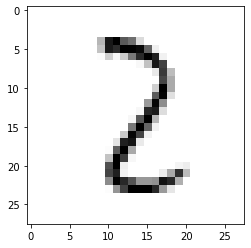

LABEL: 2
INPUT:


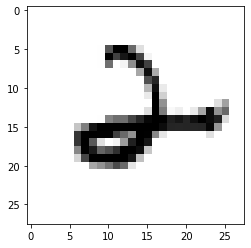

LABEL: 2
INPUT:


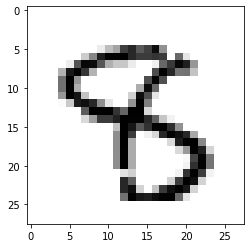

LABEL: 8
INPUT:


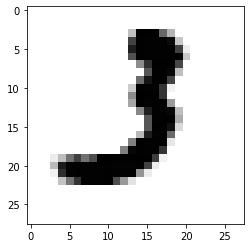

LABEL: 3
INPUT:


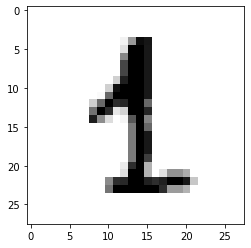

LABEL: 1
INPUT:


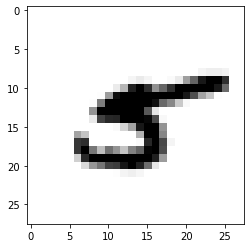

LABEL: 5
INPUT:


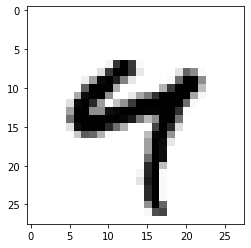

LABEL: 4
INPUT:


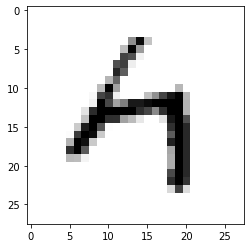

LABEL: 4
INPUT:


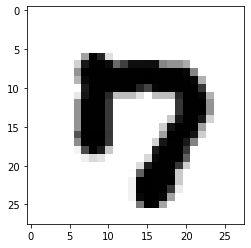

LABEL: 7
INPUT:


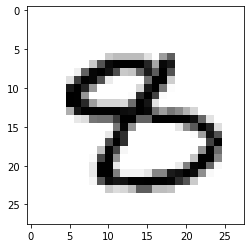

LABEL: 8
INPUT:


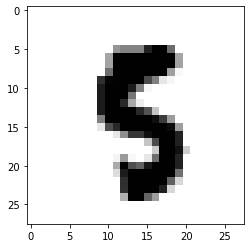

LABEL: 5
INPUT:


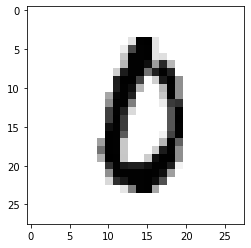

LABEL: 0
INPUT:


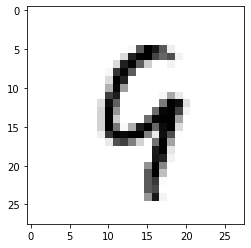

LABEL: 9
INPUT:


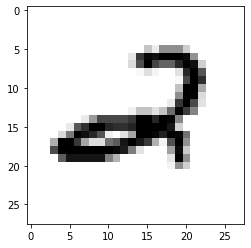

LABEL: 2
INPUT:


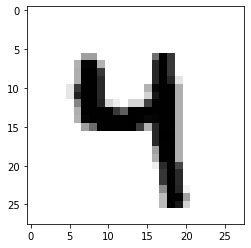

LABEL: 4
INPUT:


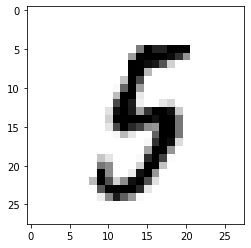

LABEL: 5
INPUT:


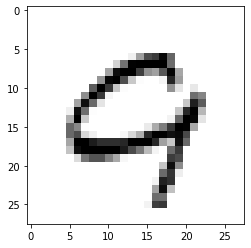

LABEL: 9
INPUT:


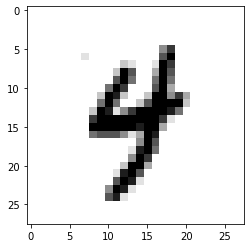

LABEL: 4
INPUT:


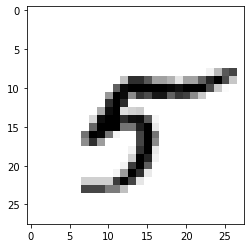

LABEL: 5
INPUT:


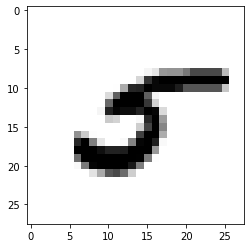

LABEL: 5
INPUT:


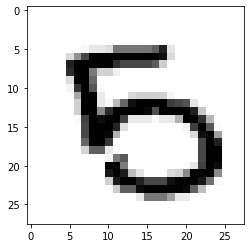

LABEL: 5
INPUT:


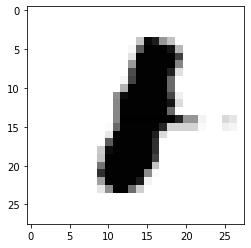

LABEL: 1
INPUT:


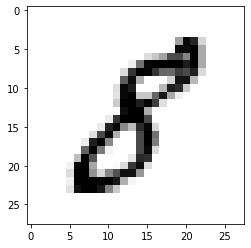

LABEL: 8
INPUT:


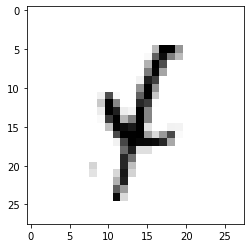

LABEL: 4
INPUT:


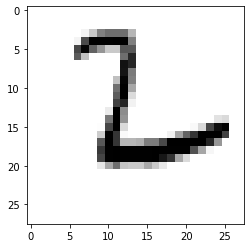

LABEL: 2
INPUT:


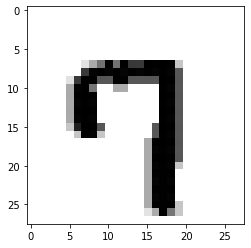

LABEL: 7
INPUT:


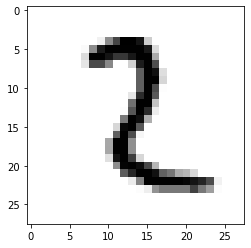

LABEL: 2
INPUT:


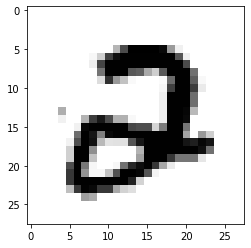

LABEL: 2
INPUT:


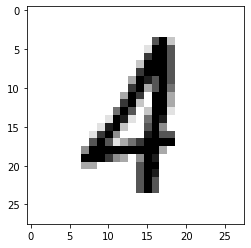

LABEL: 4
INPUT:


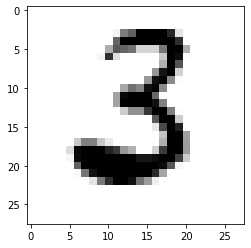

LABEL: 3
INPUT:


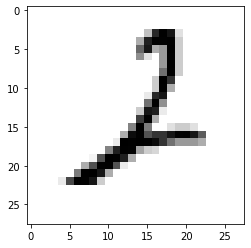

LABEL: 2
INPUT:


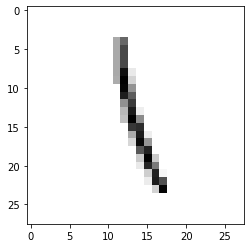

LABEL: 1
INPUT:


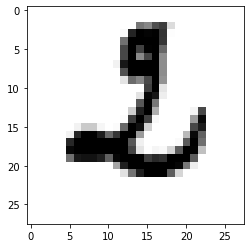

LABEL: 2
INPUT:


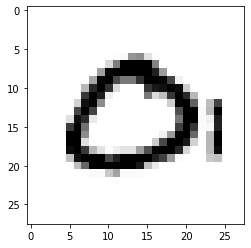

LABEL: 0
INPUT:


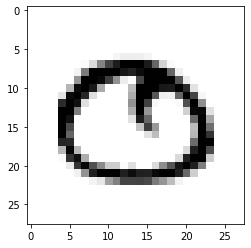

LABEL: 0
INPUT:


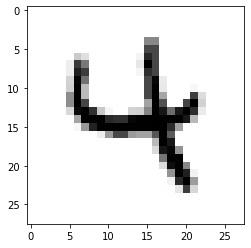

LABEL: 4
INPUT:


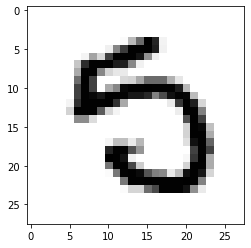

LABEL: 5
INPUT:


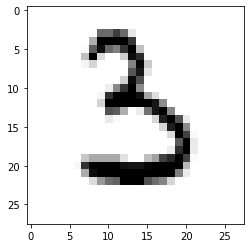

LABEL: 3
INPUT:


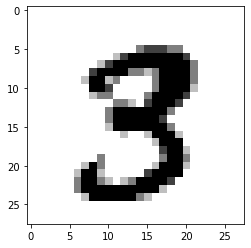

LABEL: 3
INPUT:


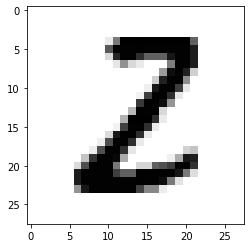

LABEL: 2
INPUT:


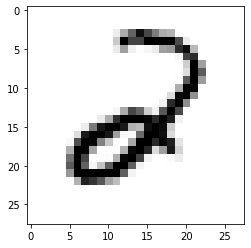

LABEL: 2
INPUT:


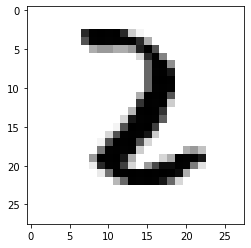

LABEL: 2
INPUT:


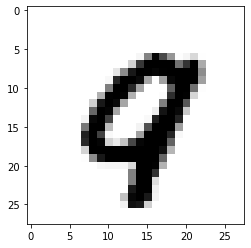

LABEL: 9
INPUT:


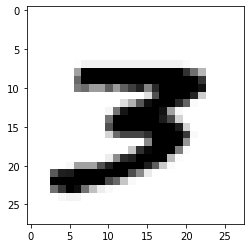

LABEL: 3
INPUT:


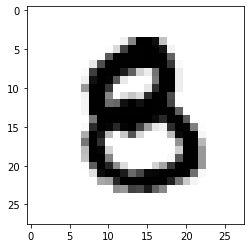

LABEL: 8
INPUT:


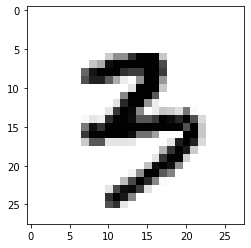

LABEL: 3
INPUT:


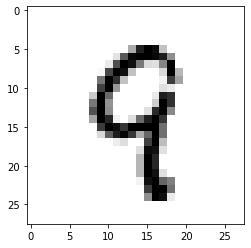

LABEL: 9
INPUT:


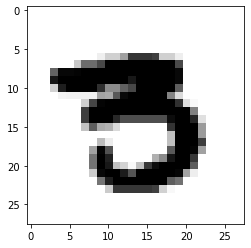

LABEL: 3
INPUT:


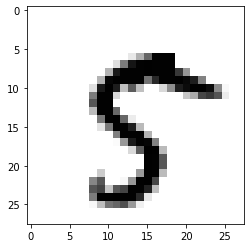

LABEL: 5
INPUT:


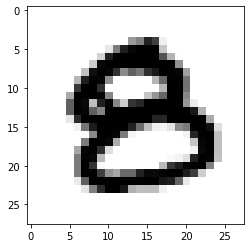

LABEL: 8
INPUT:


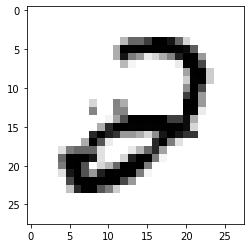

LABEL: 2
INPUT:


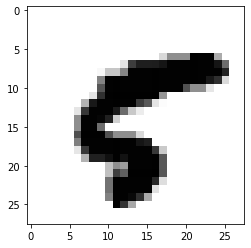

LABEL: 5
INPUT:


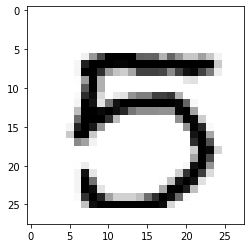

LABEL: 5
INPUT:


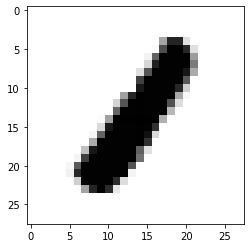

LABEL: 1
INPUT:


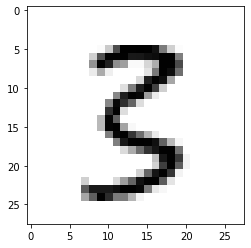

LABEL: 3
INPUT:


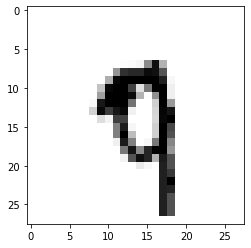

LABEL: 9
INPUT:


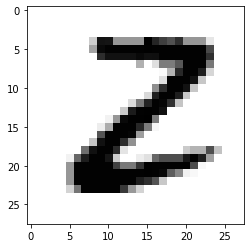

LABEL: 2
INPUT:


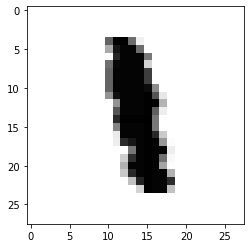

LABEL: 1
INPUT:


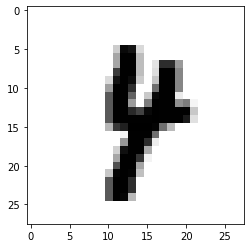

LABEL: 4
INPUT:


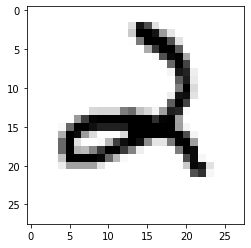

LABEL: 2
INPUT:


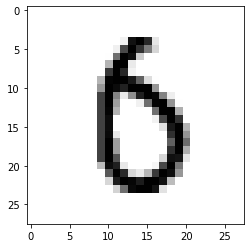

LABEL: 0
INPUT:


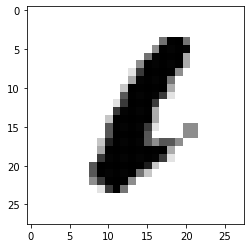

LABEL: 1
INPUT:


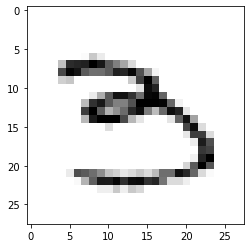

LABEL: 3
INPUT:


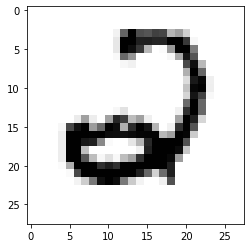

LABEL: 2
INPUT:


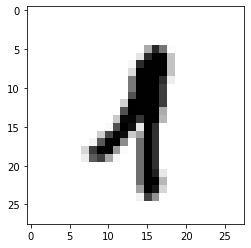

LABEL: 1
INPUT:


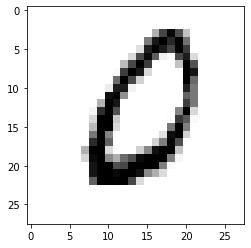

LABEL: 0
INPUT:


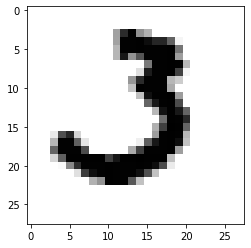

LABEL: 3
INPUT:


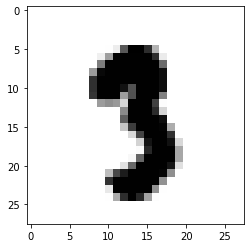

LABEL: 3
INPUT:


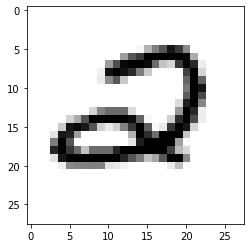

LABEL: 2
INPUT:


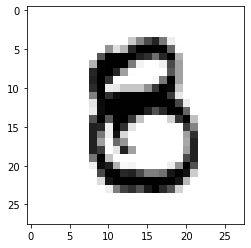

LABEL: 8
INPUT:


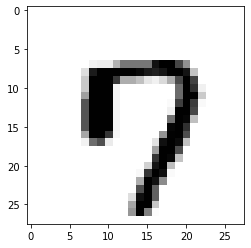

LABEL: 7
INPUT:


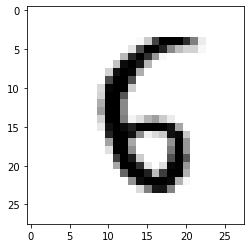

LABEL: 6
INPUT:


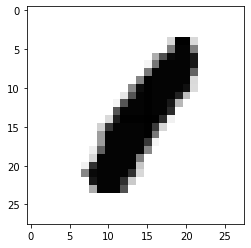

LABEL: 1
INPUT:


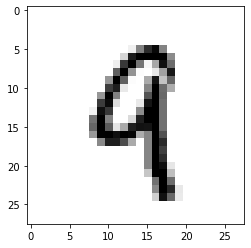

LABEL: 9
INPUT:


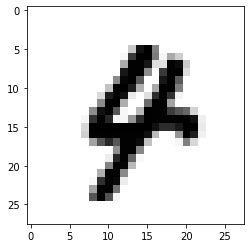

LABEL: 4
INPUT:


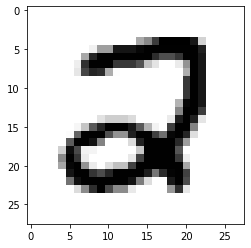

LABEL: 2
INPUT:


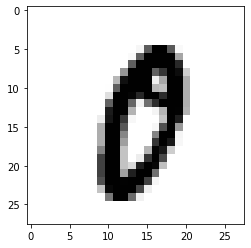

LABEL: 0
INPUT:


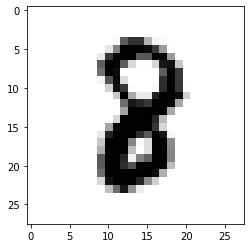

LABEL: 8
INPUT:


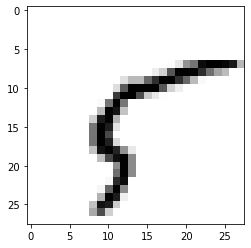

LABEL: 5
INPUT:


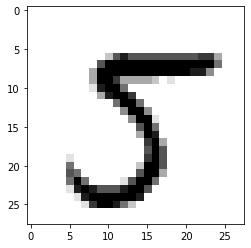

LABEL: 5
INPUT:


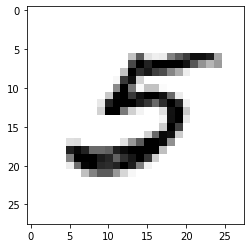

LABEL: 5
INPUT:


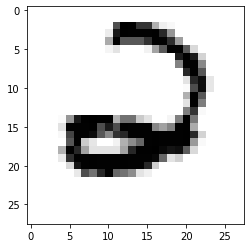

LABEL: 2
INPUT:


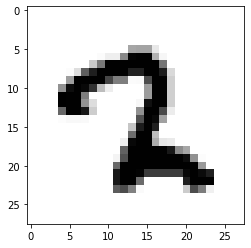

LABEL: 2
INPUT:


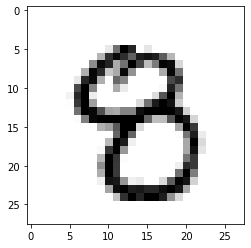

LABEL: 8
INPUT:


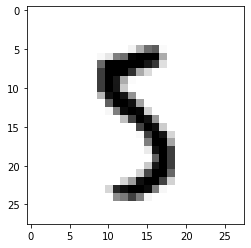

LABEL: 5
INPUT:


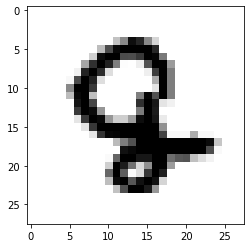

LABEL: 8
INPUT:


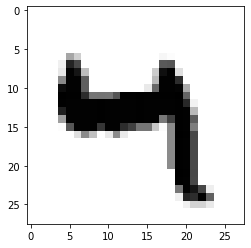

LABEL: 4
INPUT:


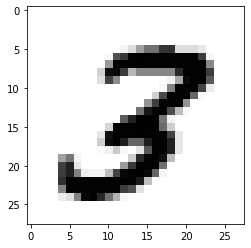

LABEL: 3
INPUT:


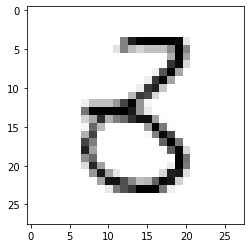

LABEL: 3
INPUT:


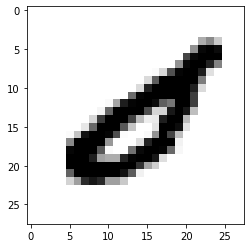

LABEL: 0
INPUT:


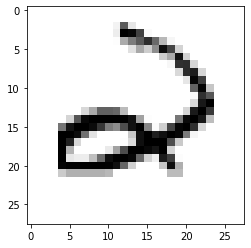

LABEL: 2
INPUT:


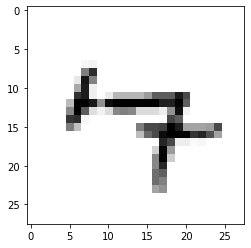

LABEL: 7
INPUT:


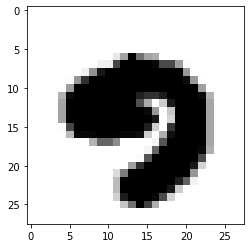

LABEL: 9
INPUT:


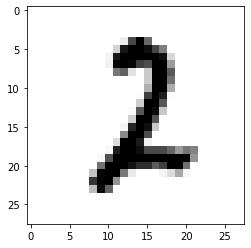

LABEL: 2
INPUT:


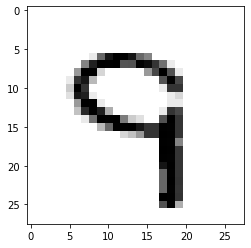

LABEL: 9
INPUT:


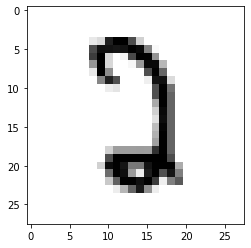

LABEL: 2
INPUT:


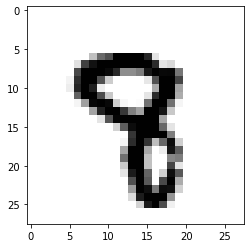

LABEL: 8
INPUT:


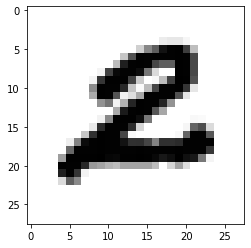

LABEL: 2
INPUT:


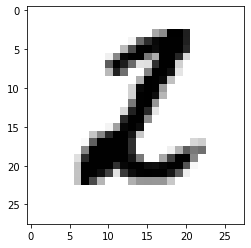

LABEL: 2
INPUT:


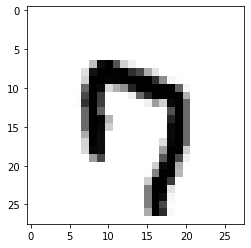

LABEL: 7
INPUT:


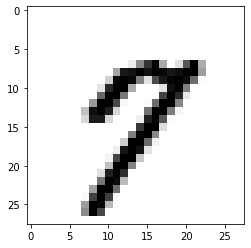

LABEL: 7
INPUT:


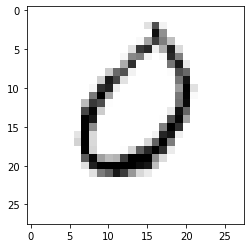

LABEL: 0
INPUT:


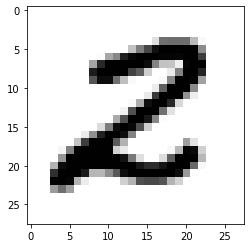

LABEL: 2
INPUT:


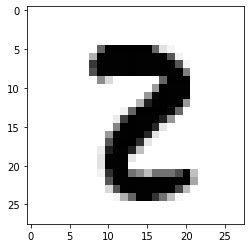

LABEL: 2
INPUT:


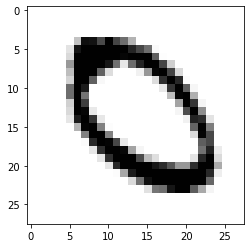

LABEL: 0
INPUT:


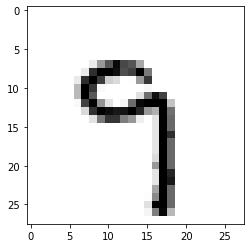

LABEL: 9
INPUT:


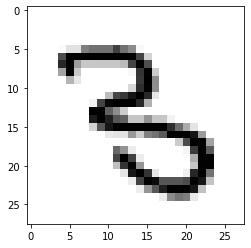

LABEL: 3
INPUT:


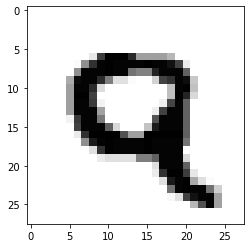

LABEL: 9
INPUT:


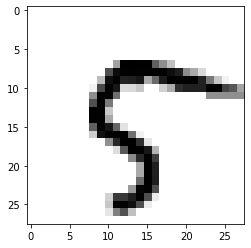

LABEL: 5
INPUT:


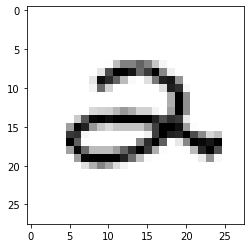

LABEL: 2
INPUT:


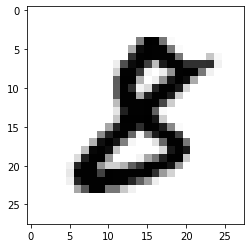

LABEL: 8
INPUT:


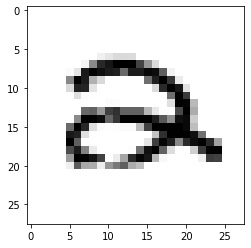

LABEL: 2
INPUT:


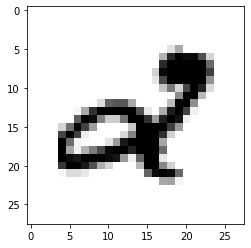

LABEL: 2
INPUT:


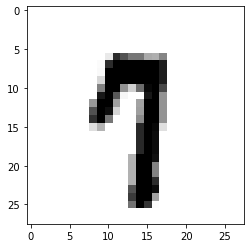

LABEL: 7
INPUT:


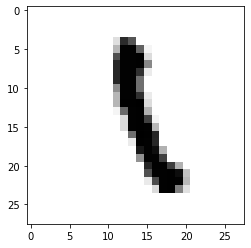

LABEL: 1
INPUT:


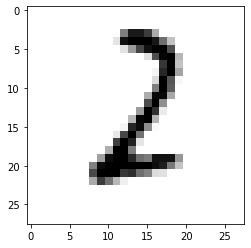

LABEL: 2
INPUT:


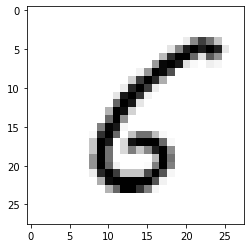

LABEL: 6
INPUT:


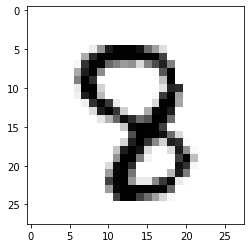

LABEL: 8
INPUT:


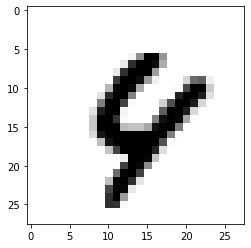

LABEL: 4
INPUT:


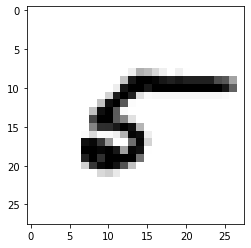

LABEL: 5
INPUT:


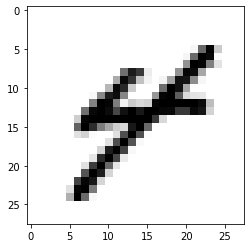

LABEL: 4
INPUT:


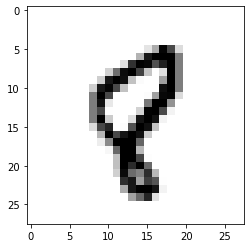

LABEL: 8
INPUT:


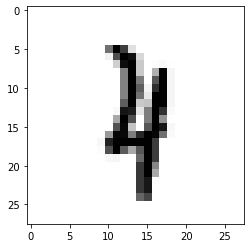

LABEL: 4
INPUT:


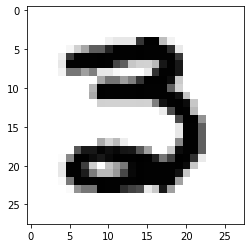

LABEL: 3
INPUT:


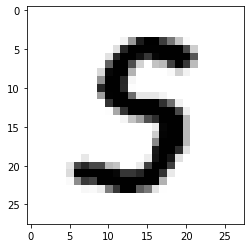

LABEL: 5
INPUT:


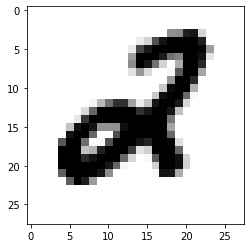

LABEL: 2
INPUT:


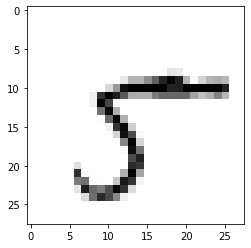

LABEL: 5
INPUT:


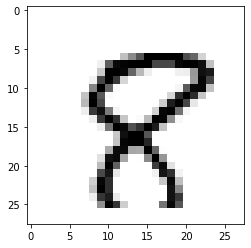

LABEL: 8
INPUT:


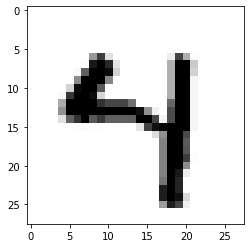

LABEL: 4
INPUT:


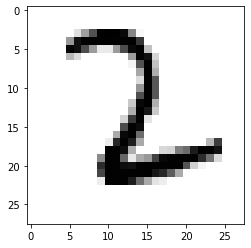

LABEL: 2
INPUT:


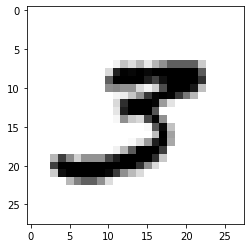

LABEL: 3
INPUT:


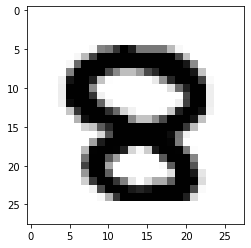

LABEL: 8
INPUT:


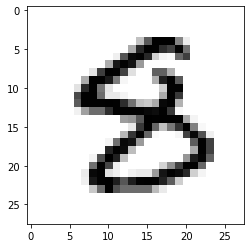

LABEL: 8
INPUT:


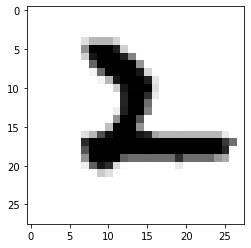

LABEL: 2
INPUT:


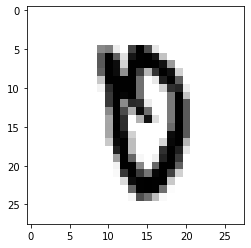

LABEL: 0
INPUT:


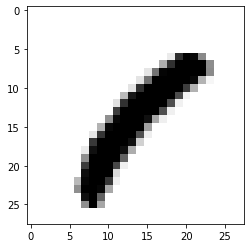

LABEL: 1
INPUT:


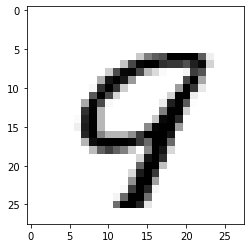

LABEL: 9
INPUT:


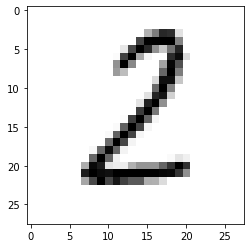

LABEL: 2
INPUT:


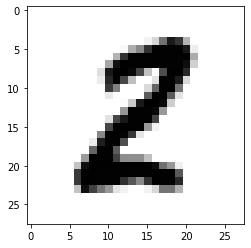

LABEL: 2
INPUT:


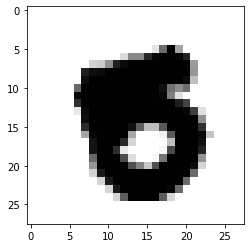

LABEL: 5
INPUT:


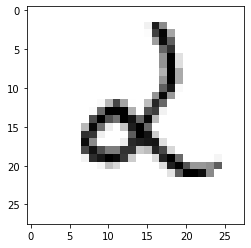

LABEL: 2
INPUT:


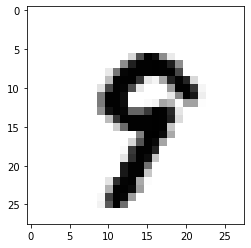

LABEL: 9
INPUT:


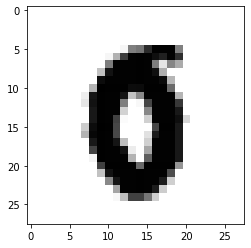

LABEL: 0
INPUT:


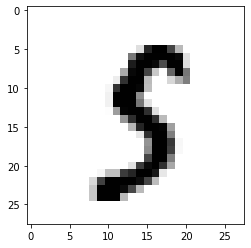

LABEL: 5
INPUT:


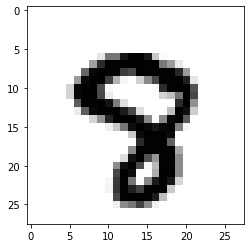

LABEL: 8
INPUT:


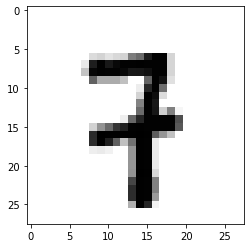

LABEL: 7
INPUT:


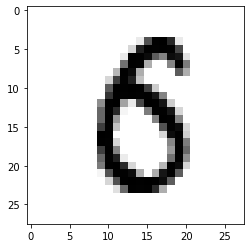

LABEL: 6
INPUT:


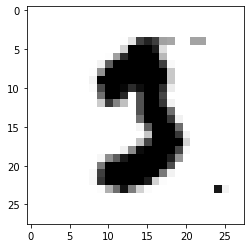

LABEL: 3
INPUT:


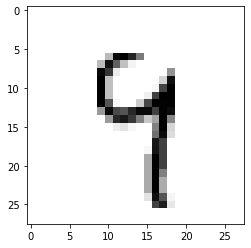

LABEL: 9
INPUT:


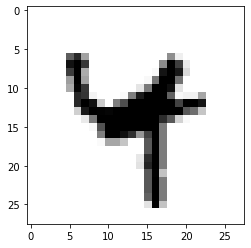

LABEL: 4
INPUT:


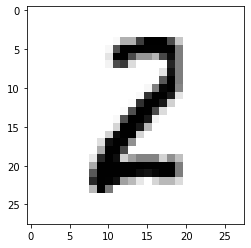

LABEL: 2
INPUT:


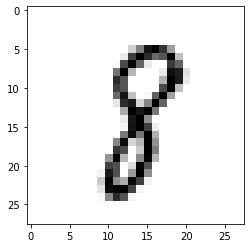

LABEL: 8
INPUT:


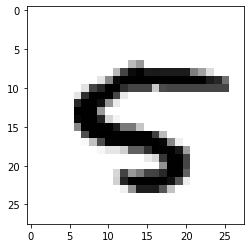

LABEL: 5
INPUT:


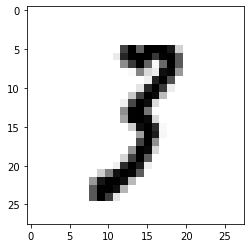

LABEL: 3
INPUT:


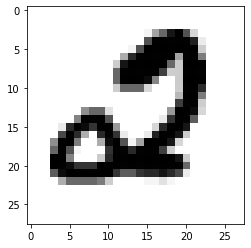

LABEL: 2
INPUT:


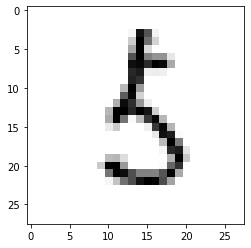

LABEL: 5
INPUT:


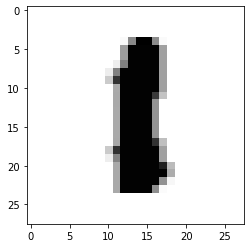

LABEL: 1
INPUT:


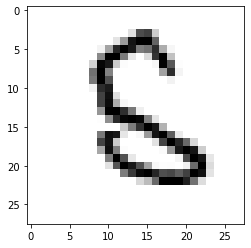

LABEL: 5
INPUT:


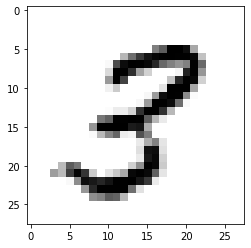

LABEL: 3
INPUT:


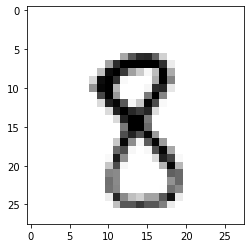

LABEL: 8
INPUT:


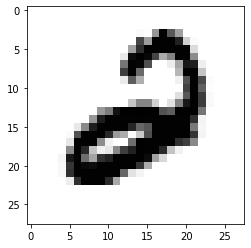

LABEL: 2
INPUT:


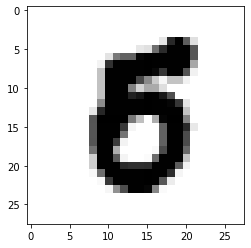

LABEL: 5
INPUT:


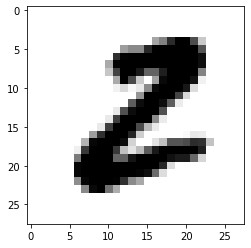

LABEL: 2
INPUT:


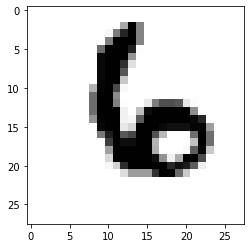

LABEL: 6
INPUT:


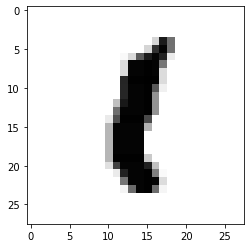

LABEL: 1
INPUT:


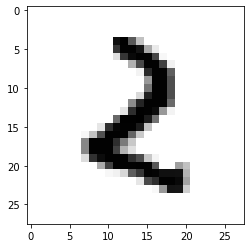

LABEL: 2
INPUT:


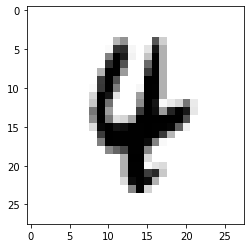

LABEL: 4
INPUT:


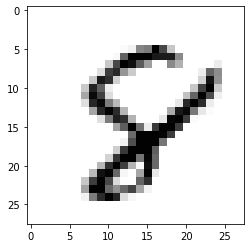

LABEL: 8
INPUT:


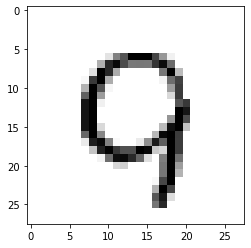

LABEL: 9
INPUT:


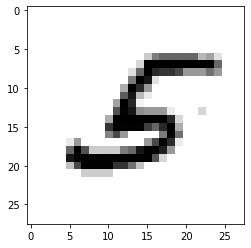

LABEL: 5
INPUT:


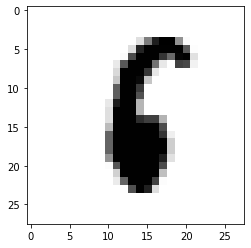

LABEL: 6
INPUT:


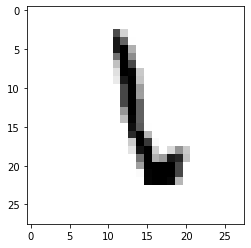

LABEL: 1
INPUT:


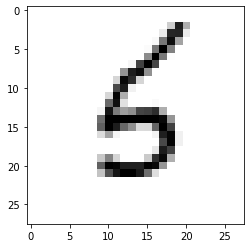

LABEL: 5
INPUT:


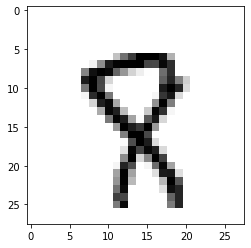

LABEL: 8
INPUT:


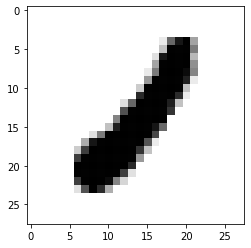

LABEL: 1
INPUT:


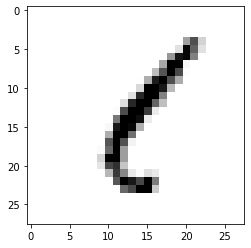

LABEL: 1
INPUT:


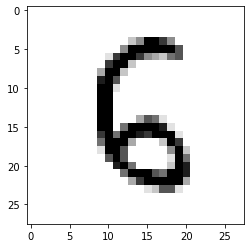

LABEL: 6
INPUT:


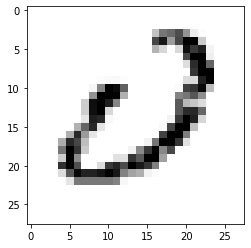

LABEL: 0
INPUT:


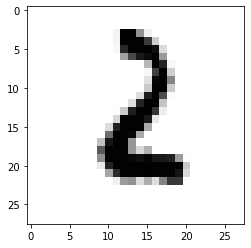

LABEL: 2
INPUT:


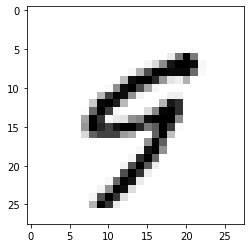

LABEL: 9
INPUT:


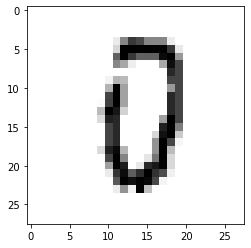

LABEL: 0
INPUT:


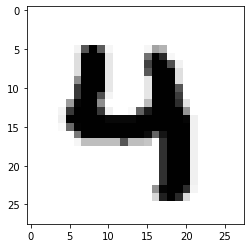

LABEL: 4
INPUT:


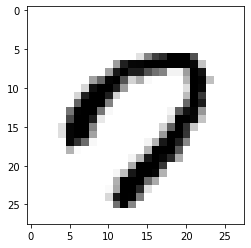

LABEL: 7
INPUT:


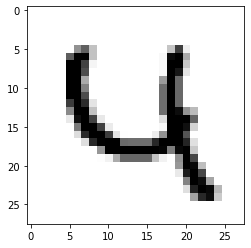

LABEL: 4
INPUT:


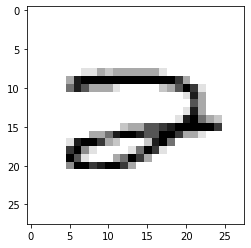

LABEL: 2
INPUT:


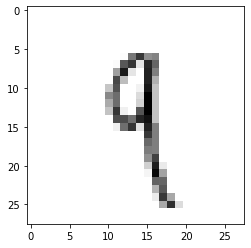

LABEL: 9
INPUT:


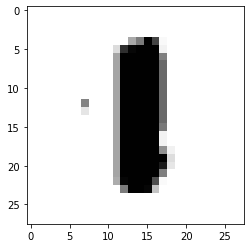

LABEL: 1
INPUT:


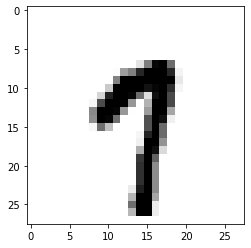

LABEL: 7
INPUT:


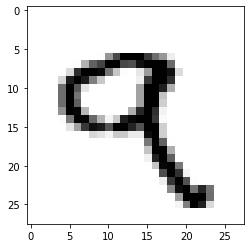

LABEL: 9
INPUT:


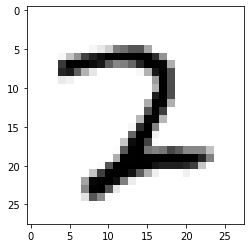

LABEL: 2
INPUT:


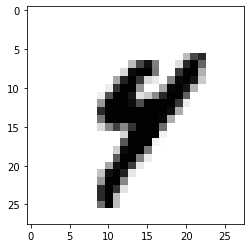

LABEL: 4
INPUT:


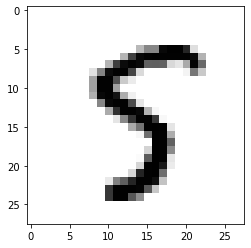

LABEL: 5
INPUT:


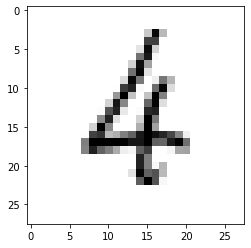

LABEL: 4
INPUT:


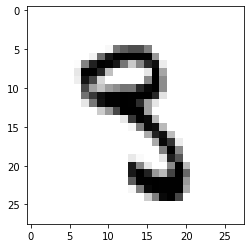

LABEL: 3
INPUT:


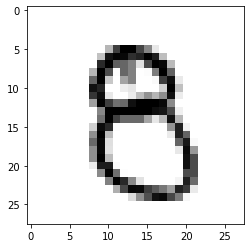

LABEL: 8
INPUT:


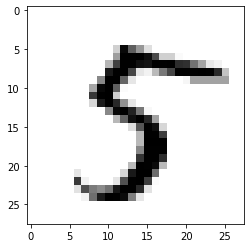

LABEL: 5
INPUT:


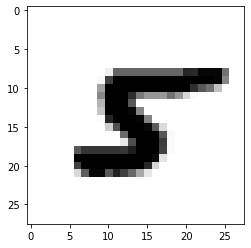

LABEL: 5
INPUT:


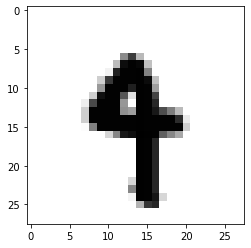

LABEL: 4
INPUT:


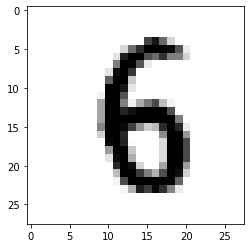

LABEL: 6
INPUT:


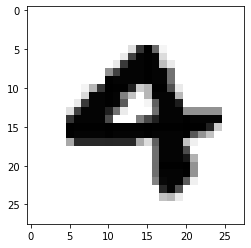

LABEL: 4
INPUT:


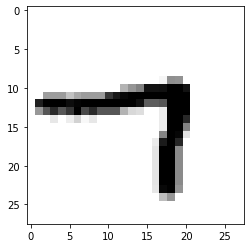

LABEL: 7
INPUT:


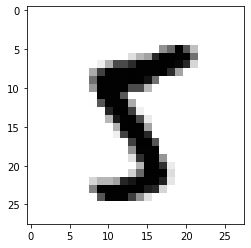

LABEL: 5
INPUT:


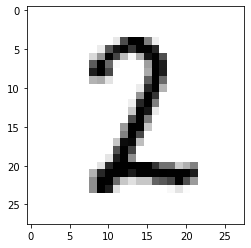

LABEL: 2
INPUT:


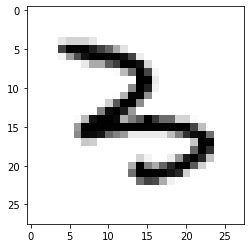

LABEL: 3
INPUT:


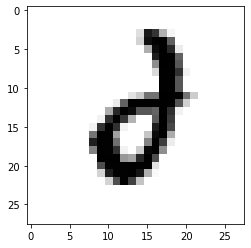

LABEL: 2
INPUT:


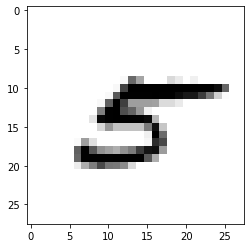

LABEL: 5
INPUT:


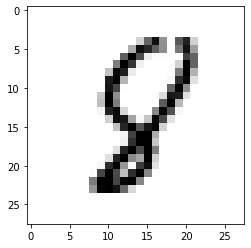

LABEL: 8
INPUT:


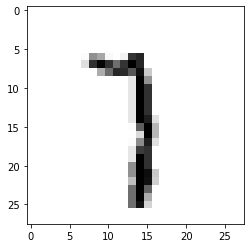

LABEL: 7
INPUT:


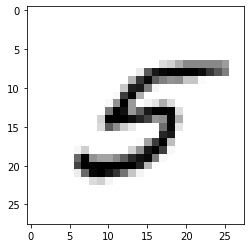

LABEL: 5
INPUT:


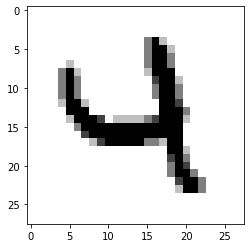

LABEL: 4
INPUT:


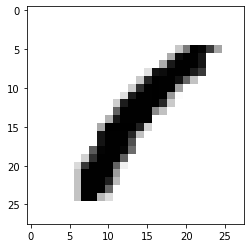

LABEL: 1
INPUT:


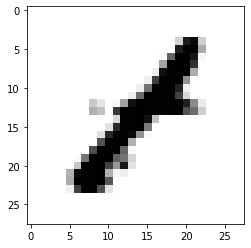

LABEL: 1
INPUT:


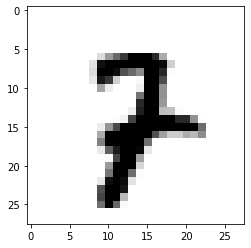

LABEL: 7
INPUT:


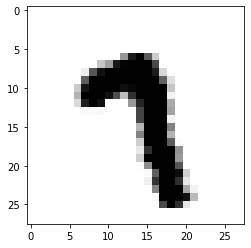

LABEL: 7
INPUT:


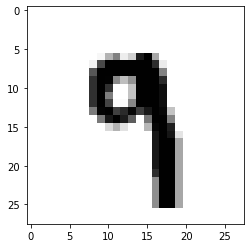

LABEL: 9
INPUT:


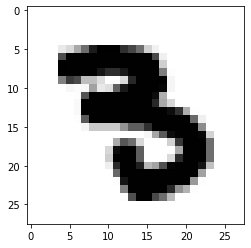

LABEL: 3
INPUT:


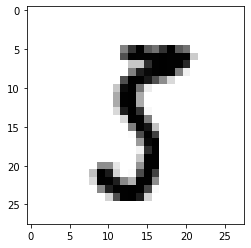

LABEL: 5
INPUT:


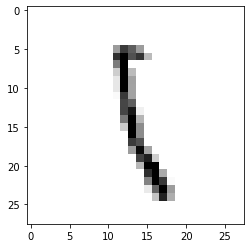

LABEL: 1
INPUT:


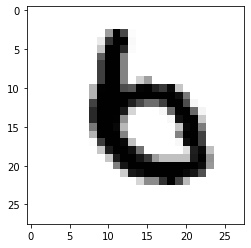

LABEL: 6
INPUT:


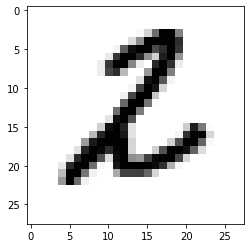

LABEL: 2
INPUT:


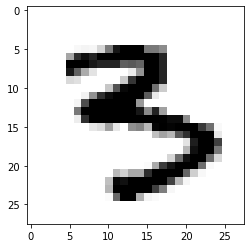

LABEL: 3
INPUT:


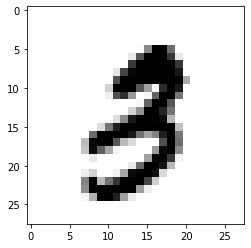

LABEL: 3
INPUT:


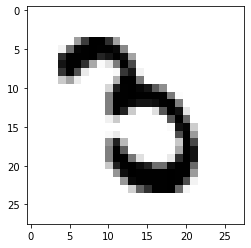

LABEL: 3
INPUT:


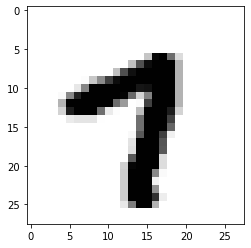

LABEL: 7
INPUT:


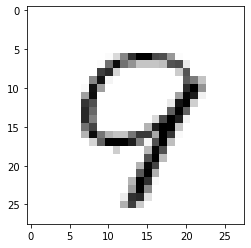

LABEL: 9
INPUT:


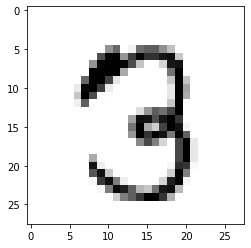

LABEL: 3
INPUT:


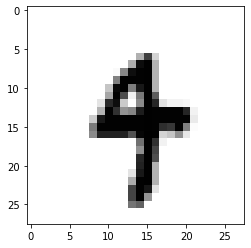

LABEL: 4
INPUT:


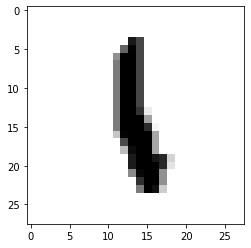

LABEL: 1
INPUT:


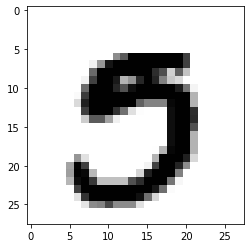

LABEL: 5
INPUT:


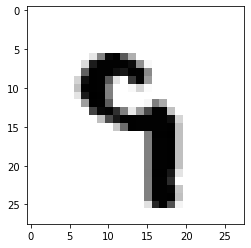

LABEL: 9
INPUT:


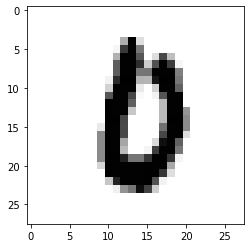

LABEL: 0
INPUT:


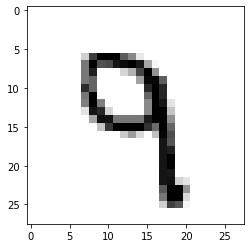

LABEL: 9
INPUT:


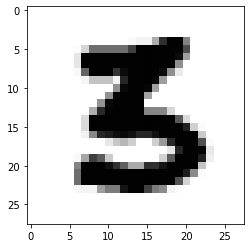

LABEL: 3
INPUT:


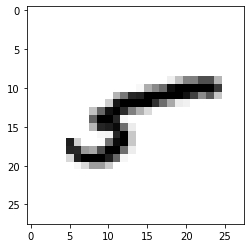

LABEL: 5
INPUT:


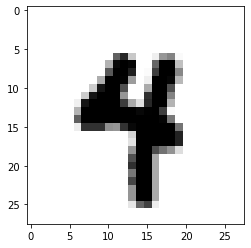

LABEL: 4
INPUT:


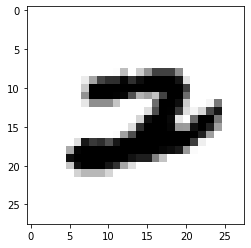

LABEL: 2
INPUT:


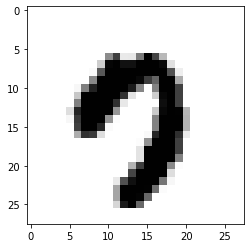

LABEL: 7
INPUT:


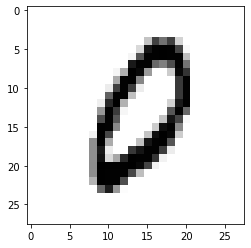

LABEL: 0
INPUT:


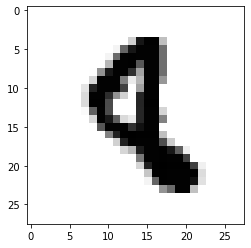

LABEL: 8
INPUT:


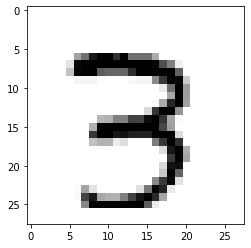

LABEL: 3
INPUT:


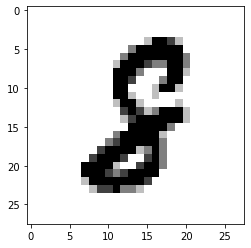

LABEL: 8
INPUT:


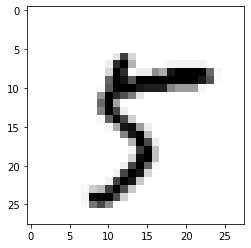

LABEL: 5
INPUT:


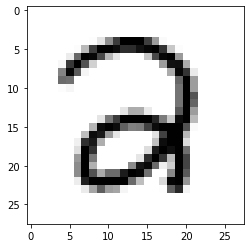

LABEL: 2
INPUT:


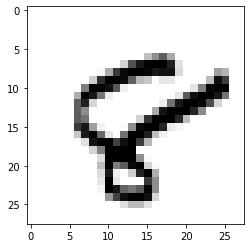

LABEL: 8
INPUT:


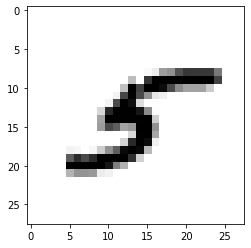

LABEL: 5
INPUT:


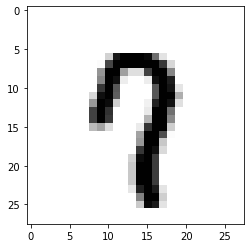

LABEL: 7
INPUT:


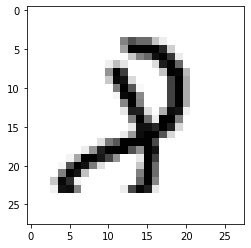

LABEL: 8
INPUT:


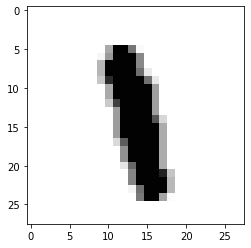

LABEL: 1
INPUT:


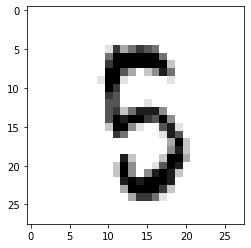

LABEL: 5
INPUT:


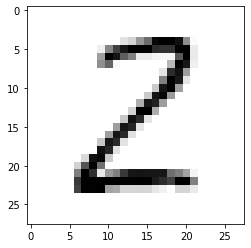

LABEL: 2
INPUT:


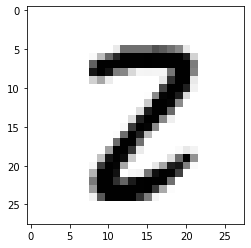

LABEL: 2
INPUT:


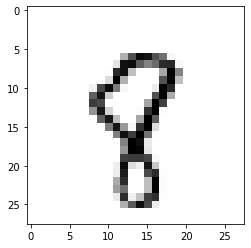

LABEL: 8
INPUT:


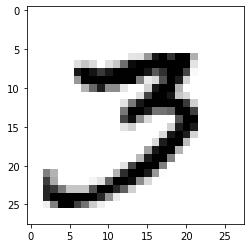

LABEL: 3
INPUT:


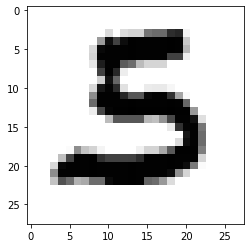

LABEL: 5
INPUT:


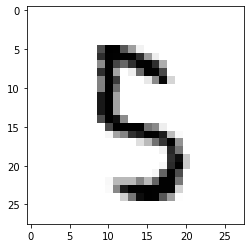

LABEL: 5
INPUT:


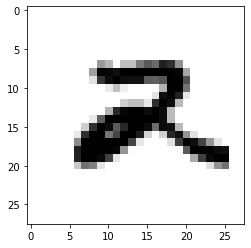

LABEL: 2
INPUT:


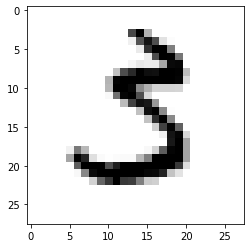

LABEL: 3
INPUT:


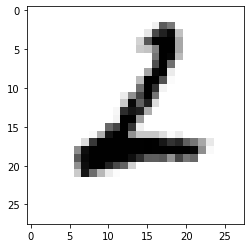

LABEL: 2
INPUT:


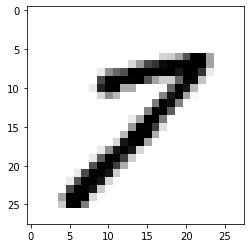

LABEL: 7
INPUT:


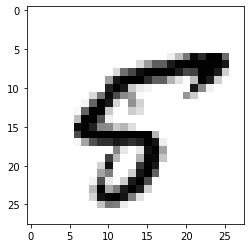

LABEL: 5
INPUT:


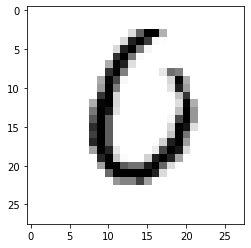

LABEL: 0
INPUT:


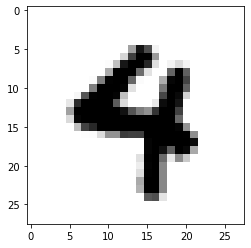

LABEL: 4
INPUT:


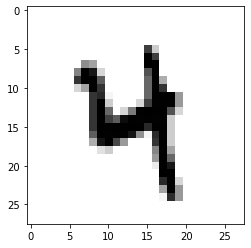

LABEL: 4
INPUT:


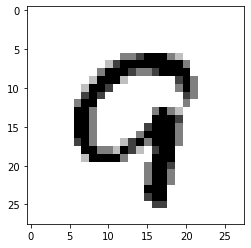

LABEL: 9
INPUT:


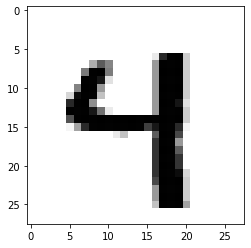

LABEL: 4
INPUT:


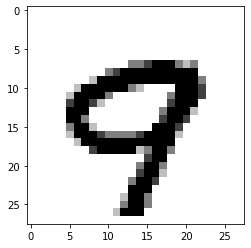

LABEL: 9
INPUT:


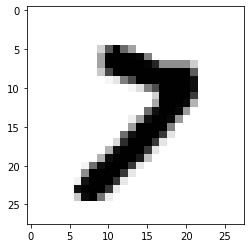

LABEL: 7
INPUT:


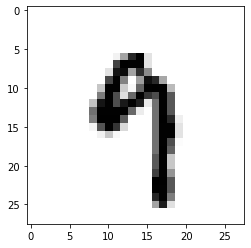

LABEL: 9
INPUT:


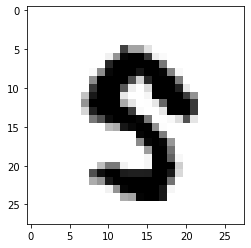

LABEL: 5
INPUT:


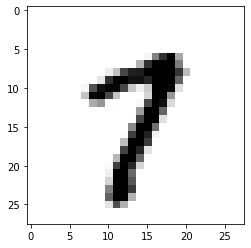

LABEL: 7
INPUT:


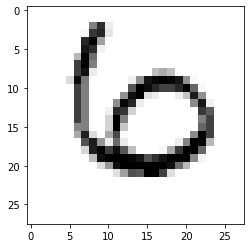

LABEL: 6
INPUT:


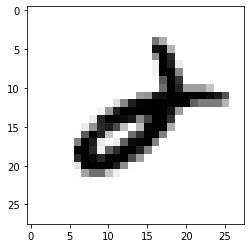

LABEL: 2
INPUT:


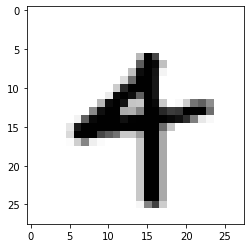

LABEL: 4
INPUT:


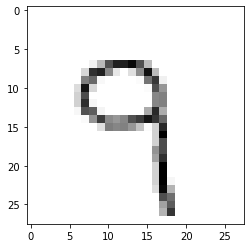

LABEL: 9
INPUT:


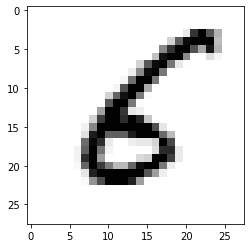

LABEL: 6
INPUT:


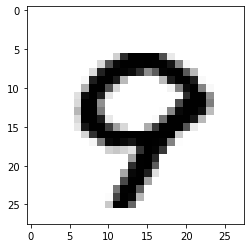

LABEL: 9
INPUT:


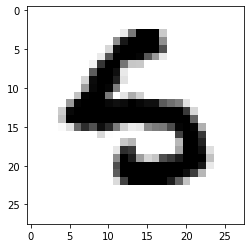

LABEL: 5
INPUT:


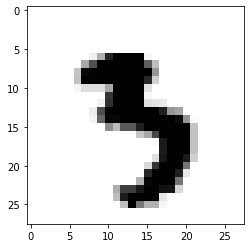

LABEL: 3
INPUT:


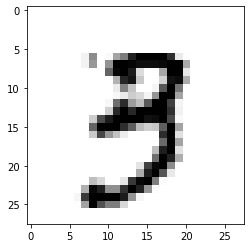

LABEL: 3
INPUT:


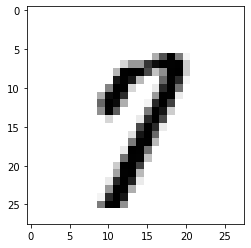

LABEL: 7
INPUT:


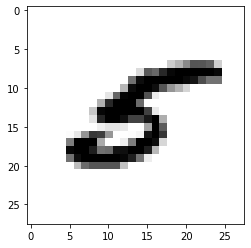

LABEL: 5
INPUT:


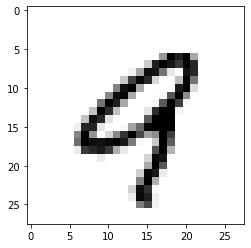

LABEL: 9
INPUT:


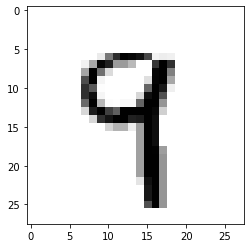

LABEL: 9
INPUT:


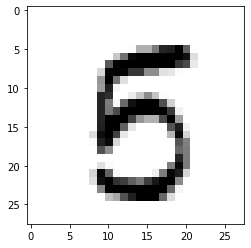

LABEL: 5
INPUT:


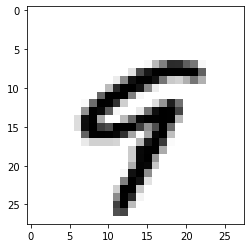

LABEL: 9
INPUT:


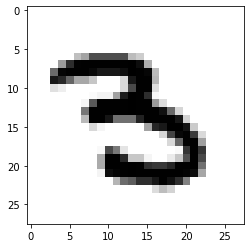

LABEL: 3
INPUT:


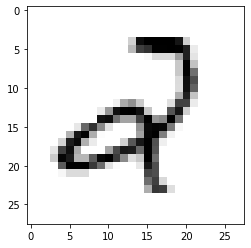

LABEL: 2
INPUT:


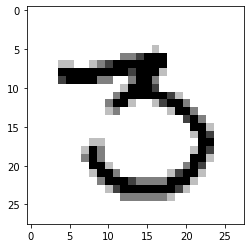

LABEL: 3
INPUT:


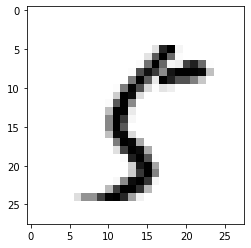

LABEL: 5
INPUT:


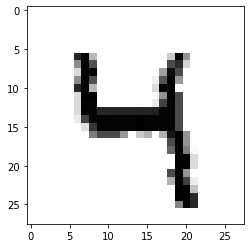

LABEL: 4
INPUT:


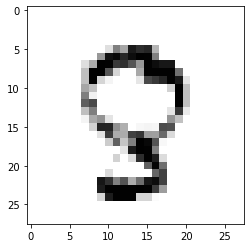

LABEL: 8
INPUT:


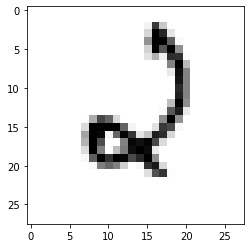

LABEL: 2
INPUT:


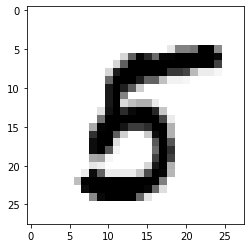

LABEL: 5
INPUT:


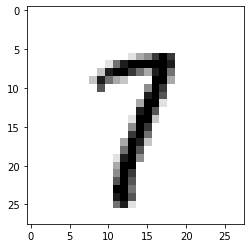

LABEL: 7
INPUT:


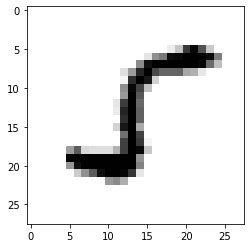

LABEL: 5
INPUT:


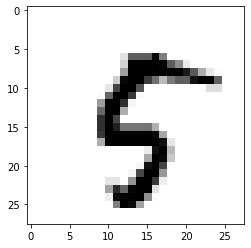

LABEL: 5
INPUT:


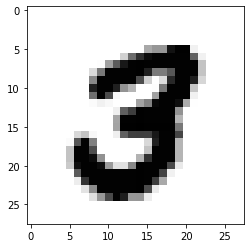

LABEL: 3
INPUT:


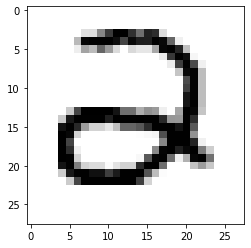

LABEL: 2
INPUT:


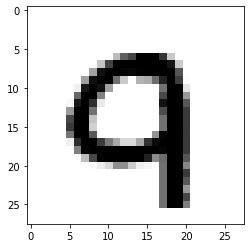

LABEL: 9
INPUT:


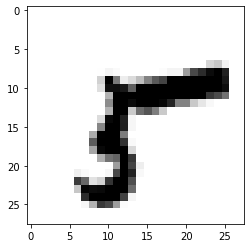

LABEL: 5
INPUT:


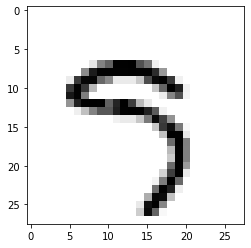

LABEL: 5
INPUT:


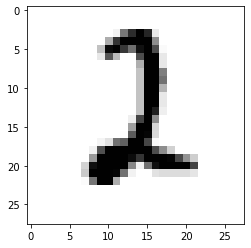

LABEL: 2
INPUT:


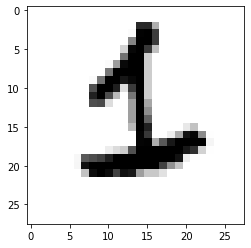

LABEL: 1
INPUT:


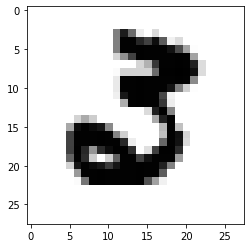

LABEL: 3
INPUT:


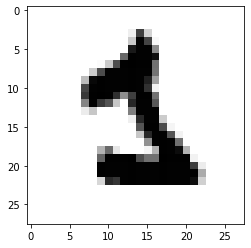

LABEL: 1
INPUT:


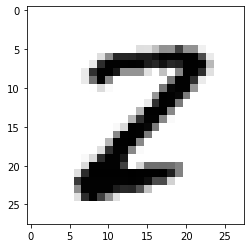

LABEL: 2
INPUT:


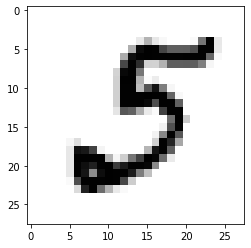

LABEL: 5
INPUT:


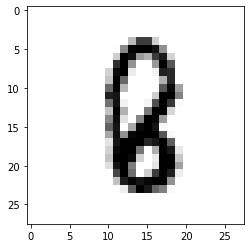

LABEL: 8
INPUT:


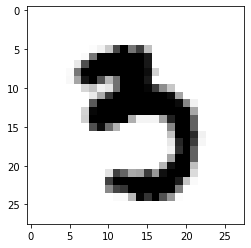

LABEL: 3
INPUT:


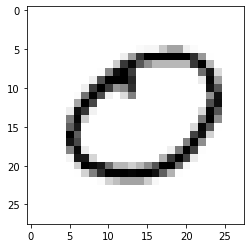

LABEL: 0
INPUT:


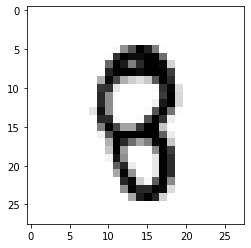

LABEL: 8
INPUT:


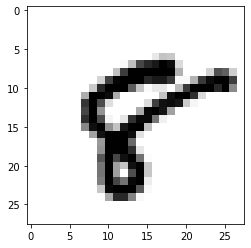

LABEL: 8
INPUT:


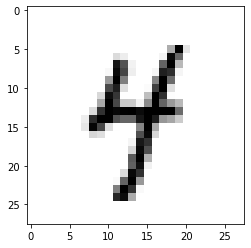

LABEL: 4
INPUT:


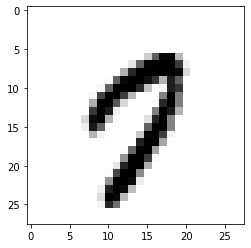

LABEL: 7
INPUT:


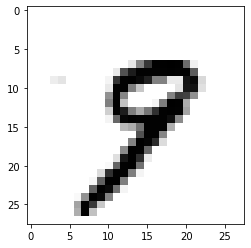

LABEL: 9
INPUT:


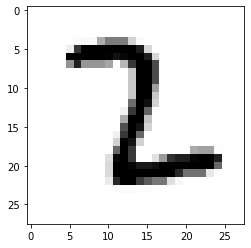

LABEL: 2
INPUT:


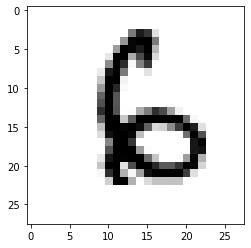

LABEL: 6
INPUT:


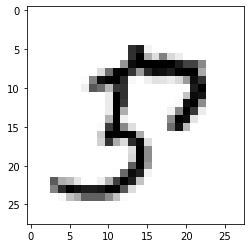

LABEL: 5
INPUT:


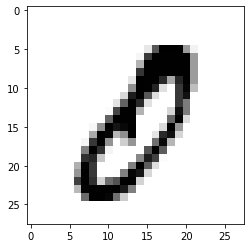

LABEL: 0
INPUT:


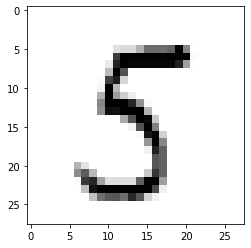

LABEL: 5
INPUT:


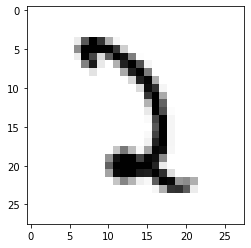

LABEL: 2
INPUT:


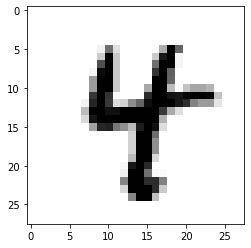

LABEL: 4
INPUT:


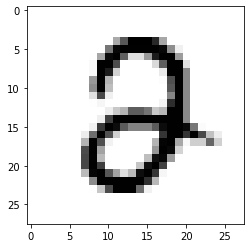

LABEL: 2
INPUT:


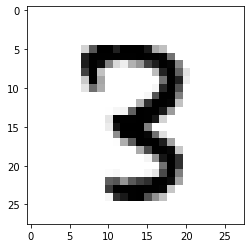

LABEL: 3
INPUT:


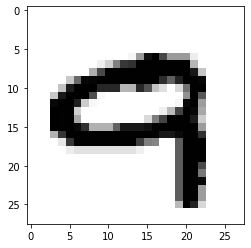

LABEL: 9
INPUT:


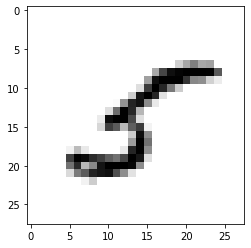

LABEL: 5
INPUT:


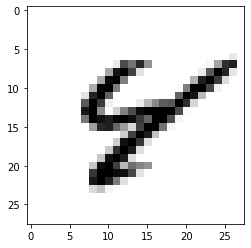

LABEL: 4
INPUT:


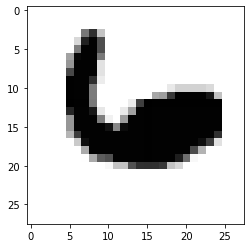

LABEL: 6
INPUT:


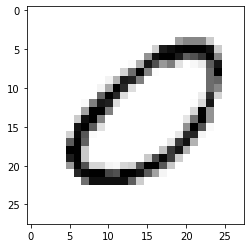

LABEL: 0
INPUT:


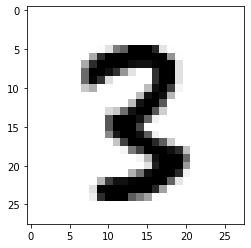

LABEL: 3
INPUT:


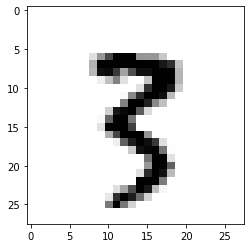

LABEL: 3
INPUT:


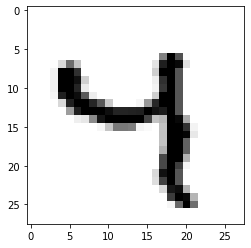

LABEL: 4
INPUT:


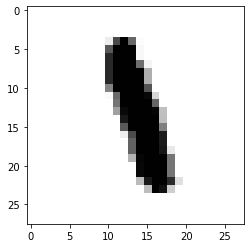

LABEL: 1
INPUT:


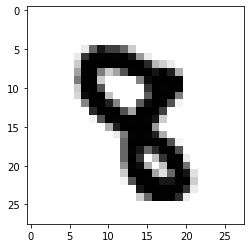

LABEL: 8
INPUT:


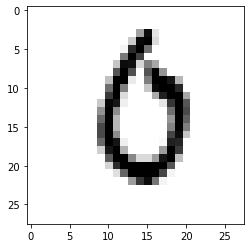

LABEL: 0
INPUT:


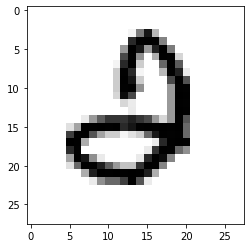

LABEL: 2
INPUT:


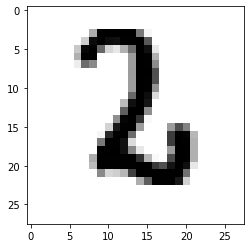

LABEL: 2
INPUT:


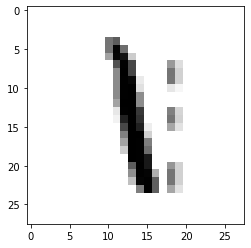

LABEL: 1
INPUT:


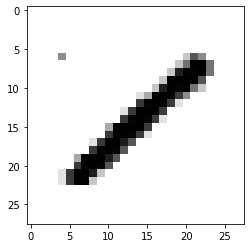

LABEL: 1
INPUT:


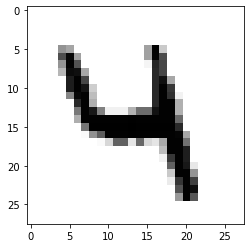

LABEL: 4
INPUT:


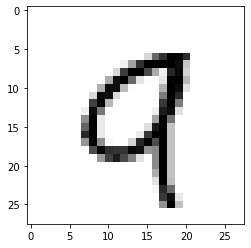

LABEL: 9
INPUT:


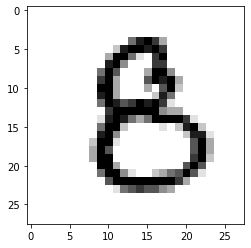

LABEL: 8
INPUT:


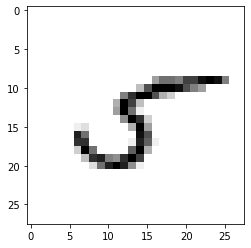

LABEL: 5
INPUT:


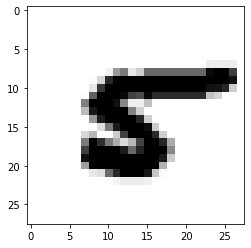

LABEL: 5
INPUT:


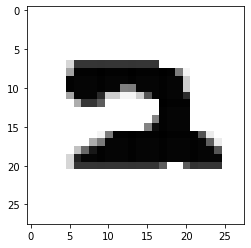

LABEL: 2
INPUT:


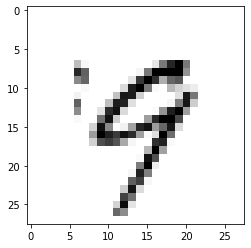

LABEL: 9
INPUT:


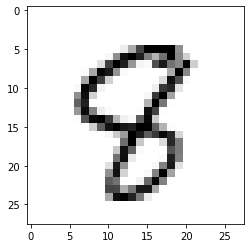

LABEL: 8
INPUT:


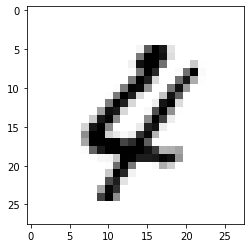

LABEL: 4
INPUT:


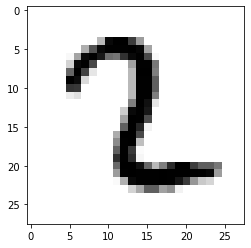

LABEL: 2
INPUT:


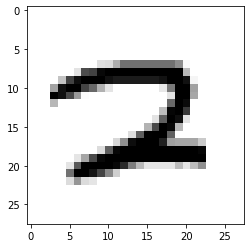

LABEL: 2
INPUT:


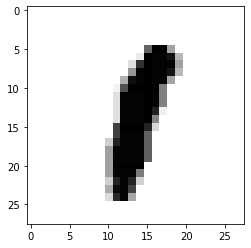

LABEL: 1
INPUT:


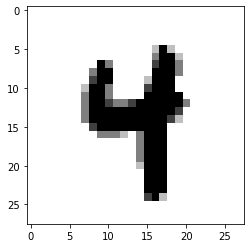

LABEL: 4
INPUT:


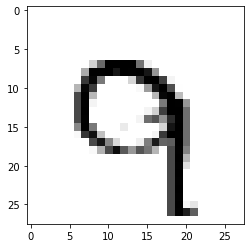

LABEL: 9
INPUT:


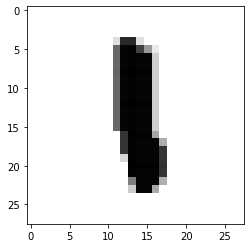

LABEL: 1
INPUT:


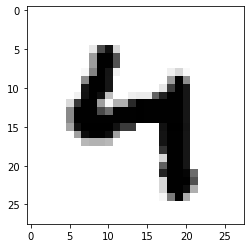

LABEL: 4
INPUT:


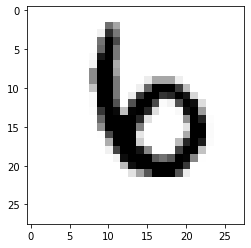

LABEL: 6
INPUT:


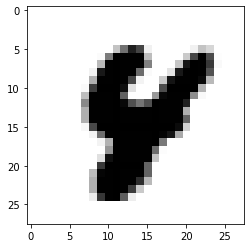

LABEL: 4
INPUT:


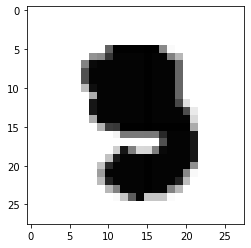

LABEL: 3
INPUT:


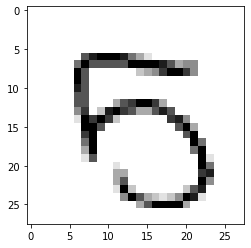

LABEL: 5
INPUT:


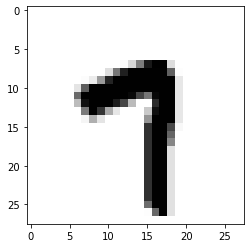

LABEL: 7
INPUT:


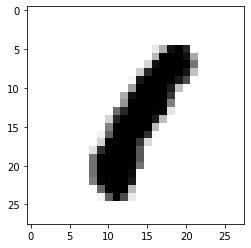

LABEL: 1
INPUT:


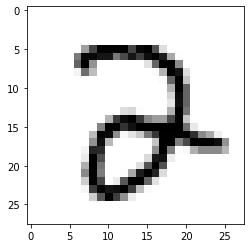

LABEL: 2
INPUT:


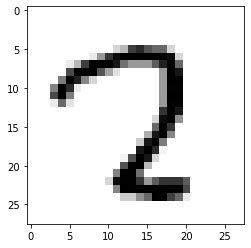

LABEL: 2
INPUT:


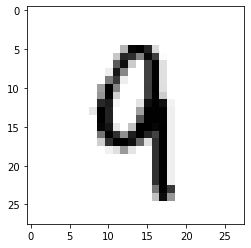

LABEL: 9
INPUT:


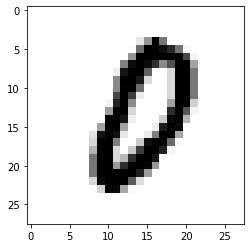

LABEL: 0
INPUT:


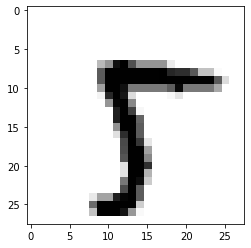

LABEL: 5
INPUT:


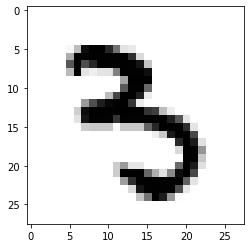

LABEL: 3
INPUT:


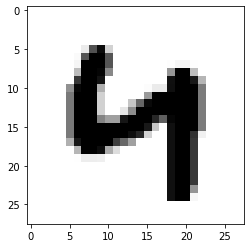

LABEL: 4
INPUT:


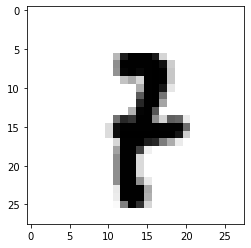

LABEL: 7
INPUT:


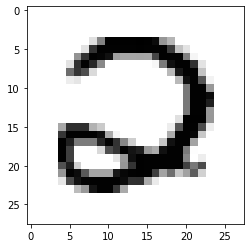

LABEL: 2
INPUT:


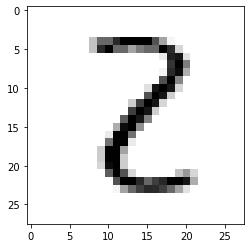

LABEL: 2
INPUT:


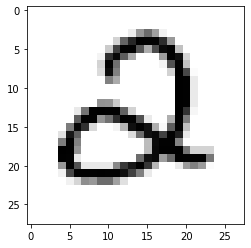

LABEL: 2
INPUT:


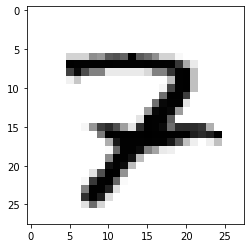

LABEL: 7
INPUT:


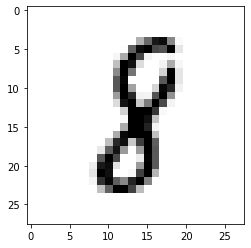

LABEL: 8
INPUT:


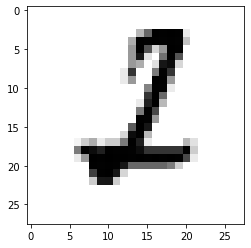

LABEL: 2
INPUT:


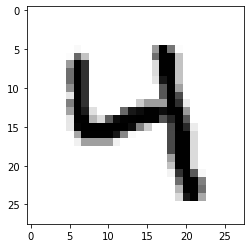

LABEL: 4
INPUT:


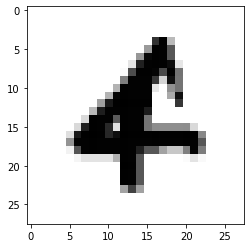

LABEL: 4
INPUT:


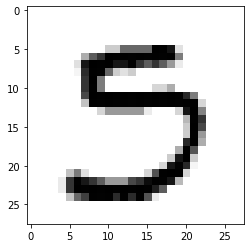

LABEL: 5
INPUT:


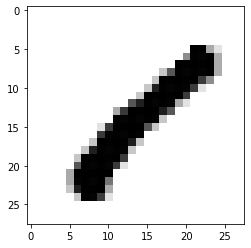

LABEL: 1
INPUT:


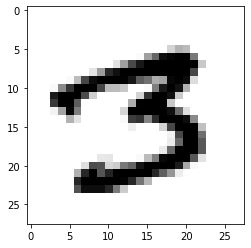

LABEL: 3
INPUT:


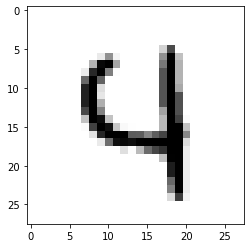

LABEL: 4
INPUT:


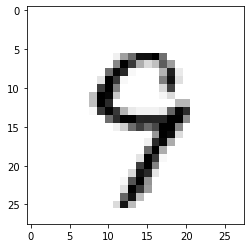

LABEL: 9
INPUT:


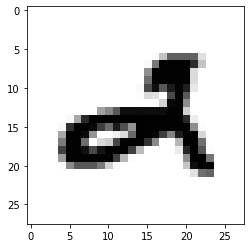

LABEL: 2
INPUT:


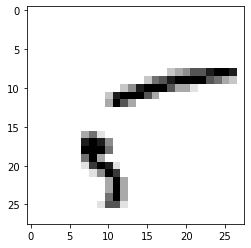

LABEL: 5
INPUT:


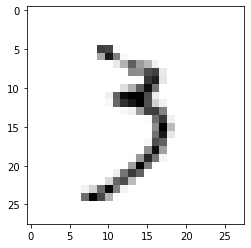

LABEL: 3
INPUT:


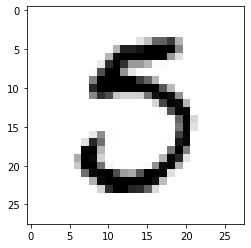

LABEL: 5
INPUT:


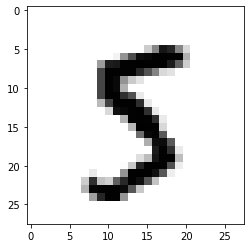

LABEL: 5
INPUT:


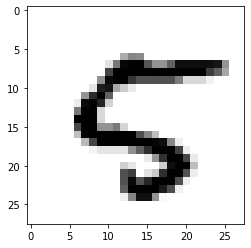

LABEL: 5
INPUT:


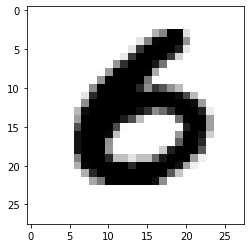

LABEL: 6
INPUT:


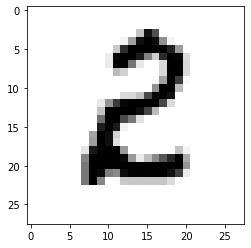

LABEL: 2
INPUT:


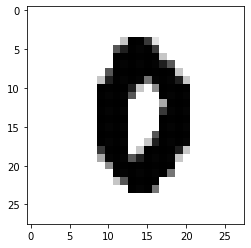

LABEL: 0
INPUT:


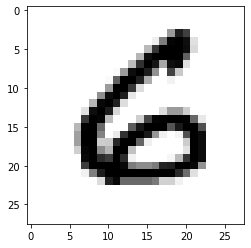

LABEL: 6
INPUT:


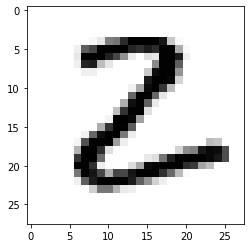

LABEL: 2
INPUT:


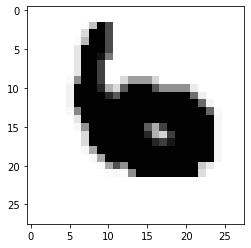

LABEL: 6
INPUT:


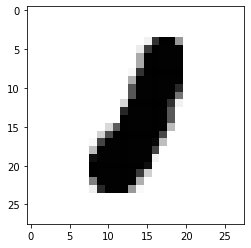

LABEL: 1
INPUT:


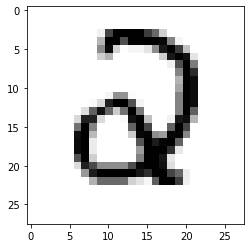

LABEL: 2
INPUT:


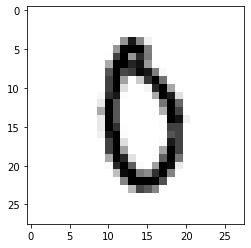

LABEL: 0
INPUT:


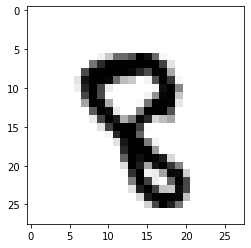

LABEL: 8
INPUT:


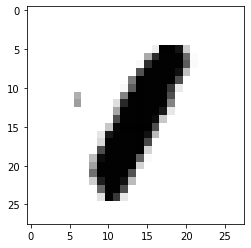

LABEL: 1
INPUT:


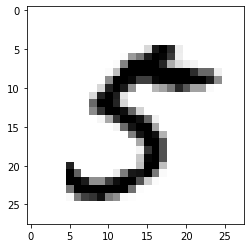

LABEL: 5
INPUT:


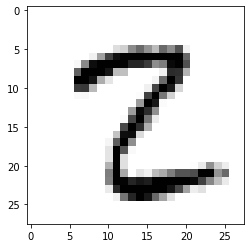

LABEL: 2
INPUT:


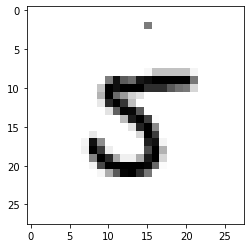

LABEL: 5
INPUT:


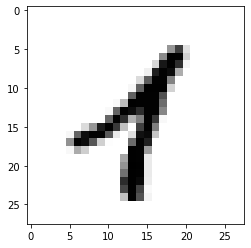

LABEL: 1
INPUT:


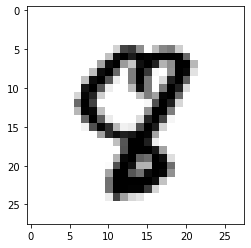

LABEL: 8
INPUT:


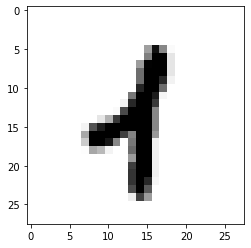

LABEL: 1
INPUT:


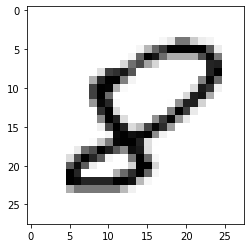

LABEL: 8
INPUT:


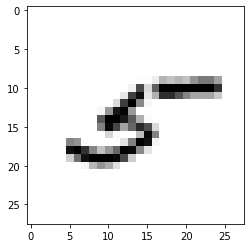

LABEL: 5
INPUT:


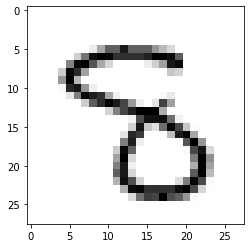

LABEL: 8
INPUT:


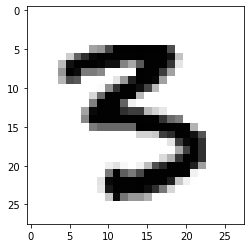

LABEL: 3
INPUT:


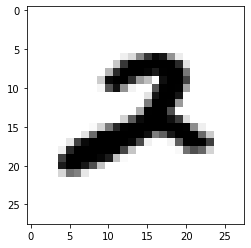

LABEL: 2
INPUT:


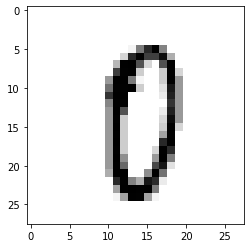

LABEL: 0
INPUT:


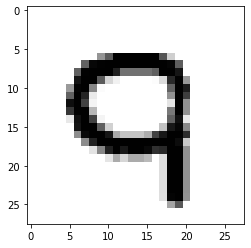

LABEL: 9
INPUT:


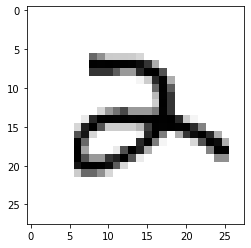

LABEL: 2
INPUT:


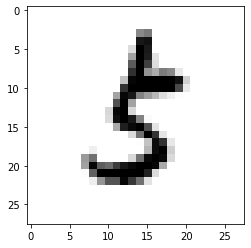

LABEL: 5
INPUT:


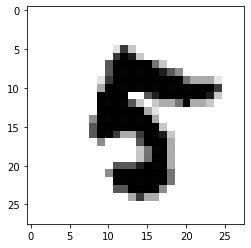

LABEL: 5
INPUT:


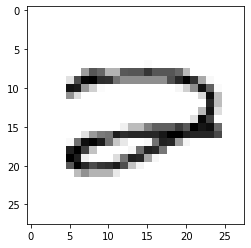

LABEL: 2
INPUT:


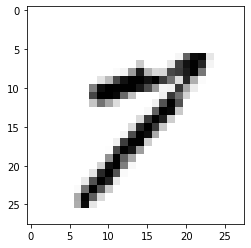

LABEL: 7
INPUT:


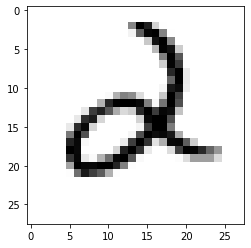

LABEL: 2
INPUT:


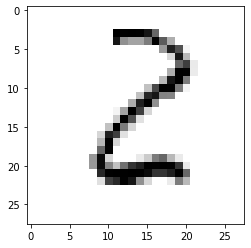

LABEL: 2
INPUT:


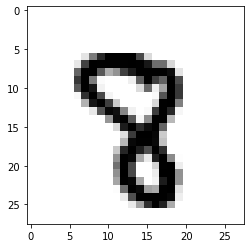

LABEL: 8
INPUT:


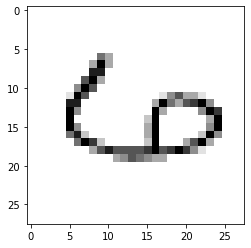

LABEL: 6
INPUT:


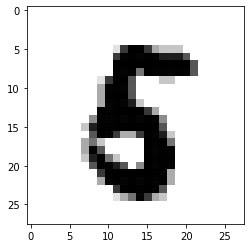

LABEL: 5
INPUT:


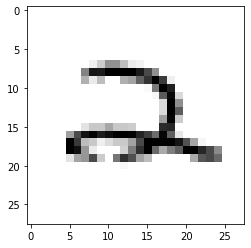

LABEL: 2
INPUT:


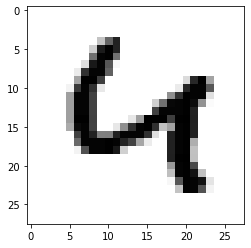

LABEL: 4
INPUT:


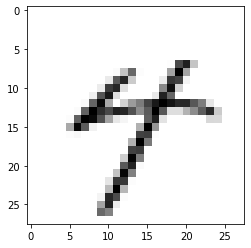

LABEL: 4
INPUT:


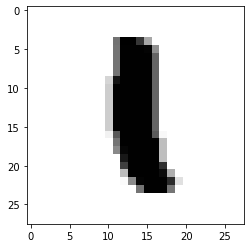

LABEL: 1
INPUT:


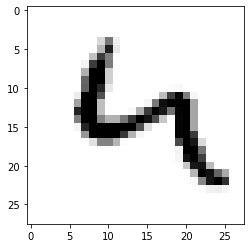

LABEL: 4
INPUT:


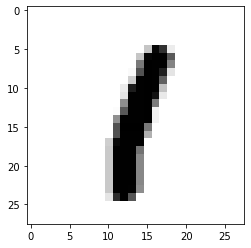

LABEL: 1
INPUT:


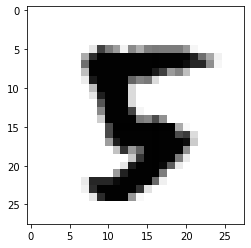

LABEL: 5
INPUT:


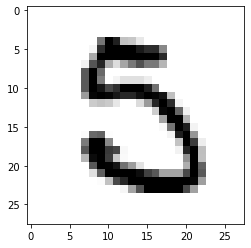

LABEL: 5
INPUT:


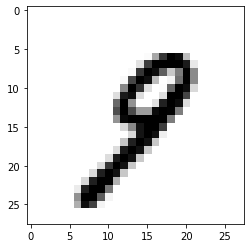

LABEL: 9
INPUT:


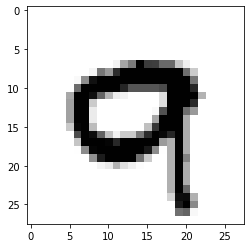

LABEL: 9
INPUT:


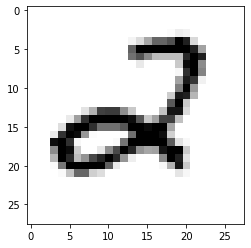

LABEL: 2
INPUT:


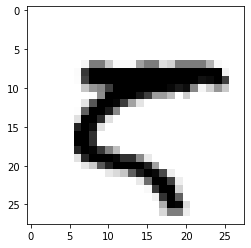

LABEL: 5
INPUT:


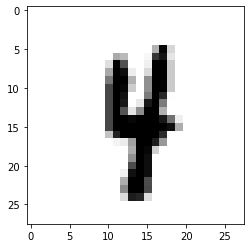

LABEL: 4
INPUT:


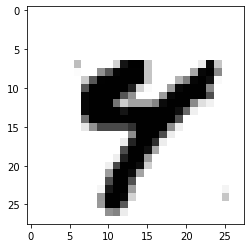

LABEL: 4
INPUT:


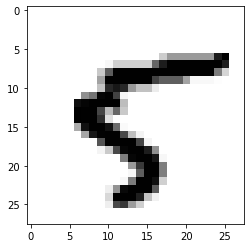

LABEL: 5
INPUT:


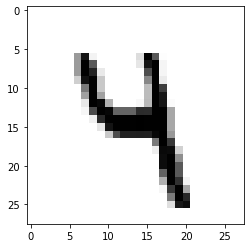

LABEL: 4
INPUT:


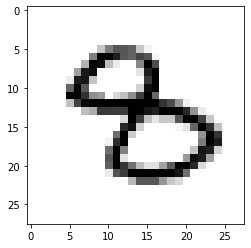

LABEL: 8
INPUT:


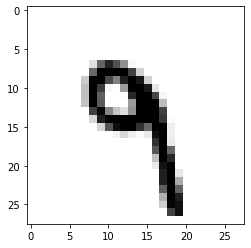

LABEL: 9
INPUT:


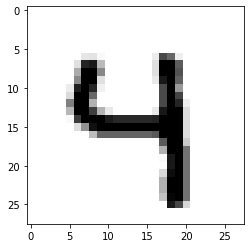

LABEL: 4
INPUT:


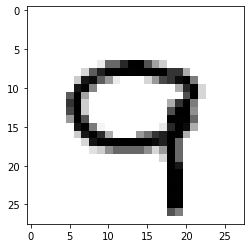

LABEL: 9
INPUT:


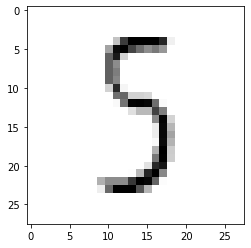

LABEL: 5
INPUT:


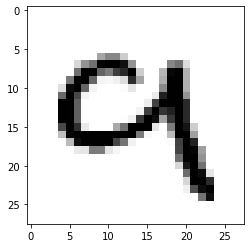

LABEL: 9
INPUT:


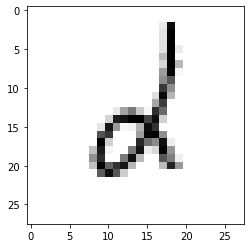

LABEL: 2
INPUT:


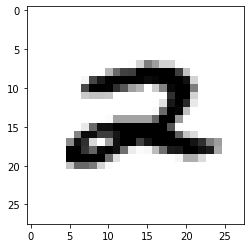

LABEL: 2
INPUT:


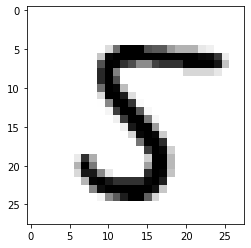

LABEL: 5
INPUT:


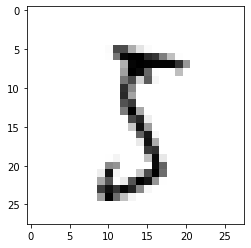

LABEL: 5
INPUT:


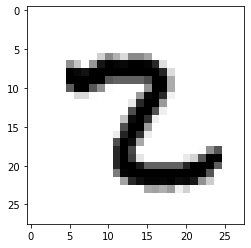

LABEL: 2
INPUT:


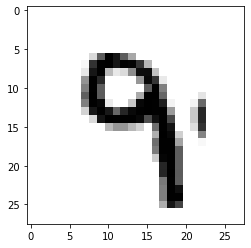

LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 1


2721

In [ ]:
y_pred_lr = lr_cv.predict(X_test)
y_pred_svm = best_SVM.predict(X_test)
count = 0
for i in range(len(y_pred_svm)):
    if y_pred_lr[i] != y_test[i]:
        if y_pred_svm[i] == y_test[i]:
            count +=1
            plot_digit(X_test,y_test, i)
count

## More data
Now let's do the same but using 1000 data points for training. 

## TO DO 6
Repeat the entire analysis above using 1000 samples. Of course you can copy the code from above.

Keep 1000 Samples

In [ ]:
m_training = 1000

X_train, X_test = X[:m_training], X[m_training:]
y_train, y_test = y[:m_training], y[m_training:]

print("Labels and frequencies in training dataset: ")
np.unique(y_train, return_counts = True)

Labels and frequencies in training dataset: 


(array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype=object),
 array([104, 121,  87, 109, 103,  77, 105, 106,  88, 100]))

To Do 1 

In [ ]:
#import SVC
from sklearn.svm import SVC
#import for Cross-Validation
from sklearn.model_selection import GridSearchCV

# parameters for linear SVM
parameters = {'C': [1, 10, 100]}

#run linear SVM
linear_SVM = SVC(kernel='linear')

#find best model uusing 5-fold CV 
#and train it using all the training data

clf = GridSearchCV(linear_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR LINEAR KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")
scores = ['params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score']

for i in scores:
    print(results[i])

# parameters for poly with degree 2 kernel
parameters = {'C': [1, 10, 100],'gamma':[0.01,0.1,1.]}

#run SVM with poly of degree 2 kernel
poly2_SVM = SVC(kernel='poly',degree=2)

# ADD CODE: DO THE SAME AS ABOVE FOR POLYNOMIAL KERNEL WITH DEGREE=2

clf = GridSearchCV(poly2_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR LINEAR KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")

for i in scores:
    print(results[i])


# parameters for rbf SVM
parameters = {'C': [1, 10, 100],'gamma':[0.01,0.1,1.]}

#run SVM with rbf kernel
rbf_SVM = SVC(kernel='rbf')

clf = GridSearchCV(rbf_SVM, parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('\nRESULTS FOR rbf KERNEL\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")

for i in scores:
    print(results[i])


RESULTS FOR LINEAR KERNEL

{'mean_fit_time': array([0.38231177, 0.38032694, 0.38027372]), 'std_fit_time': array([0.0036456 , 0.00352097, 0.00277851]), 'mean_score_time': array([0.12072735, 0.11920481, 0.11931076]), 'std_score_time': array([0.00488023, 0.00154519, 0.00150899]), 'param_C': masked_array(data=[1, 10, 100],
             mask=[False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'C': 1}, {'C': 10}, {'C': 100}], 'split0_test_score': array([0.905, 0.905, 0.905]), 'split1_test_score': array([0.855, 0.855, 0.855]), 'split2_test_score': array([0.88, 0.88, 0.88]), 'split3_test_score': array([0.925, 0.925, 0.925]), 'split4_test_score': array([0.9, 0.9, 0.9]), 'mean_test_score': array([0.893, 0.893, 0.893]), 'std_test_score': array([0.02379075, 0.02379075, 0.02379075]), 'rank_test_score': array([1, 1, 1], dtype=int32)}
Best parameters set found:
{'C': 1}
Score with best parameters:
[{'C': 1}, 0.8930000000000001]

All scores on the grid:
[{'C': 1}, {'C'

To Do 2

In [ ]:
#get training and test error for the best SVM model from CV
best_SVM = SVC(kernel='linear', C=1)

# fit the model on the entire training set

best_SVM.fit(X_train, y_train)

#get the training and test error
training_error = 1. - best_SVM.score(X_train,y_train)
test_error = 1. - best_SVM.score(X_test,y_test)

print ("Best SVM training error: %f" % training_error)
print ("Best SVM test error: %f" % test_error)

Best SVM training error: 0.000000
Best SVM test error: 0.121551


To Do 3

In [ ]:
from sklearn import linear_model

lr = linear_model.LogisticRegression()
# fit the model on the training data
clf = lr.fit(X_train,y_train)

#compute training and test error for model above
training_error = 1. - clf.score(X_train,y_train)
test_error = 1. - clf.score(X_train,y_train)

print ("Best logistic regression training error: %f" % training_error)
print ("Best logistic regression test error: %f" % test_error)

#logistic regression with 5-fold CV: you can use use linear_model.LogisticRegressionCV
# use 5-fold CV to find the best choice of the parameter, than train
# the model on the entire training set
lr_cv = linear_model.LogisticRegressionCV(cv=5).fit(X_train,y_train)
training_error_cv = 1. - lr_cv.score(X_train,y_train)
test_error_cv = 1. - lr_cv.score(X_train,y_train)

print ("Best logistic regression training error: %f" % training_error_cv)
print ("Best logistic regression test error: %f" % test_error_cv)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Best logistic regression training error: 0.000000
Best logistic regression test error: 0.000000


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Best logistic regression training error: 0.000000
Best logistic regression test error: 0.000000


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


To Do 5

INPUT:


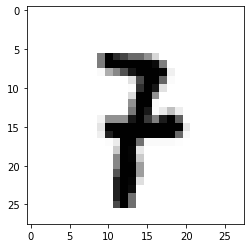

LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


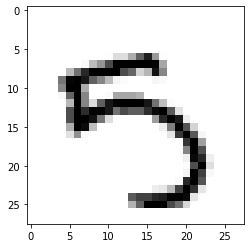

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


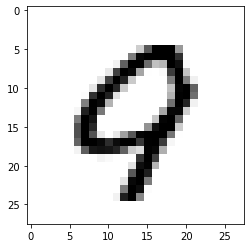

LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


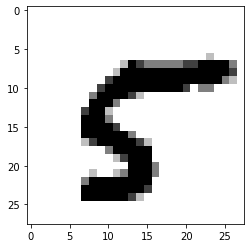

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


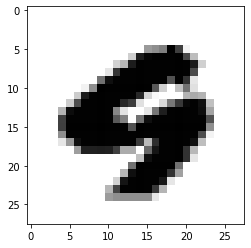

LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


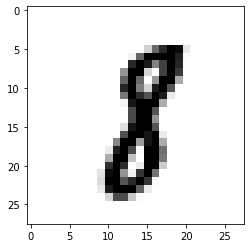

LABEL: 8
INPUT:


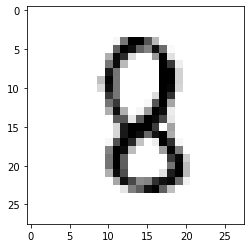

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


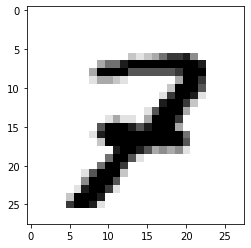

LABEL: 7
INPUT:


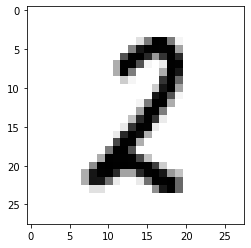

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


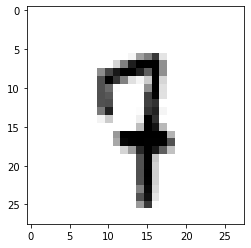

LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


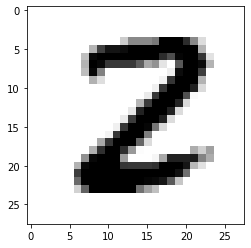

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


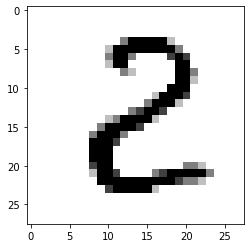

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


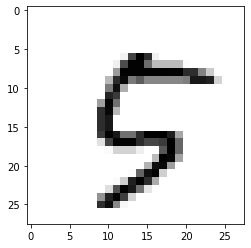

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


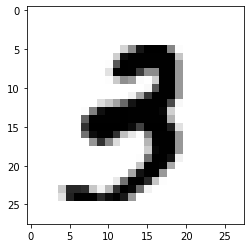

LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


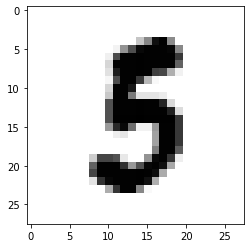

LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


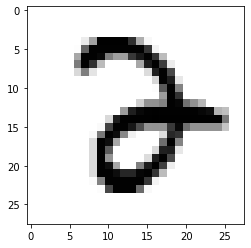

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


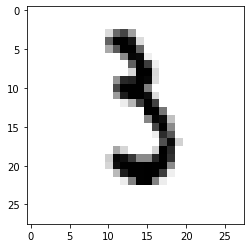

LABEL: 3
INPUT:


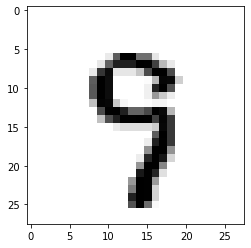

LABEL: 9
INPUT:


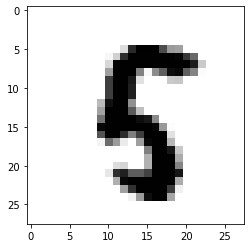

LABEL: 5
INPUT:


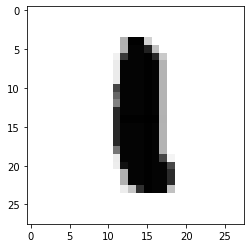

LABEL: 1
INPUT:


LABEL: 1
INPUT:


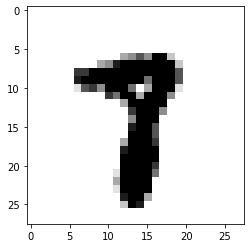

LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


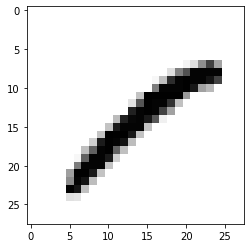

LABEL: 1
INPUT:


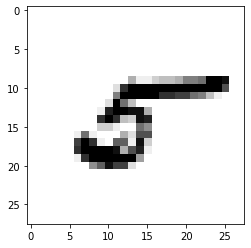

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


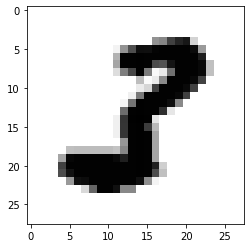

LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


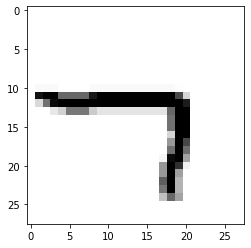

LABEL: 7
INPUT:


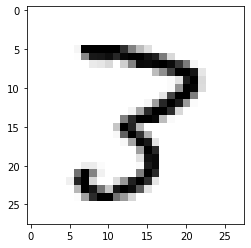

LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


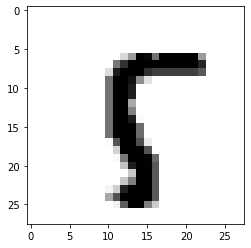

LABEL: 5
INPUT:


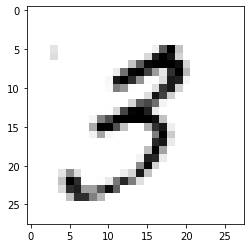

LABEL: 3
INPUT:


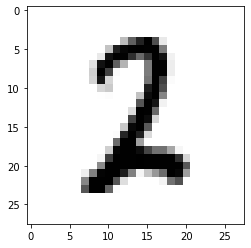

LABEL: 2
INPUT:


LABEL: 0
INPUT:


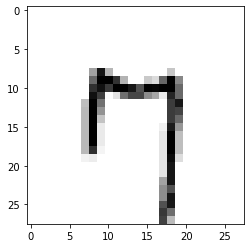

LABEL: 7
INPUT:


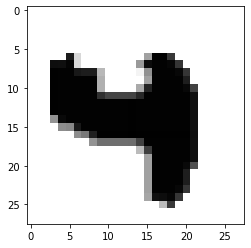

LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


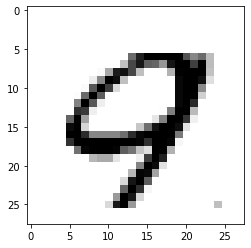

LABEL: 9
INPUT:


LABEL: 9
INPUT:


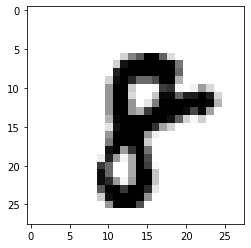

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


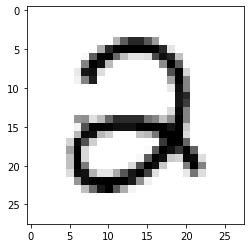

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


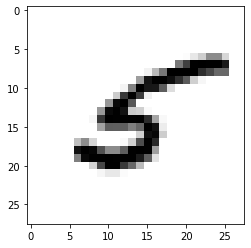

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


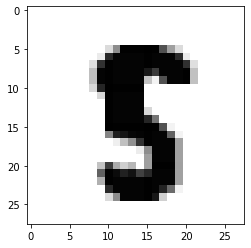

LABEL: 5
INPUT:


LABEL: 0
INPUT:


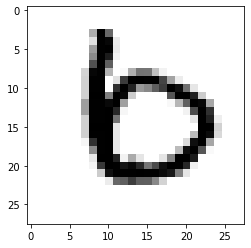

LABEL: 6
INPUT:


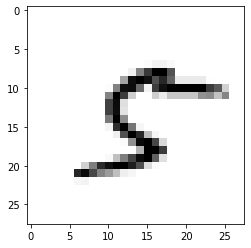

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


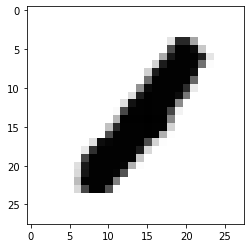

LABEL: 1
INPUT:


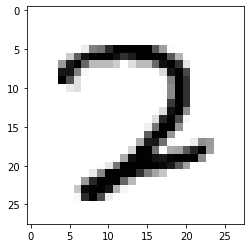

LABEL: 2
INPUT:


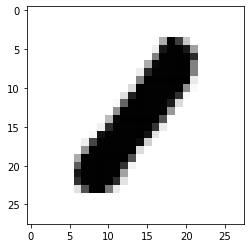

LABEL: 1
INPUT:


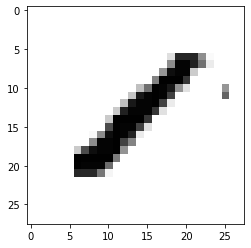

LABEL: 1
INPUT:


LABEL: 4
INPUT:


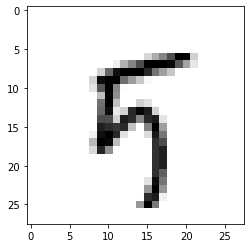

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


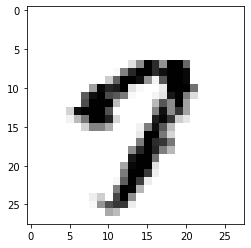

LABEL: 7
INPUT:


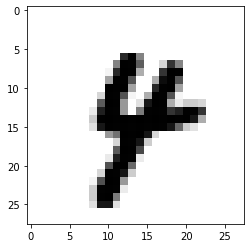

LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


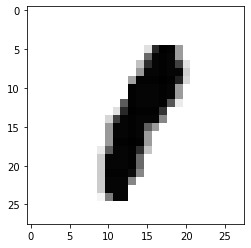

LABEL: 1
INPUT:


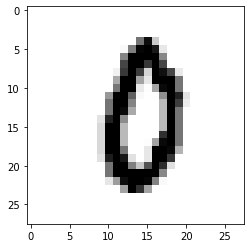

LABEL: 0
INPUT:


LABEL: 2
INPUT:


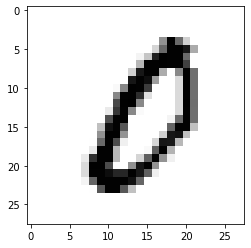

LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


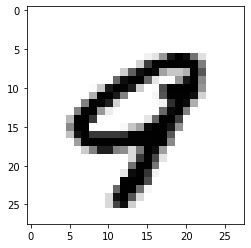

LABEL: 9
INPUT:


LABEL: 2
INPUT:


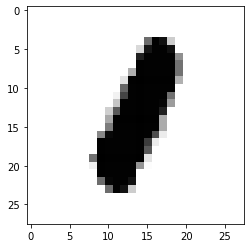

LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


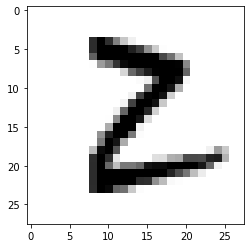

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


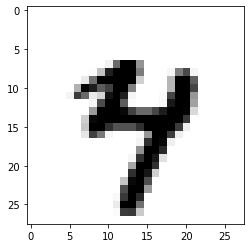

LABEL: 4
INPUT:


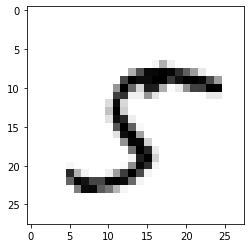

LABEL: 5
INPUT:


LABEL: 8
INPUT:


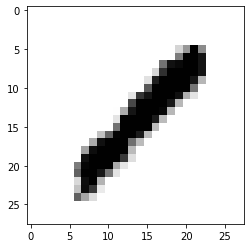

LABEL: 1
INPUT:


LABEL: 9
INPUT:


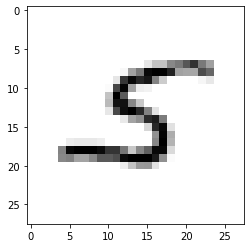

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


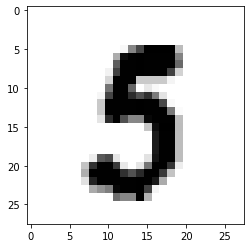

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


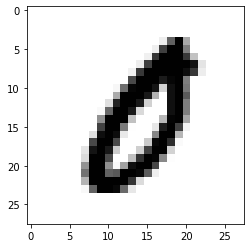

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


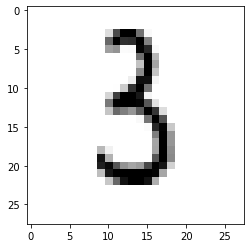

LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


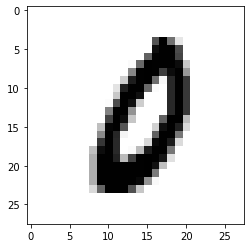

LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


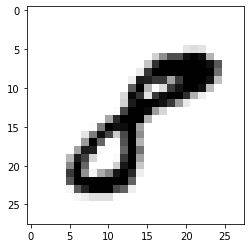

LABEL: 8
INPUT:


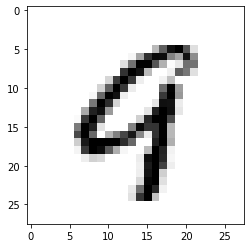

LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


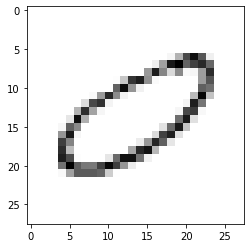

LABEL: 0
INPUT:


LABEL: 3
INPUT:


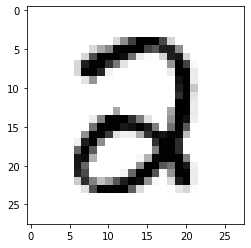

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


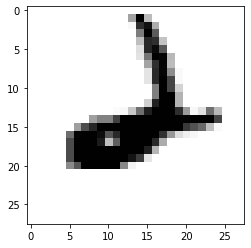

LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


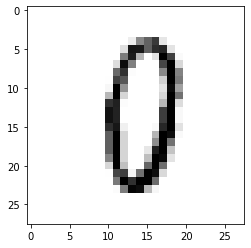

LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


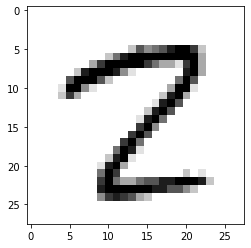

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


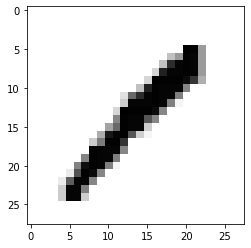

LABEL: 1
INPUT:


LABEL: 2
INPUT:


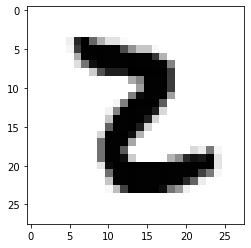

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


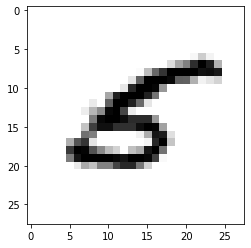

LABEL: 5
INPUT:


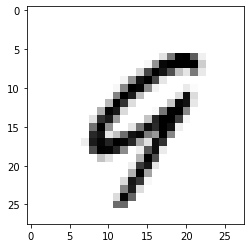

LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


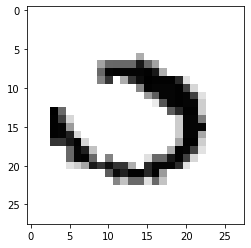

LABEL: 0
INPUT:


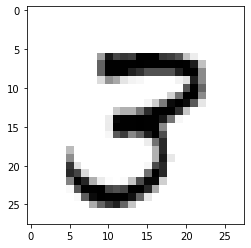

LABEL: 3
INPUT:


LABEL: 8
INPUT:


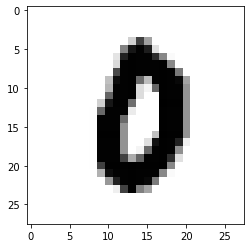

LABEL: 0
INPUT:


LABEL: 8
INPUT:


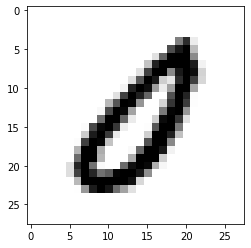

LABEL: 0
INPUT:


LABEL: 4
INPUT:


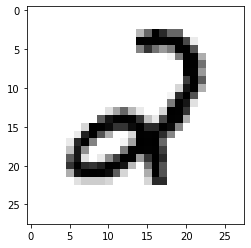

LABEL: 2
INPUT:


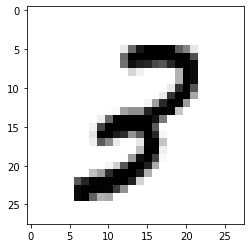

LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


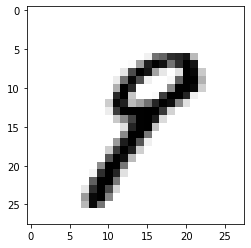

LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


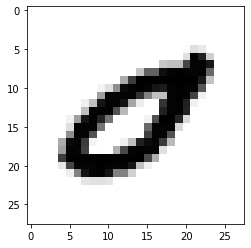

LABEL: 0
INPUT:


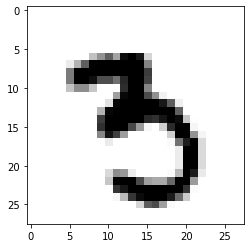

LABEL: 3
INPUT:


LABEL: 1
INPUT:


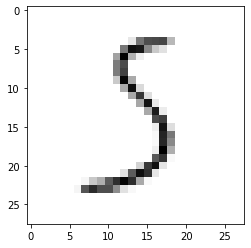

LABEL: 5
INPUT:


LABEL: 2
INPUT:


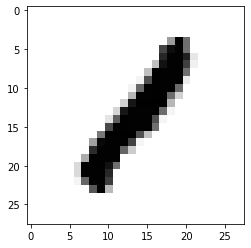

LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


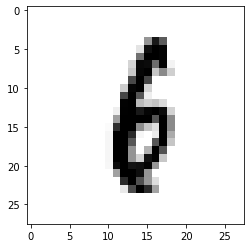

LABEL: 6
INPUT:


LABEL: 0
INPUT:


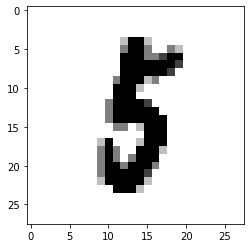

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


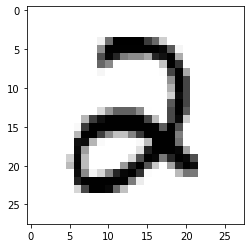

LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


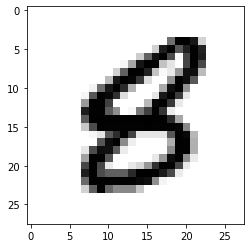

LABEL: 8
INPUT:


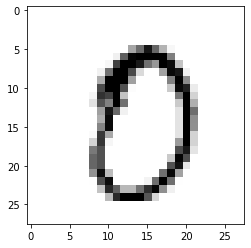

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


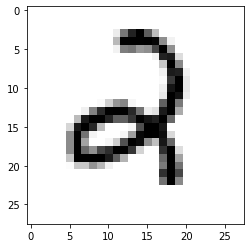

LABEL: 2
INPUT:


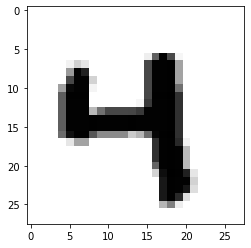

LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


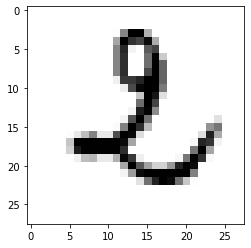

LABEL: 2
INPUT:


LABEL: 4
INPUT:


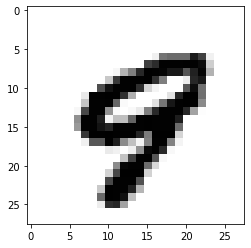

LABEL: 9
INPUT:


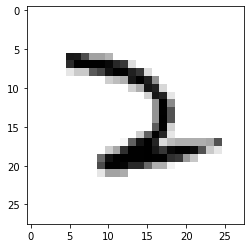

LABEL: 2
INPUT:


LABEL: 7
INPUT:


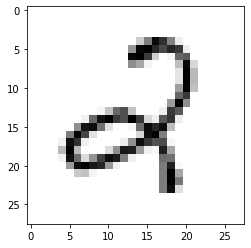

LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


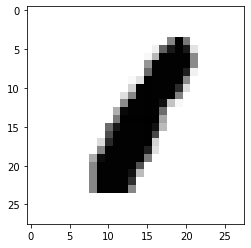

LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


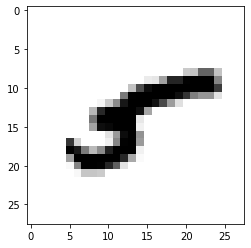

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


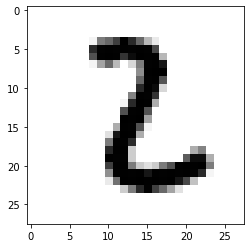

LABEL: 2
INPUT:


LABEL: 3
INPUT:


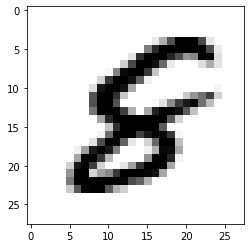

LABEL: 8
INPUT:


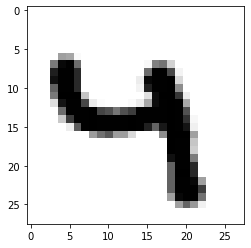

LABEL: 4
INPUT:


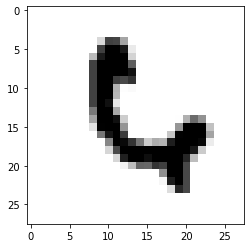

LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


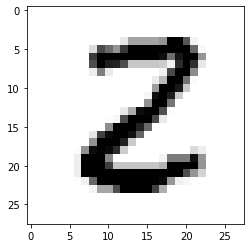

LABEL: 2
INPUT:


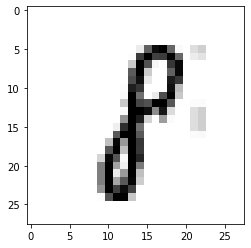

LABEL: 8
INPUT:


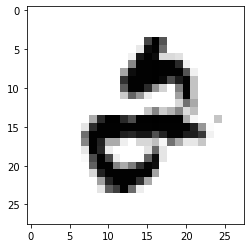

LABEL: 2
INPUT:


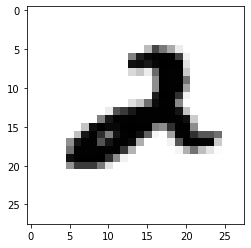

LABEL: 2
INPUT:


LABEL: 5
INPUT:


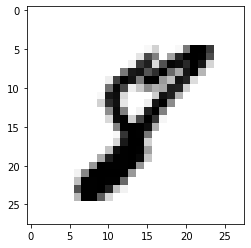

LABEL: 8
INPUT:


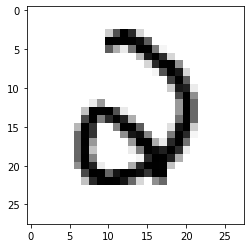

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


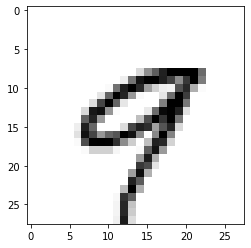

LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


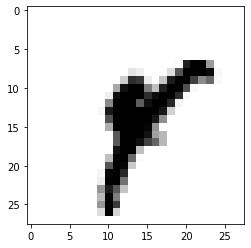

LABEL: 4
INPUT:


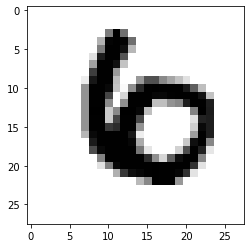

LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


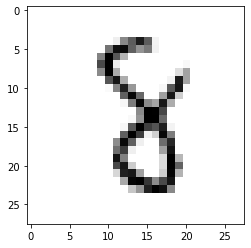

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


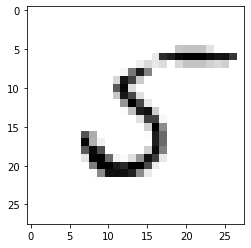

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


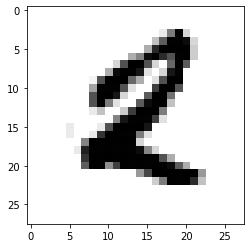

LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


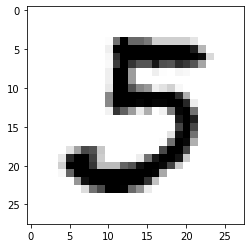

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


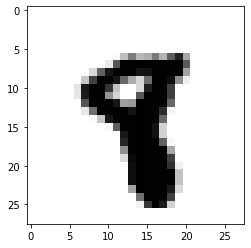

LABEL: 8
INPUT:


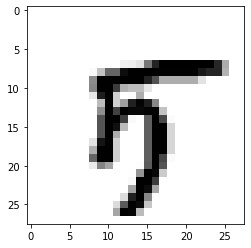

LABEL: 5
INPUT:


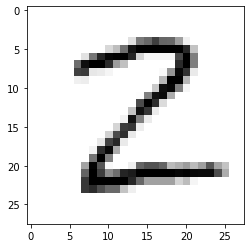

LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


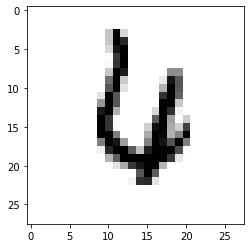

LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


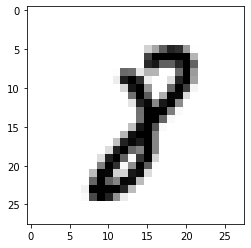

LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


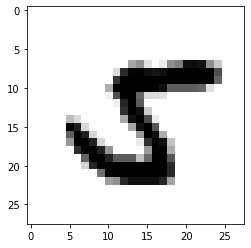

LABEL: 5
INPUT:


LABEL: 3
INPUT:


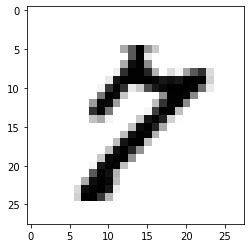

LABEL: 7
INPUT:


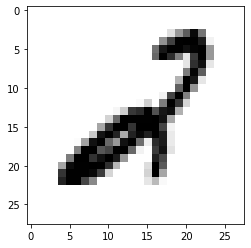

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


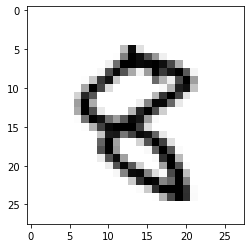

LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


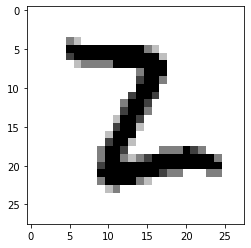

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


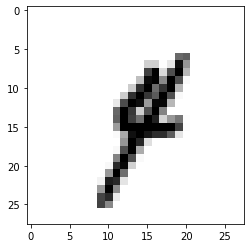

LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


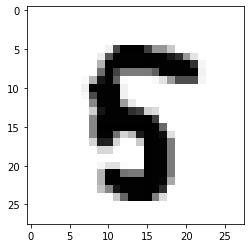

LABEL: 5
INPUT:


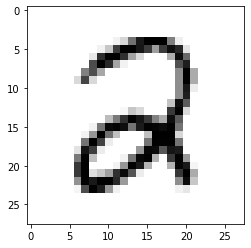

LABEL: 2
INPUT:


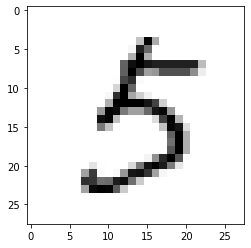

LABEL: 5
INPUT:


LABEL: 2
INPUT:


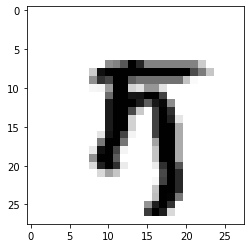

LABEL: 5
INPUT:


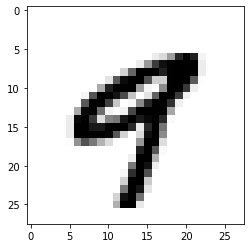

LABEL: 9
INPUT:


LABEL: 4
INPUT:


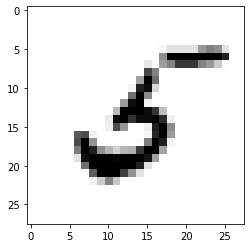

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


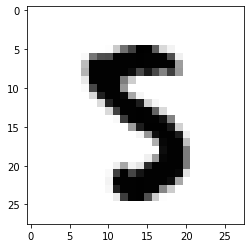

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


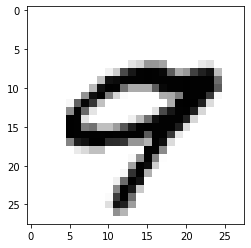

LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


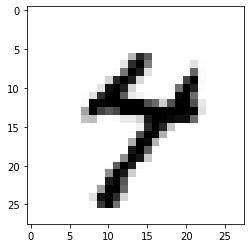

LABEL: 4
INPUT:


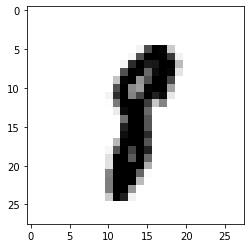

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


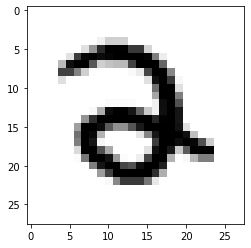

LABEL: 2
INPUT:


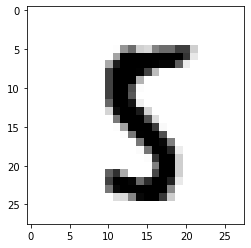

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


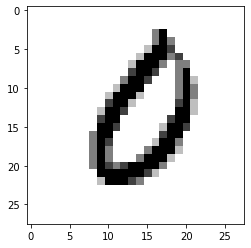

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


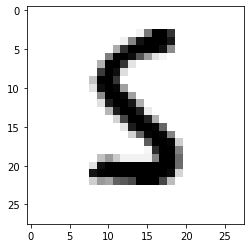

LABEL: 5
INPUT:


LABEL: 4
INPUT:


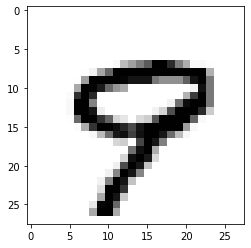

LABEL: 9
INPUT:


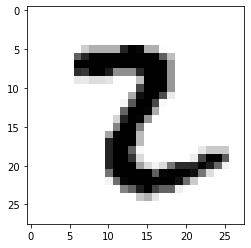

LABEL: 2
INPUT:


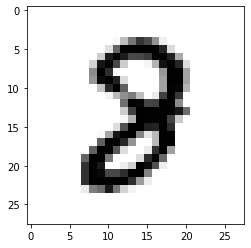

LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


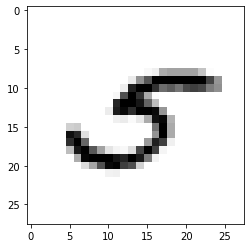

LABEL: 5
INPUT:


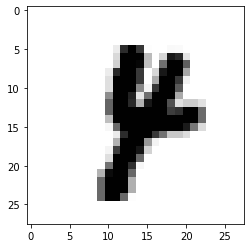

LABEL: 4
INPUT:


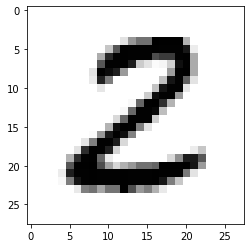

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


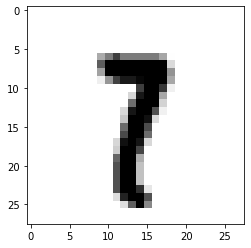

LABEL: 7
INPUT:


LABEL: 3
INPUT:


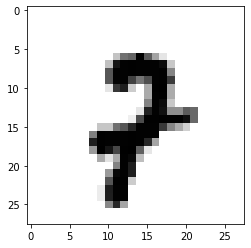

LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


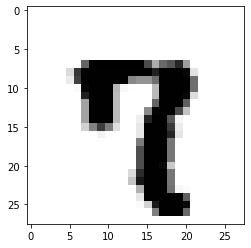

LABEL: 7
INPUT:


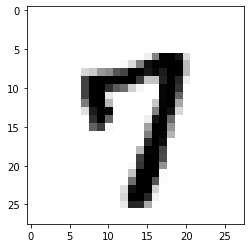

LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


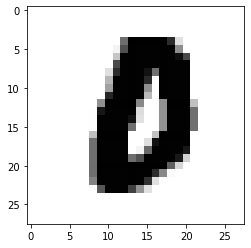

LABEL: 0
INPUT:


LABEL: 4
INPUT:


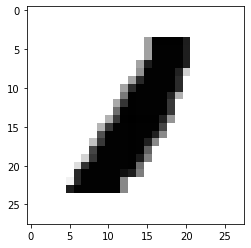

LABEL: 1
INPUT:


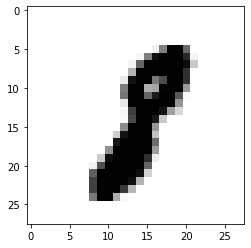

LABEL: 8
INPUT:


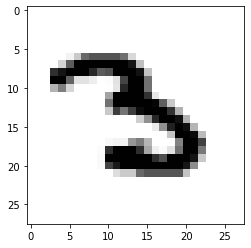

LABEL: 3
INPUT:


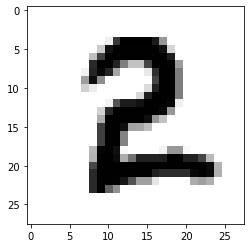

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


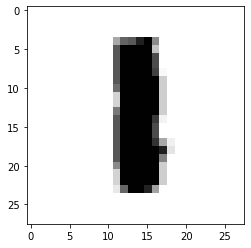

LABEL: 1
INPUT:


LABEL: 9
INPUT:


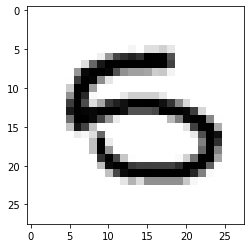

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


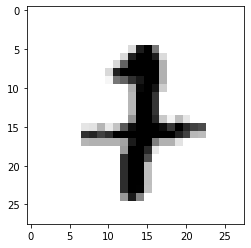

LABEL: 7
INPUT:


LABEL: 9
INPUT:


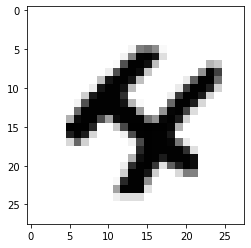

LABEL: 4
INPUT:


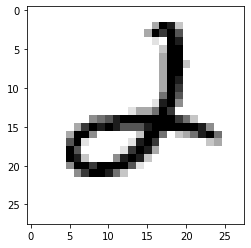

LABEL: 2
INPUT:


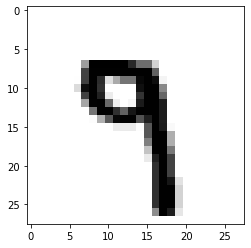

LABEL: 9
INPUT:


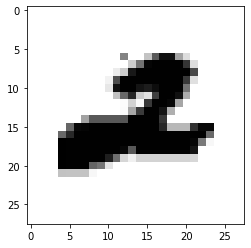

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


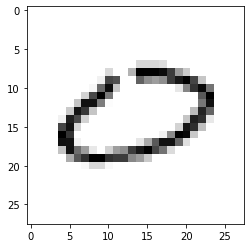

LABEL: 0
INPUT:


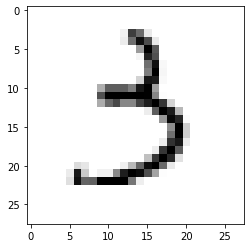

LABEL: 3
INPUT:


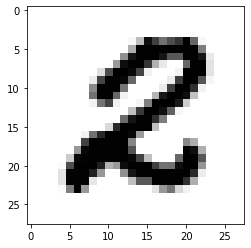

LABEL: 2
INPUT:


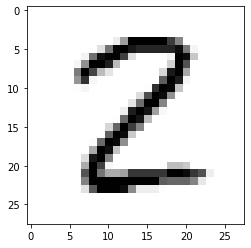

LABEL: 2
INPUT:


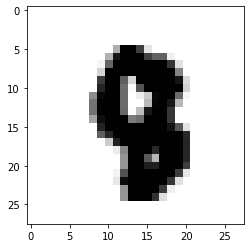

LABEL: 8
INPUT:


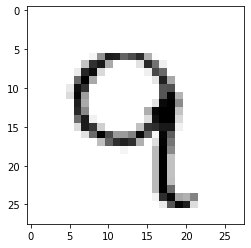

LABEL: 9
INPUT:


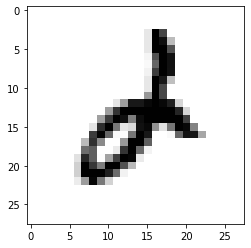

LABEL: 2
INPUT:


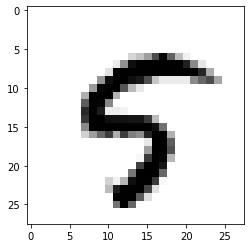

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


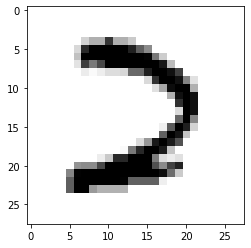

LABEL: 2
INPUT:


LABEL: 0
INPUT:


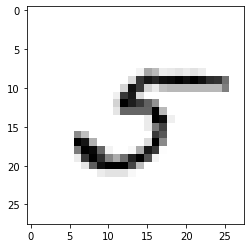

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


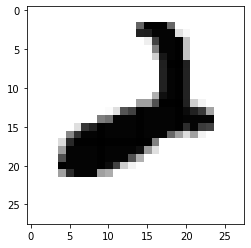

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


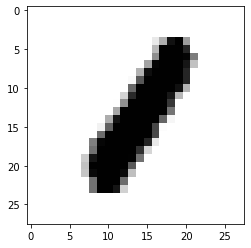

LABEL: 1
INPUT:


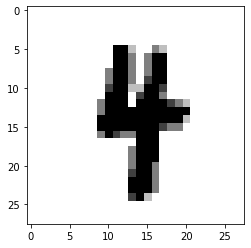

LABEL: 4
INPUT:


LABEL: 5
INPUT:


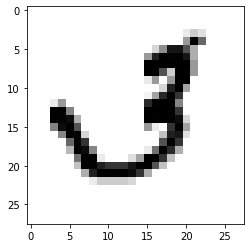

LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


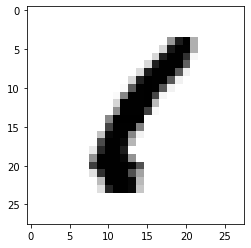

LABEL: 1
INPUT:


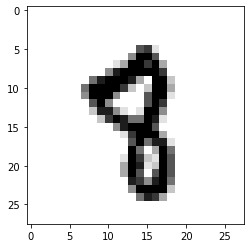

LABEL: 8
INPUT:


LABEL: 2
INPUT:


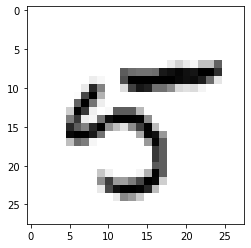

LABEL: 5
INPUT:


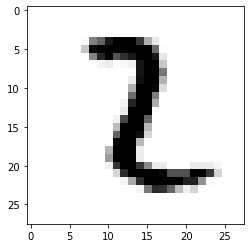

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


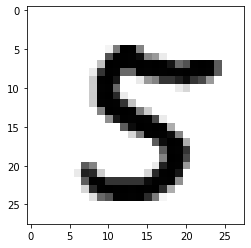

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


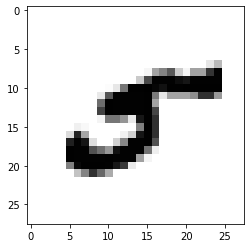

LABEL: 5
INPUT:


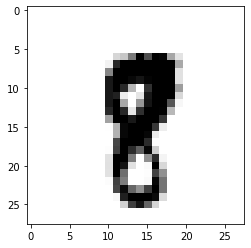

LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


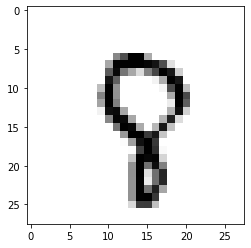

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


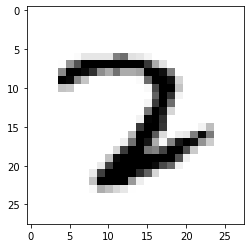

LABEL: 2
INPUT:


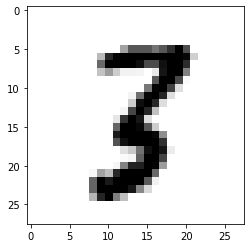

LABEL: 3
INPUT:


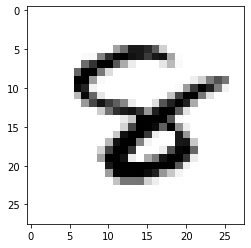

LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


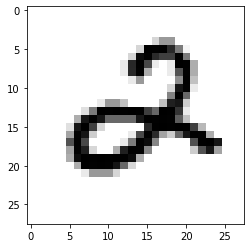

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


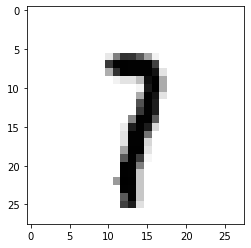

LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


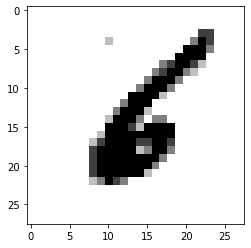

LABEL: 6
INPUT:


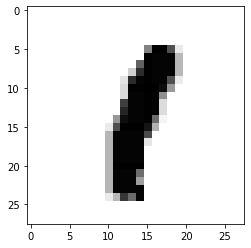

LABEL: 1
INPUT:


LABEL: 8
INPUT:


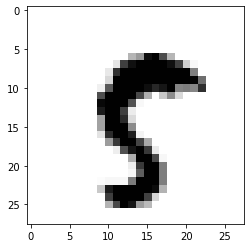

LABEL: 5
INPUT:


LABEL: 0
INPUT:


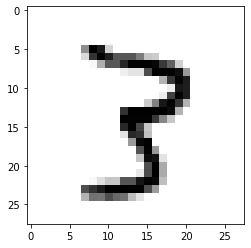

LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


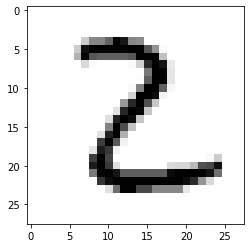

LABEL: 2
INPUT:


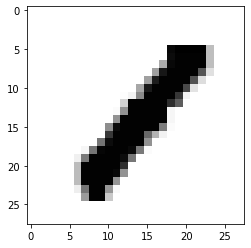

LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


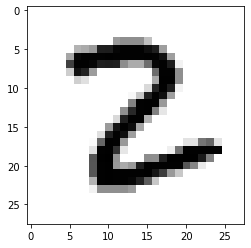

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


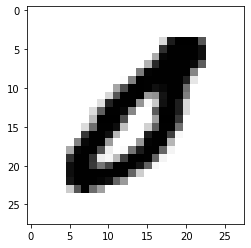

LABEL: 0
INPUT:


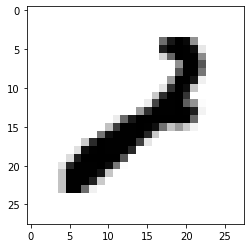

LABEL: 2
INPUT:


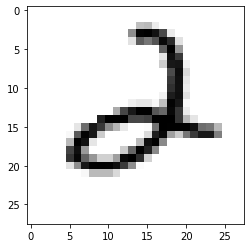

LABEL: 2
INPUT:


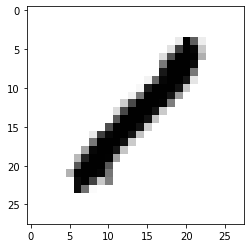

LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


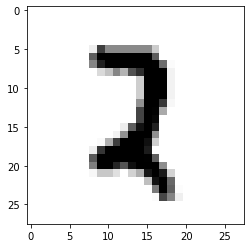

LABEL: 2
INPUT:


LABEL: 5
INPUT:


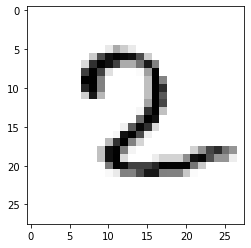

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


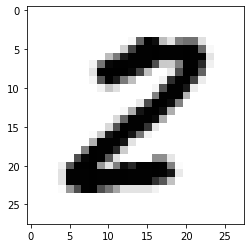

LABEL: 2
INPUT:


LABEL: 6
INPUT:


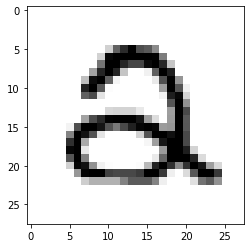

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


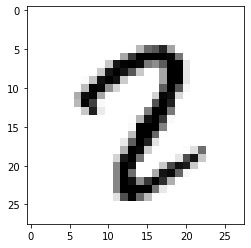

LABEL: 2
INPUT:


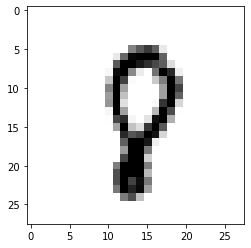

LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


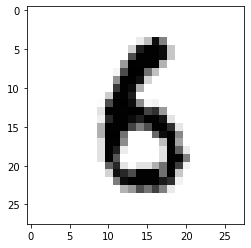

LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


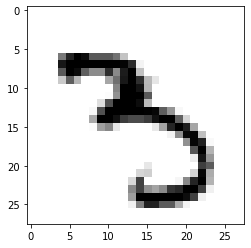

LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


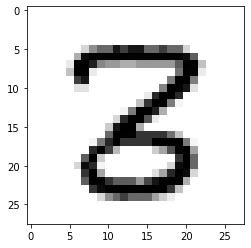

LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


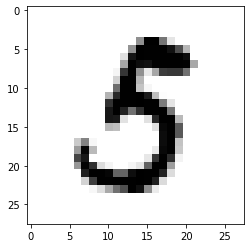

LABEL: 5
INPUT:


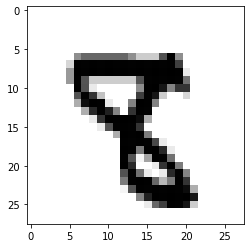

LABEL: 8
INPUT:


LABEL: 3
INPUT:


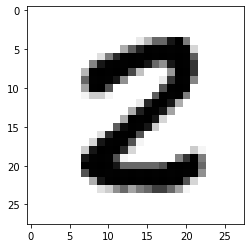

LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


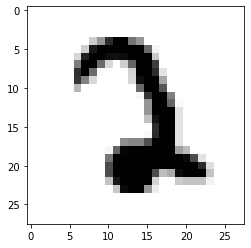

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


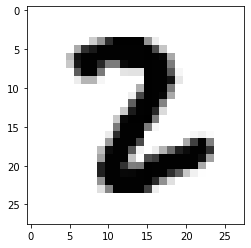

LABEL: 2
INPUT:


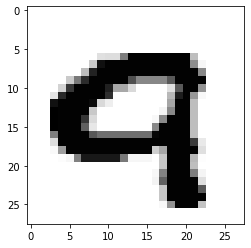

LABEL: 9
INPUT:


LABEL: 8
INPUT:


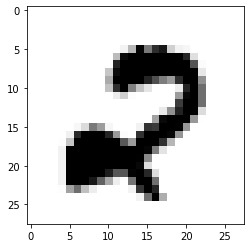

LABEL: 2
INPUT:


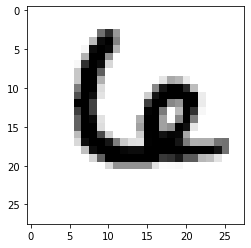

LABEL: 6
INPUT:


LABEL: 2
INPUT:


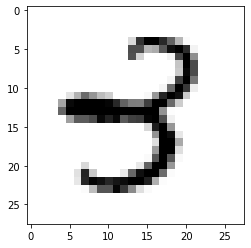

LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


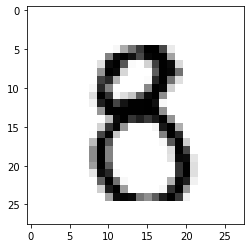

LABEL: 8
INPUT:


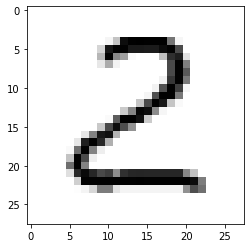

LABEL: 2
INPUT:


LABEL: 4
INPUT:


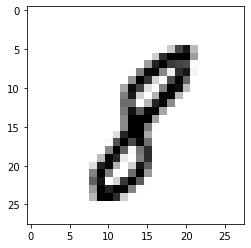

LABEL: 8
INPUT:


LABEL: 2
INPUT:


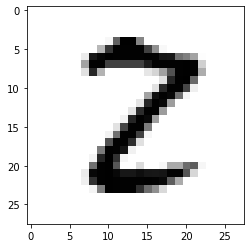

LABEL: 2
INPUT:


LABEL: 3
INPUT:


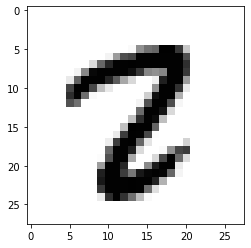

LABEL: 2
INPUT:


LABEL: 9
INPUT:


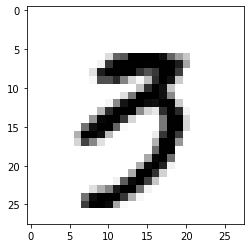

LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


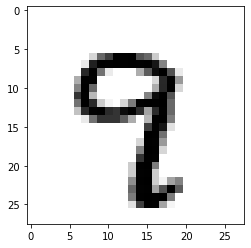

LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


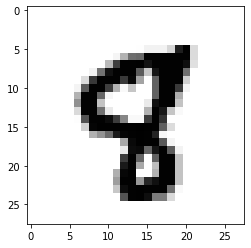

LABEL: 8
INPUT:


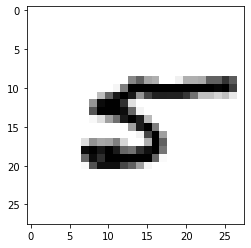

LABEL: 5
INPUT:


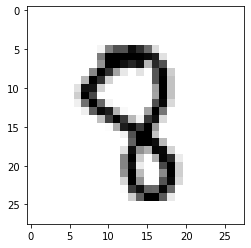

LABEL: 8
INPUT:


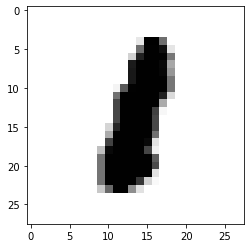

LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


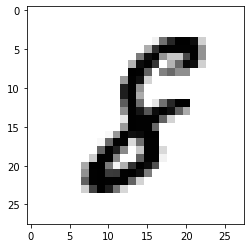

LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


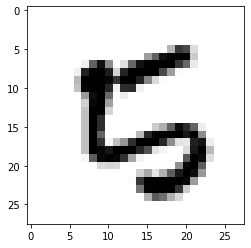

LABEL: 5
INPUT:


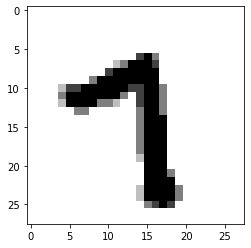

LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


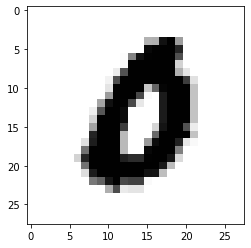

LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


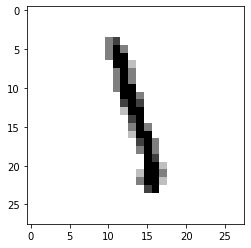

LABEL: 1
INPUT:


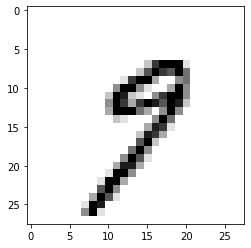

LABEL: 9
INPUT:


LABEL: 8
INPUT:


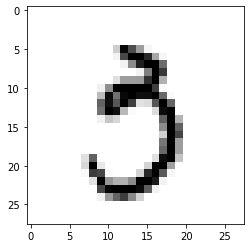

LABEL: 3
INPUT:


LABEL: 0
INPUT:


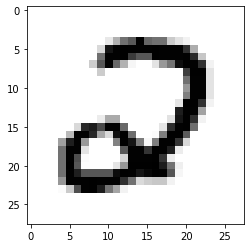

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


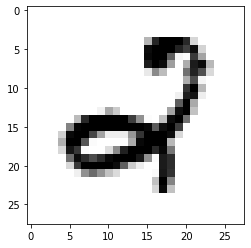

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


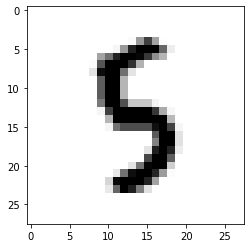

LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


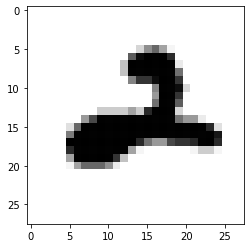

LABEL: 2
INPUT:


LABEL: 6
INPUT:


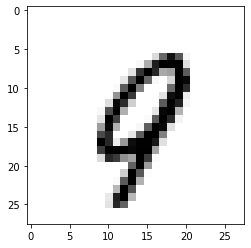

LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


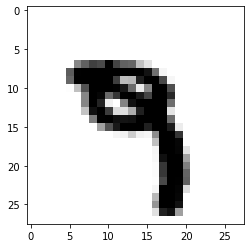

LABEL: 9
INPUT:


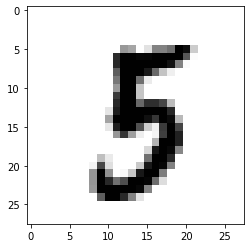

LABEL: 5
INPUT:


LABEL: 8
INPUT:


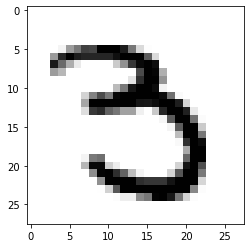

LABEL: 3
INPUT:


LABEL: 3
INPUT:


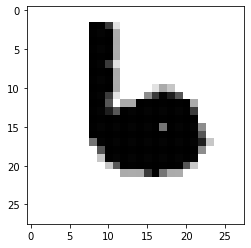

LABEL: 6
INPUT:


LABEL: 2
INPUT:


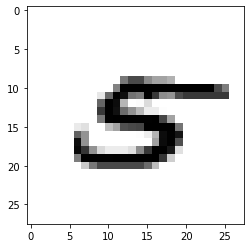

LABEL: 5
INPUT:


LABEL: 2
INPUT:


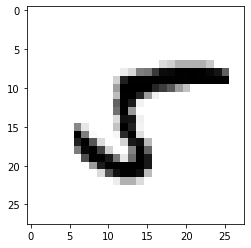

LABEL: 5
INPUT:


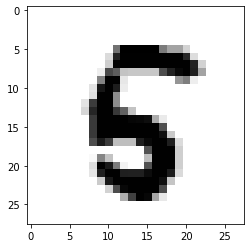

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


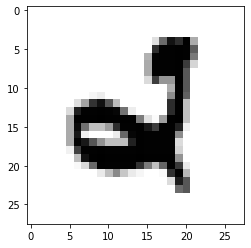

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


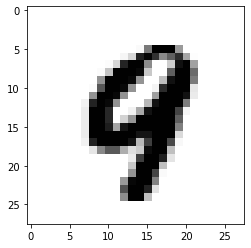

LABEL: 9
INPUT:


LABEL: 5
INPUT:


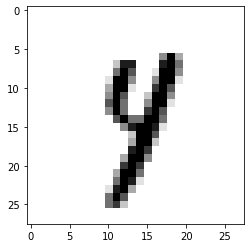

LABEL: 4
INPUT:


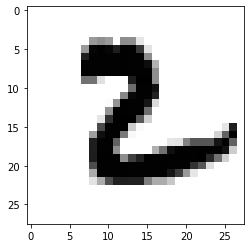

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


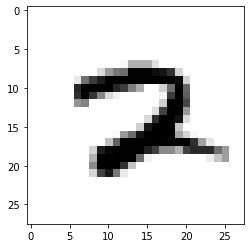

LABEL: 2
INPUT:


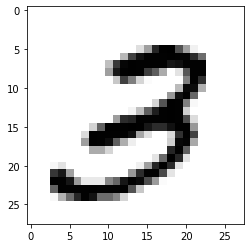

LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


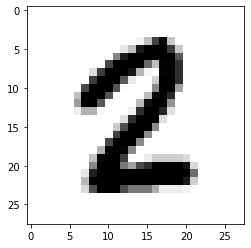

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


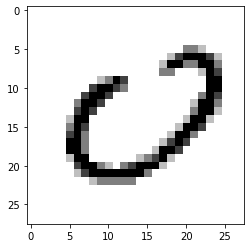

LABEL: 0
INPUT:


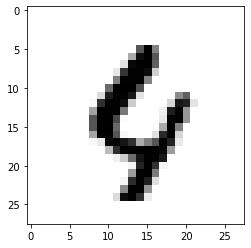

LABEL: 4
INPUT:


LABEL: 3
INPUT:


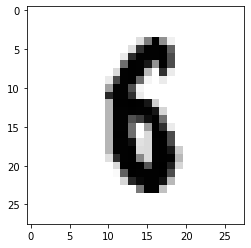

LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


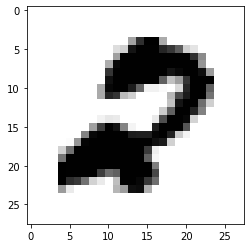

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


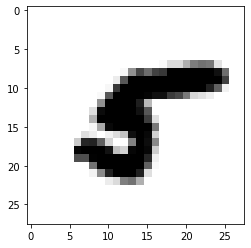

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


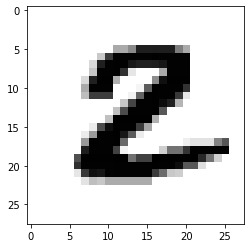

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


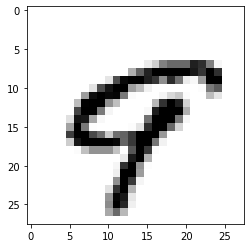

LABEL: 9
INPUT:


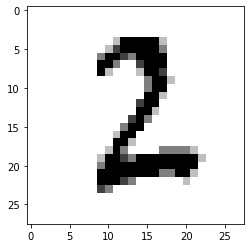

LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


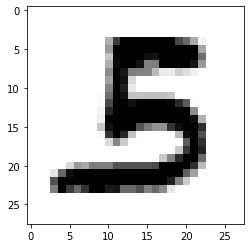

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


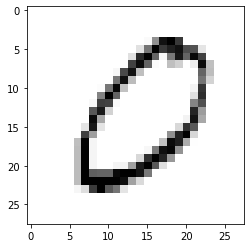

LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


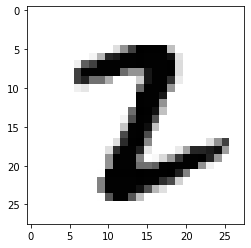

LABEL: 2
INPUT:


LABEL: 9
INPUT:


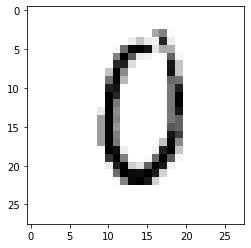

LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


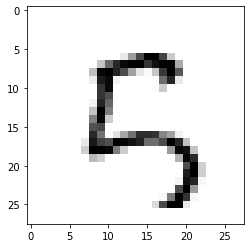

LABEL: 5
INPUT:


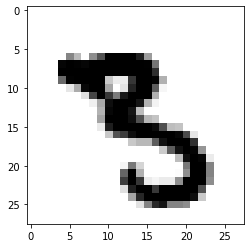

LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


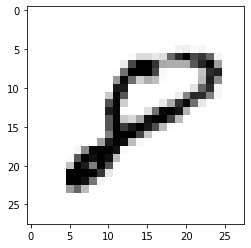

LABEL: 8
INPUT:


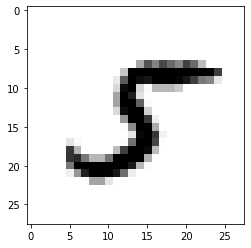

LABEL: 5
INPUT:


LABEL: 8
INPUT:


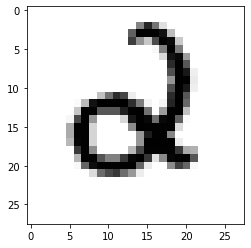

LABEL: 2
INPUT:


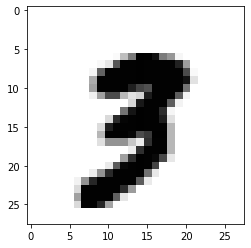

LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


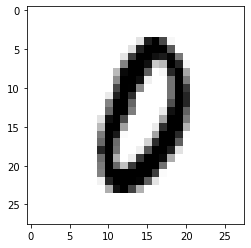

LABEL: 0
INPUT:


LABEL: 9
INPUT:


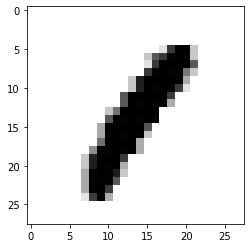

LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


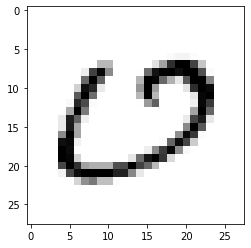

LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


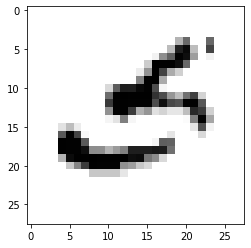

LABEL: 5
INPUT:


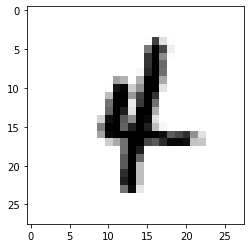

LABEL: 4
INPUT:


LABEL: 4
INPUT:


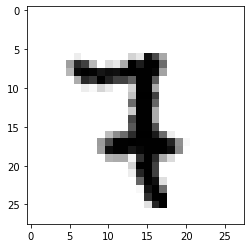

LABEL: 7
INPUT:


LABEL: 8
INPUT:


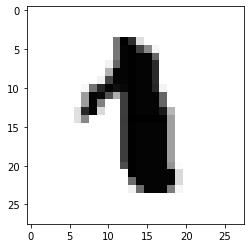

LABEL: 1
INPUT:


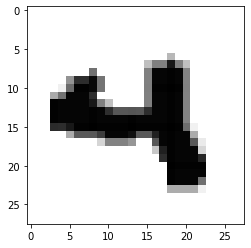

LABEL: 4
INPUT:


LABEL: 4
INPUT:


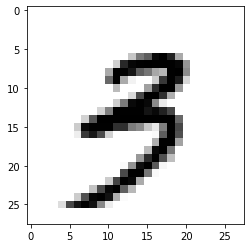

LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


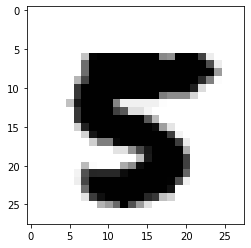

LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


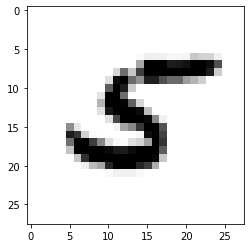

LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


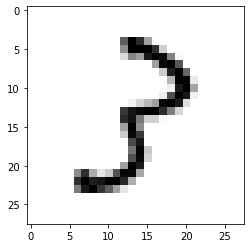

LABEL: 3
INPUT:


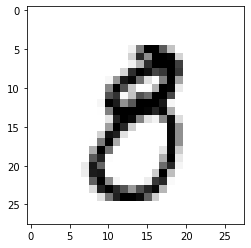

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


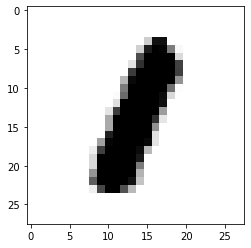

LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


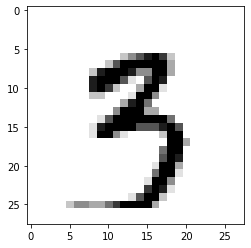

LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


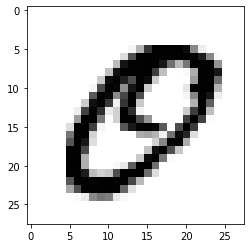

LABEL: 0
INPUT:


LABEL: 9
INPUT:


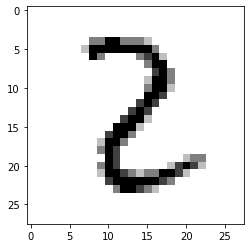

LABEL: 2
INPUT:


LABEL: 5
INPUT:


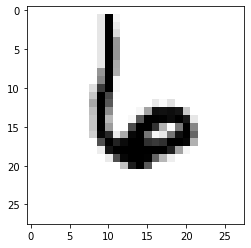

LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


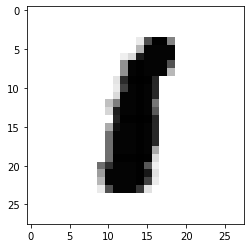

LABEL: 1
INPUT:


LABEL: 4
INPUT:


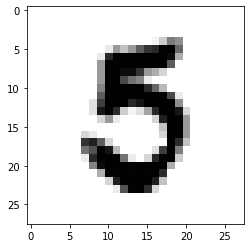

LABEL: 5
INPUT:


LABEL: 8
INPUT:


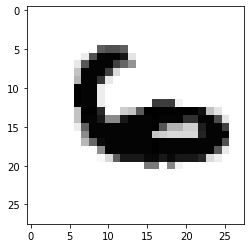

LABEL: 6
INPUT:


LABEL: 7
INPUT:


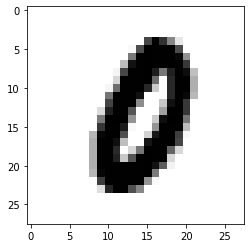

LABEL: 0
INPUT:


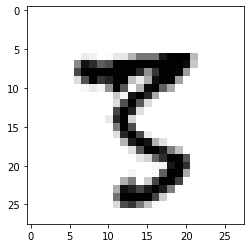

LABEL: 3
INPUT:


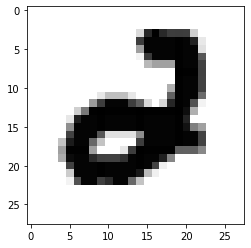

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


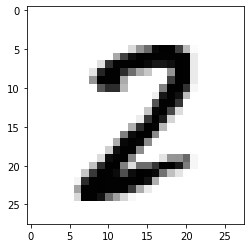

LABEL: 2
INPUT:


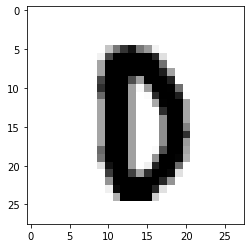

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


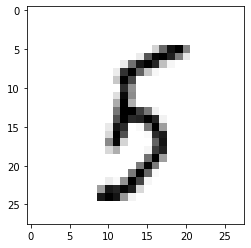

LABEL: 5
INPUT:


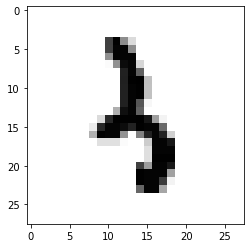

LABEL: 3
INPUT:


LABEL: 4
INPUT:


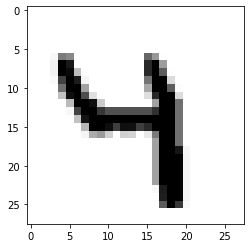

LABEL: 4
INPUT:


LABEL: 8
INPUT:


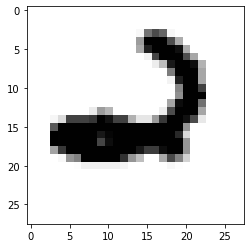

LABEL: 2
INPUT:


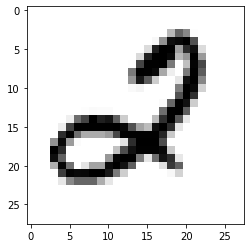

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


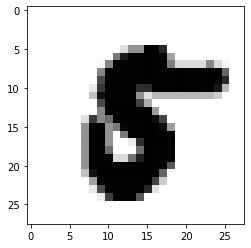

LABEL: 5
INPUT:


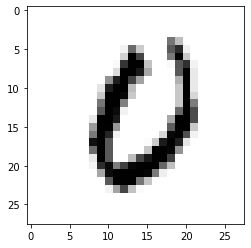

LABEL: 0
INPUT:


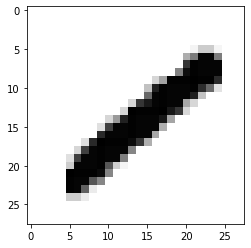

LABEL: 1
INPUT:


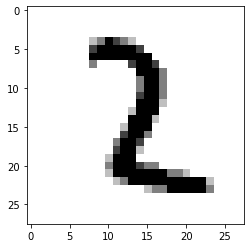

LABEL: 2
INPUT:


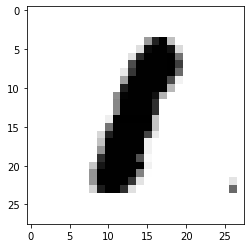

LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


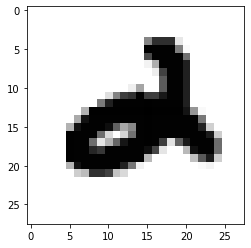

LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


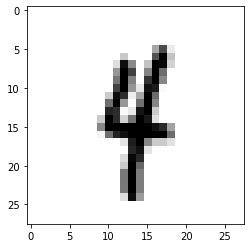

LABEL: 4
INPUT:


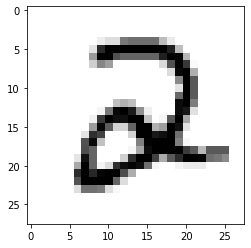

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


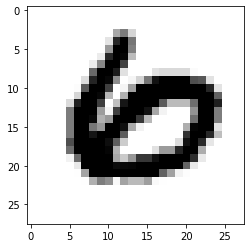

LABEL: 6
INPUT:


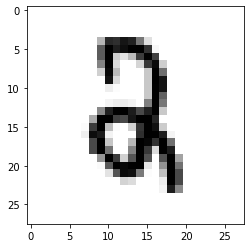

LABEL: 2
INPUT:


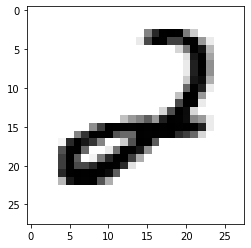

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


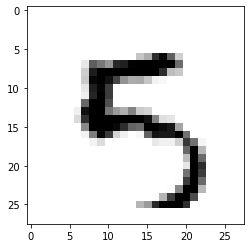

LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


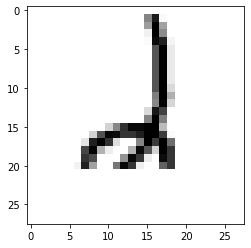

LABEL: 2
INPUT:


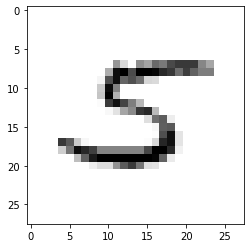

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


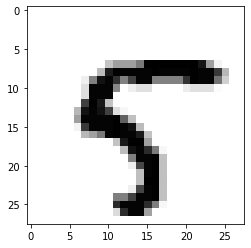

LABEL: 5
INPUT:


LABEL: 7
INPUT:


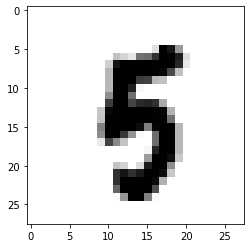

LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


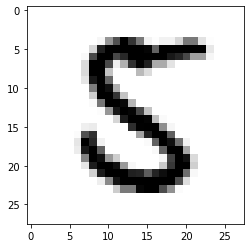

LABEL: 5
INPUT:


LABEL: 8
INPUT:


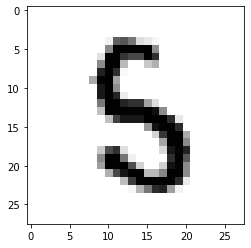

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


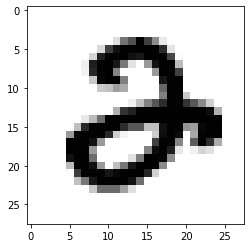

LABEL: 2
INPUT:


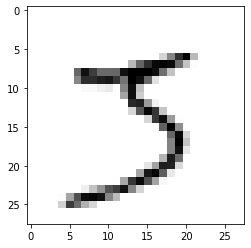

LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


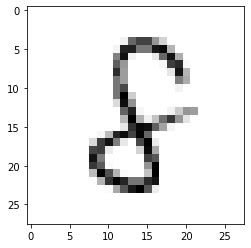

LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


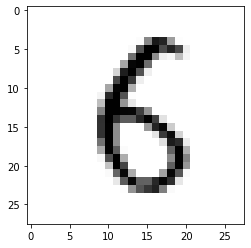

LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


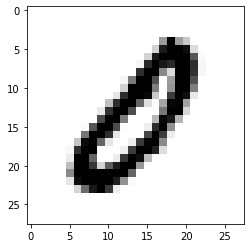

LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


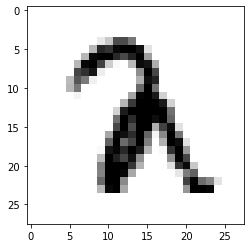

LABEL: 2
INPUT:


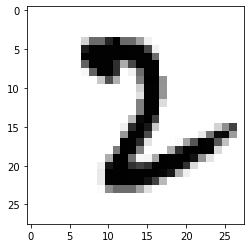

LABEL: 2
INPUT:


LABEL: 0
INPUT:


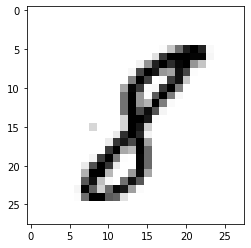

LABEL: 8
INPUT:


LABEL: 0
INPUT:


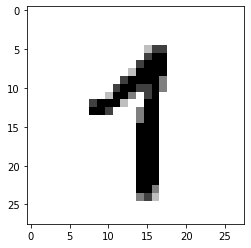

LABEL: 1
INPUT:


LABEL: 3
INPUT:


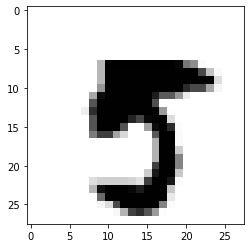

LABEL: 5
INPUT:


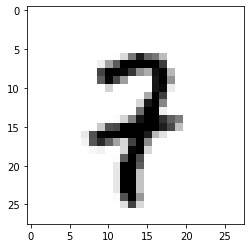

LABEL: 7
INPUT:


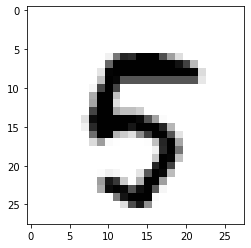

LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


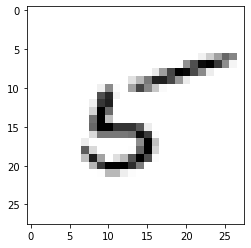

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


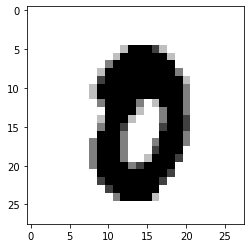

LABEL: 0
INPUT:


LABEL: 8
INPUT:


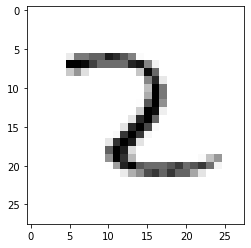

LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


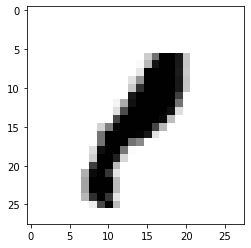

LABEL: 1
INPUT:


LABEL: 4
INPUT:


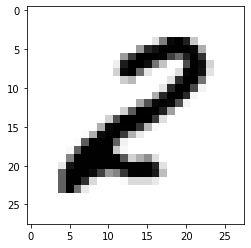

LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


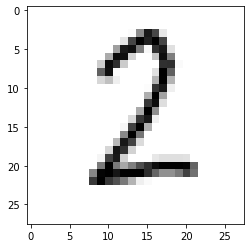

LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


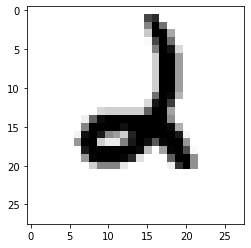

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


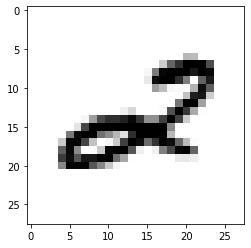

LABEL: 2
INPUT:


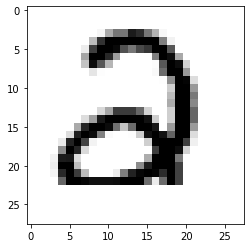

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


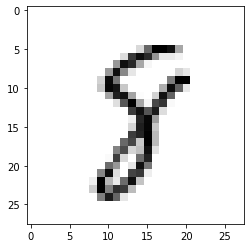

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


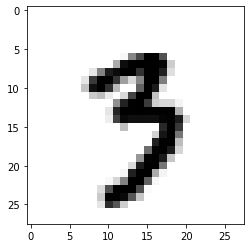

LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


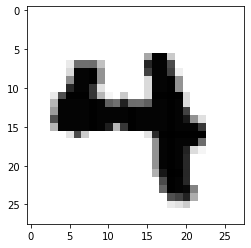

LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


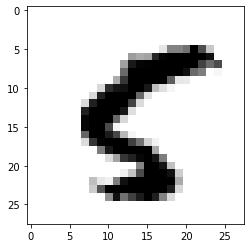

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


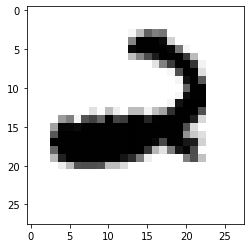

LABEL: 2
INPUT:


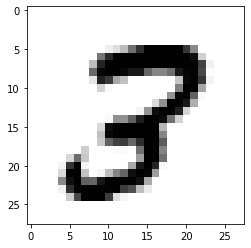

LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


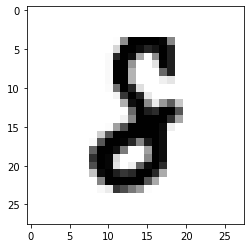

LABEL: 8
INPUT:


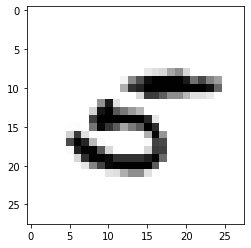

LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


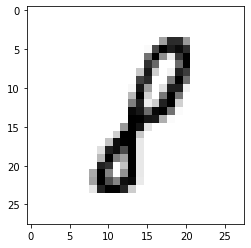

LABEL: 8
INPUT:


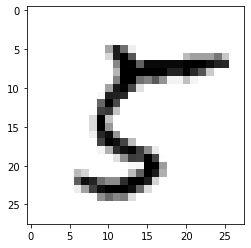

LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


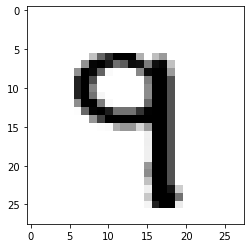

LABEL: 9
INPUT:


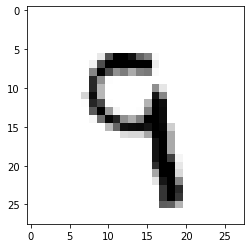

LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


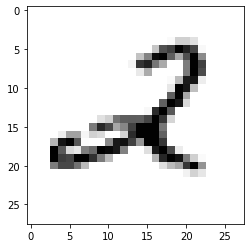

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


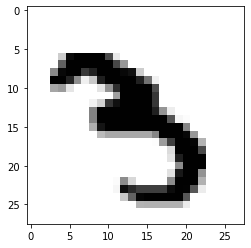

LABEL: 3
INPUT:


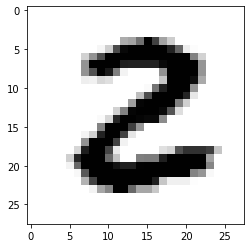

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


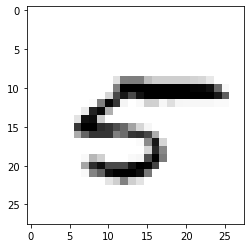

LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


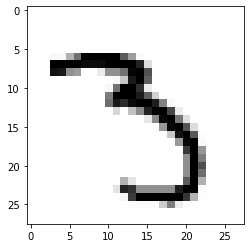

LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


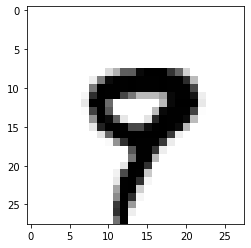

LABEL: 9
INPUT:


LABEL: 3
INPUT:


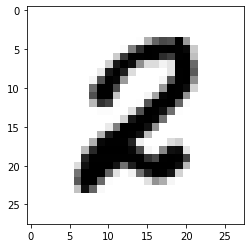

LABEL: 2
INPUT:


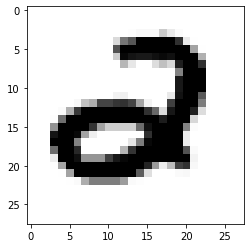

LABEL: 2
INPUT:


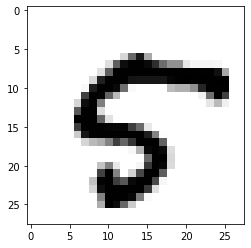

LABEL: 5
INPUT:


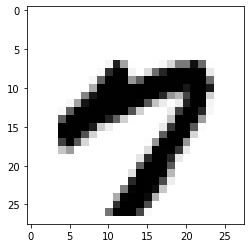

LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


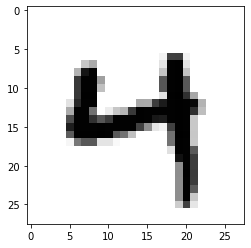

LABEL: 4
INPUT:


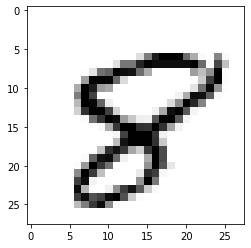

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


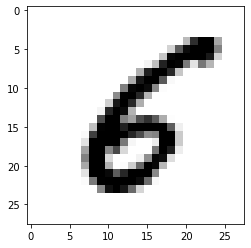

LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


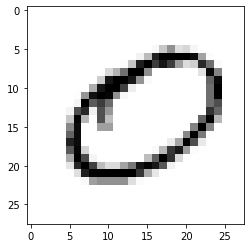

LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


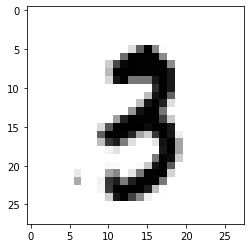

LABEL: 3
INPUT:


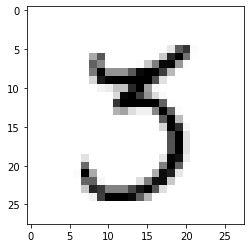

LABEL: 3
INPUT:


LABEL: 8
INPUT:


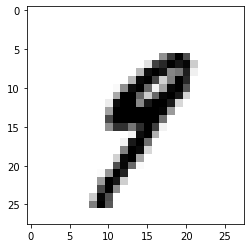

LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


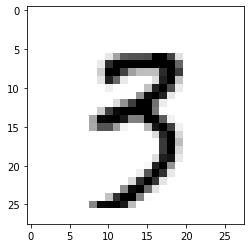

LABEL: 3
INPUT:


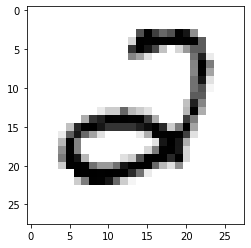

LABEL: 2
INPUT:


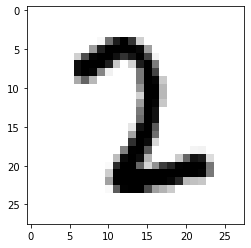

LABEL: 2
INPUT:


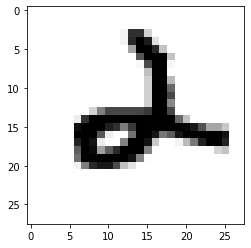

LABEL: 2
INPUT:


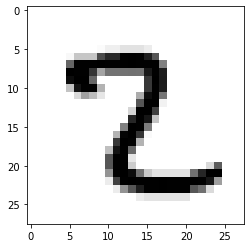

LABEL: 2
INPUT:


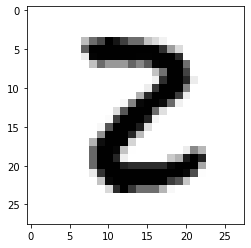

LABEL: 2
INPUT:


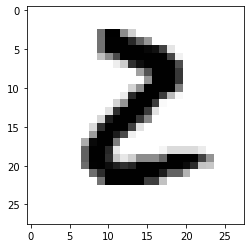

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


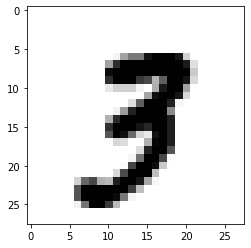

LABEL: 3
INPUT:


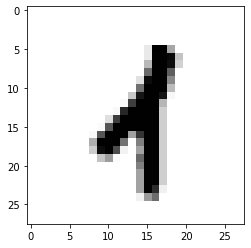

LABEL: 1
INPUT:


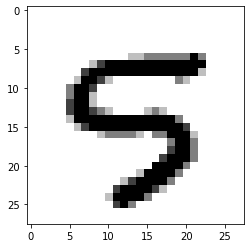

LABEL: 5
INPUT:


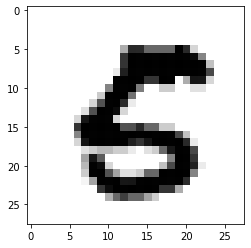

LABEL: 5
INPUT:


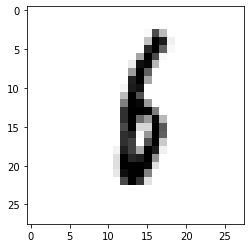

LABEL: 6
INPUT:


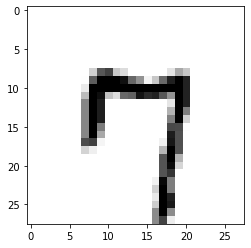

LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


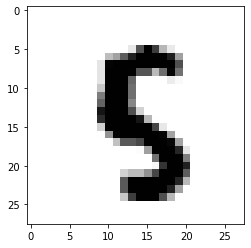

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


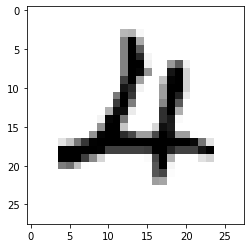

LABEL: 4
INPUT:


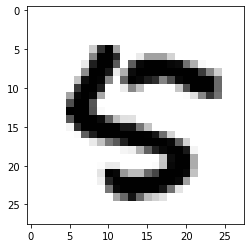

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


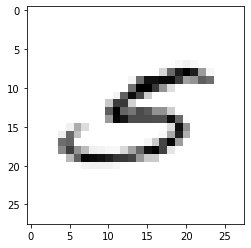

LABEL: 5
INPUT:


LABEL: 6
INPUT:


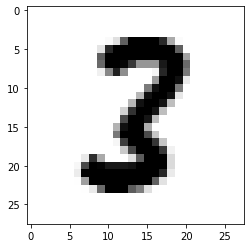

LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


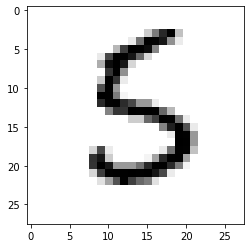

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


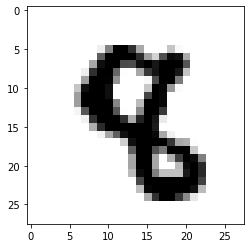

LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


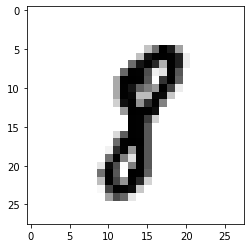

LABEL: 8
INPUT:


LABEL: 8
INPUT:


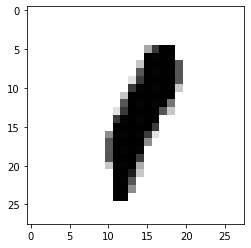

LABEL: 1
INPUT:


LABEL: 7
INPUT:


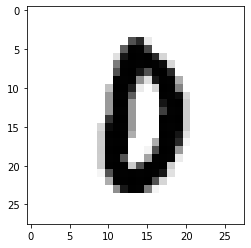

LABEL: 0
INPUT:


LABEL: 3
INPUT:


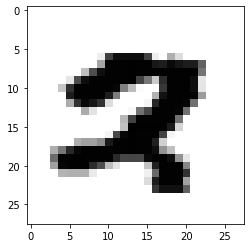

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


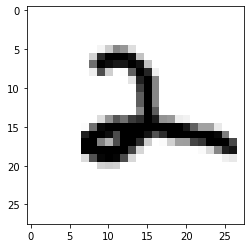

LABEL: 2
INPUT:


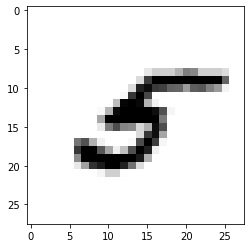

LABEL: 5
INPUT:


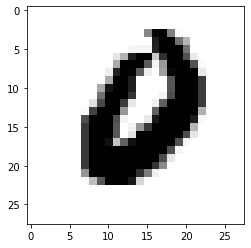

LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


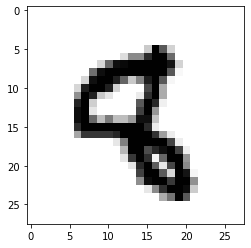

LABEL: 8
INPUT:


LABEL: 2
INPUT:


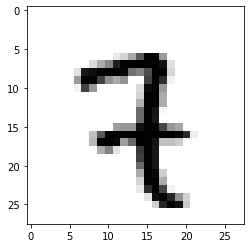

LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


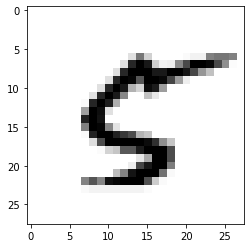

LABEL: 5
INPUT:


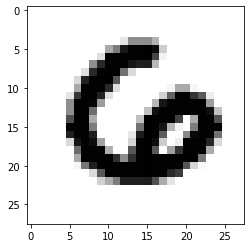

LABEL: 6
INPUT:


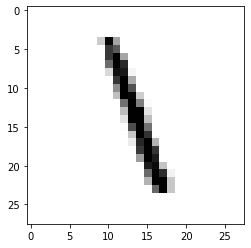

LABEL: 1
INPUT:


LABEL: 5
INPUT:


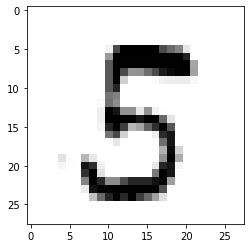

LABEL: 5
INPUT:


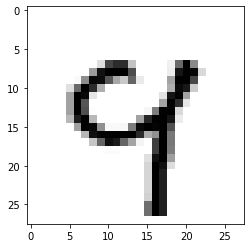

LABEL: 9
INPUT:


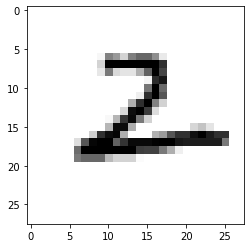

LABEL: 2
INPUT:


LABEL: 4
INPUT:


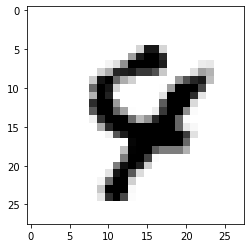

LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


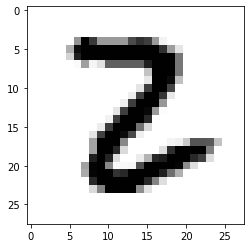

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


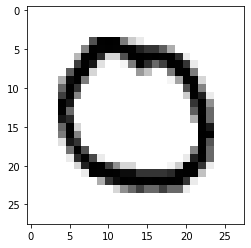

LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


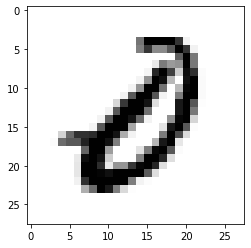

LABEL: 0
INPUT:


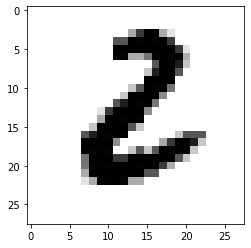

LABEL: 2
INPUT:


LABEL: 6
INPUT:


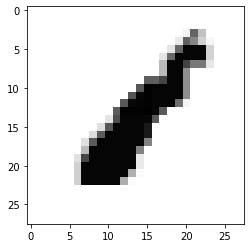

LABEL: 1
INPUT:


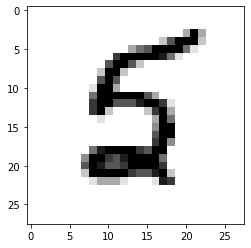

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


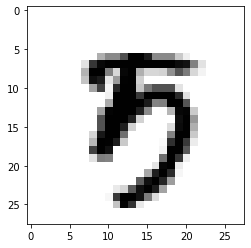

LABEL: 5
INPUT:


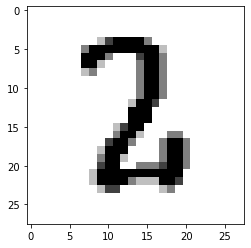

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


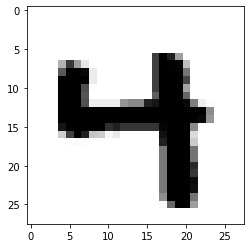

LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


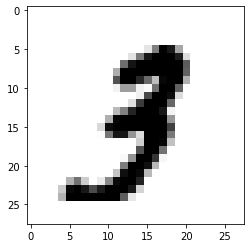

LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


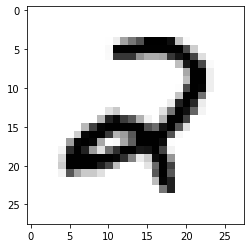

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


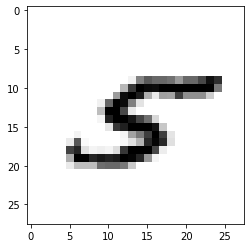

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


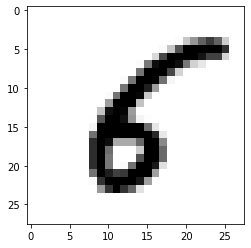

LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


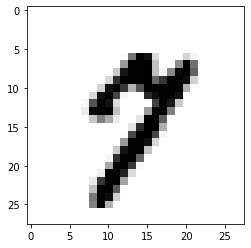

LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


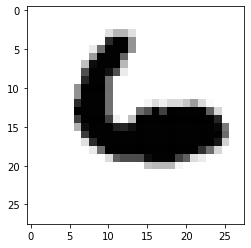

LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


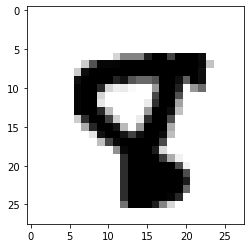

LABEL: 8
INPUT:


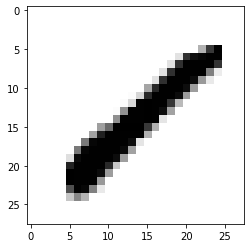

LABEL: 1
INPUT:


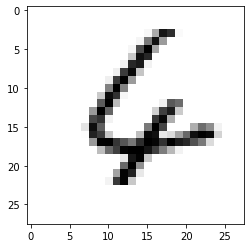

LABEL: 4
INPUT:


LABEL: 6
INPUT:


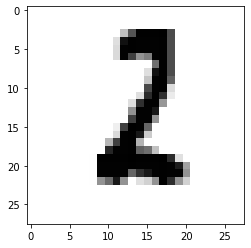

LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


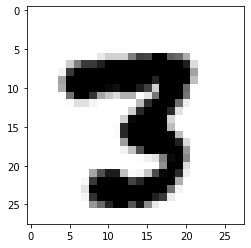

LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


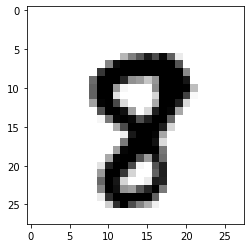

LABEL: 8
INPUT:


LABEL: 5
INPUT:


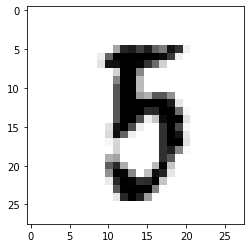

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


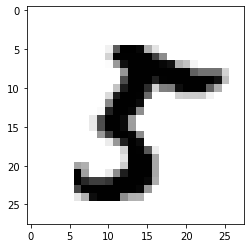

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


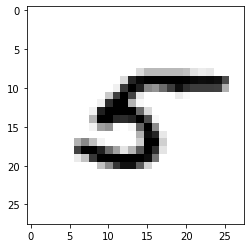

LABEL: 5
INPUT:


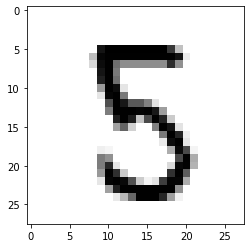

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


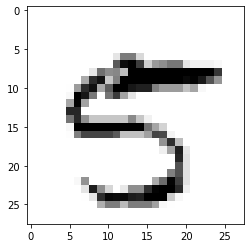

LABEL: 5
INPUT:


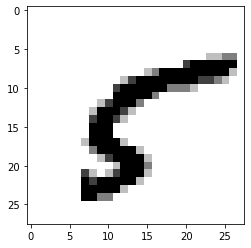

LABEL: 5
INPUT:


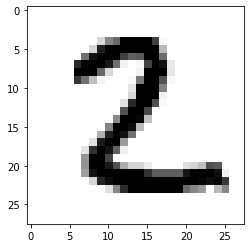

LABEL: 2
INPUT:


LABEL: 4
INPUT:


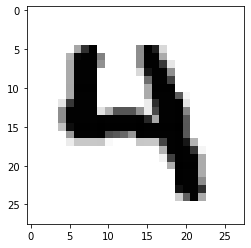

LABEL: 4
INPUT:


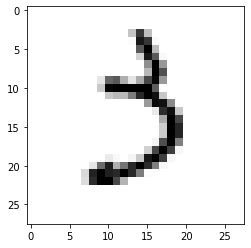

LABEL: 3
INPUT:


LABEL: 8
INPUT:


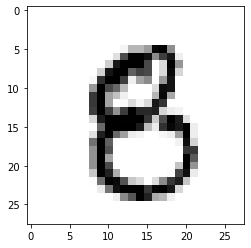

LABEL: 8
INPUT:


LABEL: 1
INPUT:


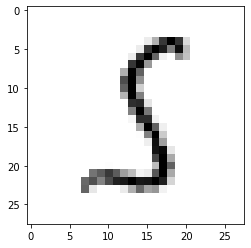

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


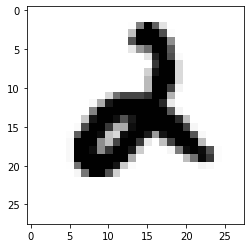

LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


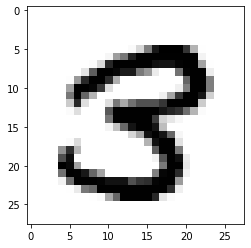

LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


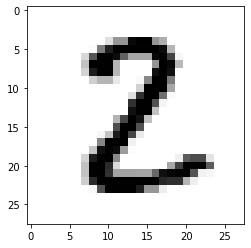

LABEL: 2
INPUT:


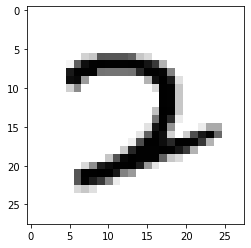

LABEL: 2
INPUT:


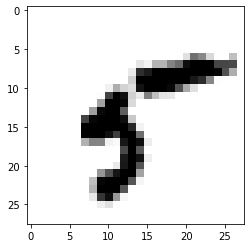

LABEL: 5
INPUT:


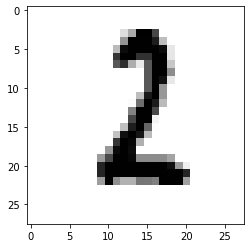

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


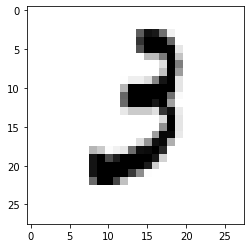

LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


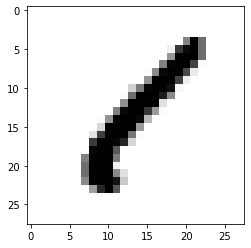

LABEL: 1
INPUT:


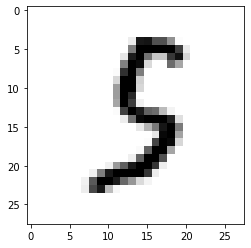

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


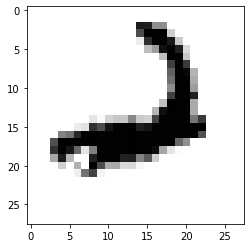

LABEL: 2
INPUT:


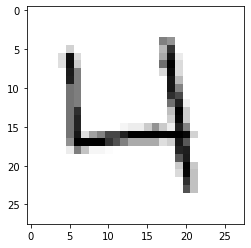

LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


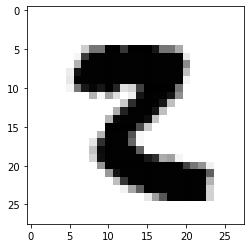

LABEL: 2
INPUT:


LABEL: 2
INPUT:


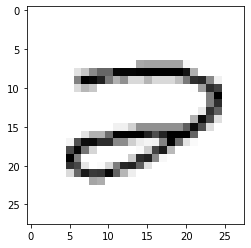

LABEL: 2
INPUT:


LABEL: 8
INPUT:


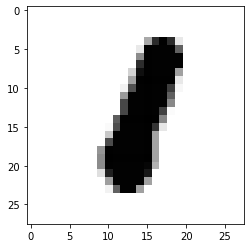

LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


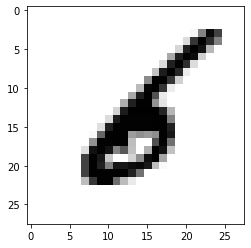

LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


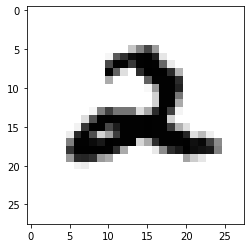

LABEL: 2
INPUT:


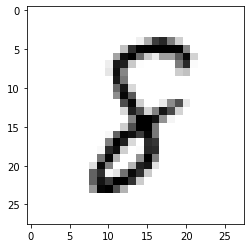

LABEL: 8
INPUT:


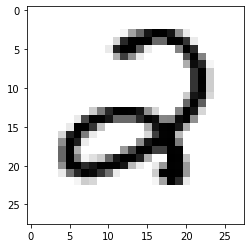

LABEL: 2
INPUT:


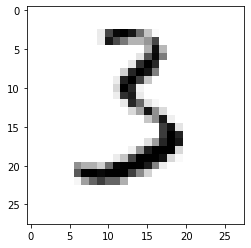

LABEL: 3
INPUT:


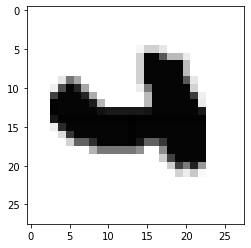

LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


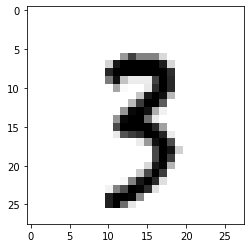

LABEL: 3
INPUT:


LABEL: 2
INPUT:


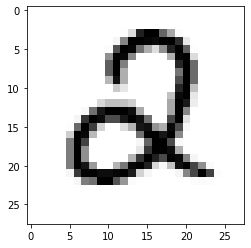

LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


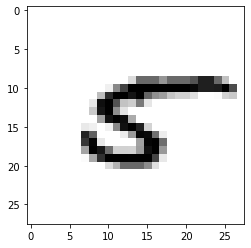

LABEL: 5
INPUT:


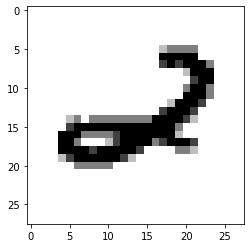

LABEL: 2
INPUT:


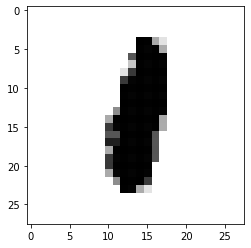

LABEL: 1
INPUT:


LABEL: 8
INPUT:


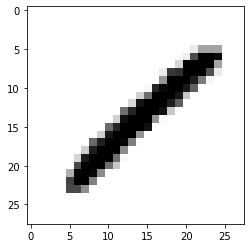

LABEL: 1
INPUT:


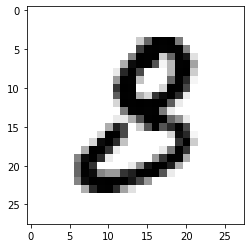

LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


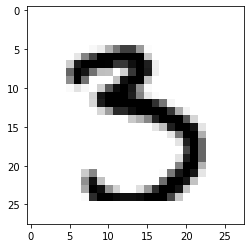

LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


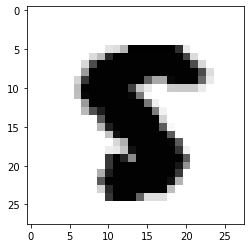

LABEL: 5
INPUT:


LABEL: 4
INPUT:


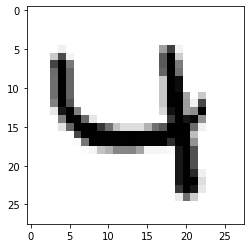

LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


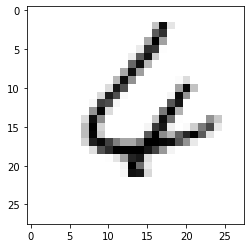

LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


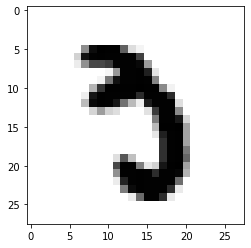

LABEL: 3
INPUT:


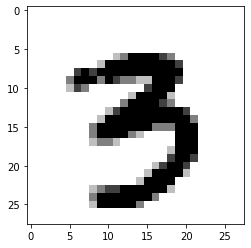

LABEL: 3
INPUT:


LABEL: 2
INPUT:


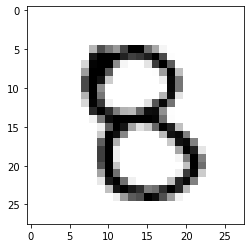

LABEL: 8
INPUT:


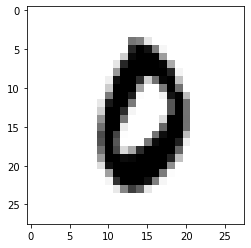

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


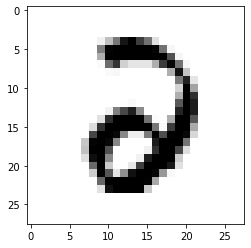

LABEL: 2
INPUT:


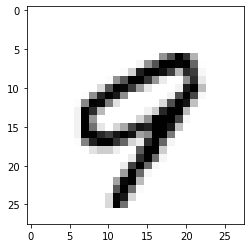

LABEL: 9
INPUT:


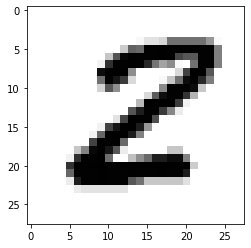

LABEL: 2
INPUT:


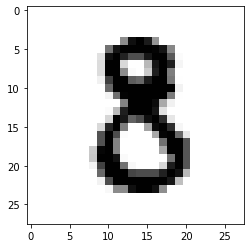

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


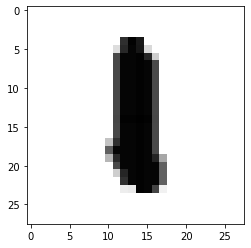

LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


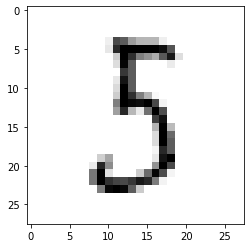

LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


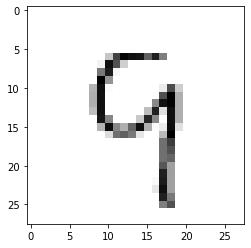

LABEL: 9
INPUT:


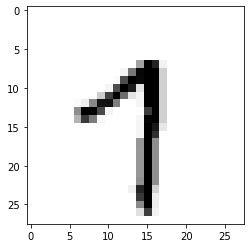

LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


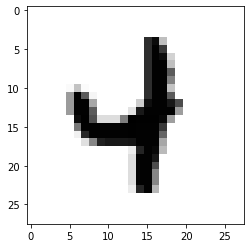

LABEL: 4
INPUT:


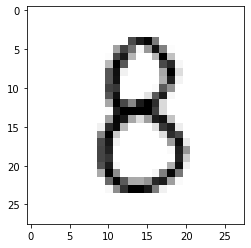

LABEL: 8
INPUT:


LABEL: 9
INPUT:


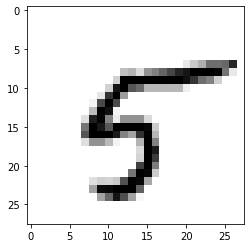

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


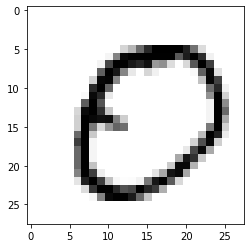

LABEL: 0
INPUT:


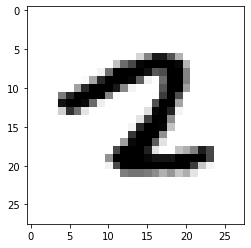

LABEL: 2
INPUT:


LABEL: 7
INPUT:


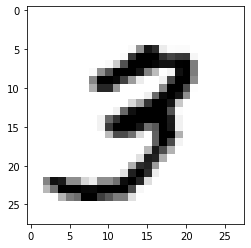

LABEL: 3
INPUT:


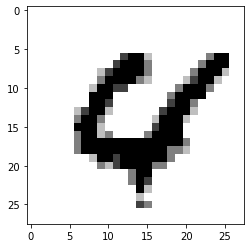

LABEL: 4
INPUT:


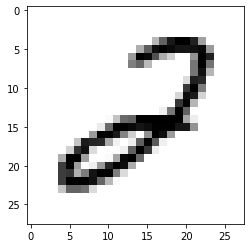

LABEL: 2
INPUT:


LABEL: 5
INPUT:


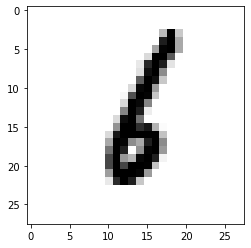

LABEL: 6
INPUT:


LABEL: 5
INPUT:


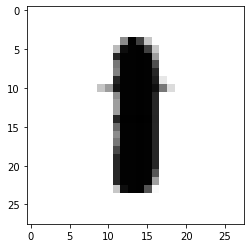

LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


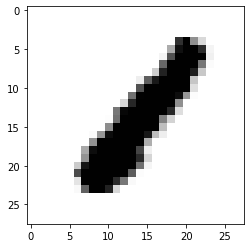

LABEL: 1
INPUT:


LABEL: 2
INPUT:


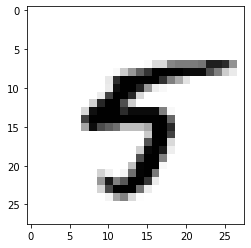

LABEL: 5
INPUT:


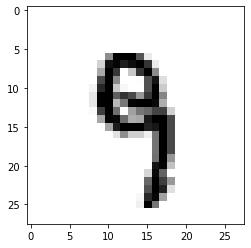

LABEL: 9
INPUT:


LABEL: 8
INPUT:


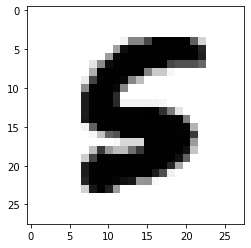

LABEL: 5
INPUT:


LABEL: 2
INPUT:


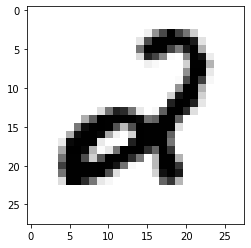

LABEL: 2
INPUT:


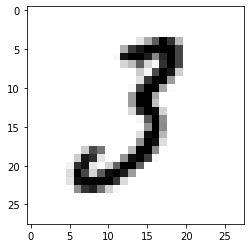

LABEL: 3
INPUT:


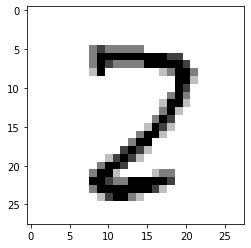

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


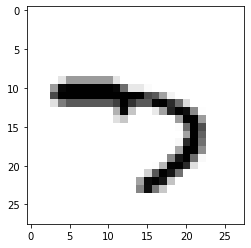

LABEL: 7
INPUT:


LABEL: 6
INPUT:


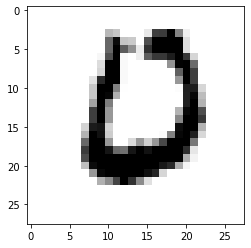

LABEL: 0
INPUT:


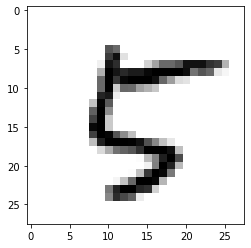

LABEL: 5
INPUT:


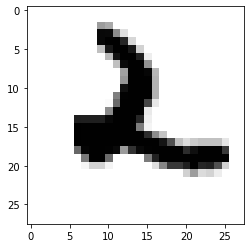

LABEL: 2
INPUT:


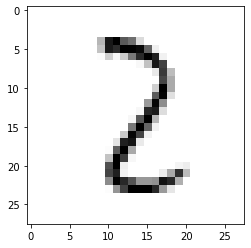

LABEL: 2
INPUT:


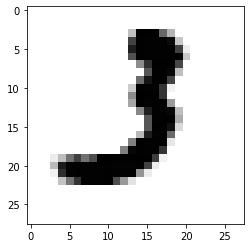

LABEL: 3
INPUT:


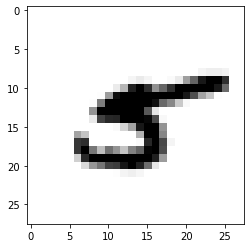

LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


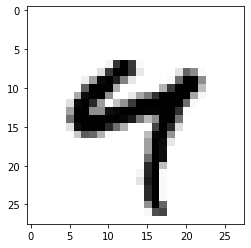

LABEL: 4
INPUT:


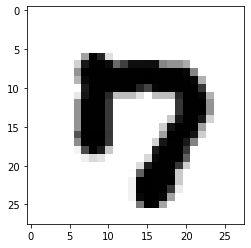

LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


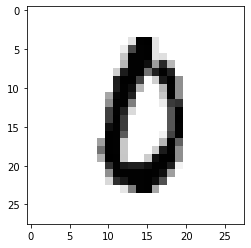

LABEL: 0
INPUT:


LABEL: 2
INPUT:


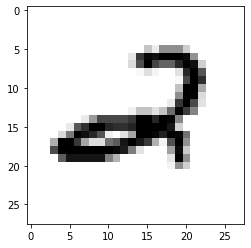

LABEL: 2
INPUT:


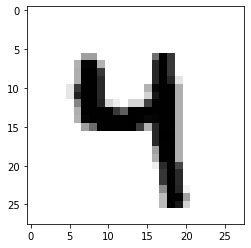

LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


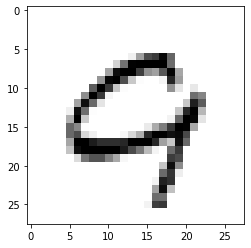

LABEL: 9
INPUT:


LABEL: 2
INPUT:


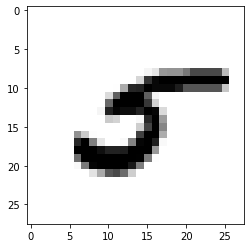

LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


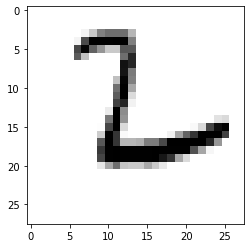

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


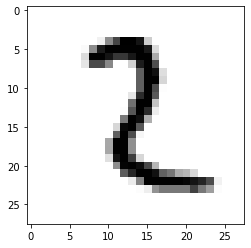

LABEL: 2
INPUT:


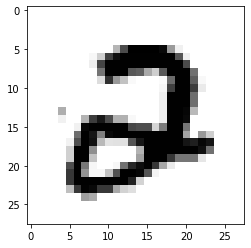

LABEL: 2
INPUT:


LABEL: 2
INPUT:


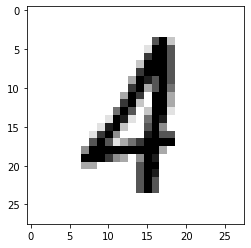

LABEL: 4
INPUT:


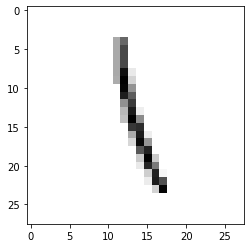

LABEL: 1
INPUT:


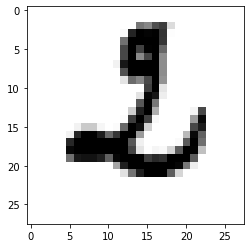

LABEL: 2
INPUT:


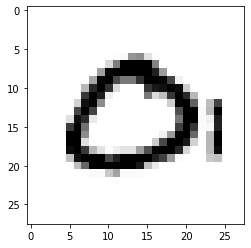

LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


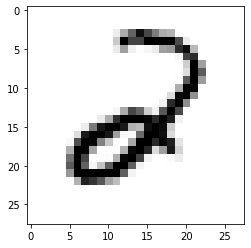

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


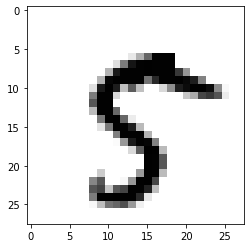

LABEL: 5
INPUT:


LABEL: 3
INPUT:


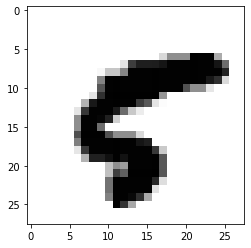

LABEL: 5
INPUT:


LABEL: 6
INPUT:


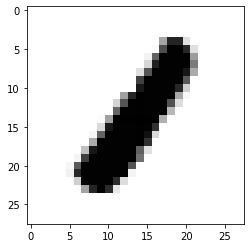

LABEL: 1
INPUT:


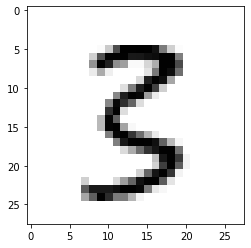

LABEL: 3
INPUT:


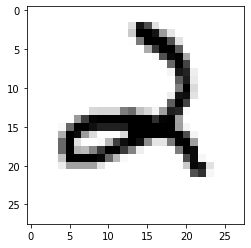

LABEL: 2
INPUT:


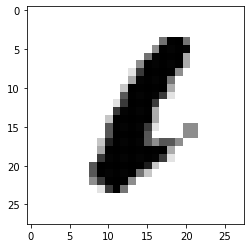

LABEL: 1
INPUT:


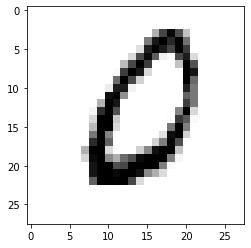

LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


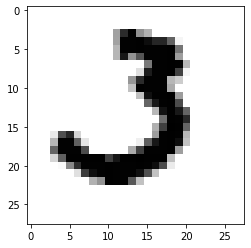

LABEL: 3
INPUT:


LABEL: 3
INPUT:


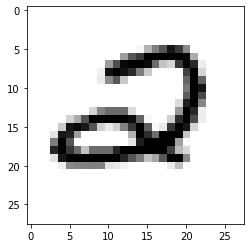

LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


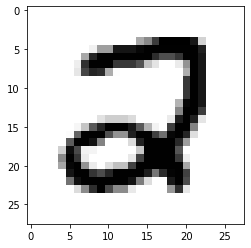

LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


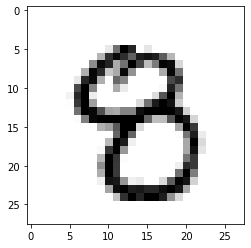

LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


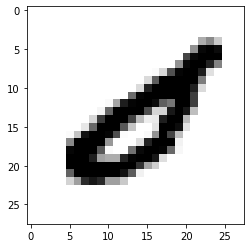

LABEL: 0
INPUT:


LABEL: 5
INPUT:


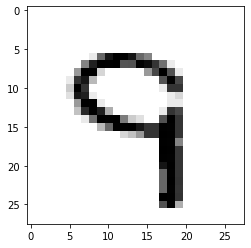

LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


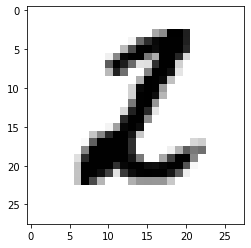

LABEL: 2
INPUT:


LABEL: 8
INPUT:


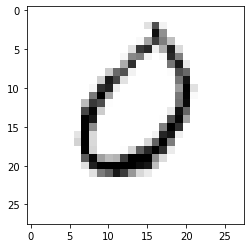

LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


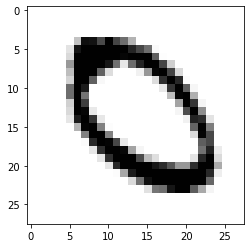

LABEL: 0
INPUT:


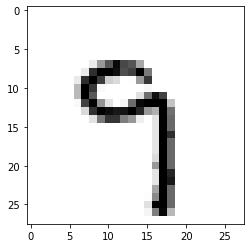

LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


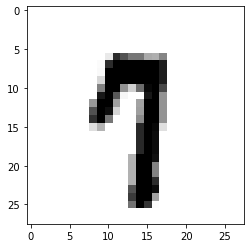

LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


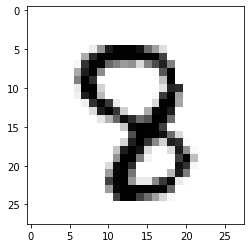

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


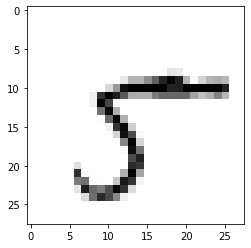

LABEL: 5
INPUT:


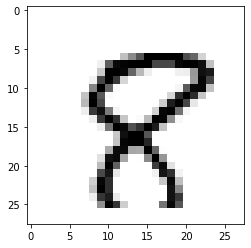

LABEL: 8
INPUT:


LABEL: 9
INPUT:


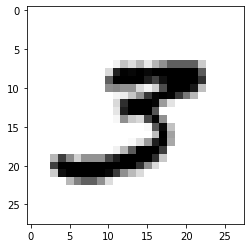

LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


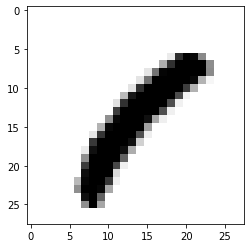

LABEL: 1
INPUT:


LABEL: 5
INPUT:


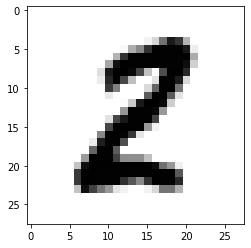

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


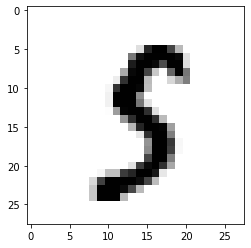

LABEL: 5
INPUT:


LABEL: 2
INPUT:


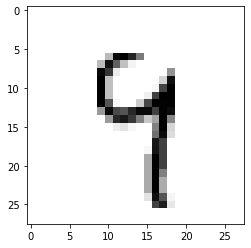

LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


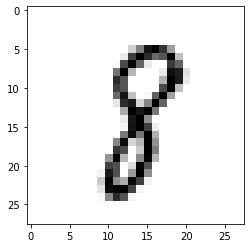

LABEL: 8
INPUT:


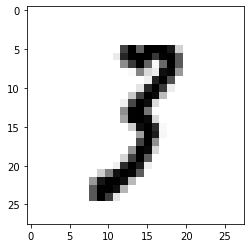

LABEL: 3
INPUT:


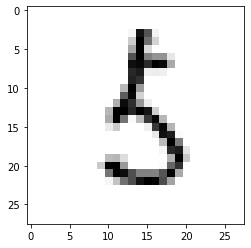

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


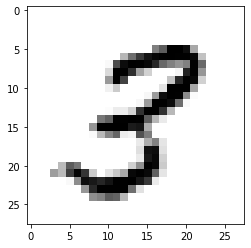

LABEL: 3
INPUT:


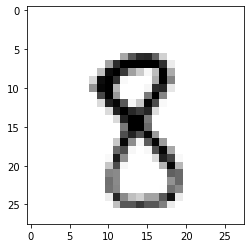

LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


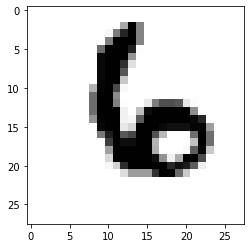

LABEL: 6
INPUT:


LABEL: 7
INPUT:


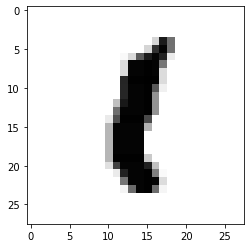

LABEL: 1
INPUT:


LABEL: 4
INPUT:


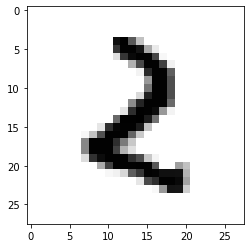

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


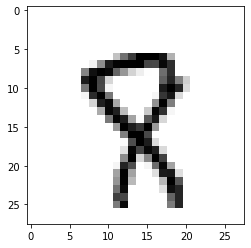

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


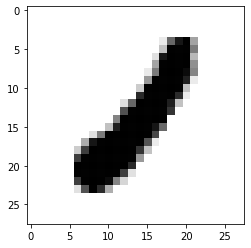

LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


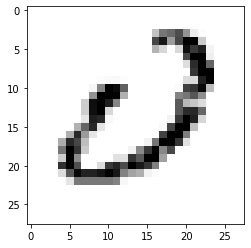

LABEL: 0
INPUT:


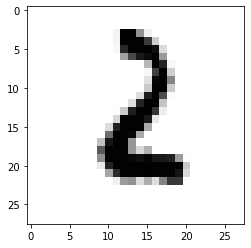

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


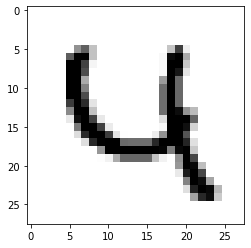

LABEL: 4
INPUT:


LABEL: 9
INPUT:


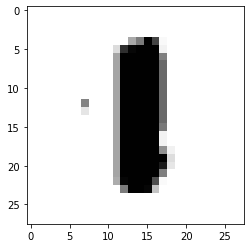

LABEL: 1
INPUT:


LABEL: 7
INPUT:


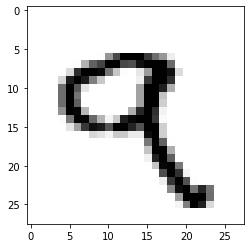

LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


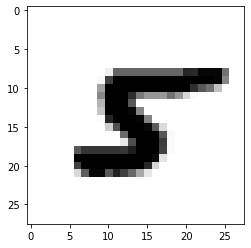

LABEL: 5
INPUT:


LABEL: 0
INPUT:


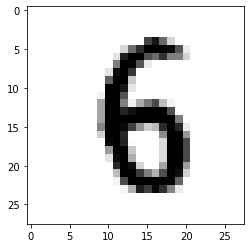

LABEL: 6
INPUT:


LABEL: 4
INPUT:


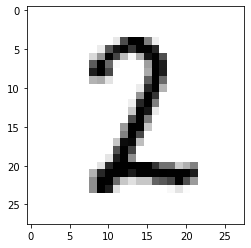

LABEL: 2
INPUT:


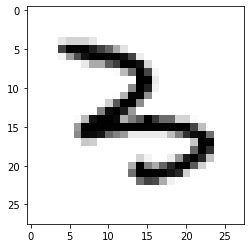

LABEL: 3
INPUT:


LABEL: 9
INPUT:


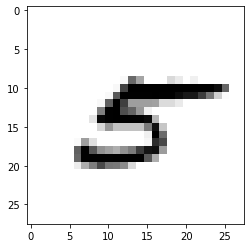

LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


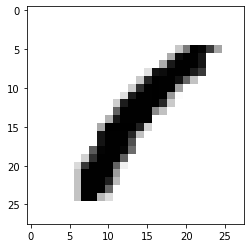

LABEL: 1
INPUT:


LABEL: 2
INPUT:


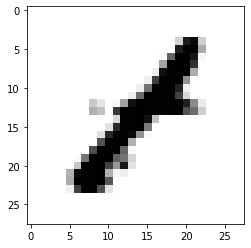

LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


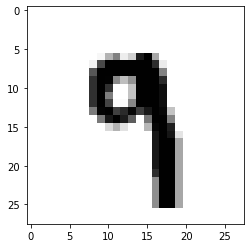

LABEL: 9
INPUT:


LABEL: 4
INPUT:


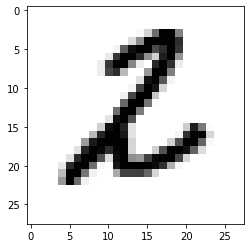

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


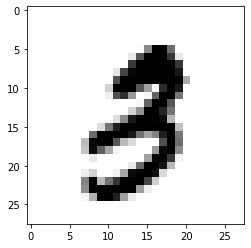

LABEL: 3
INPUT:


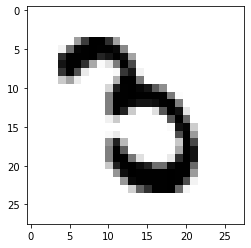

LABEL: 3
INPUT:


LABEL: 3
INPUT:


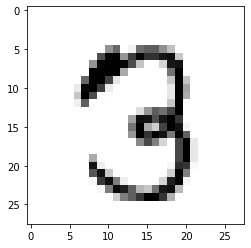

LABEL: 3
INPUT:


LABEL: 8
INPUT:


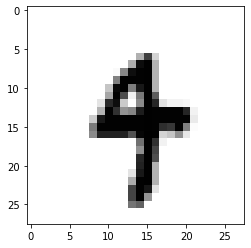

LABEL: 4
INPUT:


LABEL: 2
INPUT:


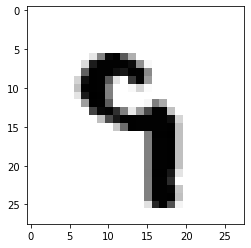

LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


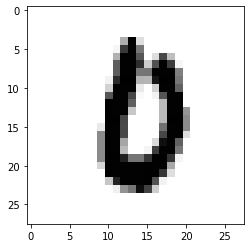

LABEL: 0
INPUT:


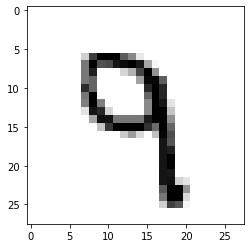

LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


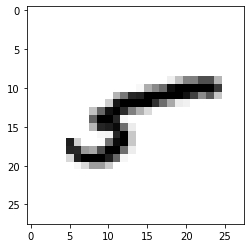

LABEL: 5
INPUT:


LABEL: 5
INPUT:


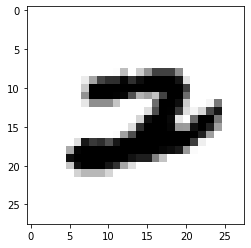

LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


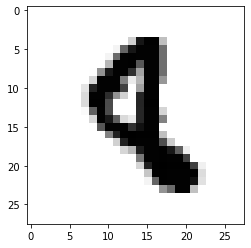

LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


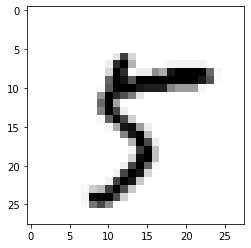

LABEL: 5
INPUT:


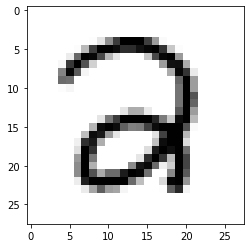

LABEL: 2
INPUT:


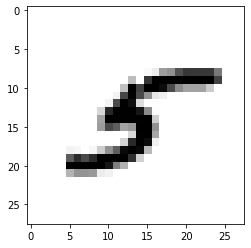

LABEL: 5
INPUT:


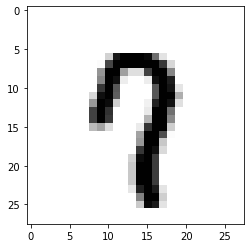

LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


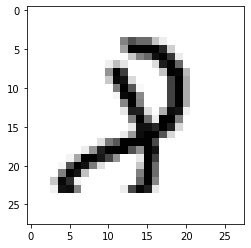

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


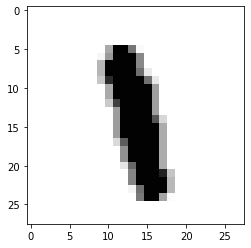

LABEL: 1
INPUT:


LABEL: 2
INPUT:


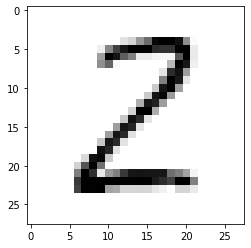

LABEL: 2
INPUT:


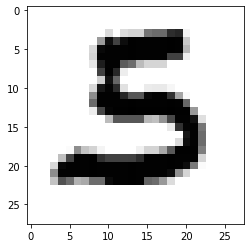

LABEL: 5
INPUT:


LABEL: 2
INPUT:


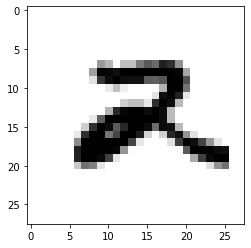

LABEL: 2
INPUT:


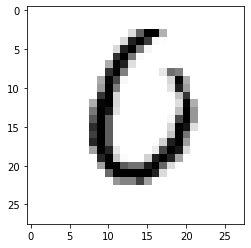

LABEL: 0
INPUT:


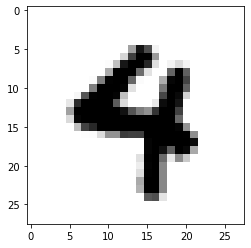

LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


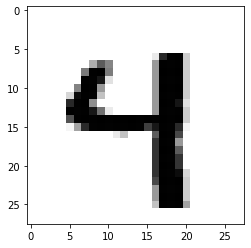

LABEL: 4
INPUT:


LABEL: 4
INPUT:


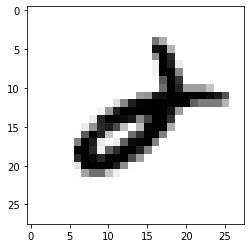

LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


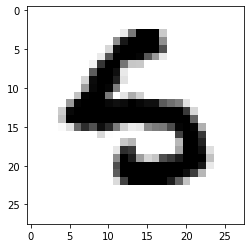

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


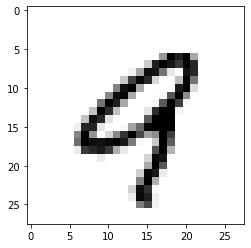

LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


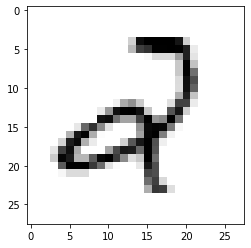

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


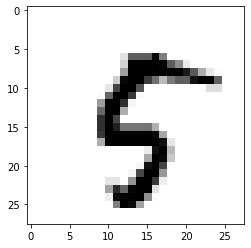

LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


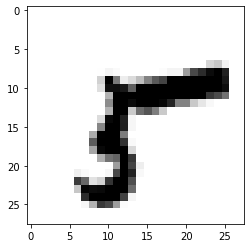

LABEL: 5
INPUT:


LABEL: 3
INPUT:


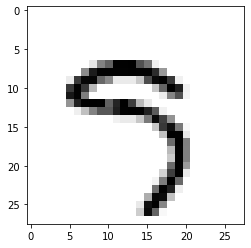

LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


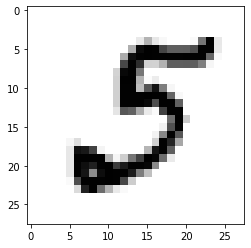

LABEL: 5
INPUT:


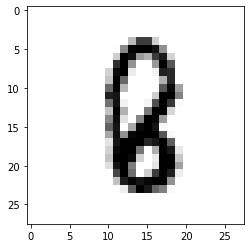

LABEL: 8
INPUT:


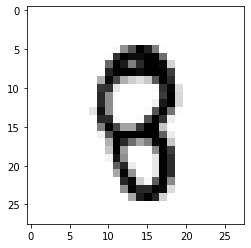

LABEL: 8
INPUT:


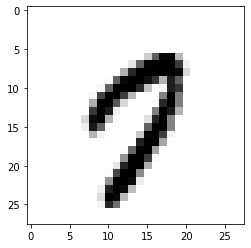

LABEL: 7
INPUT:


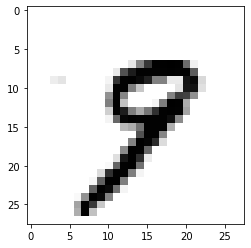

LABEL: 9
INPUT:


LABEL: 5
INPUT:


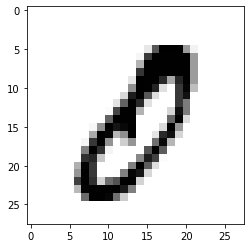

LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


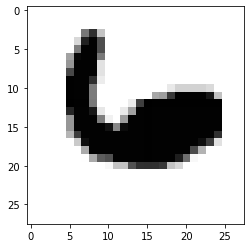

LABEL: 6
INPUT:


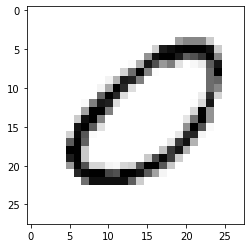

LABEL: 0
INPUT:


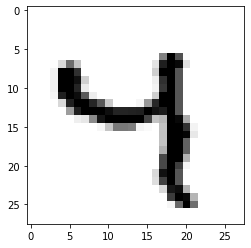

LABEL: 4
INPUT:


LABEL: 2
INPUT:


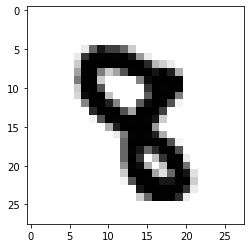

LABEL: 8
INPUT:


LABEL: 8
INPUT:


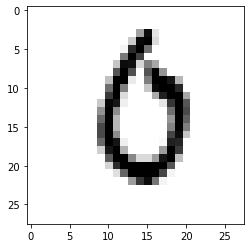

LABEL: 0
INPUT:


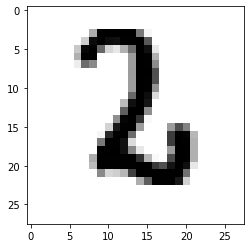

LABEL: 2
INPUT:


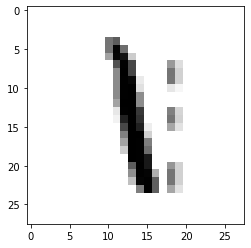

LABEL: 1
INPUT:


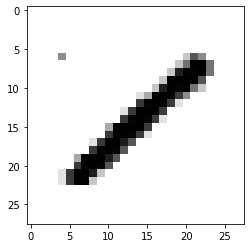

LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


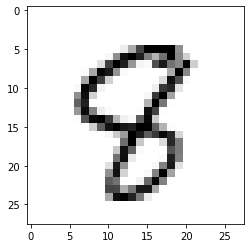

LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


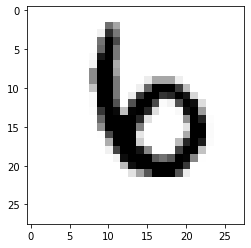

LABEL: 6
INPUT:


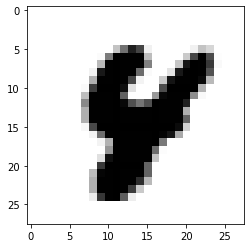

LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


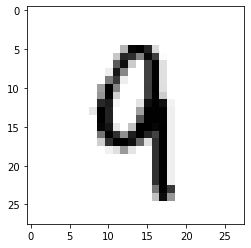

LABEL: 9
INPUT:


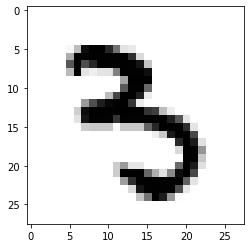

LABEL: 3
INPUT:


LABEL: 4
INPUT:


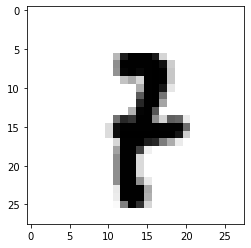

LABEL: 7
INPUT:


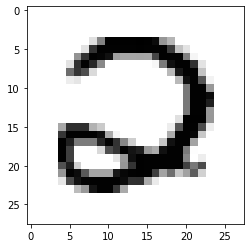

LABEL: 2
INPUT:


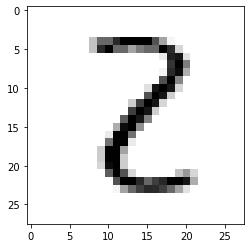

LABEL: 2
INPUT:


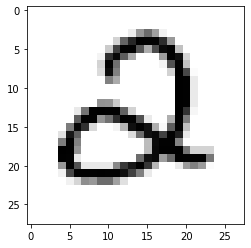

LABEL: 2
INPUT:


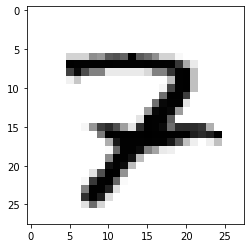

LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


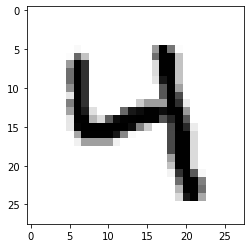

LABEL: 4
INPUT:


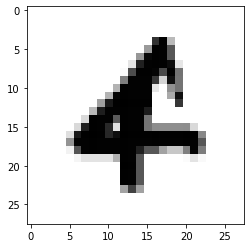

LABEL: 4
INPUT:


LABEL: 5
INPUT:


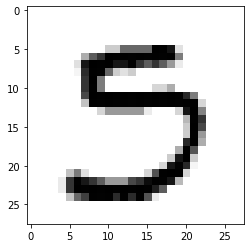

LABEL: 5
INPUT:


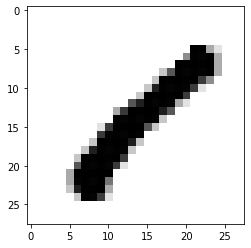

LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


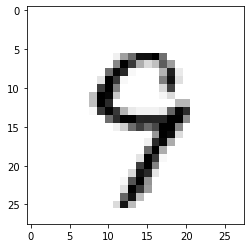

LABEL: 9
INPUT:


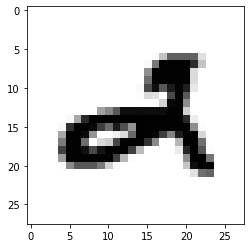

LABEL: 2
INPUT:


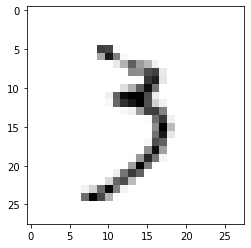

LABEL: 3
INPUT:


LABEL: 5
INPUT:


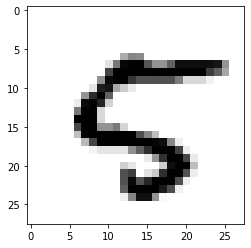

LABEL: 5
INPUT:


LABEL: 0
INPUT:


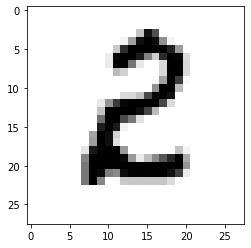

LABEL: 2
INPUT:


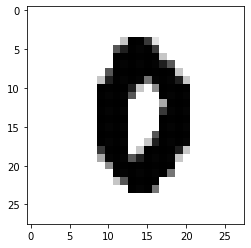

LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


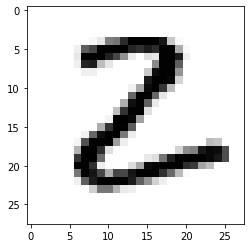

LABEL: 2
INPUT:


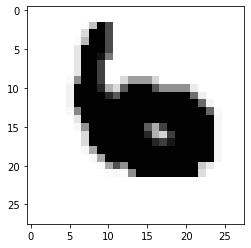

LABEL: 6
INPUT:


LABEL: 7
INPUT:


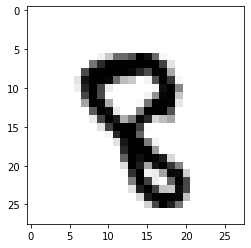

LABEL: 8
INPUT:


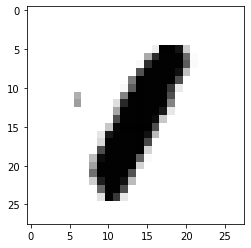

LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


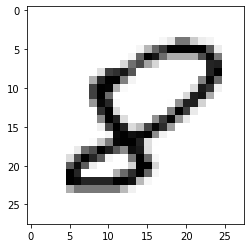

LABEL: 8
INPUT:


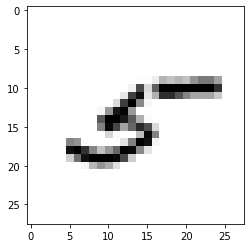

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


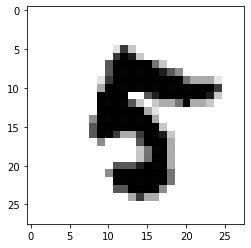

LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


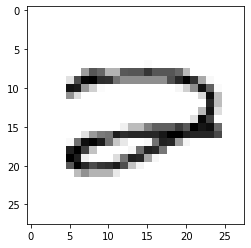

LABEL: 2
INPUT:


LABEL: 2
INPUT:


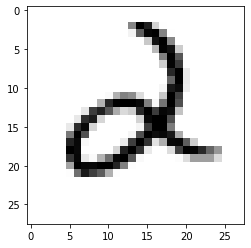

LABEL: 2
INPUT:


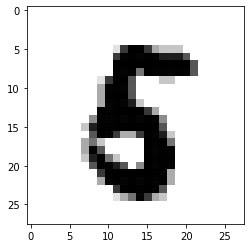

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


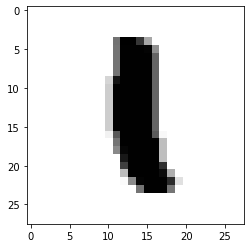

LABEL: 1
INPUT:


LABEL: 8
INPUT:


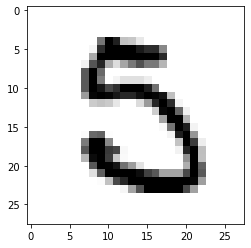

LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


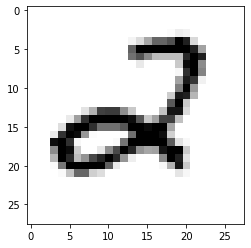

LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


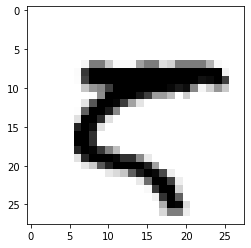

LABEL: 5
INPUT:


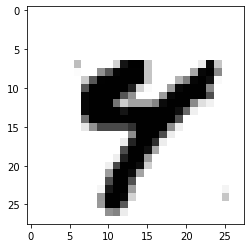

LABEL: 4
INPUT:


LABEL: 2
INPUT:


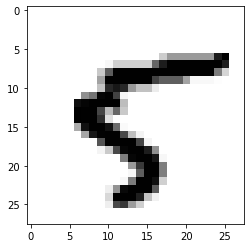

LABEL: 5
INPUT:


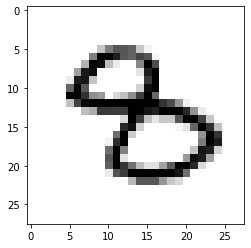

LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


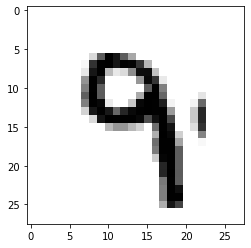

LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6


2573

In [ ]:
y_pred_lr = lr_cv.predict(X_test)
y_pred_svm = best_SVM.predict(X_test)
count = 0
for i in range(len(y_pred_svm)):
    if y_pred_lr[i] != y_test[i]:
        if y_pred_svm[i] == y_test[i]:
            count +=1
            plot_digit(X_test,y_test,i)
count

## TO DO 7
Compare and comment on the differences with the results above.
 

Best SVM model's training error = 0, test error = 0.121551 and logistic regression's training error = 0, test error = 0. As we see logistic regresyon is still better thar SVM. Still, we notice that SVM's test error has decreased a little. 